# IMPORTAR LIBRERIAS

In [1]:
import pandas as pd
import numpy as np
from collections import defaultdict
import pickle
import os
from itertools import combinations
import matplotlib.pyplot as plt
import seaborn as sns
import time
import itertools
from datetime import datetime

from sklearn.metrics import mean_squared_error
from sklearn.ensemble import RandomForestRegressor

import statsmodels.api as sm
from statsmodels.tsa.holtwinters import ExponentialSmoothing
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.graphics.tsaplots import plot_acf,plot_pacf

from skforecast.ForecasterBaseline import ForecasterEquivalentDate
from skforecast.ForecasterAutoreg import ForecasterAutoreg
from skforecast.ForecasterAutoregCustom import ForecasterAutoregCustom
from skforecast.ForecasterSarimax import ForecasterSarimax
from skforecast.Sarimax import Sarimax
from skforecast.model_selection import grid_search_forecaster,backtesting_forecaster
from skforecast.model_selection_sarimax import backtesting_sarimax, grid_search_sarimax

from skforecast.ForecasterRnn import ForecasterRnn
from skforecast.ForecasterRnn.utils import create_and_compile_model
from keras.optimizers import Adam
from keras.losses import MeanSquaredError
from keras.callbacks import EarlyStopping
from sklearn.preprocessing import MinMaxScaler

import pmdarima as pm

from prophet import Prophet

from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import LinearRegression
from lightgbm import LGBMRegressor


#CONTROL WARNINGS
import logging
import cmdstanpy
logging.getLogger('cmdstanpy').setLevel(logging.WARNING)

import warnings
# Suprimir todos los warnings
warnings.filterwarnings('ignore')

C:\Users\OT\AppData\Local\Temp\ipykernel_4040\2152638940.py:1: DeprecationWarning: 
Pyarrow will become a required dependency of pandas in the next major release of pandas (pandas 3.0),
(to allow more performant data types, such as the Arrow string type, and better interoperability with other libraries)
but was not found to be installed on your system.
If this would cause problems for you,
please provide us feedback at https://github.com/pandas-dev/pandas/issues/54466
        
  import pandas as pd
C:\Users\OT\anaconda3\envs\tfm_modelos\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


# CARGAR DATOS

Como vimos en el análisis exploratorio los grupos de alimentos: pastas, arroz, legumbres y huevos tienen muy poca variabilidad en el consumo y, por éste motivo, se decide no incluirnos en el modelado

In [2]:
directorioSalida = './Dataset/Dataset_final/'
datosNacional_pk = os.path.join(directorioSalida, 'df_nacional_filtrado.pkl')

df_nacional_filtrado = pd.read_pickle(datosNacional_pk)

valores_a_eliminar = ['TOTAL PASTAS', 'ARROZ', 'LEGUMBRES', 'T.HUEVOS KGS']
df_nacional_filtrado = df_nacional_filtrado[~df_nacional_filtrado['Alimentos'].isin(valores_a_eliminar)]

A continuación, se crea un diccionario para almacenar las series por alimento, estableciendo formato y frecuencia. 

In [3]:
# Listado de alimentos para procesar
seleccion_alimentos = ['T.FRUTAS FRESCAS', 'T.HORTALIZAS FRESCAS',  'PAN',
                       'TOTAL CARNE', 'TOTAL PESCA', 'PLATOS PREPARADOS',
                       'TOTAL LECHE LIQUIDA', 'DERIVADOS LACTEOS']

# Diccionarios para almacenar las series periodo 1999-2023 dataset origen
dict_series_mensuales_nacional = {}

for alimento in seleccion_alimentos:
    serie = df_nacional_filtrado[df_nacional_filtrado['Alimentos'] == alimento]
    serie['Fecha'] = pd.to_datetime(serie['Fecha'], format='%Y-%m')
    serie = serie.set_index('Fecha')
    serie= serie.asfreq('MS')
    serie= serie.sort_index()
    dict_series_mensuales_nacional[alimento] = serie

También se crea el diccionario específico reduciendo el periodo del dataset del 2002 al 2023 incluyendo la variable exógena IPC. Éste solo aplica a los modelos multivariante, en ellos de desarollara por duplicado el análisis con los dos conjuntos. 

In [4]:
# Diccionario para almacenar las series con IPC en nuevo periodo 2002-2023
ruta_archivo='./Dataset/Dataset_origen/IPC_2002_2023.xlsx'
ipc_data = pd.read_excel(ruta_archivo)
ipc_data['IPC Alimentos y bebidas no alcholicas'] = pd.to_numeric(ipc_data['IPC Alimentos y bebidas no alcholicas'], errors='coerce')

dict_series_reducida={}

for alimento in seleccion_alimentos:
    # Filtrar datos para el alimento actual
    df_alimento = df_nacional_filtrado[df_nacional_filtrado['Alimentos'] == alimento]
    
    # Convertir las columnas 'Año' y 'Mes' a numérico
    df_alimento['Año'] = pd.to_numeric(df_alimento['Año'], errors='coerce')
    df_alimento['Mes'] = pd.to_numeric(df_alimento['Mes'], errors='coerce')
    
    # Filtrar para eliminar los años 1999, 2000, 2001 y 2024
    df_alimento = df_alimento[~df_alimento['Año'].isin([1999, 2000, 2001, 2024])]
    
    # Combinar df_alimento con ipc_data basado en 'Mes' y 'Año'
    df_combinado = pd.merge(df_alimento, ipc_data, on=['Mes', 'Año'], how='left')
    
    df_combinado['Fecha'] = pd.to_datetime(df_combinado['Fecha'], errors='coerce')   
    df_combinado.set_index('Fecha', inplace=True)
    df_combinado= df_combinado.asfreq('MS')
    df_combinado.sort_index(inplace=True)
    dict_series_reducida[alimento] = df_combinado

# TRAIN-TEST

Creamos un diccionario para almacenar los conjuntos de train-test asociados a cada serie de alimentos, con el fin de modelar todas las series simultáneamente utilizando diferentes modelos. La partición de los datos se organiza de la siguiente manera:

- Train: De enero de 1999 a 22.
- Test: De abril de 2022 a 2023.

En este caso, eliminamos del conjunto los datos de enero a marzo del 2024. 

In [5]:
data_train_dict = {}

steps = 12 #Definimos el intervalo que queremos dejar de test. En éste caso 1 mes.

for alimento, serie in dict_series_mensuales_nacional.items():
    serie=serie[serie.index.year != 2024]
    train = serie[:-steps]
    test = serie[-steps:]
    
    data_train_dict[alimento] = {
            'train': train,
            'test': test
        }

In [6]:
# Diccionario para el periodo reducido con IPC
data_train_dict_reducido = {}

steps = 12 

for alimento, serie in dict_series_reducida.items():
    serie=serie[serie.index.year != 2024]
    train = serie[:-steps]
    test = serie[-steps:]
    
    data_train_dict_reducido[alimento] = {
            'train': train,
            'test': test
        }

# ANÁLISIS SERIES

Primero miramos el gráfico de dispersión de retardos aplicando un retardo de 12, para observar la autocorrelación con un retardo de un año, para observar como se relacionan los valores de un mes con el mes del año anterior. Se puede observar claramente una fuerte correlación anual en todas las series. 

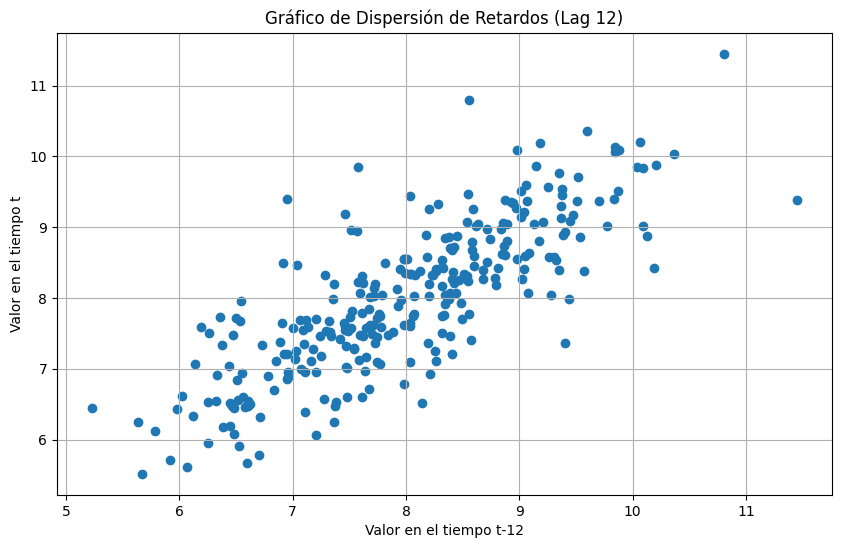

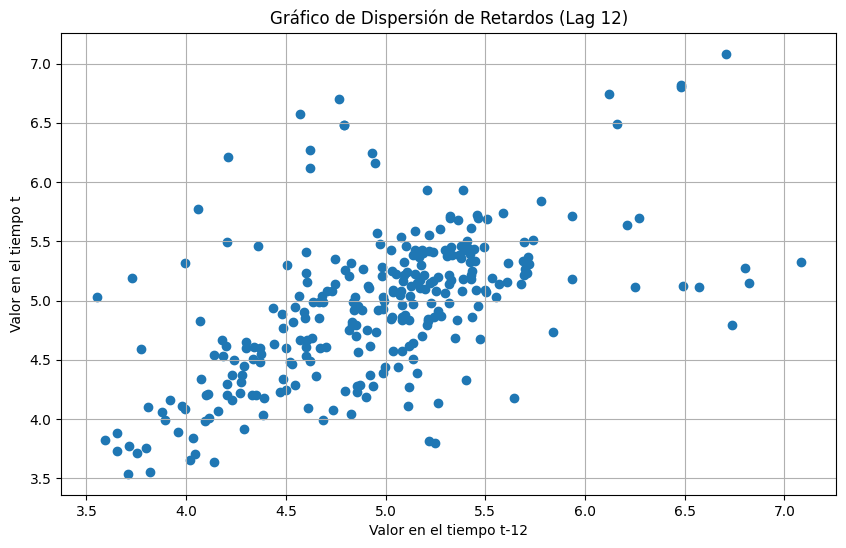

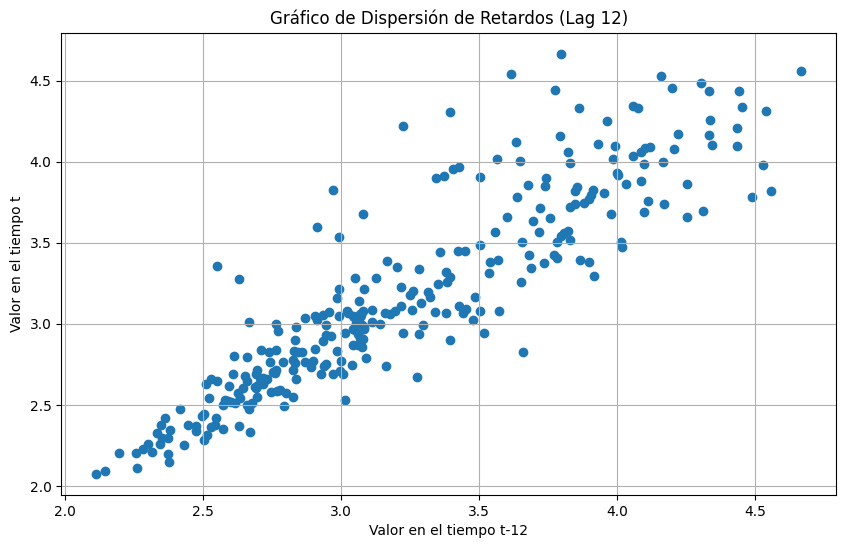

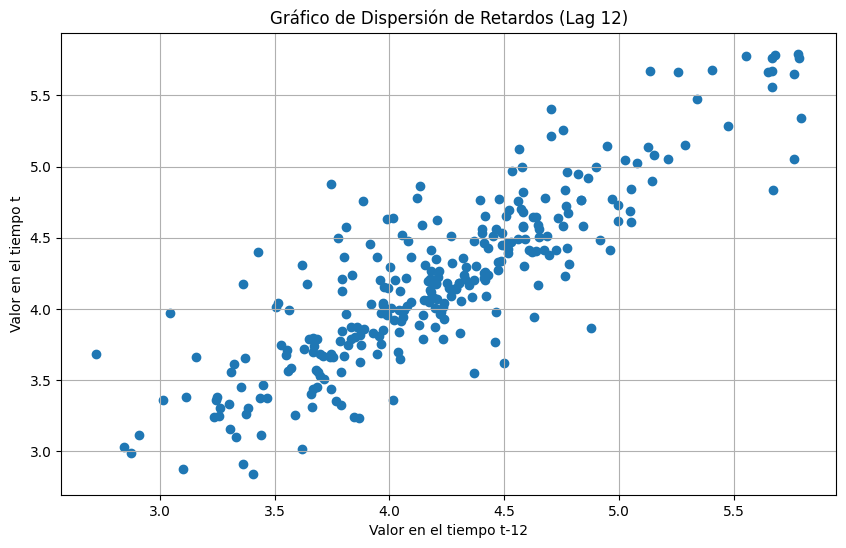

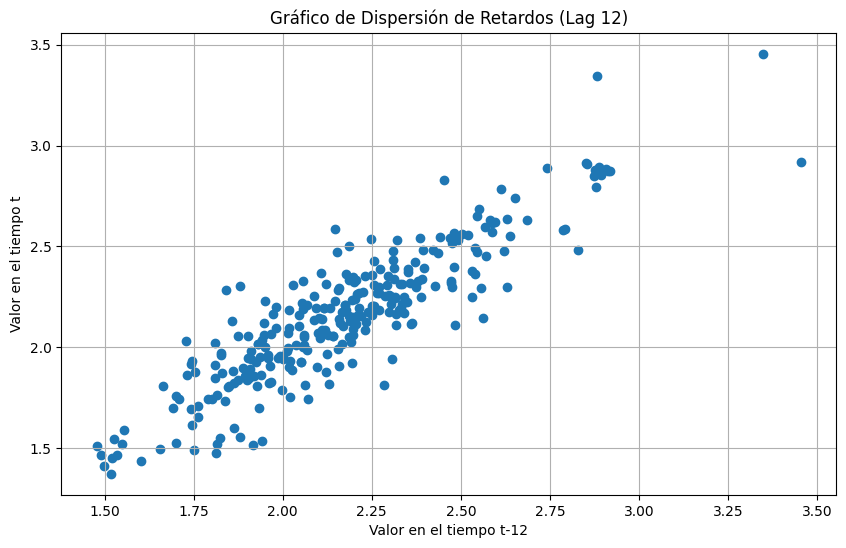

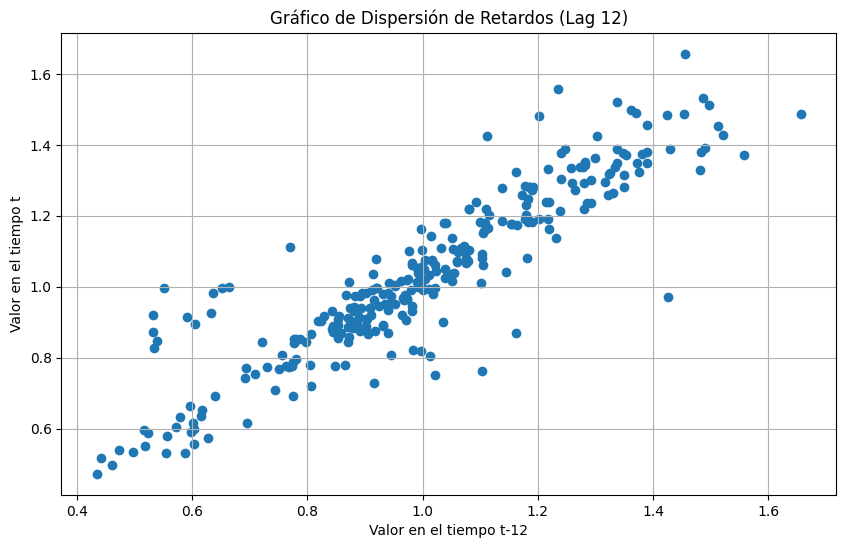

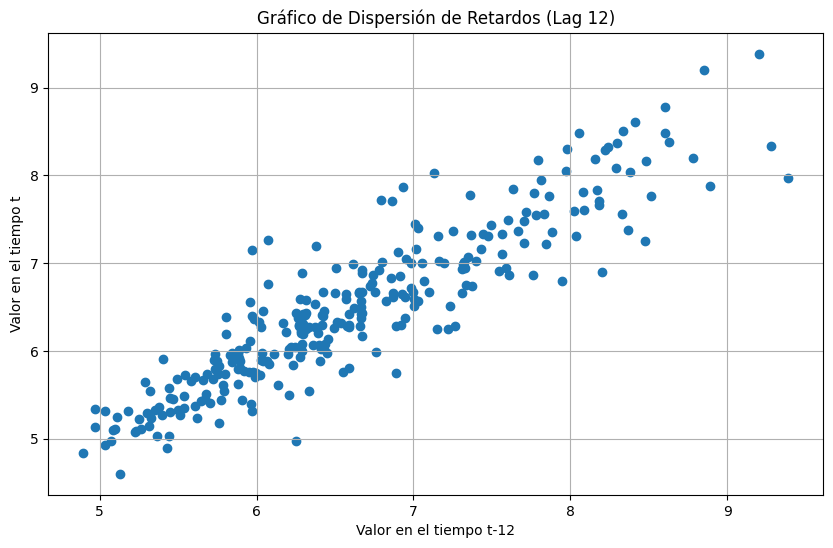

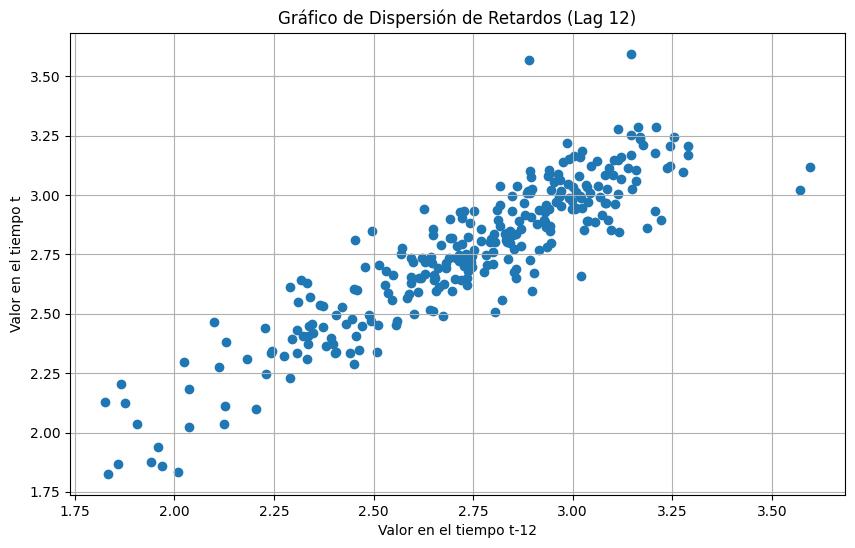

In [7]:
from pandas.plotting import lag_plot
for alimento, serie in dict_series_mensuales_nacional.items():
    a=serie['CONSUMO X CAPITA'][:-3]
    # Grafico de dispersión de retardos (lag plot)
    plt.figure(figsize=(10, 6))
    lag_plot(a, lag=12)
    plt.title('Gráfico de Dispersión de Retardos (Lag 12)')
    plt.xlabel('Valor en el tiempo t-12')
    plt.ylabel('Valor en el tiempo t')
    plt.grid(True)
    plt.show()

Seguidamente realizaremos la siguiente representación gráfica para analizar con mayor detalle la estructura de la serie temporal, identificando la tendencia, la estacionalidad y el componente de ruido. En frutas y hortalizas no se observa una tendencia muy clara, en cambio para carne, pescado, pan y leche se observa una ligera tendencia negativa al contrario que platos preparados y derivados lácteos que es positiva. 

En el gráfico de estacionalidad, donde hemos eliminado la tendencia de la serie para resaltar los patrones periódicos, podemos ver clara la estacionalidad de cada serie. Este patrón recurrente sugiere la influencia de factores estacionales, como las condiciones climáticas y culturales, que probablemente afectan al consumo de cada alimento a lo largo del año.

T.FRUTAS FRESCAS


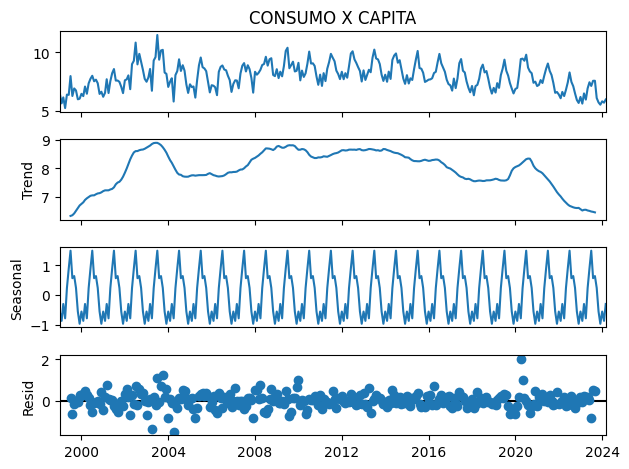

T.HORTALIZAS FRESCAS


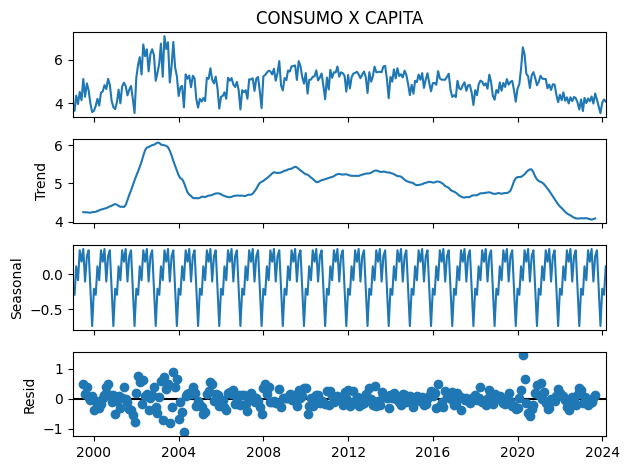

PAN


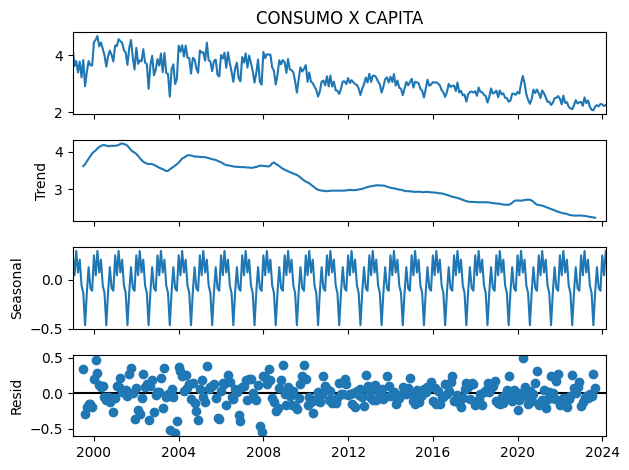

TOTAL CARNE


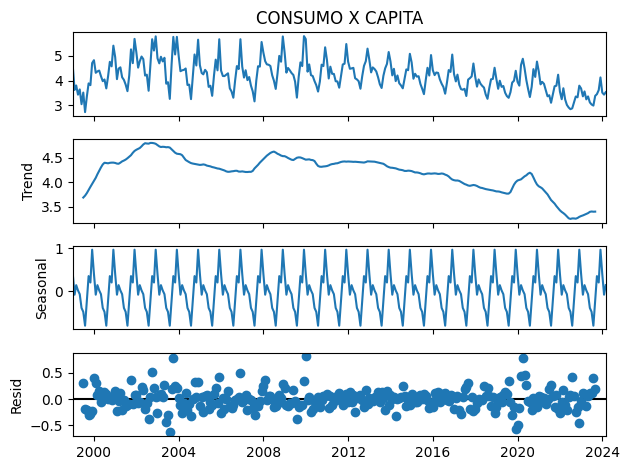

TOTAL PESCA


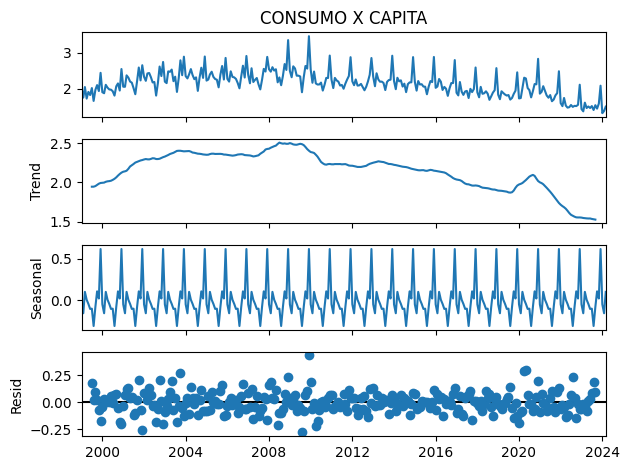

PLATOS PREPARADOS


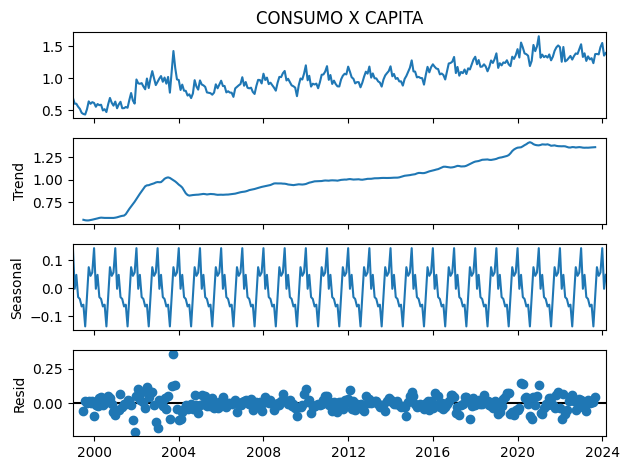

TOTAL LECHE LIQUIDA


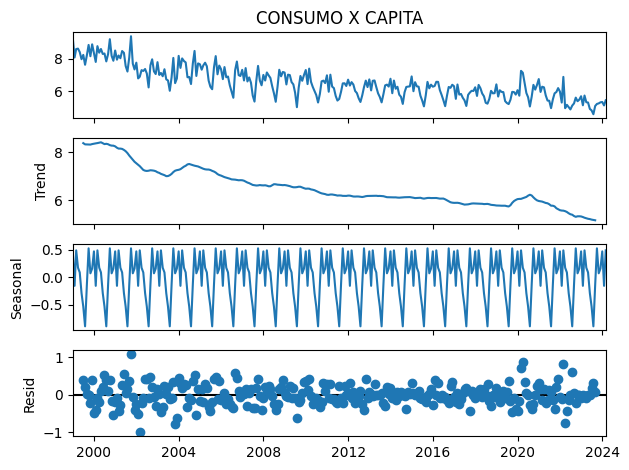

DERIVADOS LACTEOS


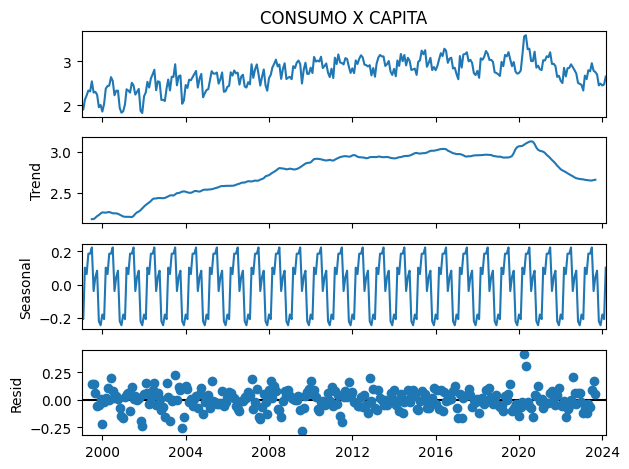

In [8]:
for alimento, serie in dict_series_mensuales_nacional.items():
    
    descomp=seasonal_decompose(serie['CONSUMO X CAPITA'],model='additive',period=12)
    print(alimento)
    fig = descomp.plot()
    plt.show()

Se observa una tendencia claramente decreciente en las series de alimentos como el pan, la carne, el pescado y la leche líquida. En contraste, las series de platos preparados y derivados lácteos muestran una tendencia creciente, mientras que en frutas y hortalizas no se identifica una tendencia definida. Además, la serie estacionalmente ajustada nos permite observar la tendencia subyacente en nuestros datos originales al eliminar el efecto de la estacionalidad.Al aplicar un modelo aditivo, dividimos la serie original por el coeficiente de estacionalidad correspondiente a cada período. Esto ayuda a destacar la variación de los datos que no está relacionada con la estacionalidad, lo que puede ser útil para identificar tendencias a largo plazo o anomalías en la serie temporal. 
Aparecen picos marcados en algunas series que podrían reflejar variabilidad no explicada en los datos, posiblemente debido a factores externos, como nuevas políticas, factores culturales u otros elementos que no se capturan en el proceso de desestacionalización.
Un ejemplo significativo es el pico registrado en abril de 2020, que coincide con el inicio de las restricciones por la pandemia de COVID-19 en España. Durante ese periodo, se produjo un aumento notable en el consumo de alimentos, lo que sugiere que la población realizó compras masivas en previsión de las restricciones. Sin embargo, dado que el consumo en estas series se estima a partir de las compras realizadas, este comportamiento no representa el consumo real de dicho periodo, ya que refleja un patrón de acumulación. Por tanto, este dato podría considerarse una anomalía en el conjunto de las series y debería evaluarse su eliminación.

Inicialmente, no se eliminará esta anomalía, pero se tendrá en cuenta en futuros modelos para asegurar un análisis más preciso.

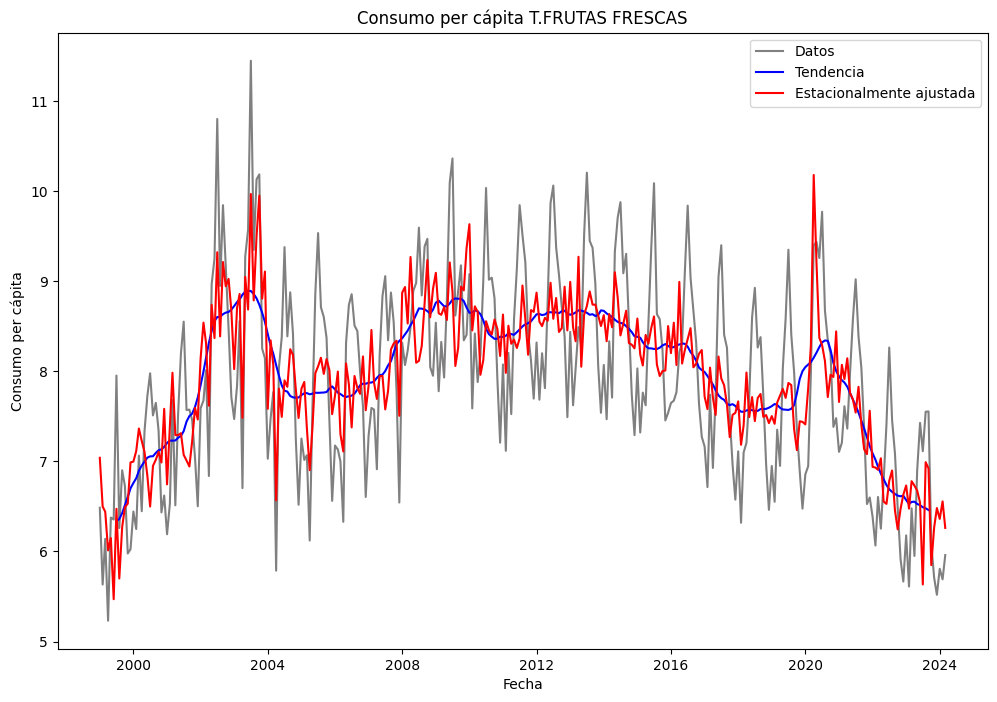

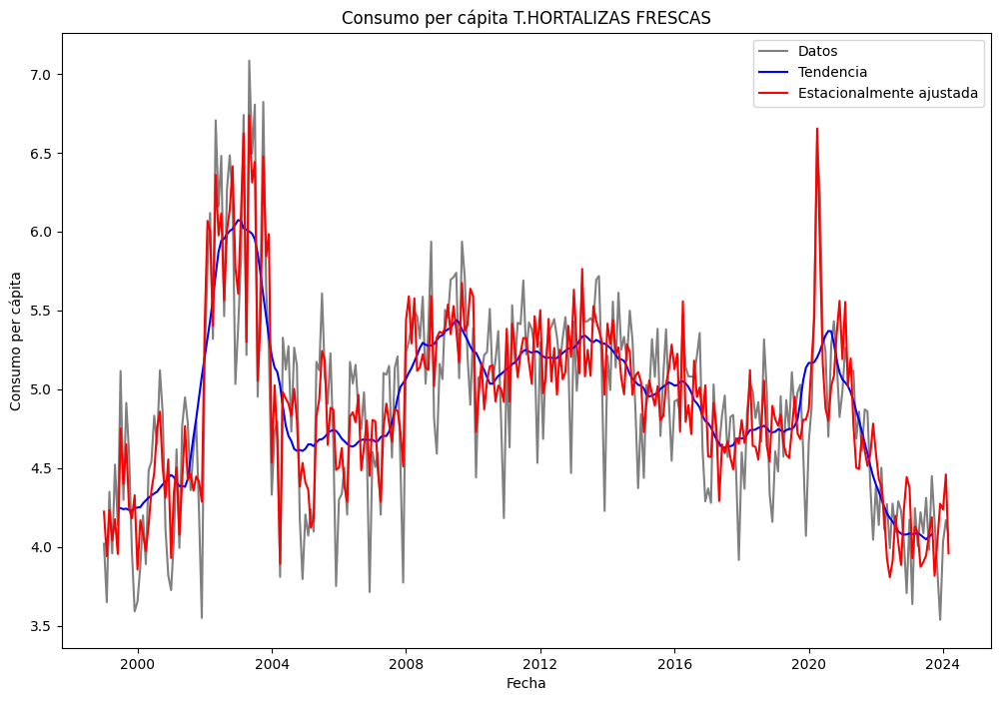

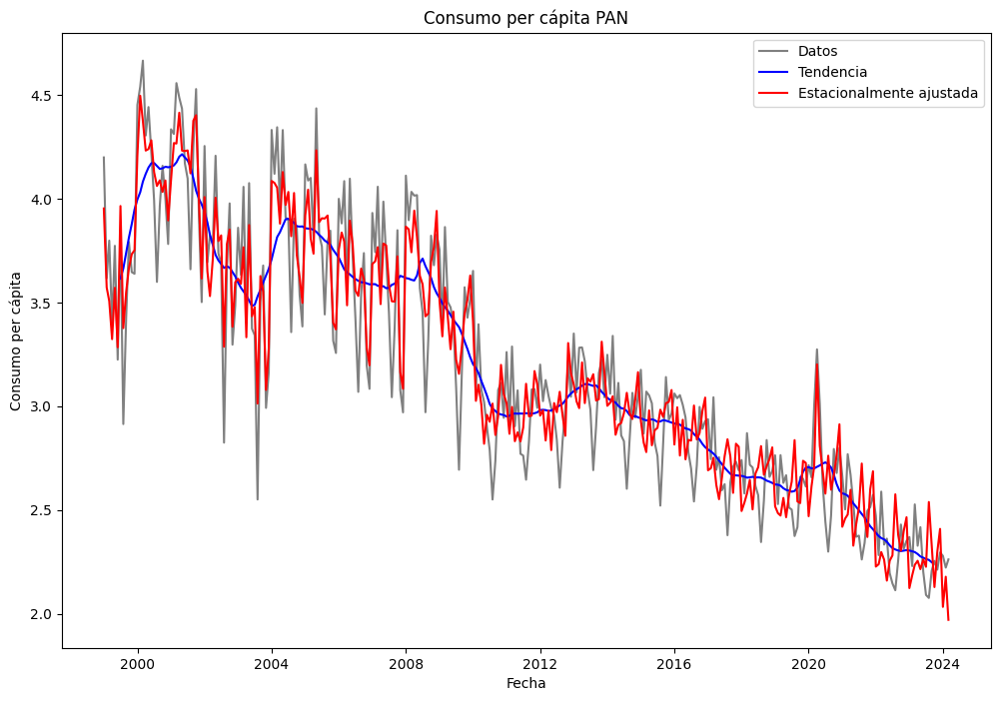

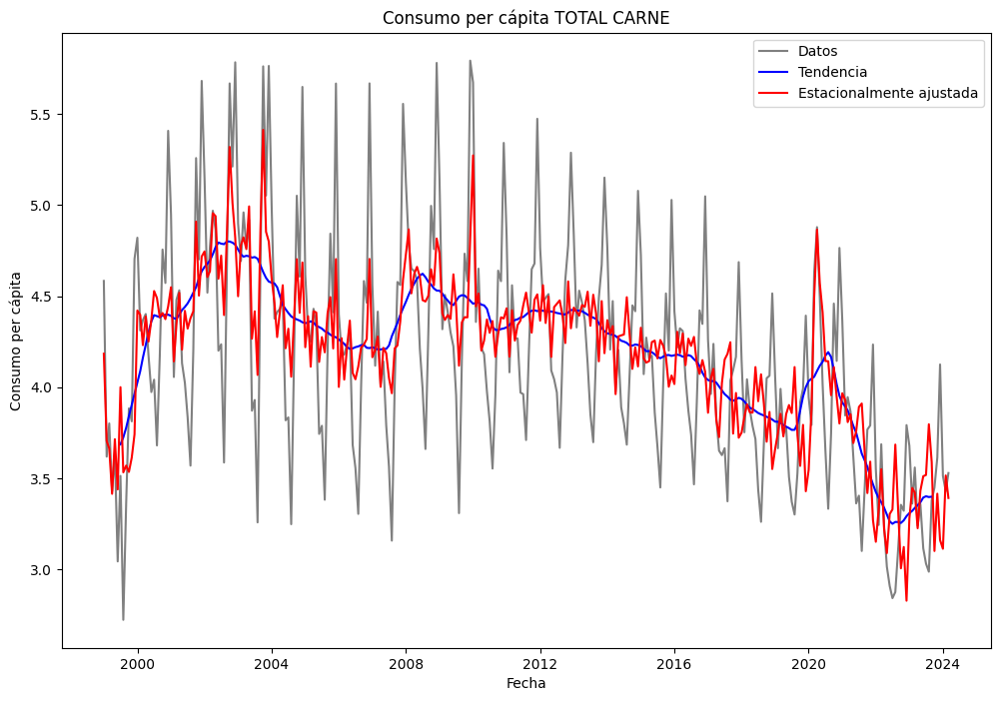

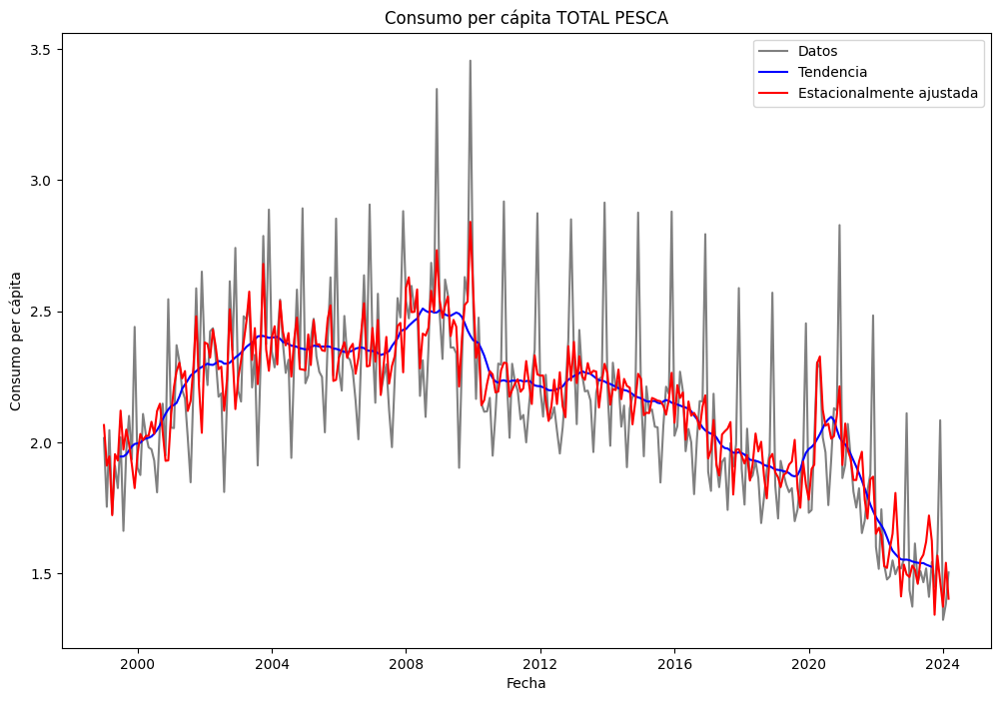

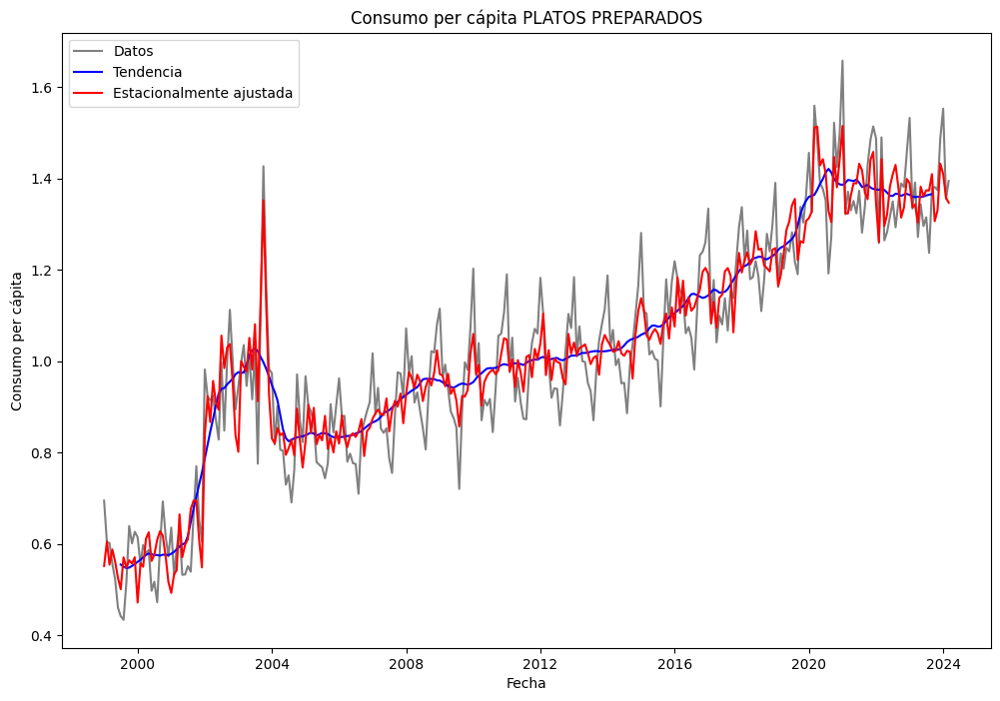

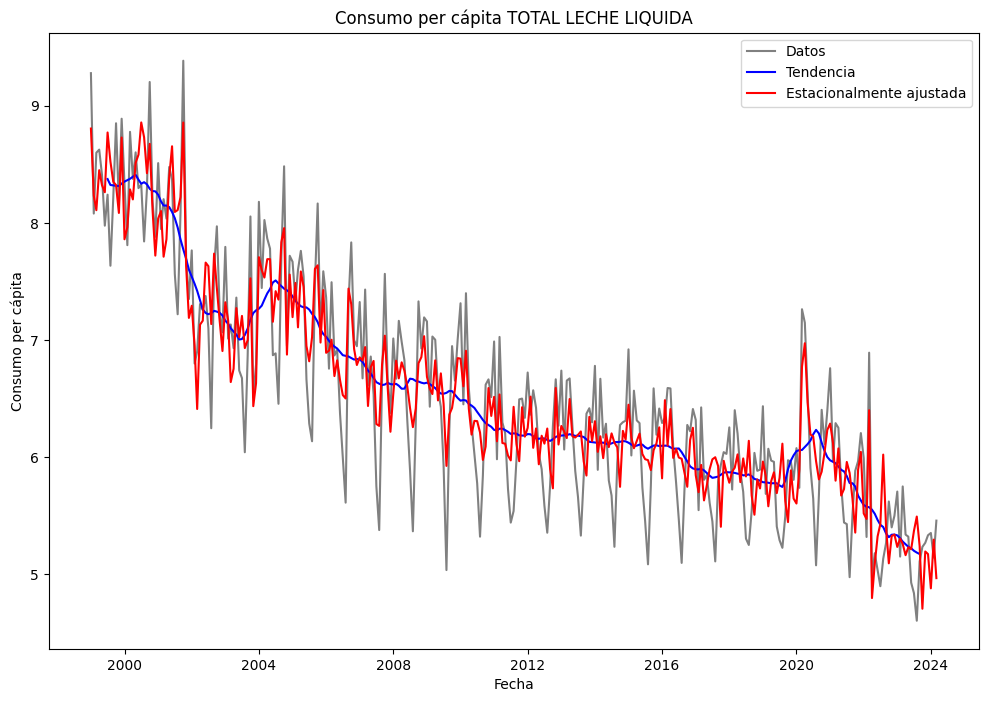

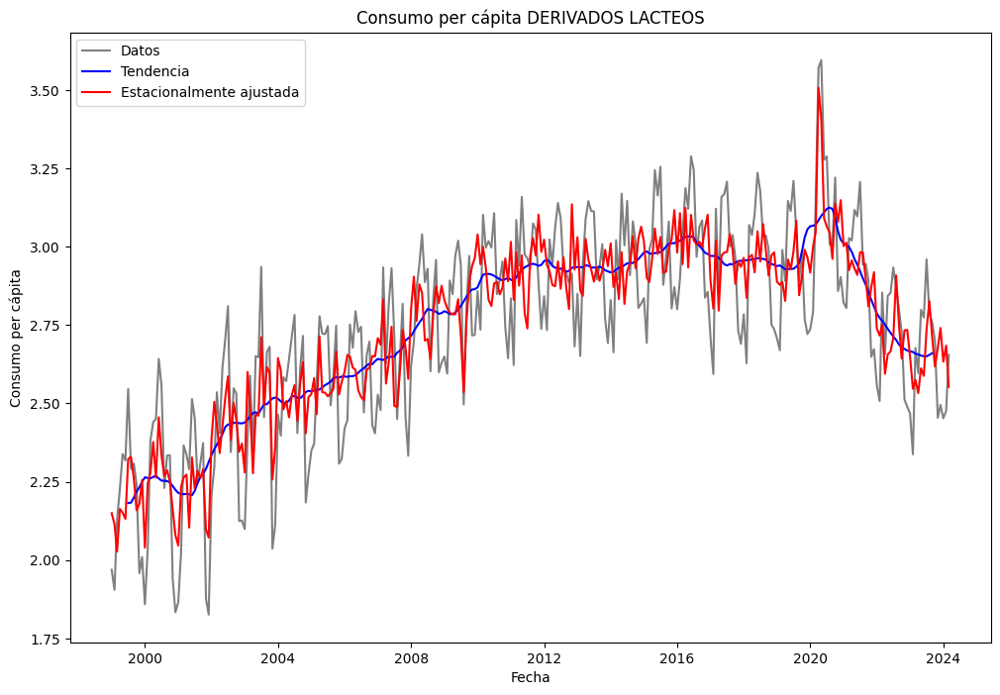

In [9]:
for alimento, serie in dict_series_mensuales_nacional.items():
    descomp=seasonal_decompose(serie['CONSUMO X CAPITA'],model='additive',period=12)
    serie_est_ajustada=serie['CONSUMO X CAPITA']-descomp.seasonal

    plt.figure(figsize=(12,8))
    plt.plot(serie['CONSUMO X CAPITA'],label='Datos',color='gray')
    plt.plot(descomp.trend,label='Tendencia',color='blue')
    plt.plot(serie_est_ajustada,label='Estacionalmente ajustada',color='red')
    plt.xlabel('Fecha')
    plt.ylabel('Consumo per cápita')
    plt.title(f'Consumo per cápita {alimento}')
    plt.legend()
    plt.show()

En el siguiente correlagrama mostramos la generación de las autocorrelaciones utilizando las funciones de autocorrelación simple (ACF) y autocorrelación parcial (PACF). Para la representación, se consideran 36 lags. Observamos las funciones de autocorrelación simple (ACF) y autocorrelación parcial (PACF) de la serie temporal.

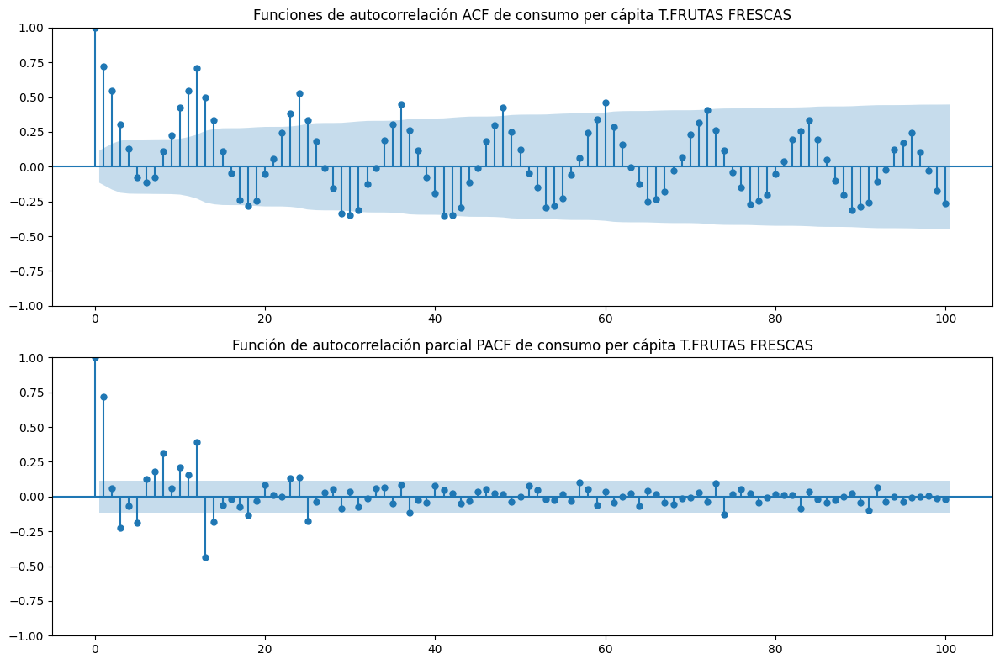

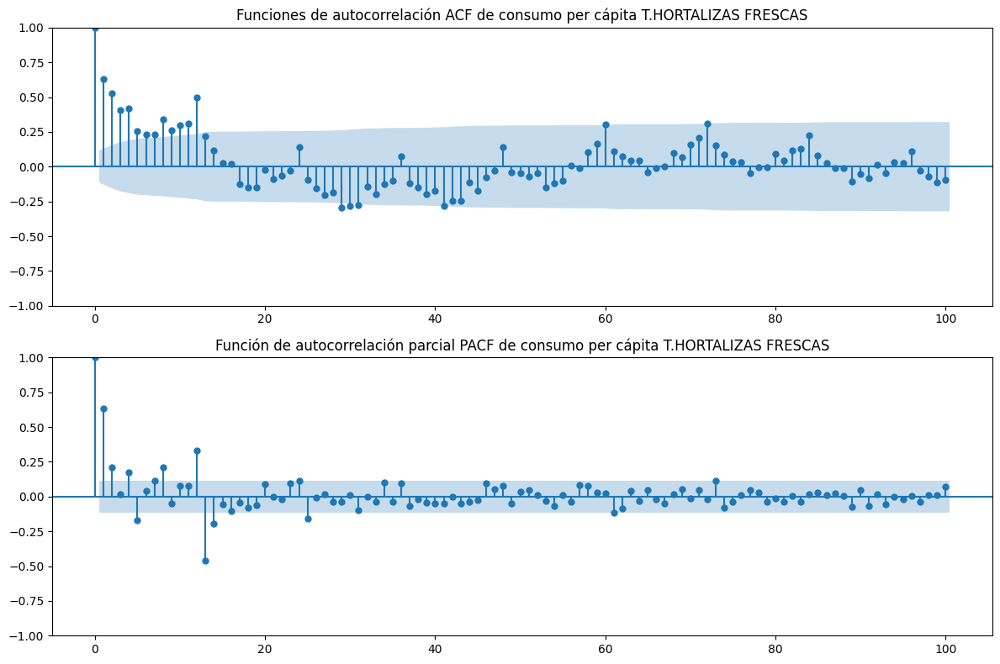

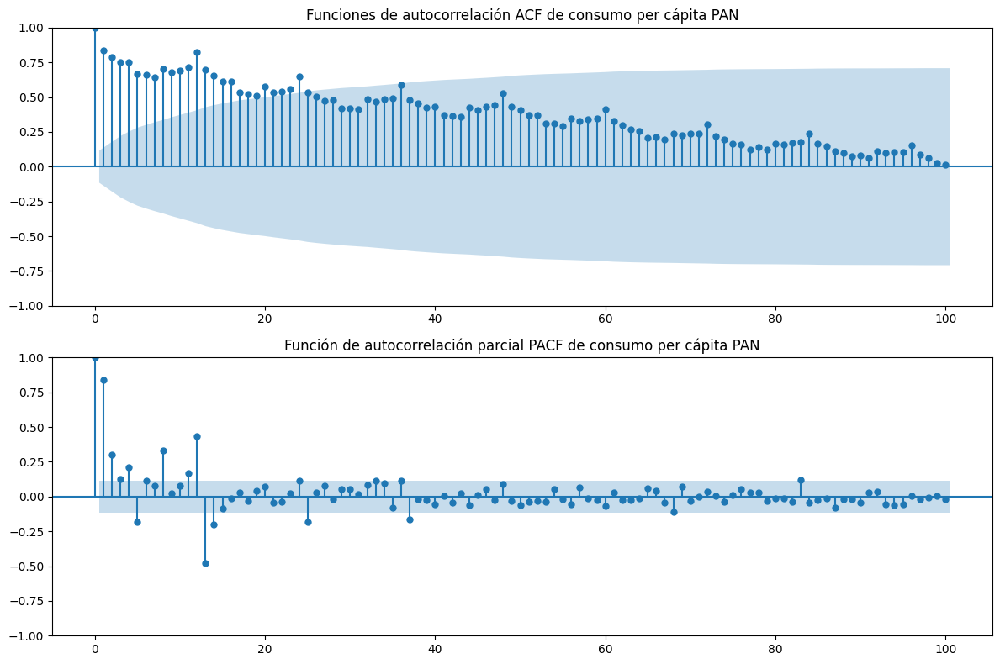

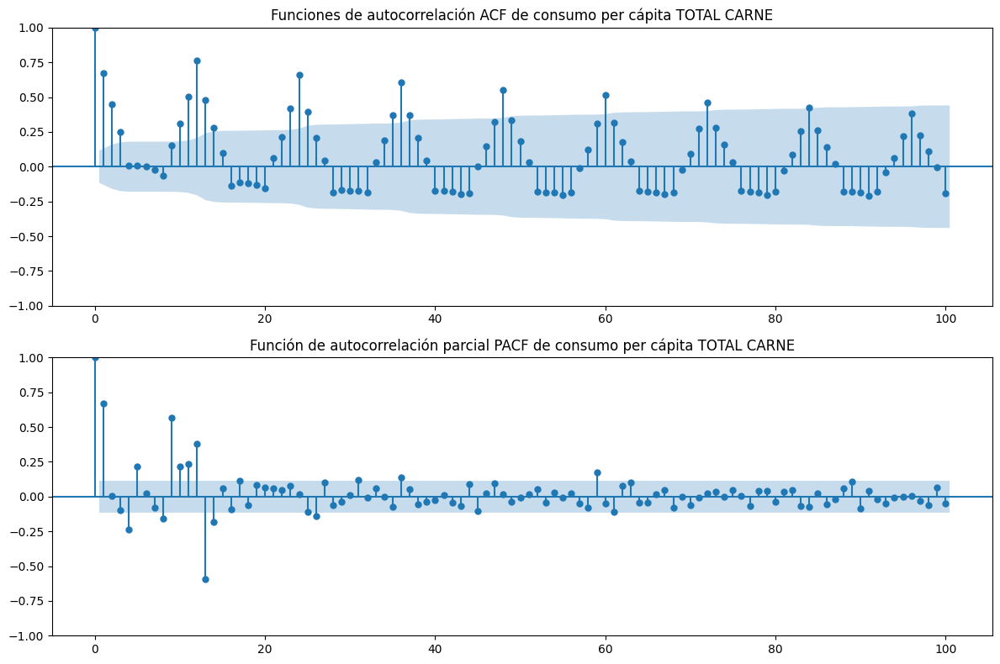

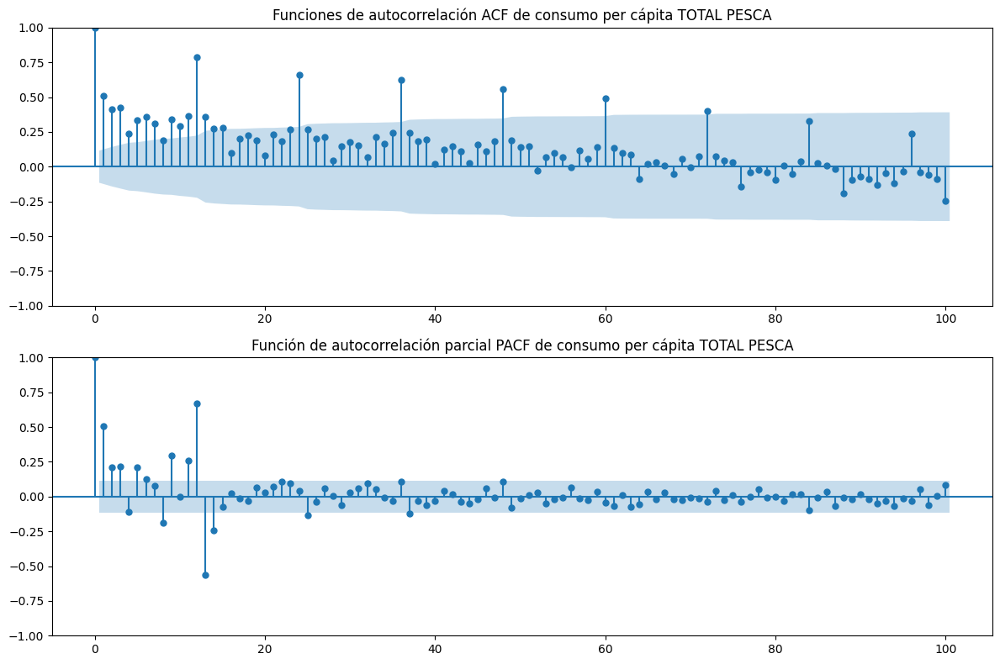

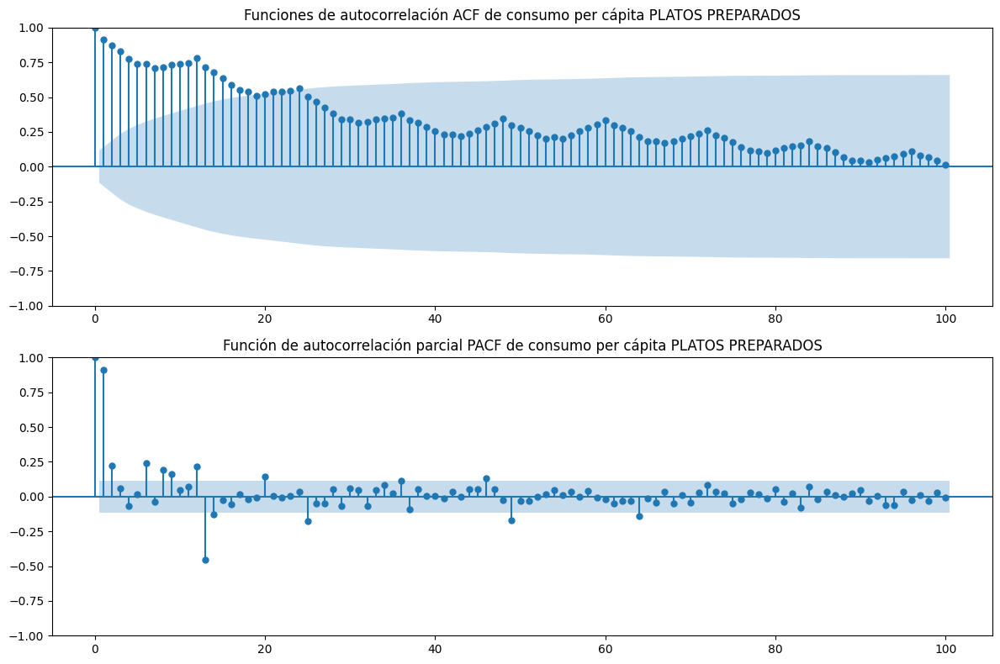

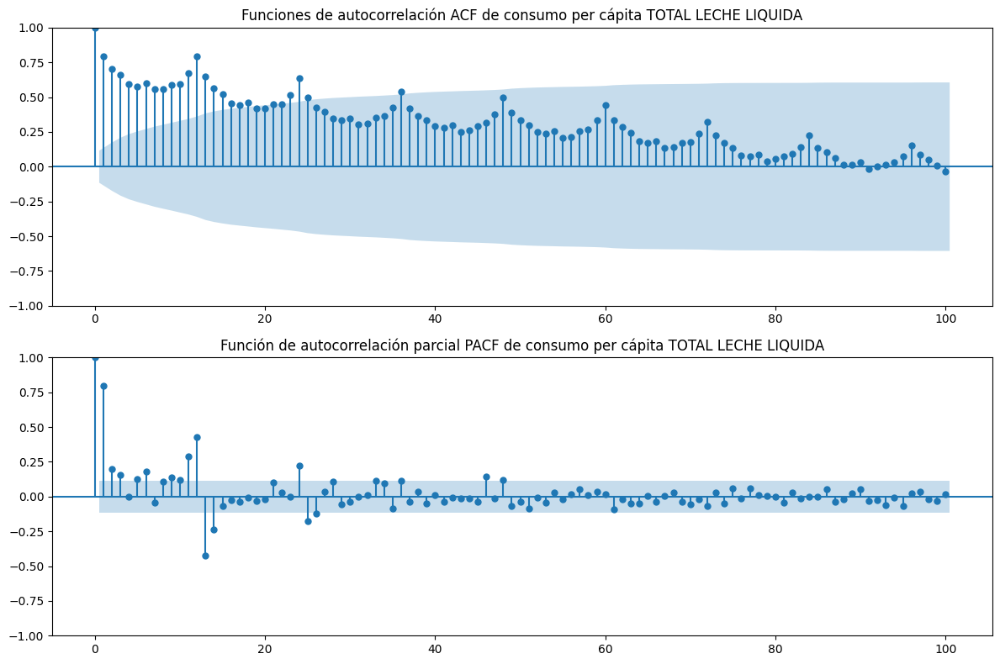

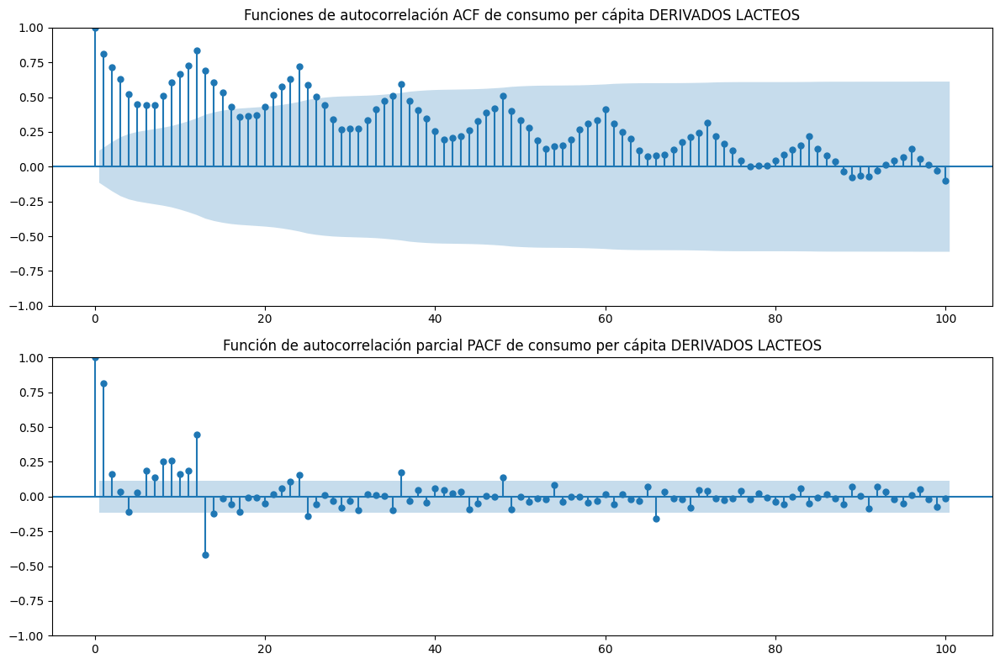

In [10]:
for alimento, data in data_train_dict.items():
    train = data['train']['CONSUMO X CAPITA']

    fig,(ax1,ax2)=plt.subplots(2,1,figsize=(12,8))
    plot_acf(train,lags=100,ax=ax1)
    ax1.set_title(f'Funciones de autocorrelación ACF de consumo per cápita {alimento}')
    
    plot_pacf(train,lags=100,ax=ax2)
    ax2.set_title(f'Función de autocorrelación parcial PACF de consumo per cápita {alimento}')

    plt.tight_layout()
    plt.show()

Si el valor de PACF para un determinado lag está dentro del intervalo de confianza (las líneas horizontales), esto sugiere que la autocorrelación parcial en ese lag no es estadísticamente significativa. En otras palabras, cualquier correlación observada podría deberse al azar. Con estos gráficos podemos observar en la función de autocorrelación como las series exhiben un comportamiento repetitivo cada 12 meses que es consistente con la estacionalidad que habíamos identificado previamente en el análisis exploratorio de datos.

# MODELADO UNIVARIENTE

## MODELO DE SUAVIZADO: HOLT WINTERS

Para modelos de suavizado no es una exigencia tener una serie estacionaria, pero ayuda a definir un mejor modelo. Por éste motivo, en Holt-Winters, se incluye el parámetro 'use_boxcox=True' en la definición del modelo. Este parámetro se utiliza para decidir si se aplica o no la transformación Box-Cox a los datos de la serie temporal antes de ajustar el modelo. La transformación de Box-Cox es una técnica estadística utilizada para estabilizar la varianza y hacer que los datos se aproximen más a una distribución normal. En nuestro caso, probaremos ambas opciones para observar su comportamiento y además indicamos tendencia y estacionalidad aditiva. 

T.FRUTAS FRESCAS: RMSE sin transformación:0.38596786591326376 y RMSE con Box-Cox: 0.38566104082013586


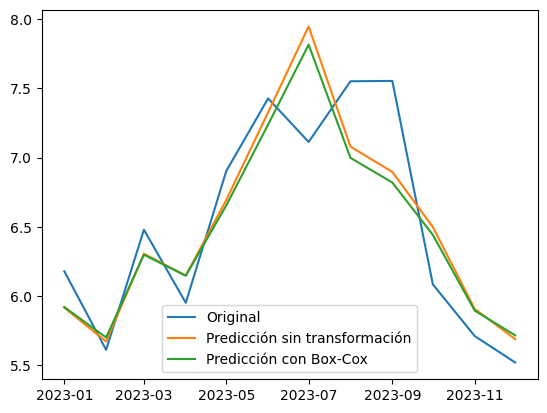

T.HORTALIZAS FRESCAS: RMSE sin transformación:0.1722853088618721 y RMSE con Box-Cox: 0.15758869610055126


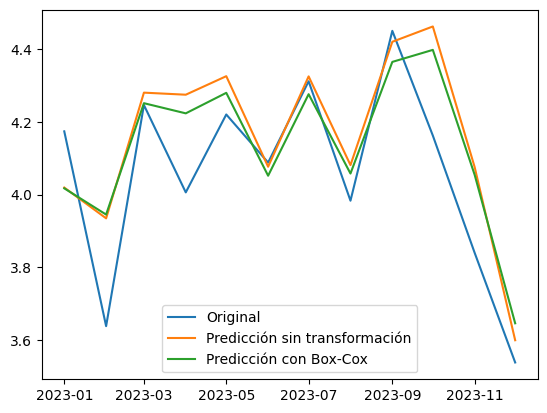

PAN: RMSE sin transformación:0.060509608434873866 y RMSE con Box-Cox: 0.054837013142513456


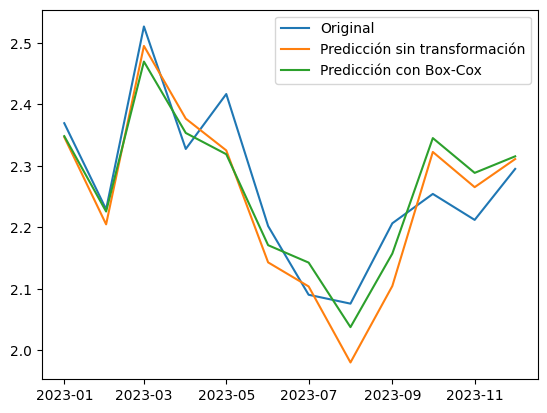

TOTAL CARNE: RMSE sin transformación:0.2758514328963647 y RMSE con Box-Cox: 0.24401115660111805


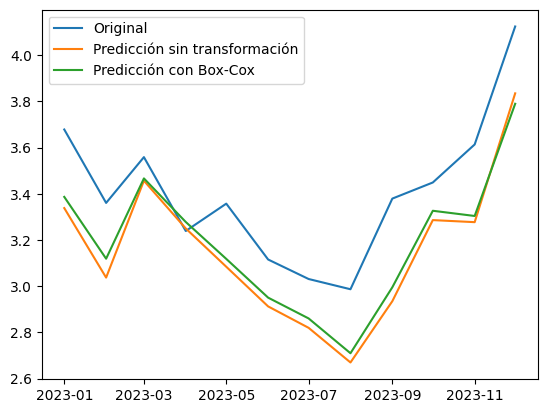

TOTAL PESCA: RMSE sin transformación:0.07256673833206381 y RMSE con Box-Cox: 0.055466144069306535


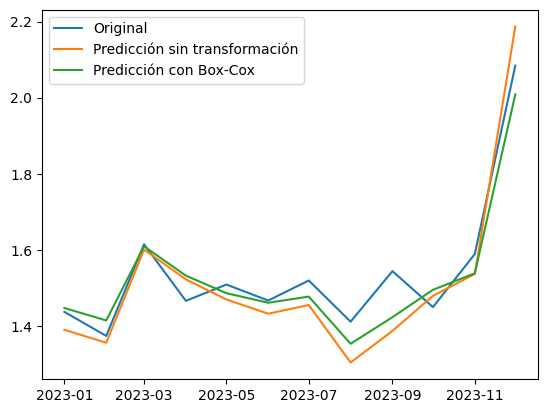

PLATOS PREPARADOS: RMSE sin transformación:0.03875180539794874 y RMSE con Box-Cox: 0.0387495903589934


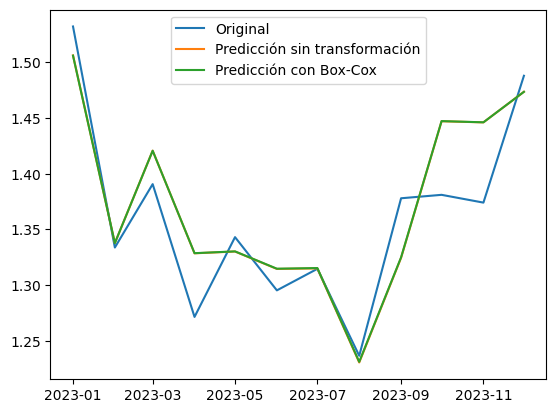

TOTAL LECHE LIQUIDA: RMSE sin transformación:0.14621337975568993 y RMSE con Box-Cox: 0.14233971027557546


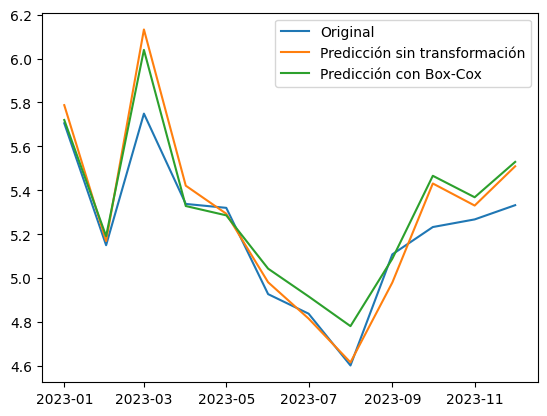

DERIVADOS LACTEOS: RMSE sin transformación:0.10813777472151681 y RMSE con Box-Cox: 0.12337678574882699


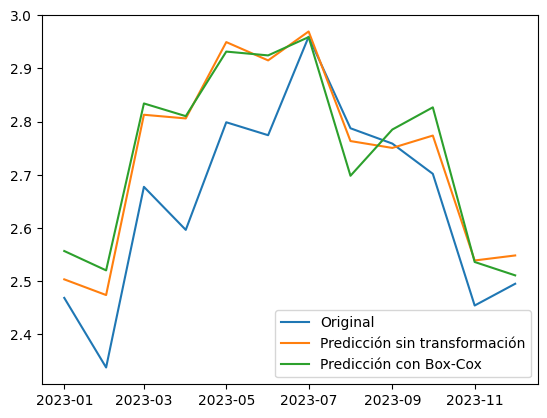

In [11]:
for alimento, data in data_train_dict.items():
    train = data['train']['CONSUMO X CAPITA']
    test = data['test']['CONSUMO X CAPITA']
    
    #Modelo simple
    modelo = ExponentialSmoothing(train, seasonal_periods=12, trend='add', seasonal='add', 
                                  initialization_method='estimated')
    modelo = modelo.fit()
    fcast = modelo.forecast(12)
    rmse = np.sqrt(mean_squared_error(test, fcast))
    
    #Modelo con Boxc-Cox
    modelo_Boxcox = ExponentialSmoothing(train, seasonal_periods=12, trend='add', seasonal='add', 
                    initialization_method='estimated',use_boxcox=True)
    modelo_Boxcox= modelo_Boxcox.fit()
    fcast_boxcox=modelo_Boxcox.forecast(12)
    rmse_boxcox = np.sqrt(mean_squared_error(test, fcast_boxcox))
    
    
    #Mostrar comparativa entre los diferentes pronósticos
    print(f'{alimento}: RMSE sin transformación:{rmse} y RMSE con Box-Cox: {rmse_boxcox}')   
    plt.plot(test, label='Original')
    plt.plot(fcast, label='Predicción sin transformación')     
    plt.plot(fcast_boxcox, label='Predicción con Box-Cox')
    plt.legend()
    plt.show()

Podemos ver como en la mayoría de series la diferencia es mínima en aplicar Box-Cox a la serie. Por este motivo, modelamos nuevamente sin aplicar transformación en la serie para guardar resultados. 

In [12]:
resultados_modelos_dict = defaultdict(lambda: defaultdict(dict))

for alimento, data in data_train_dict.items():
    train = data['train']['CONSUMO X CAPITA']
    test = data['test']['CONSUMO X CAPITA']
    
    modelo = ExponentialSmoothing(train, seasonal_periods=12, trend='add', seasonal='add', 
                                  initialization_method='estimated')
    modelo = modelo.fit()
    fcast = modelo.forecast(12)
    rmse = np.sqrt(mean_squared_error(test, fcast))
    
    resultados={}
    resultados['HOLT-WINTERS'] = {'modelo': modelo,'fcast': fcast,'RMSE':rmse}
    resultados_modelos_dict[alimento].update(resultados)
    
    #Imprimos los parámetros de cada modelo
    print(f'{alimento}-----------------------------')
    print(modelo.params_formatted)

T.FRUTAS FRESCAS-----------------------------
                     name         param  optimized
smoothing_level     alpha  5.189041e-01       True
smoothing_trend      beta  1.635756e-14       True
smoothing_seasonal  gamma  1.449497e-01       True
initial_level         l.0  6.671787e+00       True
initial_trend         b.0 -6.917299e-04       True
initial_seasons.0     s.0 -4.581434e-01       True
initial_seasons.1     s.1 -6.478217e-01       True
initial_seasons.2     s.2 -7.279260e-02       True
initial_seasons.3     s.3 -1.053713e+00       True
initial_seasons.4     s.4  2.895218e-01       True
initial_seasons.5     s.5  6.877096e-01       True
initial_seasons.6     s.6  1.549313e+00       True
initial_seasons.7     s.7  3.501617e-01       True
initial_seasons.8     s.8  6.726616e-01       True
initial_seasons.9     s.9  4.161399e-01       True
initial_seasons.10   s.10 -4.693663e-01       True
initial_seasons.11   s.11 -8.262676e-01       True
T.HORTALIZAS FRESCAS----------------

## MODELO ARIMA: AUTOARIMA

Para poder aplicar el modelo ARIMA durante el modelado siguiente, aplicaremos una transformación de diferencias regulares a la serie temporal. Esta transformación implica calcular las diferencias entre periodos consecutivos en la serie, lo que nos permite eliminar la tendencia y la estacionalidad presentes en los datos originales.
Si aplicamos una diferenciación de orden estacional a la serie y representamos gráficamente los resultados, podemos observar cómo cambian los datos transformados en comparación con la serie original. Esta representación nos ayudará a evaluar la efectividad de la transformación en hacer que la serie sea estacionaria y adecuada para el modelado ARIMA. El siguiente código aplica la diferenciación regular a la serie temporal y muestra la representación gráfica de la serie diferenciada.

Estas series temporales se considera no estacionarias debido a la presencia de estacionalidad, que se mencionó anteriormente, mostrando un comportamiento repetitivo de las autocorrelaciones cada 12 meses. Por lo tanto, es necesario aplicar una transformación a la serie para convertirla en una serie estacionaria y así poder aplicar ARIMA.

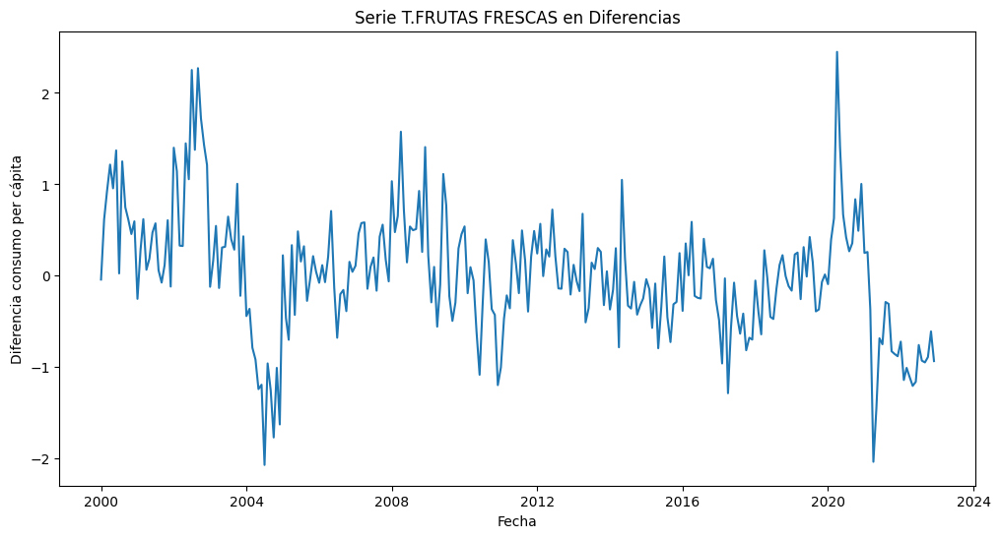

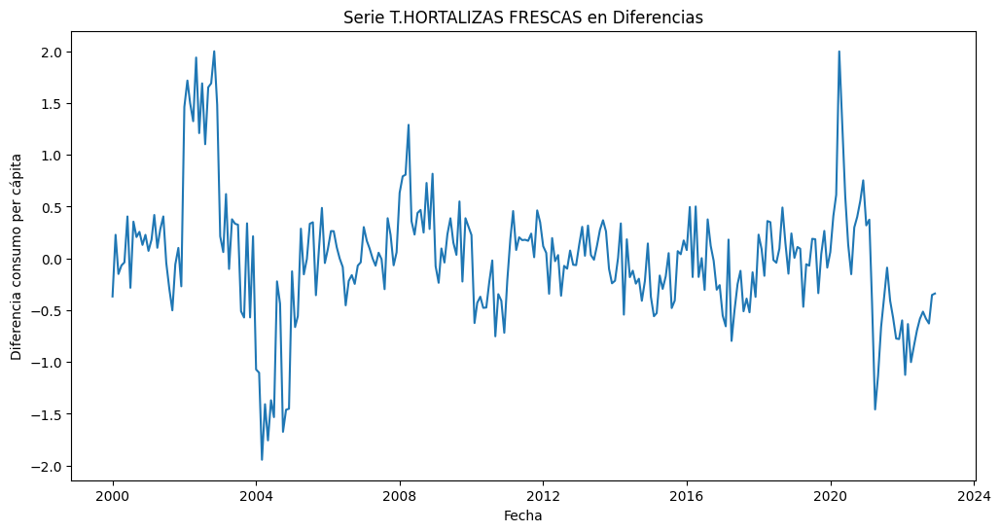

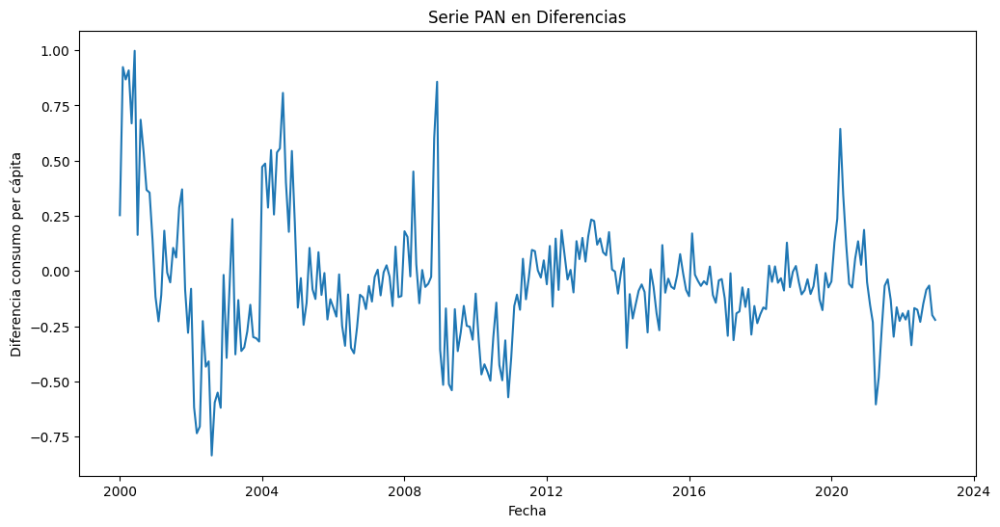

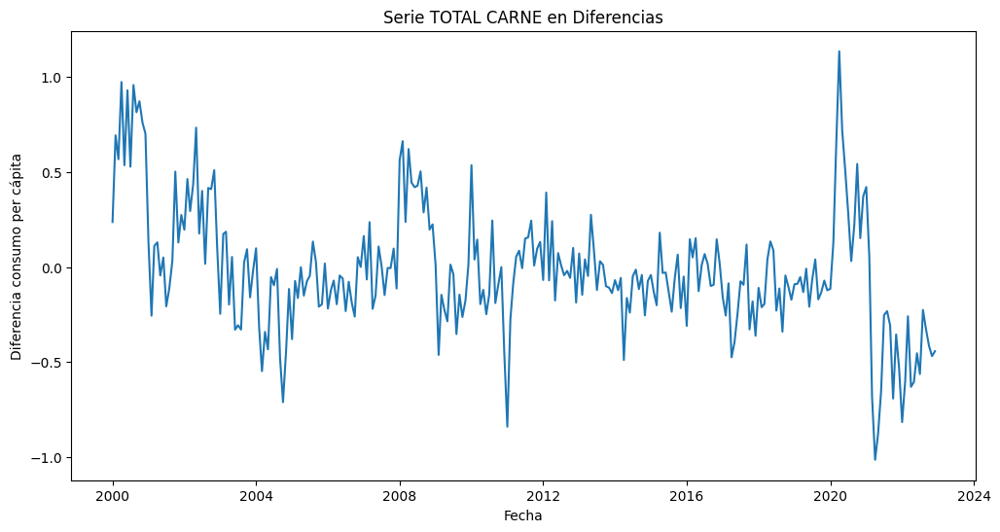

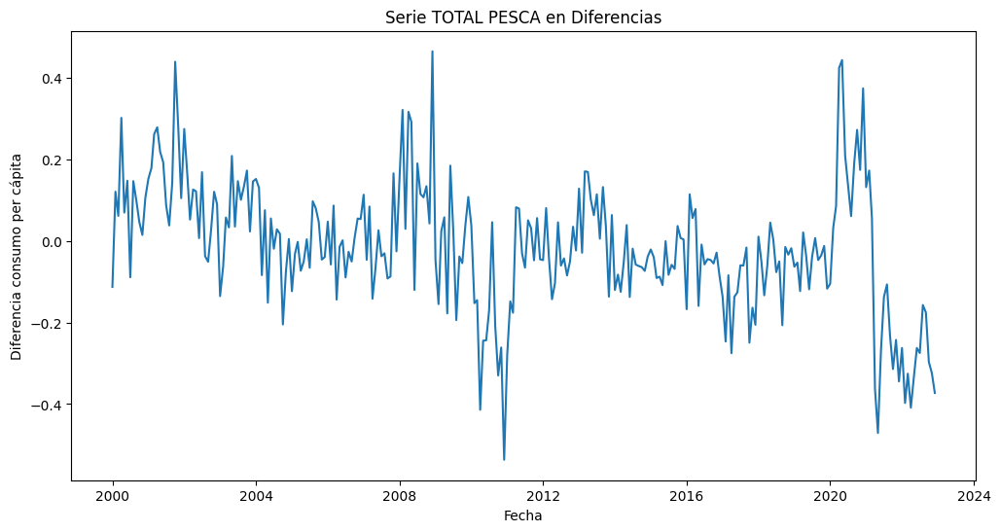

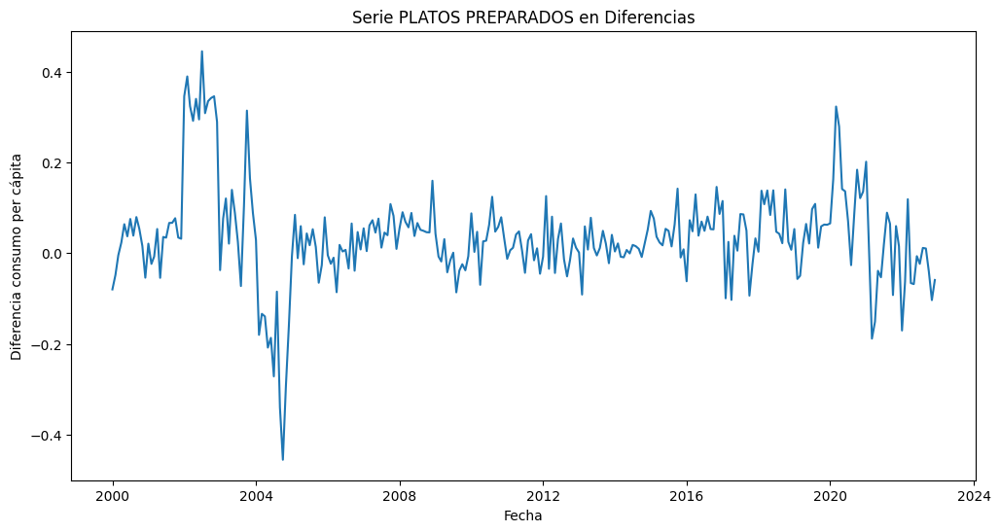

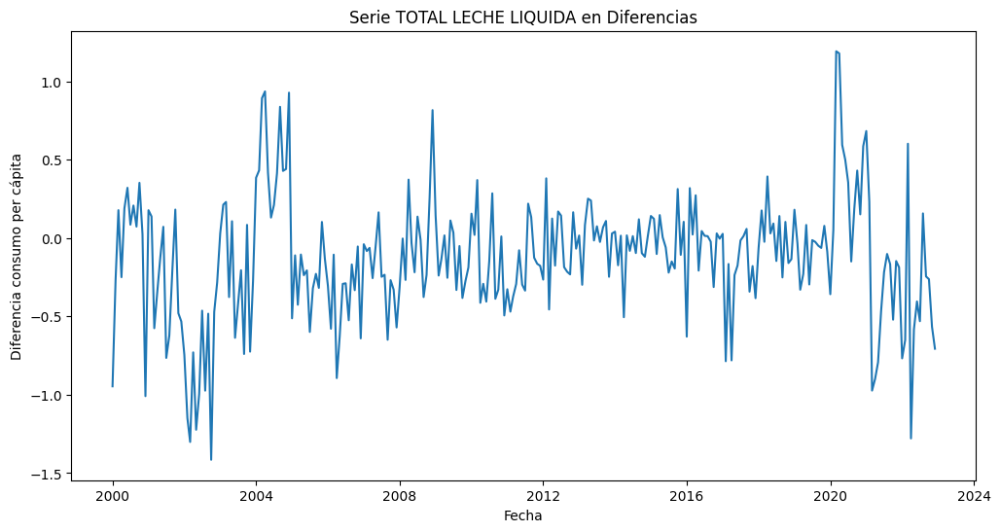

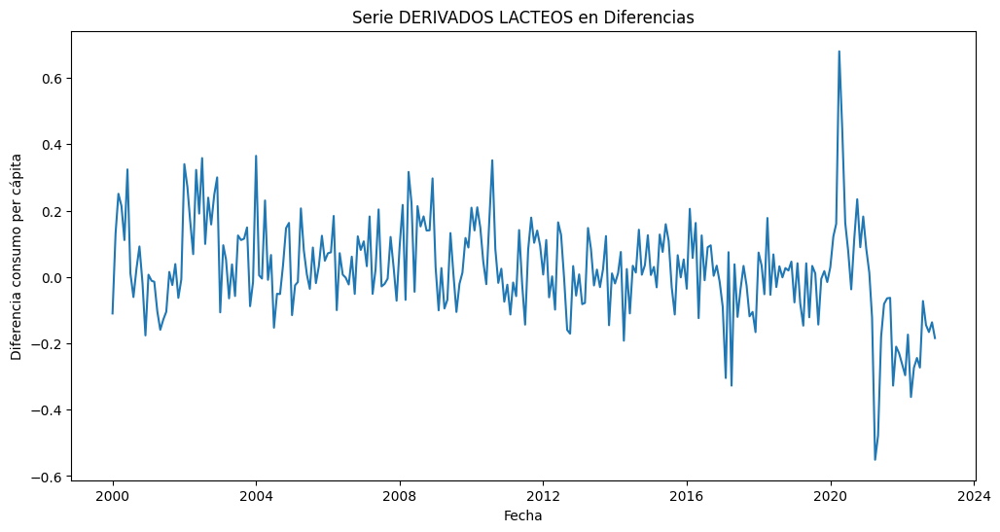

In [13]:
for alimento, data in data_train_dict.items():
    train = data['train']['CONSUMO X CAPITA']
    diferencias=train.diff(12)
    plt.figure(figsize=(12,6))
    plt.plot(diferencias)

    plt.title(f'Serie {alimento} en Diferencias')
    plt.xlabel('Fecha')
    plt.ylabel('Diferencia consumo per cápita')
    plt.show()


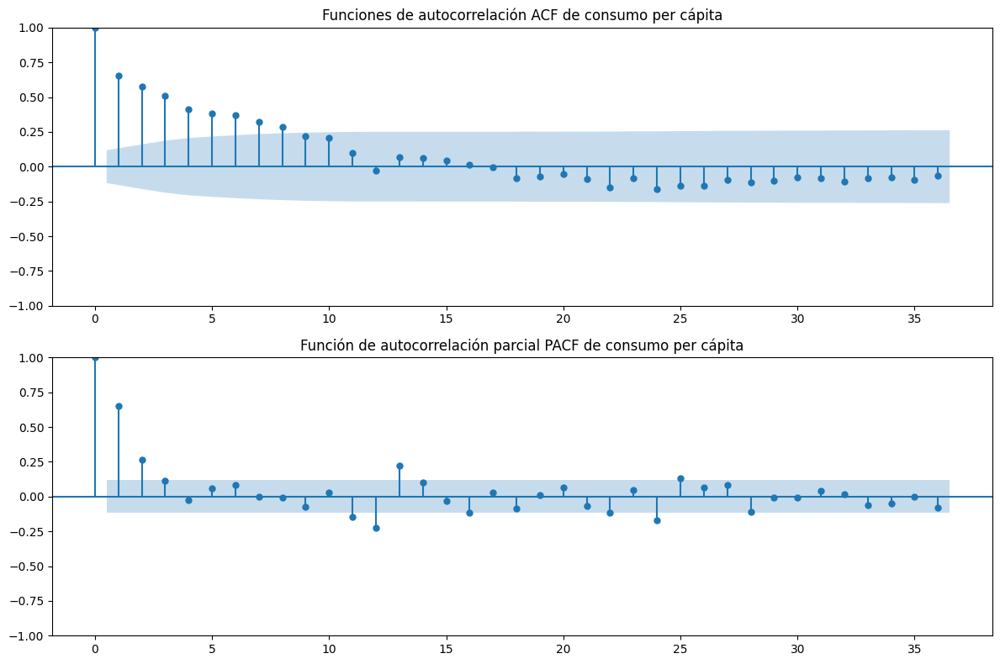

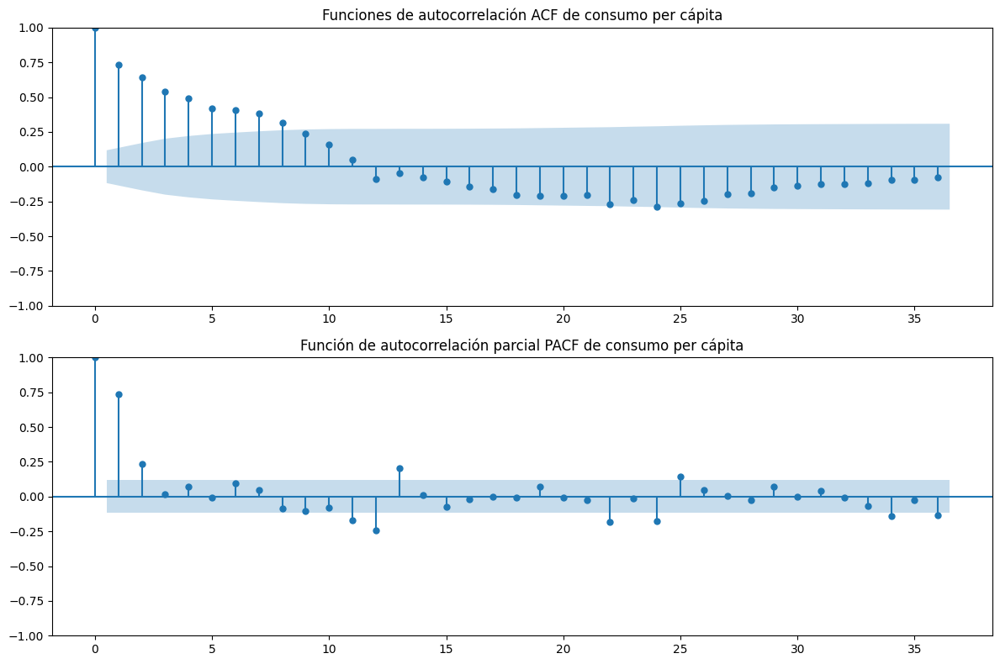

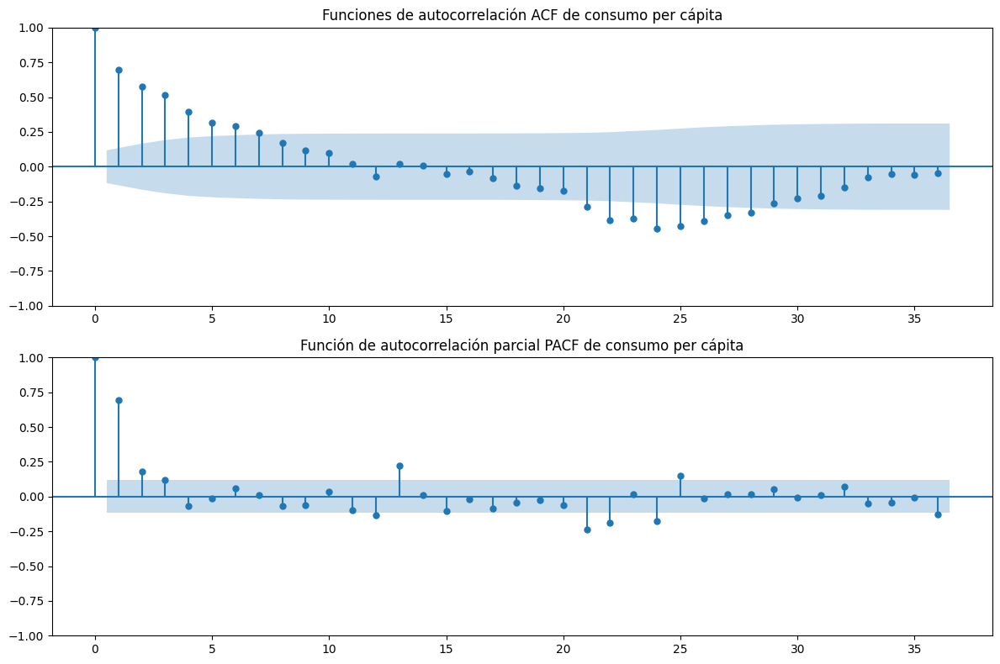

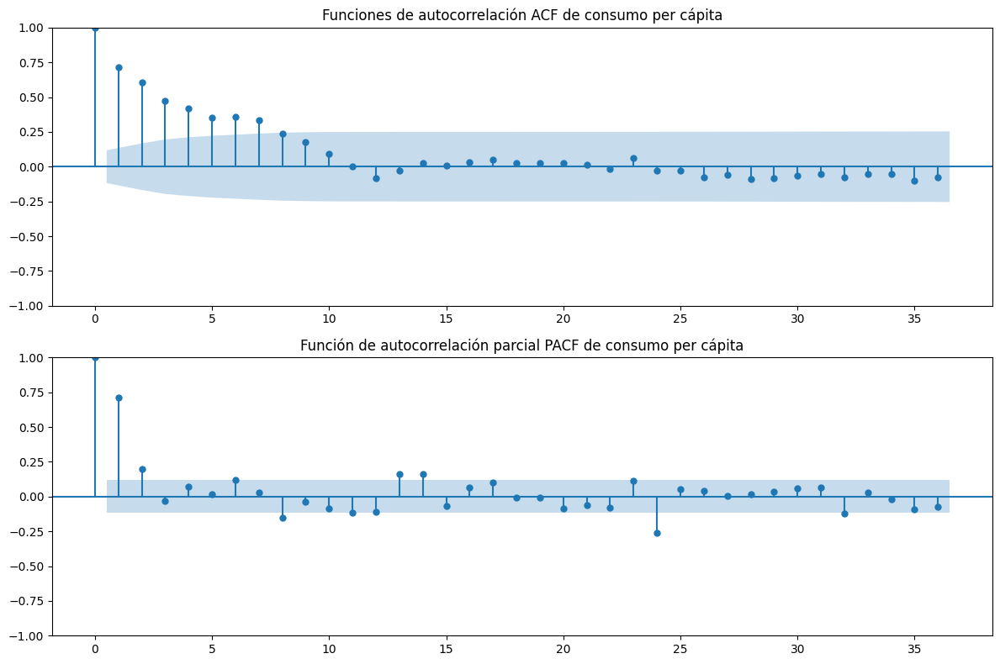

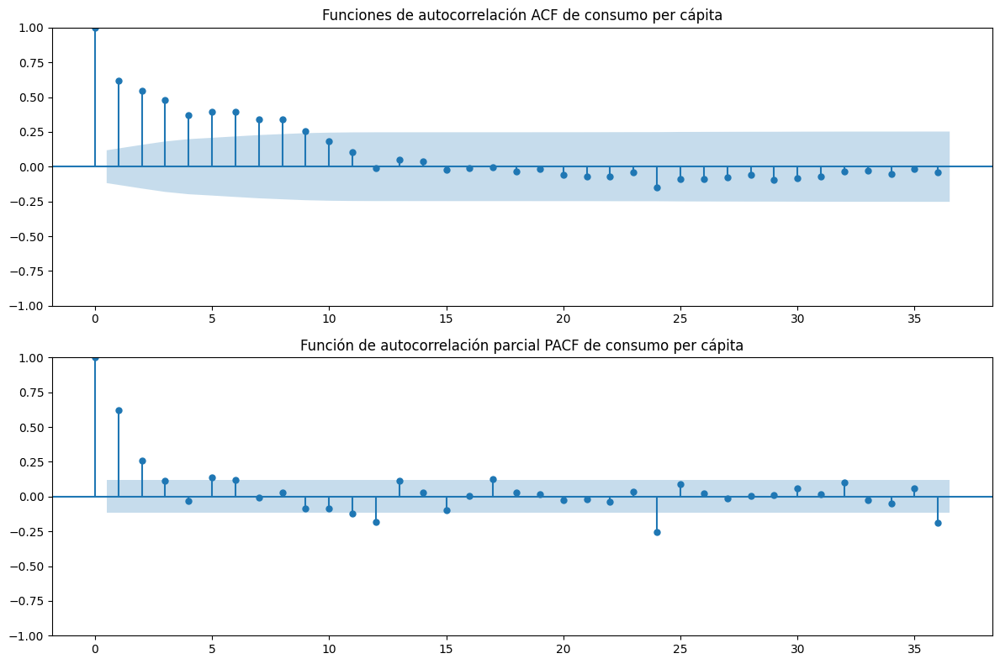

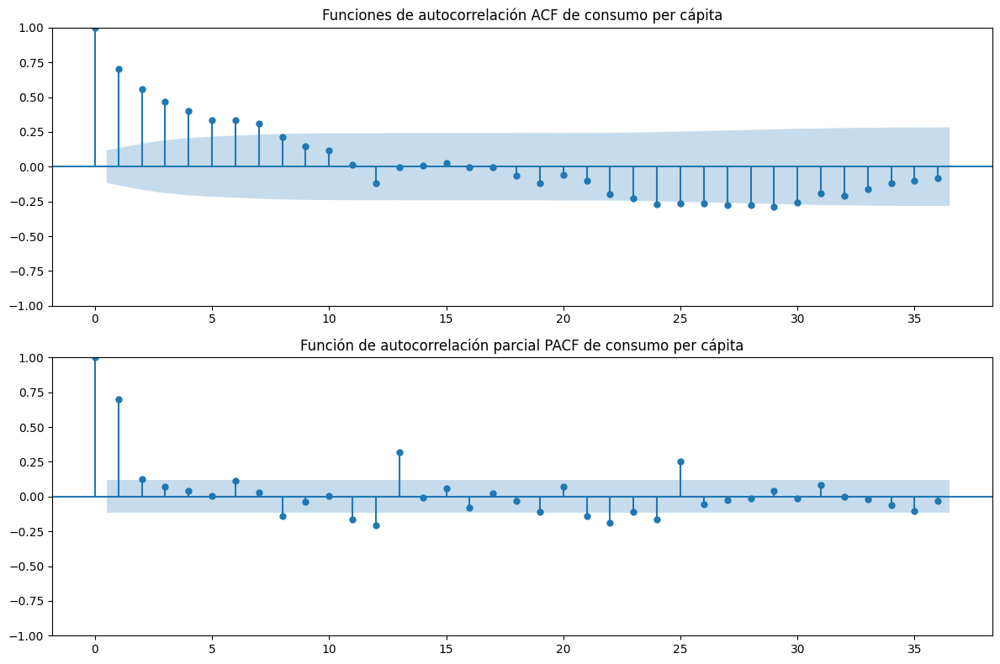

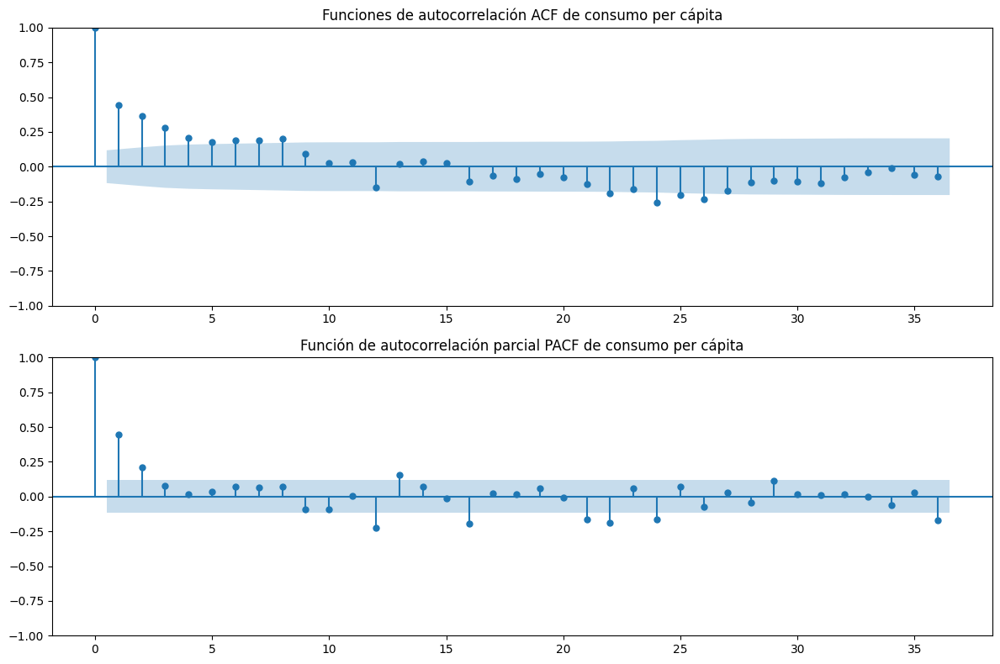

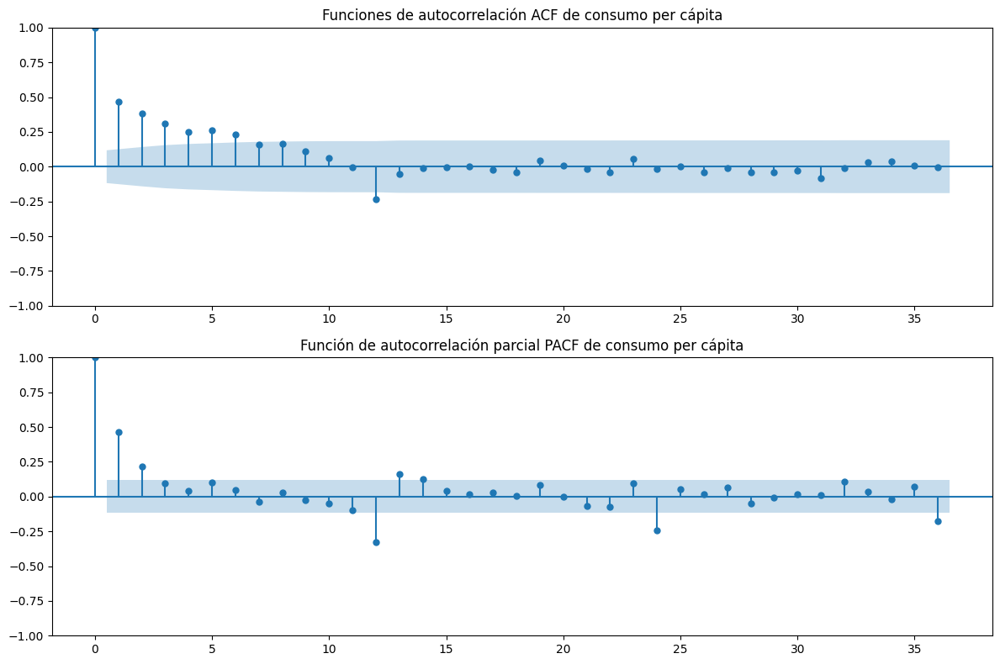

In [14]:
for alimento, data in data_train_dict.items():
    train = data['train']['CONSUMO X CAPITA']
    diferencias=train.diff(12)
    diferencias=diferencias.dropna()

    fig,(ax1,ax2)=plt.subplots(2,1,figsize=(12,8))

    plot_acf(diferencias,lags=36,ax=ax1)
    ax1.set_title('Funciones de autocorrelación ACF de consumo per cápita')

    plot_pacf(diferencias,lags=36,ax=ax2)
    ax2.set_title('Función de autocorrelación parcial PACF de consumo per cápita')

    plt.tight_layout()
    plt.show()

Podemos observar cómo el proceso se ha vuelto estacionario después de aplicar la diferenciación regular a la serie temporal. Las autocorrelaciones simples decrecen rápidamente a medida que aumenta el rezago, lo que indica la ausencia de patrones significativos de autocorrelación en los datos diferenciados. Además, observamos correlaciones distintas de cero en las autocorrelaciones parciales, lo que sugiere la presencia de información útil para el ajuste de un modelo ARIMA. Estos resultados nos indican que la serie temporal transformada es adecuada para el ajuste de un modelo ARIMA, ya que cumple con los requisitos de estacionariedad y presenta autocorrelaciones significativas que pueden ser utilizadas para modelar la dinámica de la serie.

Para agilizar el proceso de selección de modelo vamos a utilizar autoarima. El enfoque del modelo autoARIMA difiere del método manual al automatizar la selección de los órdenes óptimos del modelo (p,d,q) y (P,D,Q) mediante el método stepwise basado en el criterio AIC. Esto elimina la necesidad de definir manualmente los parámetros del modelo, lo que simplifica significativamente el proceso y facilita la identificación del mejor modelo para la serie temporal. Igualmente apoyaremos los resultados con el análisis de autocorrelación anterior y buscando un menor AIC pero a la vez un modelo simple sin gran cantidad de parámetros, siempre y cuando el AIC no difera de mucho. 

Para configurar el modelo autoARIMA, es necesario definir los rangos de búsqueda para los términos de autoregresión y media móvil, tanto para la parte no estacional como para la estacional. En este caso, los términos de autoregresión (AR) y media móvil (MA) se definen en un rango de 1 a 3, tanto para el término inicial como para el término máximo. Además, se aplica una diferenciación estacional de primer orden (D=1), indicando que se tiene en cuenta la estacionalidad en el modelo (seasonal=True).

T.FRUTAS FRESCAS
Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=333.468, Time=0.34 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=571.615, Time=0.04 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=398.802, Time=0.18 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=476.649, Time=0.17 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=569.763, Time=0.02 sec
 ARIMA(1,0,1)(0,1,0)[12] intercept   : AIC=397.490, Time=0.10 sec
 ARIMA(1,0,1)(1,1,1)[12] intercept   : AIC=326.467, Time=0.59 sec
 ARIMA(1,0,1)(1,1,0)[12] intercept   : AIC=368.904, Time=0.34 sec
 ARIMA(1,0,1)(2,1,1)[12] intercept   : AIC=328.132, Time=2.01 sec
 ARIMA(1,0,1)(1,1,2)[12] intercept   : AIC=327.893, Time=1.24 sec
 ARIMA(1,0,1)(0,1,2)[12] intercept   : AIC=325.986, Time=1.18 sec
 ARIMA(0,0,1)(0,1,2)[12] intercept   : AIC=457.820, Time=0.53 sec
 ARIMA(1,0,0)(0,1,2)[12] intercept   : AIC=360.120, Time=0.58 sec
 ARIMA(2,0,1)(0,1,2)[12] intercept   : AIC=327.937, Time=1.87 sec
 ARIMA(1,0,2)(0,

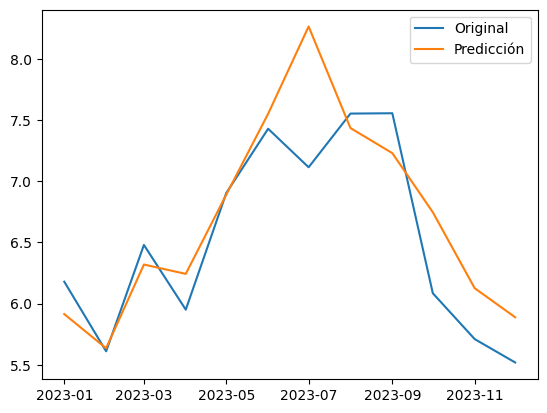

T.HORTALIZAS FRESCAS
Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=193.331, Time=0.54 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=495.848, Time=0.07 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=258.213, Time=0.19 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=350.448, Time=0.21 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=493.860, Time=0.02 sec
 ARIMA(1,0,1)(0,1,0)[12] intercept   : AIC=271.441, Time=0.10 sec
 ARIMA(1,0,1)(1,1,1)[12] intercept   : AIC=189.053, Time=0.87 sec
 ARIMA(1,0,1)(1,1,0)[12] intercept   : AIC=240.379, Time=0.30 sec
 ARIMA(1,0,1)(2,1,1)[12] intercept   : AIC=188.648, Time=2.17 sec
 ARIMA(1,0,1)(2,1,0)[12] intercept   : AIC=214.639, Time=0.74 sec
 ARIMA(1,0,1)(2,1,2)[12] intercept   : AIC=190.634, Time=2.57 sec
 ARIMA(1,0,1)(1,1,2)[12] intercept   : AIC=188.462, Time=1.87 sec
 ARIMA(1,0,1)(0,1,2)[12] intercept   : AIC=187.701, Time=1.05 sec
 ARIMA(0,0,1)(0,1,2)[12] intercept   : AIC=inf, Time=0.68 sec
 ARIMA(1,0,0)(0,

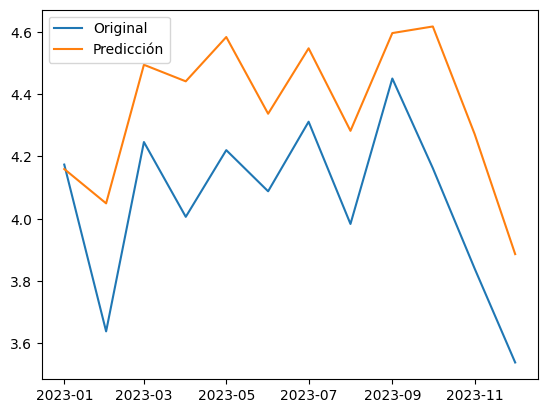

PAN
Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=-161.529, Time=0.70 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=84.081, Time=0.03 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=-117.439, Time=0.22 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=-72.783, Time=0.40 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=92.866, Time=0.03 sec
 ARIMA(1,0,1)(0,1,0)[12] intercept   : AIC=-110.176, Time=0.18 sec
 ARIMA(1,0,1)(1,1,1)[12] intercept   : AIC=-165.540, Time=0.82 sec
 ARIMA(1,0,1)(1,1,0)[12] intercept   : AIC=-129.683, Time=0.46 sec
 ARIMA(1,0,1)(2,1,1)[12] intercept   : AIC=-169.425, Time=1.94 sec
 ARIMA(1,0,1)(2,1,0)[12] intercept   : AIC=-159.618, Time=1.25 sec
 ARIMA(1,0,1)(2,1,2)[12] intercept   : AIC=-167.428, Time=2.24 sec
 ARIMA(1,0,1)(1,1,2)[12] intercept   : AIC=-167.027, Time=1.84 sec
 ARIMA(0,0,1)(2,1,1)[12] intercept   : AIC=-111.053, Time=0.91 sec
 ARIMA(1,0,0)(2,1,1)[12] intercept   : AIC=-160.778, Time=1.05 sec
 ARIMA(2,0,1)(2,1,1)

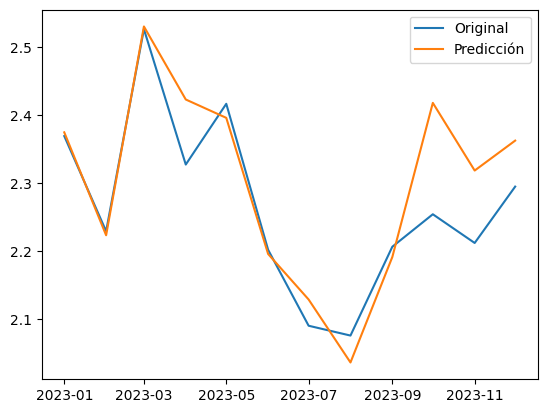

TOTAL CARNE
Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=-68.593, Time=0.46 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=169.445, Time=0.04 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=-37.692, Time=0.22 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=58.546, Time=0.27 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=168.354, Time=0.03 sec
 ARIMA(1,0,1)(0,1,0)[12] intercept   : AIC=-36.762, Time=0.14 sec
 ARIMA(1,0,1)(1,1,1)[12] intercept   : AIC=-78.527, Time=1.20 sec
 ARIMA(1,0,1)(1,1,0)[12] intercept   : AIC=-54.144, Time=0.35 sec
 ARIMA(1,0,1)(2,1,1)[12] intercept   : AIC=-76.597, Time=2.02 sec
 ARIMA(1,0,1)(1,1,2)[12] intercept   : AIC=-76.201, Time=2.14 sec
 ARIMA(1,0,1)(0,1,2)[12] intercept   : AIC=-77.257, Time=1.39 sec
 ARIMA(1,0,1)(2,1,0)[12] intercept   : AIC=-61.697, Time=1.13 sec
 ARIMA(1,0,1)(2,1,2)[12] intercept   : AIC=-74.532, Time=2.19 sec
 ARIMA(0,0,1)(1,1,1)[12] intercept   : AIC=46.831, Time=0.53 sec
 ARIMA(1,0,0)(1,1,1)[12

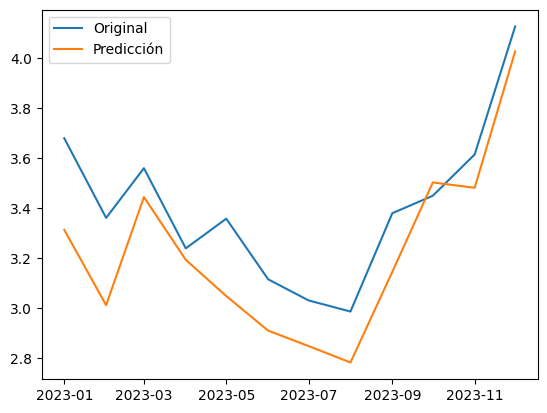

TOTAL PESCA
Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=-435.368, Time=0.77 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=-232.607, Time=0.04 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=-376.671, Time=0.34 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=-314.876, Time=0.29 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=-231.941, Time=0.02 sec
 ARIMA(1,0,1)(0,1,0)[12] intercept   : AIC=-391.650, Time=0.15 sec
 ARIMA(1,0,1)(1,1,1)[12] intercept   : AIC=-443.981, Time=0.88 sec
 ARIMA(1,0,1)(1,1,0)[12] intercept   : AIC=-406.566, Time=0.79 sec
 ARIMA(1,0,1)(2,1,1)[12] intercept   : AIC=-447.821, Time=2.01 sec
 ARIMA(1,0,1)(2,1,0)[12] intercept   : AIC=-427.678, Time=1.59 sec
 ARIMA(1,0,1)(2,1,2)[12] intercept   : AIC=-442.014, Time=2.25 sec
 ARIMA(1,0,1)(1,1,2)[12] intercept   : AIC=-445.638, Time=2.02 sec
 ARIMA(0,0,1)(2,1,1)[12] intercept   : AIC=-331.137, Time=0.86 sec
 ARIMA(1,0,0)(2,1,1)[12] intercept   : AIC=-418.286, Time=1.48 sec
 ARIMA(

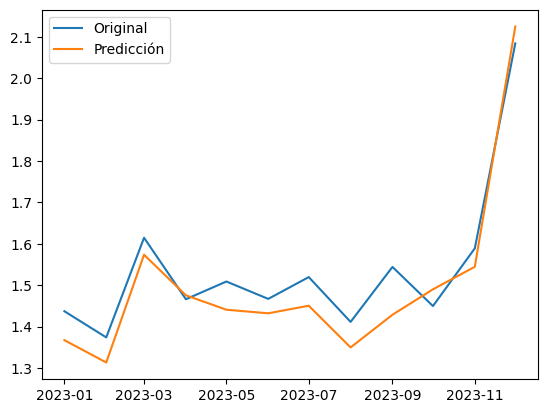

PLATOS PREPARADOS
Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=-739.301, Time=0.81 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=-447.826, Time=0.04 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=-674.882, Time=0.34 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=-602.255, Time=0.59 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=-421.880, Time=0.02 sec
 ARIMA(1,0,1)(0,1,0)[12] intercept   : AIC=-638.909, Time=0.24 sec
 ARIMA(1,0,1)(1,1,1)[12] intercept   : AIC=-738.189, Time=1.02 sec
 ARIMA(1,0,1)(0,1,2)[12] intercept   : AIC=-738.838, Time=2.01 sec
 ARIMA(1,0,1)(1,1,0)[12] intercept   : AIC=-681.787, Time=0.56 sec
 ARIMA(1,0,1)(1,1,2)[12] intercept   : AIC=-737.238, Time=2.07 sec
 ARIMA(1,0,0)(0,1,1)[12] intercept   : AIC=-729.781, Time=0.46 sec
 ARIMA(2,0,1)(0,1,1)[12] intercept   : AIC=-739.057, Time=0.88 sec
 ARIMA(1,0,2)(0,1,1)[12] intercept   : AIC=-741.456, Time=1.12 sec
 ARIMA(1,0,2)(0,1,0)[12] intercept   : AIC=-637.797, Time=0.36 sec
 

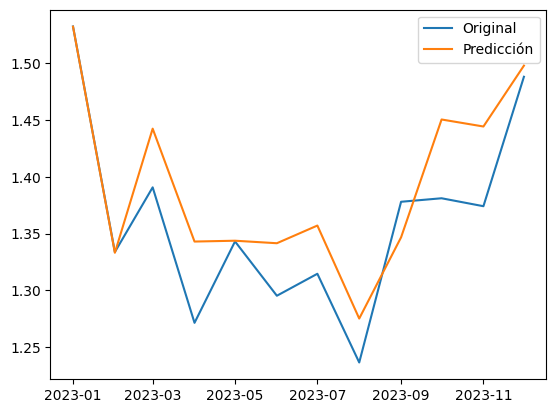

TOTAL LECHE LIQUIDA
Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=143.463, Time=0.42 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=271.943, Time=0.06 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=192.823, Time=0.16 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=196.521, Time=0.21 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=298.420, Time=0.03 sec
 ARIMA(1,0,1)(0,1,0)[12] intercept   : AIC=199.577, Time=0.11 sec
 ARIMA(1,0,1)(1,1,1)[12] intercept   : AIC=140.426, Time=0.82 sec
 ARIMA(1,0,1)(1,1,0)[12] intercept   : AIC=176.730, Time=0.31 sec
 ARIMA(1,0,1)(2,1,1)[12] intercept   : AIC=139.762, Time=1.55 sec
 ARIMA(1,0,1)(2,1,0)[12] intercept   : AIC=153.109, Time=1.16 sec
 ARIMA(1,0,1)(2,1,2)[12] intercept   : AIC=141.585, Time=2.25 sec
 ARIMA(1,0,1)(1,1,2)[12] intercept   : AIC=140.886, Time=1.91 sec
 ARIMA(0,0,1)(2,1,1)[12] intercept   : AIC=184.159, Time=0.70 sec
 ARIMA(1,0,0)(2,1,1)[12] intercept   : AIC=156.925, Time=0.94 sec
 ARIMA(2,0,1)

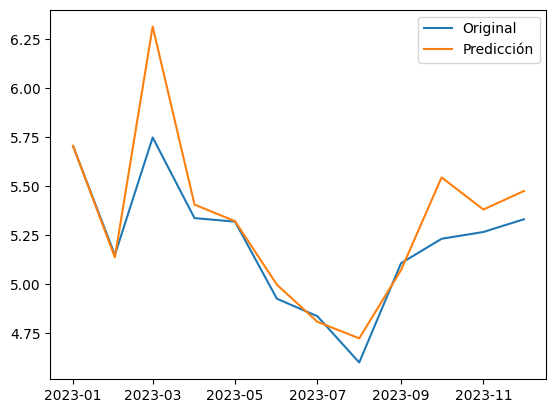

DERIVADOS LACTEOS
Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[12] intercept   : AIC=-446.818, Time=0.84 sec
 ARIMA(0,0,0)(0,1,0)[12] intercept   : AIC=-279.514, Time=0.05 sec
 ARIMA(1,0,0)(1,1,0)[12] intercept   : AIC=-377.805, Time=0.26 sec
 ARIMA(0,0,1)(0,1,1)[12] intercept   : AIC=-359.325, Time=0.28 sec
 ARIMA(0,0,0)(0,1,0)[12]             : AIC=-274.605, Time=0.02 sec
 ARIMA(1,0,1)(0,1,0)[12] intercept   : AIC=-360.906, Time=0.20 sec
 ARIMA(1,0,1)(1,1,1)[12] intercept   : AIC=-445.185, Time=1.01 sec
 ARIMA(1,0,1)(0,1,2)[12] intercept   : AIC=-445.245, Time=1.90 sec
 ARIMA(1,0,1)(1,1,0)[12] intercept   : AIC=-407.516, Time=0.50 sec
 ARIMA(1,0,1)(1,1,2)[12] intercept   : AIC=-443.449, Time=2.04 sec
 ARIMA(1,0,0)(0,1,1)[12] intercept   : AIC=-410.001, Time=0.59 sec
 ARIMA(2,0,1)(0,1,1)[12] intercept   : AIC=-448.061, Time=0.92 sec
 ARIMA(2,0,1)(0,1,0)[12] intercept   : AIC=-359.023, Time=0.25 sec
 ARIMA(2,0,1)(1,1,1)[12] intercept   : AIC=-438.156, Time=1.03 sec
 

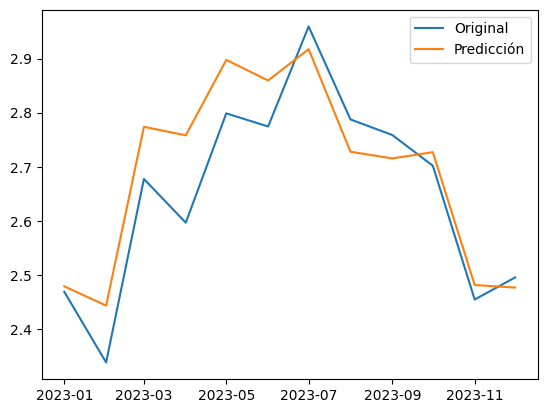

In [15]:
for alimento, data in data_train_dict.items():
    train = data['train']['CONSUMO X CAPITA']
    test = data['test']['CONSUMO X CAPITA']
    
    print(alimento)
    #Modelo
    modelo=pm.auto_arima(train,start_p=1,start_q=1,max_p=3,max_q=3,m=12,start_P=0,seasonal=True,d=0,D=1,
                               trace=True,error_action='ignore',suppress_warnings=True,stepwise=True,verbose=False)
    fcast = modelo.predict(n_periods=12)
    rmse = np.sqrt(mean_squared_error(test, fcast))   
    
    #Mostrar pronósticos
    print(f'{alimento}: RMSE:{rmse}')   
    plt.plot(test, label='Original')
    plt.plot(fcast, label='Predicción')     
    plt.legend()
    plt.show()

Para los resultados del AUTOARIMA revisamos por cada grupo de alimento todos los modelos obtenidos para comparar los modelos con menor número de parámetros y menor AIC dado que el mejor modelo seleccionado solo busca menor AIC. Además nos apayoremos también en los resultados de las autocorrelaciones ACF y PACF anteriores. 
Los modelos seleccionados para cada serie corresponden al ARIMA(1,0,1)(0,1,1)[12]. El único caso en el que este modelo fue el mejor según la selección automática de auto_arima fue en la serie de derivados lácteos. En las demás series, se optó por simplificar el modelo, ya que las diferencias en el criterio AIC eran mínimas.
A continuación, se ajusta un modelo ARIMA para cada serie utilizando el modelo seleccionado y se almacena en un diccionario para su posterior análisis.

In [16]:
for alimento, data in data_train_dict.items():
    train = data['train']['CONSUMO X CAPITA']
    test = data['test']['CONSUMO X CAPITA']
    
    modelo=sm.tsa.ARIMA(train,order=(1,0,1),seasonal_order=(0,1,1,12))
    
    modelo=modelo.fit()
    fcast= modelo.get_forecast(steps=12)
    fcast=fcast.predicted_mean
    rmse = np.sqrt(mean_squared_error(test, fcast))
    
    resultados={}
    resultados['ARIMA']= {'modelo': modelo,'fcast': fcast,'RMSE':rmse}
    resultados_modelos_dict[alimento].update(resultados) 
    
    
    #Imprimos los parámetros de cada modelo
    print(f'{alimento}-----------------------------')
    print(rmse)
    print(f'{modelo.summary()}\n')
    

T.FRUTAS FRESCAS-----------------------------
0.468305242578307
                                    SARIMAX Results                                     
Dep. Variable:                 CONSUMO X CAPITA   No. Observations:                  288
Model:             ARIMA(1, 0, 1)x(0, 1, 1, 12)   Log Likelihood                -161.735
Date:                          Sat, 14 Sep 2024   AIC                            331.470
Time:                                  18:56:51   BIC                            345.951
Sample:                              01-01-1999   HQIC                           337.281
                                   - 12-01-2022                                         
Covariance Type:                            opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9451      0.021     45.503      0.000       0.904

PLATOS PREPARADOS-----------------------------
0.034193818165397225
                                    SARIMAX Results                                     
Dep. Variable:                 CONSUMO X CAPITA   No. Observations:                  288
Model:             ARIMA(1, 0, 1)x(0, 1, 1, 12)   Log Likelihood                 370.444
Date:                          Sat, 14 Sep 2024   AIC                           -732.887
Time:                                  18:56:53   BIC                           -718.406
Sample:                              01-01-1999   HQIC                          -727.076
                                   - 12-01-2022                                         
Covariance Type:                            opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9676      0.014     70.467      0.000       0

Nuevamente con el código anterior mostramos los resultados de cada modelo seleccionado y analizamos sus parámetros. Nos fijamos en el p-valor, y observamos como todas las series presentan p-valores por debajo de 0.05 siendo todos ellos significativos. 

Por último, procedemos con la diagnosis del modelo, donde evaluaremos su idoneidad examinando la significancia estadística de sus parámetros y verificaremos que se cumplan las suposiciones del modelo mediante el análisis de sus residuos. Para confirmar que los residuos no están autocorrelacionados, es decir, que no exhiben ninguna dependencia entre sí que no haya sido capturada por el modelo, llevamos a cabo un diagnóstico del comportamiento de los residuos

- Comprobamos que todos los coeficientes se encuentren dentro de los límites de confianza en el gráfico del correlograma. Como podemos observar, todos están dentro, lo que indica que estas autocorrelaciones son cercanas a cero.
- En el gráfico superior izquierdo, verificamos que los residuos tienen una media de 0.
- Por último, en los dos gráficos restantes, comprobamos que los residuos siguen una distribución normal. En el gráfico Q-Q, se ajusta a una recta, y en el histograma, vemos que la distribución suavizada y la distribución normal son muy similares.

Para validar estas observaciones de manera más robusta, aplicamos el contraste de Ljung-Box sobre las autocorrelaciones, esto lo podemos visualizar en el resumen del modelo anterior. Como el p-valor es mayor que 0.05 en todos los modelos, debemos aceptar la hipótesis nula de que no hay autocorrelación residual en los residuos del modelo. Por lo tanto, podemos afirmar que los residuos son incorrelados o aleatorios. Esto sugiere que con estos modelos hemos explicado toda la dependencia observada en los datos.

T.FRUTAS FRESCAS


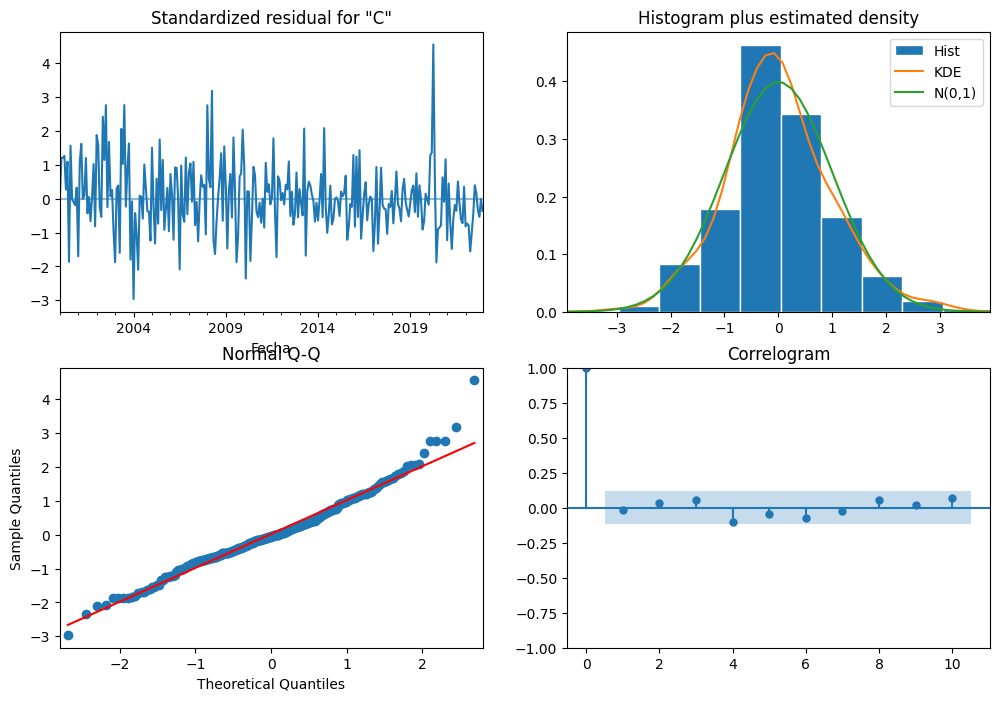

T.HORTALIZAS FRESCAS


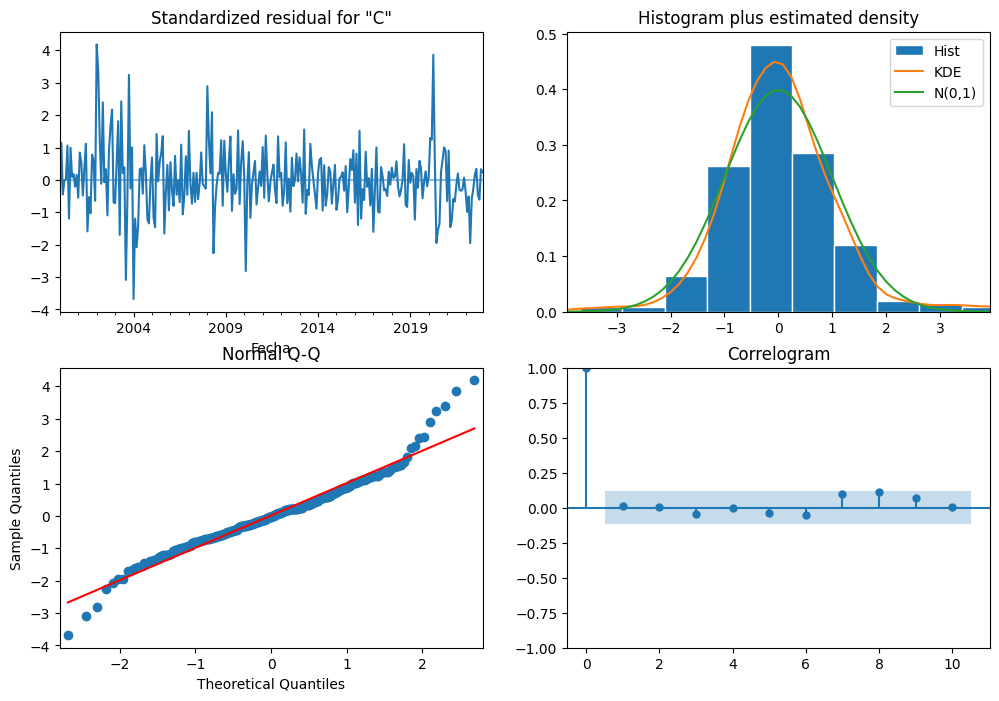

PAN


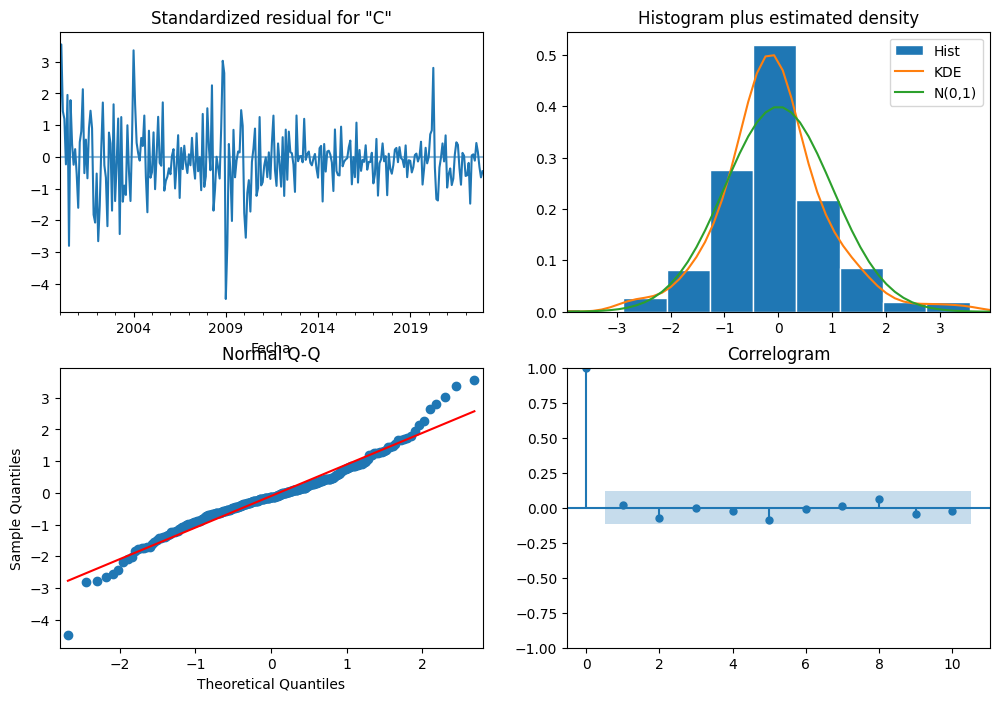

TOTAL CARNE


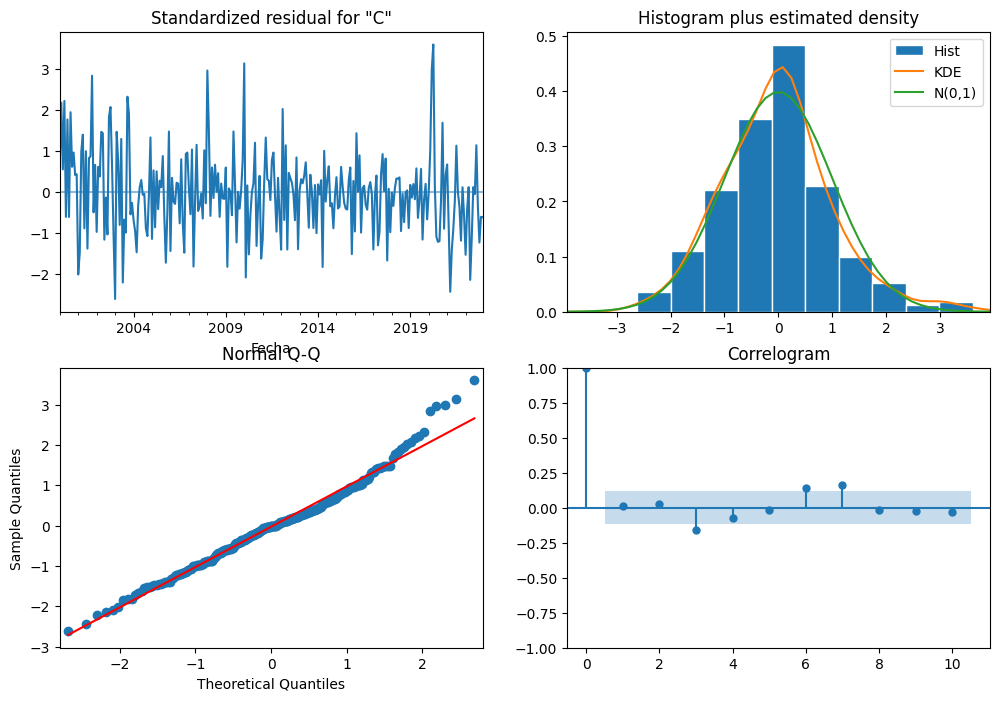

TOTAL PESCA


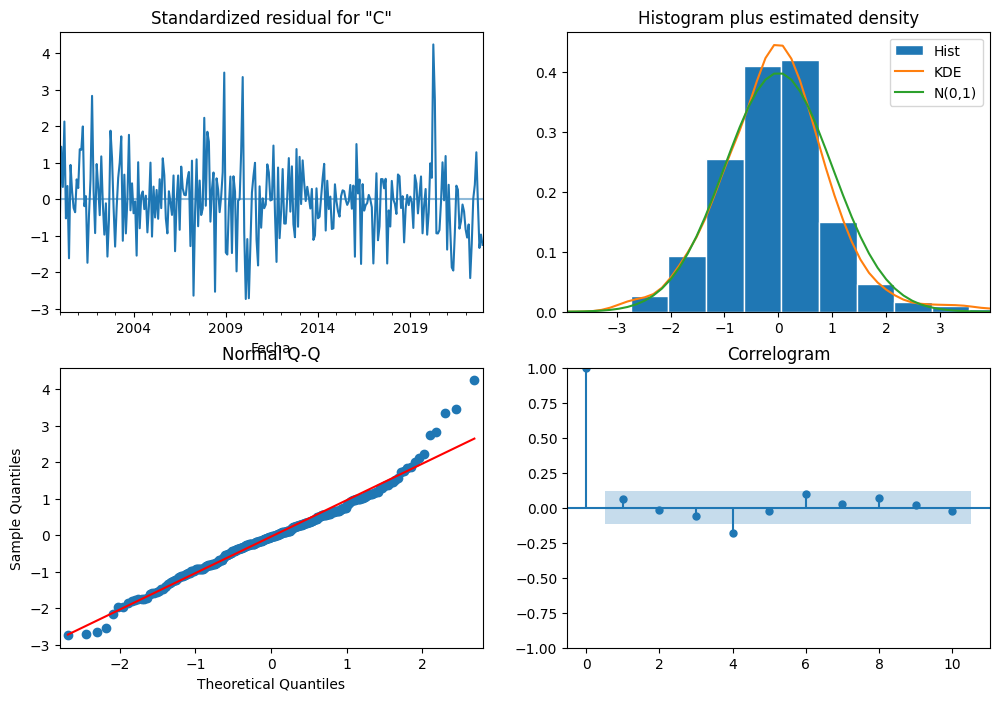

PLATOS PREPARADOS


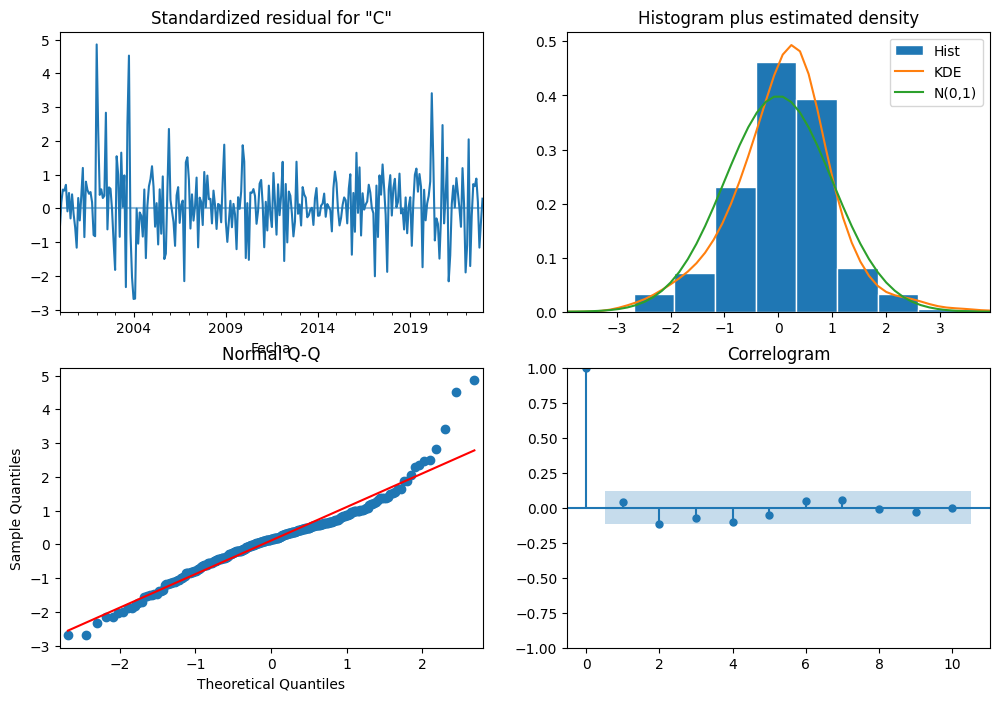

TOTAL LECHE LIQUIDA


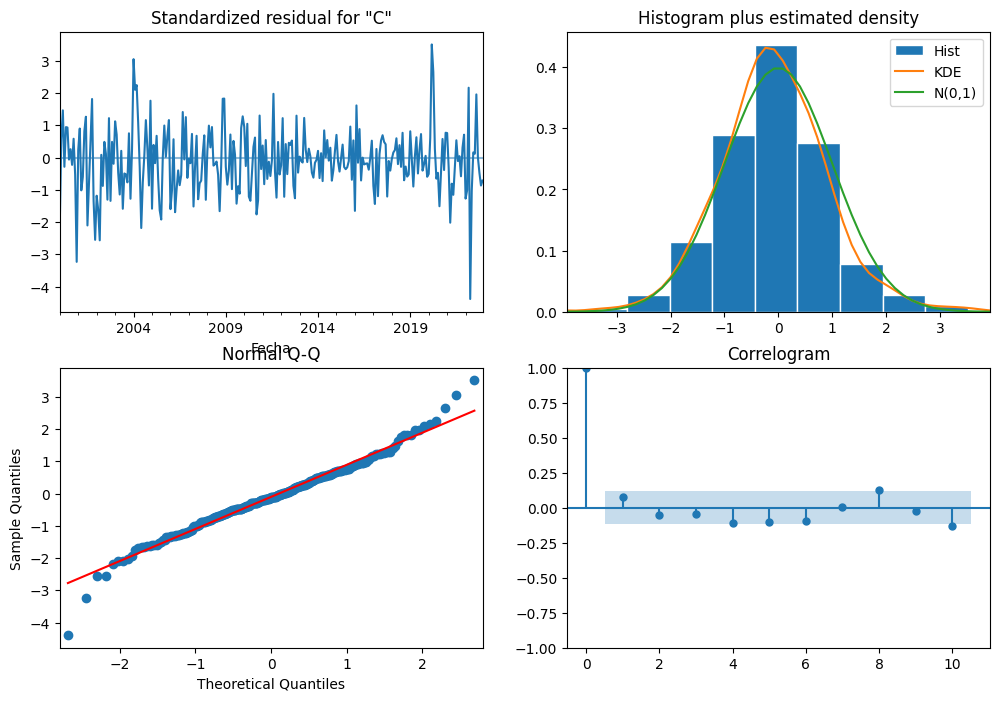

DERIVADOS LACTEOS


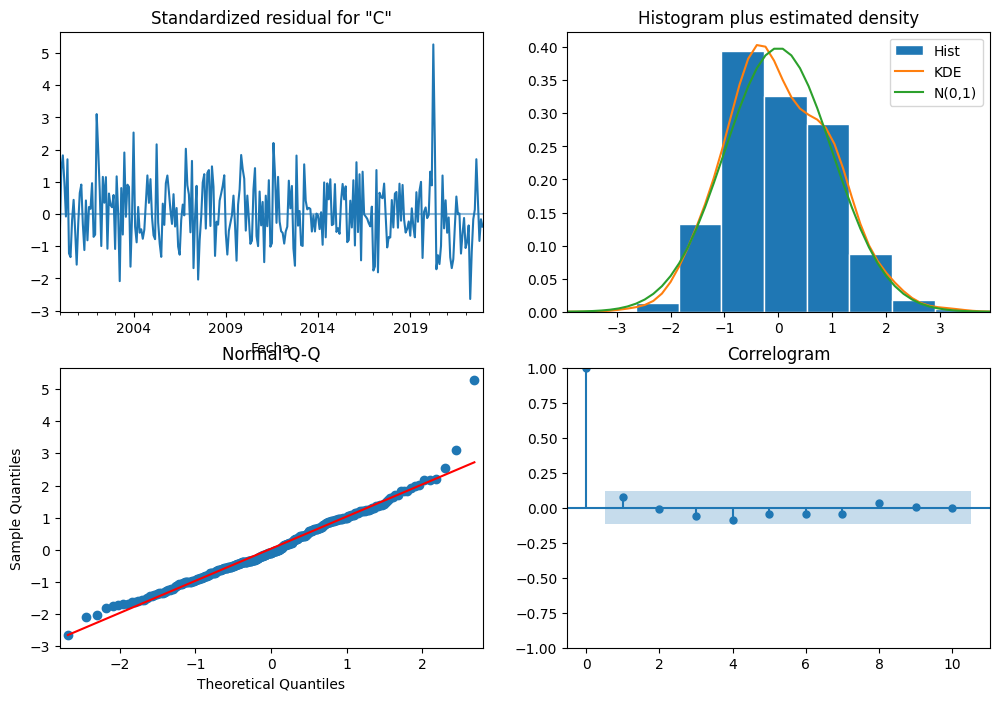

In [17]:
for alimento, modelo in resultados_modelos_dict.items():
    print(alimento)
    modelo['ARIMA']['modelo'].plot_diagnostics(figsize=(12,8))
    plt.show()

## MODELO AUTOREGRESIVO: FORECASTER AUTOREG + BASE LINE

El Base Line es un modelado simple de autoregresivo para ver si vale la pena aplicar tecnicas de machine learning de mayor complejidad o simplificamos el modelo

In [18]:
modelo_AR = ForecasterEquivalentDate(
                 offset    = pd.DateOffset(months=12),
                 n_offsets=2,
                 agg_func  = np.mean 
             )


regressors = [
    ('RandomForest', RandomForestRegressor(random_state=123)),
    ('LGBM', LGBMRegressor(random_state=123, verbose=-1)),
    ('Linear', LinearRegression()),
    ('BaseLine',modelo_AR)
     ]

for alimento, data in data_train_dict.items():
    train = data['train']['CONSUMO X CAPITA']
    test = data['test']['CONSUMO X CAPITA']
    for name, regressor in regressors:
        if name != 'BaseLine':
            modelo = ForecasterAutoreg(
                regressor = regressor,
                lags      = 12
            )
            modelo.fit(train)
        else:
            modelo = regressor
            modelo.fit(train)

        fcast = modelo.predict(steps=12)
        rmse = np.sqrt(mean_squared_error(test, fcast))
        
        resultados={}
        resultados[name]= {'modelo': modelo,'fcast': fcast,'RMSE':rmse}
        resultados_modelos_dict[alimento].update(resultados)
        
        #Imprimos los parámetros de cada modelo
        print(f'{alimento}-----------------------------')
        print(rmse)
        print(f'{modelo}\n')

T.FRUTAS FRESCAS-----------------------------
0.6413785691660842
ForecasterAutoreg 
Regressor: RandomForestRegressor(random_state=123) 
Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12] 
Transformer for y: None 
Transformer for exog: None 
Window size: 12 
Weight function included: False 
Differentiation order: None 
Exogenous included: False 
Exogenous variables names: None 
Training range: [Timestamp('1999-01-01 00:00:00'), Timestamp('2022-12-01 00:00:00')] 
Training index type: DatetimeIndex 
Training index frequency: MS 
Regressor parameters: {'bootstrap': True, 'ccp_alpha': 0.0, 'criterion': 'squared_error', 'max_depth': None, 'max_features': 1.0, 'max_leaf_nodes': None, 'max_samples': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'n_estimators': 100, 'n_jobs': None, 'oob_score': False, 'random_state': 123, 'verbose': 0, 'warm_start': False} 
fit_kwargs: {} 
Creation date: 2024-09-14 18:56:58 
Last fit date: 2024-09-1

TOTAL CARNE-----------------------------
0.38181093551413386
ForecasterAutoreg 
Regressor: RandomForestRegressor(random_state=123) 
Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12] 
Transformer for y: None 
Transformer for exog: None 
Window size: 12 
Weight function included: False 
Differentiation order: None 
Exogenous included: False 
Exogenous variables names: None 
Training range: [Timestamp('1999-01-01 00:00:00'), Timestamp('2022-12-01 00:00:00')] 
Training index type: DatetimeIndex 
Training index frequency: MS 
Regressor parameters: {'bootstrap': True, 'ccp_alpha': 0.0, 'criterion': 'squared_error', 'max_depth': None, 'max_features': 1.0, 'max_leaf_nodes': None, 'max_samples': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'n_estimators': 100, 'n_jobs': None, 'oob_score': False, 'random_state': 123, 'verbose': 0, 'warm_start': False} 
fit_kwargs: {} 
Creation date: 2024-09-14 18:56:59 
Last fit date: 2024-09-14 18

TOTAL LECHE LIQUIDA-----------------------------
0.33324754047963245
ForecasterAutoreg 
Regressor: RandomForestRegressor(random_state=123) 
Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12] 
Transformer for y: None 
Transformer for exog: None 
Window size: 12 
Weight function included: False 
Differentiation order: None 
Exogenous included: False 
Exogenous variables names: None 
Training range: [Timestamp('1999-01-01 00:00:00'), Timestamp('2022-12-01 00:00:00')] 
Training index type: DatetimeIndex 
Training index frequency: MS 
Regressor parameters: {'bootstrap': True, 'ccp_alpha': 0.0, 'criterion': 'squared_error', 'max_depth': None, 'max_features': 1.0, 'max_leaf_nodes': None, 'max_samples': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'n_estimators': 100, 'n_jobs': None, 'oob_score': False, 'random_state': 123, 'verbose': 0, 'warm_start': False} 
fit_kwargs: {} 
Creation date: 2024-09-14 18:57:00 
Last fit date: 2024-

## MODELO CON RNN

In [19]:
for alimento, data in data_train_dict.items():
    train = data['train']
    test = data['test']

    series = ["CONSUMO X CAPITA"] 
    levels = ["CONSUMO X CAPITA"] 
    lags = 36 
    steps = 12

    model = create_and_compile_model(
        series=train[series],
        levels=levels, 
        lags=lags,
        steps=steps,
        recurrent_layer="LSTM",
        recurrent_units=4,
        dense_units=16,
        optimizer=Adam(learning_rate=0.01), 
        loss=MeanSquaredError()
    )
    
    forecaster = ForecasterRnn(
        regressor=model,
        levels=levels,
        steps=steps,
        lags=lags,
        transformer_series=MinMaxScaler(),
    )   
    
    forecaster.fit(train[series])
    fcast = forecaster.predict()
    rmse = np.sqrt(mean_squared_error(test[series], fcast))   
    
    resultados={}
    resultados['RNN']= {'modelo': modelo,'fcast': fcast,'RMSE':rmse}
    resultados_modelos_dict[alimento].update(resultados)
        
    #Imprimos los parámetros de cada modelo
    print(f'{alimento}-----------------------------')
    print(rmse)
    print(f'{forecaster}\n')

keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - loss: 0.2313
T.FRUTAS FRESCAS-----------------------------
1.0760015696895937
ForecasterRnn 
Regressor: <Functional name=functional, built=True> 
Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36] 
Transformer for series: MinMaxScaler() 
Window size: 36 
Target series, levels: ['CONSUMO X CAPITA'] 
Multivariate series (names): ['CONSUMO X CAPITA'] 
Maximum steps predicted: [ 1  2  3  4  5  6  7  8  9 10 11 12] 
Training range: [Timestamp('1999-01-01 00:00:00'), Timestamp('2022-12-01 00:00:00')] 
Training index type: DatetimeIndex 
Training index frequency: MS 
Model parameters: {'name': 'functional', 'trainable': True, 'layers': [{'module': 'keras.layers', 'class_name': 'InputLayer', 'config': {'batch_shape': (None, 36, 1), 'dtype': 'float32', 'sparse': False, 'name': 'input_layer'}, 'registered_name': None, '

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.1509
PAN-----------------------------
0.3619544788733908
ForecasterRnn 
Regressor: <Functional name=functional_2, built=True> 
Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36] 
Transformer for series: MinMaxScaler() 
Window size: 36 
Target series, levels: ['CONSUMO X CAPITA'] 
Multivariate series (names): ['CONSUMO X CAPITA'] 
Maximum steps predicted: [ 1  2  3  4  5  6  7  8  9 10 11 12] 
Training range: [Timestamp('1999-01-01 00:00:00'), Timestamp('2022-12-01 00:00:00')] 
Training index type: DatetimeIndex 
Training index frequency: MS 
Model parameters: {'name': 'functional_2', 'trainable': True, 'layers': [{'module': 'keras.layers', 'class_name': 'InputLayer', 'config': {'batch_shape': (None, 36, 1), 'dtype': 'float32', 'sparse': False, 'name': 'input_layer_2'}, 'registered_name': None, 'name': 'input_layer_2', 'inbound_nodes': []}, {'module': 'keras.layers', 'class_n

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.1161


tensorflow WARNING 5 out of the last 5 calls to <function TensorFlowTrainer.make_predict_function.<locals>.one_step_on_data_distributed at 0x000001E8D31E64D0> triggered tf.function retracing. Tracing is expensive and the excessive number of tracings could be due to (1) creating @tf.function repeatedly in a loop, (2) passing tensors with different shapes, (3) passing Python objects instead of tensors. For (1), please define your @tf.function outside of the loop. For (2), @tf.function has reduce_retracing=True option that can avoid unnecessary retracing. For (3), please refer to https://www.tensorflow.org/guide/function#controlling_retracing and https://www.tensorflow.org/api_docs/python/tf/function for  more details.


TOTAL PESCA-----------------------------
0.387357900964137
ForecasterRnn 
Regressor: <Functional name=functional_4, built=True> 
Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36] 
Transformer for series: MinMaxScaler() 
Window size: 36 
Target series, levels: ['CONSUMO X CAPITA'] 
Multivariate series (names): ['CONSUMO X CAPITA'] 
Maximum steps predicted: [ 1  2  3  4  5  6  7  8  9 10 11 12] 
Training range: [Timestamp('1999-01-01 00:00:00'), Timestamp('2022-12-01 00:00:00')] 
Training index type: DatetimeIndex 
Training index frequency: MS 
Model parameters: {'name': 'functional_4', 'trainable': True, 'layers': [{'module': 'keras.layers', 'class_name': 'InputLayer', 'config': {'batch_shape': (None, 36, 1), 'dtype': 'float32', 'sparse': False, 'name': 'input_layer_4'}, 'registered_name': None, 'name': 'input_layer_4', 'inbound_nodes': []}, {'module': 'keras.layers', 'class_name': 'LSTM', 'config': {'name': 'lstm_4', 't

tensorflow WARNING 6 out of the last 6 calls to <function TensorFlowTrainer.make_predict_function.<locals>.one_step_on_data_distributed at 0x000001E8D521D870> triggered tf.function retracing. Tracing is expensive and the excessive number of tracings could be due to (1) creating @tf.function repeatedly in a loop, (2) passing tensors with different shapes, (3) passing Python objects instead of tensors. For (1), please define your @tf.function outside of the loop. For (2), @tf.function has reduce_retracing=True option that can avoid unnecessary retracing. For (3), please refer to https://www.tensorflow.org/guide/function#controlling_retracing and https://www.tensorflow.org/api_docs/python/tf/function for  more details.


PLATOS PREPARADOS-----------------------------
0.7436535909027189
ForecasterRnn 
Regressor: <Functional name=functional_5, built=True> 
Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36] 
Transformer for series: MinMaxScaler() 
Window size: 36 
Target series, levels: ['CONSUMO X CAPITA'] 
Multivariate series (names): ['CONSUMO X CAPITA'] 
Maximum steps predicted: [ 1  2  3  4  5  6  7  8  9 10 11 12] 
Training range: [Timestamp('1999-01-01 00:00:00'), Timestamp('2022-12-01 00:00:00')] 
Training index type: DatetimeIndex 
Training index frequency: MS 
Model parameters: {'name': 'functional_5', 'trainable': True, 'layers': [{'module': 'keras.layers', 'class_name': 'InputLayer', 'config': {'batch_shape': (None, 36, 1), 'dtype': 'float32', 'sparse': False, 'name': 'input_layer_5'}, 'registered_name': None, 'name': 'input_layer_5', 'inbound_nodes': []}, {'module': 'keras.layers', 'class_name': 'LSTM', 'config': {'name': 'lstm

keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
8/8 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - loss: 0.3125
DERIVADOS LACTEOS-----------------------------
0.5927933579296564
ForecasterRnn 
Regressor: <Functional name=functional_7, built=True> 
Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36] 
Transformer for series: MinMaxScaler() 
Window size: 36 
Target series, levels: ['CONSUMO X CAPITA'] 
Multivariate series (names): ['CONSUMO X CAPITA'] 
Maximum steps predicted: [ 1  2  3  4  5  6  7  8  9 10 11 12] 
Training range: [Timestamp('1999-01-01 00:00:00'), Timestamp('2022-12-01 00:00:00')] 
Training index type: DatetimeIndex 
Training index frequency: MS 
Model parameters: {'name': 'functional_7', 'trainable': True, 'layers': [{'module': 'keras.layers', 'class_name': 'InputLayer', 'config': {'batch_shape': (None, 36, 1), 'dtype': 'float32', 'sparse': False, 'name': 'input_layer_7'}, 'registered_name': 

## MODELO CON PROPHET

In [20]:
for alimento, data in data_train_dict.items():
    train = data['train']
    test = data['test']
    train=train.reset_index()
    train.rename(columns={'Fecha': 'ds', 'CONSUMO X CAPITA': 'y'}, inplace=True) 
    
    modelo_PROPHET = Prophet(
            seasonality_mode='additive',
            weekly_seasonality=False,
            daily_seasonality=False,
            mcmc_samples=500,
            growth='linear',
            changepoint_prior_scale=0.1
        )
    modelo_PROPHET.fit(train)

    future = modelo_PROPHET.make_future_dataframe(periods=12, freq='MS')
    print(future)
    fcast = modelo_PROPHET.predict(future)
    print(fcast)
    fcast=fcast[-12:]
    rmse = np.sqrt(mean_squared_error(test['CONSUMO X CAPITA'], fcast['yhat']))
    
    resultados={}
    resultados['PROPHET']= {'modelo': forecaster,'fcast': fcast,'RMSE':rmse}
    resultados_modelos_dict[alimento].update(resultados)

cmdstanpy  DEBUG cmd: where.exe tbb.dll
cwd: None
cmdstanpy  DEBUG Adding TBB (C:\Users\OT\anaconda3\envs\tfm_modelos\lib\site-packages\prophet\stan_model\cmdstan-2.33.1\stan\lib\stan_math\lib\tbb) to PATH
cmdstanpy  DEBUG cmd: C:\Users\OT\anaconda3\envs\tfm_modelos\Lib\site-packages\prophet\stan_model\prophet_model.bin info
cwd: None
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\j1bi2u91.json
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\5dkrqwuo.json
18:57:13 - cmdstanpy - INFO - CmdStan start processing
cmdstanpy  INFO  CmdStan start processing
chain 1 |                                                                                                | 00:00 Status
chain 2 |                                                                                                | 00:00 Status

chain 3 |                                                                                                | 00:00 Status


chain 4 |              


18:57:23 - cmdstanpy - INFO - CmdStan done processing.
cmdstanpy  INFO  CmdStan done processing.
cmdstanpy  DEBUG runset
RunSet: chains=4, chain_ids=[1, 2, 3, 4], num_processes=4
 cmd (chain 1):
	['C:\\Users\\OT\\anaconda3\\envs\\tfm_modelos\\Lib\\site-packages\\prophet\\stan_model\\prophet_model.bin', 'id=1', 'random', 'seed=56919', 'data', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\j1bi2u91.json', 'init=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\5dkrqwuo.json', 'output', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\prophet_modelfm1ws0hi\\prophet_model-20240914185713_1.csv', 'method=sample', 'num_samples=250', 'num_warmup=250', 'algorithm=hmc', 'adapt', 'engaged=1']
 retcodes=[0, 0, 0, 0]
 per-chain output files (showing chain 1 only):
 csv_file:
	C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\prophet_modelfm1ws0hi\prophet_model-20240914185713_1.csv
 console_msgs (if any):
	C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\prophet_modelfm1ws0hi\prophet_model-20240


            ds
0   1999-01-01
1   1999-02-01
2   1999-03-01
3   1999-04-01
4   1999-05-01
..         ...
295 2023-08-01
296 2023-09-01
297 2023-10-01
298 2023-11-01
299 2023-12-01

[300 rows x 1 columns]


cmdstanpy  DEBUG cmd: where.exe tbb.dll
cwd: None


            ds     trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0   1999-01-01  6.218444    4.992417    6.385801     6.016884     6.426245   
1   1999-02-01  6.268172    4.802284    6.112176     6.077460     6.468045   
2   1999-03-01  6.313088    5.326995    6.687136     6.128088     6.502963   
3   1999-04-01  6.362817    4.565375    5.930396     6.184780     6.547366   
4   1999-05-01  6.410941    5.889581    7.320155     6.238168     6.587911   
..         ...       ...         ...         ...          ...          ...   
295 2023-08-01  7.121076    6.909299    8.294685     6.952171     7.288627   
296 2023-09-01  7.108353    7.020033    8.406199     6.935036     7.279885   
297 2023-10-01  7.096041    6.600180    7.922852     6.919058     7.270254   
298 2023-11-01  7.083318    5.752863    7.107557     6.900227     7.261026   
299 2023-12-01  7.071005    5.319908    6.634836     6.882226     7.261088   

     additive_terms  additive_terms_lower  additive_terms_upper

cmdstanpy  DEBUG TBB already found in load path
cmdstanpy  DEBUG cmd: C:\Users\OT\anaconda3\envs\tfm_modelos\Lib\site-packages\prophet\stan_model\prophet_model.bin info
cwd: None
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\c0byqqtx.json
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\i5sh0n3x.json
18:57:24 - cmdstanpy - INFO - CmdStan start processing
cmdstanpy  INFO  CmdStan start processing
chain 1 |                                                                                                | 00:00 Status
chain 2 |                                                                                                | 00:00 Status

chain 3 |                                                                                                | 00:00 Status


chain 4 |                                                                                                | 00:00 Statuscmdstanpy  DEBUG idx 0
cmdstanpy  DEBUG idx 1
cmdstanpy  DEBUG


18:57:31 - cmdstanpy - INFO - CmdStan done processing.
cmdstanpy  INFO  CmdStan done processing.
cmdstanpy  DEBUG runset
RunSet: chains=4, chain_ids=[1, 2, 3, 4], num_processes=4
 cmd (chain 1):
	['C:\\Users\\OT\\anaconda3\\envs\\tfm_modelos\\Lib\\site-packages\\prophet\\stan_model\\prophet_model.bin', 'id=1', 'random', 'seed=30955', 'data', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\c0byqqtx.json', 'init=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\i5sh0n3x.json', 'output', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\prophet_modelpduh9pb6\\prophet_model-20240914185724_1.csv', 'method=sample', 'num_samples=250', 'num_warmup=250', 'algorithm=hmc', 'adapt', 'engaged=1']
 retcodes=[0, 0, 0, 0]
 per-chain output files (showing chain 1 only):
 csv_file:
	C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\prophet_modelpduh9pb6\prophet_model-20240914185724_1.csv
 console_msgs (if any):
	C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\prophet_modelpduh9pb6\prophet_model-20240


            ds
0   1999-01-01
1   1999-02-01
2   1999-03-01
3   1999-04-01
4   1999-05-01
..         ...
295 2023-08-01
296 2023-09-01
297 2023-10-01
298 2023-11-01
299 2023-12-01

[300 rows x 1 columns]


cmdstanpy  DEBUG cmd: where.exe tbb.dll
cwd: None
cmdstanpy  DEBUG TBB already found in load path
cmdstanpy  DEBUG cmd: C:\Users\OT\anaconda3\envs\tfm_modelos\Lib\site-packages\prophet\stan_model\prophet_model.bin info
cwd: None
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\x60sj31o.json
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\et40dnrh.json
18:57:31 - cmdstanpy - INFO - CmdStan start processing
cmdstanpy  INFO  CmdStan start processing


            ds     trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0   1999-01-01  3.937045    3.165005    4.356154     3.767722     4.097693   
1   1999-02-01  3.969329    3.142475    4.266581     3.805838     4.125662   
2   1999-03-01  3.998488    3.605234    4.805717     3.838491     4.149047   
3   1999-04-01  4.030771    3.167994    4.350383     3.875941     4.177318   
4   1999-05-01  4.062014    3.884859    5.127330     3.912768     4.206115   
..         ...       ...         ...         ...          ...          ...   
295 2023-08-01  4.501836    3.740727    4.933666     4.366262     4.645934   
296 2023-09-01  4.496424    4.146610    5.311977     4.358074     4.645167   
297 2023-10-01  4.491186    4.238477    5.382300     4.346637     4.643305   
298 2023-11-01  4.485774    3.735230    4.943861     4.338893     4.639636   
299 2023-12-01  4.480536    3.143844    4.309230     4.328450     4.638049   

     additive_terms  additive_terms_lower  additive_terms_upper

chain 1 |                                                                                                | 00:00 Status
chain 2 |                                                                                                | 00:00 Status

chain 3 |                                                                                                | 00:00 Status


chain 4 |                                                                                                | 00:00 Statuscmdstanpy  DEBUG idx 0
cmdstanpy  DEBUG running CmdStan, num_threads: 1
cmdstanpy  DEBUG idx 1
cmdstanpy  DEBUG idx 2
cmdstanpy  DEBUG CmdStan args: ['C:\\Users\\OT\\anaconda3\\envs\\tfm_modelos\\Lib\\site-packages\\prophet\\stan_model\\prophet_model.bin', 'id=1', 'random', 'seed=88456', 'data', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\x60sj31o.json', 'init=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\et40dnrh.json', 'output', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\prophet_mod


18:57:41 - cmdstanpy - INFO - CmdStan done processing.
cmdstanpy  INFO  CmdStan done processing.
cmdstanpy  DEBUG runset
RunSet: chains=4, chain_ids=[1, 2, 3, 4], num_processes=4
 cmd (chain 1):
	['C:\\Users\\OT\\anaconda3\\envs\\tfm_modelos\\Lib\\site-packages\\prophet\\stan_model\\prophet_model.bin', 'id=1', 'random', 'seed=88456', 'data', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\x60sj31o.json', 'init=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\et40dnrh.json', 'output', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\prophet_model8xemqgy_\\prophet_model-20240914185731_1.csv', 'method=sample', 'num_samples=250', 'num_warmup=250', 'algorithm=hmc', 'adapt', 'engaged=1']
 retcodes=[0, 0, 0, 0]
 per-chain output files (showing chain 1 only):
 csv_file:
	C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\prophet_model8xemqgy_\prophet_model-20240914185731_1.csv
 console_msgs (if any):
	C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\prophet_model8xemqgy_\prophet_model-20240


            ds
0   1999-01-01
1   1999-02-01
2   1999-03-01
3   1999-04-01
4   1999-05-01
..         ...
295 2023-08-01
296 2023-09-01
297 2023-10-01
298 2023-11-01
299 2023-12-01

[300 rows x 1 columns]


cmdstanpy  DEBUG cmd: where.exe tbb.dll
cwd: None
cmdstanpy  DEBUG TBB already found in load path
cmdstanpy  DEBUG cmd: C:\Users\OT\anaconda3\envs\tfm_modelos\Lib\site-packages\prophet\stan_model\prophet_model.bin info
cwd: None
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\6s9hqgsx.json
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\nhbhkk4p.json
18:57:42 - cmdstanpy - INFO - CmdStan start processing
cmdstanpy  INFO  CmdStan start processing


            ds     trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0   1999-01-01  3.823694    3.791257    4.406971     3.721175     3.934321   
1   1999-02-01  3.833732    3.583228    4.189253     3.737580     3.939289   
2   1999-03-01  3.842798    3.742361    4.364980     3.751211     3.942975   
3   1999-04-01  3.852836    3.441106    4.064792     3.765753     3.949327   
4   1999-05-01  3.862550    3.737258    4.371927     3.780675     3.954092   
..         ...       ...         ...         ...          ...          ...   
295 2023-08-01  2.391490    1.571898    2.179859     2.312812     2.470551   
296 2023-09-01  2.385664    1.917576    2.539175     2.304163     2.467411   
297 2023-10-01  2.380027    2.193005    2.811528     2.295385     2.463739   
298 2023-11-01  2.374202    1.854295    2.474016     2.287369     2.459235   
299 2023-12-01  2.368565    1.845878    2.428358     2.279595     2.456515   

     additive_terms  additive_terms_lower  additive_terms_upper

chain 1 |                                                                                                | 00:00 Status
chain 2 |                                                                                                | 00:00 Status

chain 3 |                                                                                                | 00:00 Status


chain 4 |                                                                                                | 00:00 Statuscmdstanpy  DEBUG idx 0
cmdstanpy  DEBUG running CmdStan, num_threads: 1
cmdstanpy  DEBUG idx 1
cmdstanpy  DEBUG idx 2
cmdstanpy  DEBUG CmdStan args: ['C:\\Users\\OT\\anaconda3\\envs\\tfm_modelos\\Lib\\site-packages\\prophet\\stan_model\\prophet_model.bin', 'id=1', 'random', 'seed=275', 'data', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\6s9hqgsx.json', 'init=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\nhbhkk4p.json', 'output', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\prophet_model


18:57:51 - cmdstanpy - INFO - CmdStan done processing.
cmdstanpy  INFO  CmdStan done processing.
cmdstanpy  DEBUG runset
RunSet: chains=4, chain_ids=[1, 2, 3, 4], num_processes=4
 cmd (chain 1):
	['C:\\Users\\OT\\anaconda3\\envs\\tfm_modelos\\Lib\\site-packages\\prophet\\stan_model\\prophet_model.bin', 'id=1', 'random', 'seed=275', 'data', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\6s9hqgsx.json', 'init=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\nhbhkk4p.json', 'output', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\prophet_model639vpk07\\prophet_model-20240914185742_1.csv', 'method=sample', 'num_samples=250', 'num_warmup=250', 'algorithm=hmc', 'adapt', 'engaged=1']
 retcodes=[0, 0, 0, 0]
 per-chain output files (showing chain 1 only):
 csv_file:
	C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\prophet_model639vpk07\prophet_model-20240914185742_1.csv
 console_msgs (if any):
	C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\prophet_model639vpk07\prophet_model-2024091


            ds
0   1999-01-01
1   1999-02-01
2   1999-03-01
3   1999-04-01
4   1999-05-01
..         ...
295 2023-08-01
296 2023-09-01
297 2023-10-01
298 2023-11-01
299 2023-12-01

[300 rows x 1 columns]


cmdstanpy  DEBUG cmd: where.exe tbb.dll
cwd: None
cmdstanpy  DEBUG TBB already found in load path
cmdstanpy  DEBUG cmd: C:\Users\OT\anaconda3\envs\tfm_modelos\Lib\site-packages\prophet\stan_model\prophet_model.bin info
cwd: None
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\i00fhhst.json
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\kcpn2ho4.json
18:57:52 - cmdstanpy - INFO - CmdStan start processing
cmdstanpy  INFO  CmdStan start processing


            ds     trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0   1999-01-01  3.762191    3.819296    4.485411     3.653791     3.867858   
1   1999-02-01  3.790109    3.366475    4.049046     3.689585     3.891533   
2   1999-03-01  3.815326    3.578996    4.253379     3.718560     3.913269   
3   1999-04-01  3.843244    3.345050    4.060809     3.751695     3.938020   
4   1999-05-01  3.870262    3.489544    4.148673     3.781512     3.960660   
..         ...       ...         ...         ...          ...          ...   
295 2023-08-01  3.433023    2.266264    2.912717     3.346599     3.520235   
296 2023-09-01  3.423900    2.852228    3.552109     3.336028     3.513291   
297 2023-10-01  3.415072    3.412481    4.053743     3.324224     3.507254   
298 2023-11-01  3.405949    3.206780    3.919401     3.312284     3.501625   
299 2023-12-01  3.397121    3.904137    4.596856     3.300984     3.496270   

     additive_terms  additive_terms_lower  additive_terms_upper

chain 1 |                                                                                                | 00:00 Status
chain 2 |                                                                                                | 00:00 Status

chain 3 |                                                                                                | 00:00 Status


chain 4 |                                                                                                | 00:00 Statuscmdstanpy  DEBUG idx 0
cmdstanpy  DEBUG running CmdStan, num_threads: 1
cmdstanpy  DEBUG idx 1
cmdstanpy  DEBUG idx 2
cmdstanpy  DEBUG CmdStan args: ['C:\\Users\\OT\\anaconda3\\envs\\tfm_modelos\\Lib\\site-packages\\prophet\\stan_model\\prophet_model.bin', 'id=1', 'random', 'seed=42700', 'data', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\i00fhhst.json', 'init=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\kcpn2ho4.json', 'output', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\prophet_mod


18:58:00 - cmdstanpy - INFO - CmdStan done processing.
cmdstanpy  INFO  CmdStan done processing.
cmdstanpy  DEBUG runset
RunSet: chains=4, chain_ids=[1, 2, 3, 4], num_processes=4
 cmd (chain 1):
	['C:\\Users\\OT\\anaconda3\\envs\\tfm_modelos\\Lib\\site-packages\\prophet\\stan_model\\prophet_model.bin', 'id=1', 'random', 'seed=42700', 'data', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\i00fhhst.json', 'init=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\kcpn2ho4.json', 'output', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\prophet_model5exws_dk\\prophet_model-20240914185752_1.csv', 'method=sample', 'num_samples=250', 'num_warmup=250', 'algorithm=hmc', 'adapt', 'engaged=1']
 retcodes=[0, 0, 0, 0]
 per-chain output files (showing chain 1 only):
 csv_file:
	C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\prophet_model5exws_dk\prophet_model-20240914185752_1.csv
 console_msgs (if any):
	C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\prophet_model5exws_dk\prophet_model-20240


            ds
0   1999-01-01
1   1999-02-01
2   1999-03-01
3   1999-04-01
4   1999-05-01
..         ...
295 2023-08-01
296 2023-09-01
297 2023-10-01
298 2023-11-01
299 2023-12-01

[300 rows x 1 columns]


cmdstanpy  DEBUG cmd: where.exe tbb.dll
cwd: None
cmdstanpy  DEBUG TBB already found in load path
cmdstanpy  DEBUG cmd: C:\Users\OT\anaconda3\envs\tfm_modelos\Lib\site-packages\prophet\stan_model\prophet_model.bin info
cwd: None
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\uzc64w6f.json
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\d0wur6dp.json
18:58:01 - cmdstanpy - INFO - CmdStan start processing
cmdstanpy  INFO  CmdStan start processing


            ds     trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0   1999-01-01  1.912967    1.721605    2.059112     1.863483     1.961640   
1   1999-02-01  1.923113    1.606949    1.940599     1.875327     1.969838   
2   1999-03-01  1.932277    1.870271    2.217119     1.886558     1.977205   
3   1999-04-01  1.942423    1.705783    2.044198     1.898898     1.985376   
4   1999-05-01  1.952242    1.723541    2.061025     1.910719     1.993634   
..         ...       ...         ...         ...          ...          ...   
295 2023-08-01  1.697984    1.224006    1.565479     1.655357     1.743189   
296 2023-09-01  1.693105    1.402644    1.756955     1.649700     1.739262   
297 2023-10-01  1.688383    1.632229    1.966377     1.645253     1.735891   
298 2023-11-01  1.683504    1.525218    1.859621     1.639158     1.732047   
299 2023-12-01  1.678782    2.051865    2.402060     1.632577     1.728391   

     additive_terms  additive_terms_lower  additive_terms_upper

chain 1 |                                                                                                | 00:00 Status
chain 2 |                                                                                                | 00:00 Status

chain 3 |                                                                                                | 00:00 Status


chain 4 |                                                                                                | 00:00 Statuscmdstanpy  DEBUG idx 0
cmdstanpy  DEBUG running CmdStan, num_threads: 1
cmdstanpy  DEBUG idx 1
cmdstanpy  DEBUG idx 2
cmdstanpy  DEBUG CmdStan args: ['C:\\Users\\OT\\anaconda3\\envs\\tfm_modelos\\Lib\\site-packages\\prophet\\stan_model\\prophet_model.bin', 'id=1', 'random', 'seed=66730', 'data', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\uzc64w6f.json', 'init=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\d0wur6dp.json', 'output', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\prophet_mod


18:58:12 - cmdstanpy - INFO - CmdStan done processing.
cmdstanpy  INFO  CmdStan done processing.
cmdstanpy  DEBUG runset
RunSet: chains=4, chain_ids=[1, 2, 3, 4], num_processes=4
 cmd (chain 1):
	['C:\\Users\\OT\\anaconda3\\envs\\tfm_modelos\\Lib\\site-packages\\prophet\\stan_model\\prophet_model.bin', 'id=1', 'random', 'seed=66730', 'data', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\uzc64w6f.json', 'init=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\d0wur6dp.json', 'output', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\prophet_modelzobc69dv\\prophet_model-20240914185801_1.csv', 'method=sample', 'num_samples=250', 'num_warmup=250', 'algorithm=hmc', 'adapt', 'engaged=1']
 retcodes=[0, 0, 0, 0]
 per-chain output files (showing chain 1 only):
 csv_file:
	C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\prophet_modelzobc69dv\prophet_model-20240914185801_1.csv
 console_msgs (if any):
	C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\prophet_modelzobc69dv\prophet_model-20240


            ds
0   1999-01-01
1   1999-02-01
2   1999-03-01
3   1999-04-01
4   1999-05-01
..         ...
295 2023-08-01
296 2023-09-01
297 2023-10-01
298 2023-11-01
299 2023-12-01

[300 rows x 1 columns]


cmdstanpy  DEBUG cmd: where.exe tbb.dll
cwd: None


            ds     trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0   1999-01-01  0.482476    0.509605    0.713361     0.453250     0.513169   
1   1999-02-01  0.489989    0.402375    0.598057     0.461788     0.519362   
2   1999-03-01  0.496774    0.440343    0.658289     0.469703     0.524576   
3   1999-04-01  0.504287    0.353738    0.553156     0.478556     0.531099   
4   1999-05-01  0.511557    0.367672    0.587032     0.487055     0.537456   
..         ...       ...         ...         ...          ...          ...   
295 2023-08-01  1.479565    1.233651    1.436541     1.450242     1.507795   
296 2023-09-01  1.483667    1.341509    1.554622     1.453814     1.512643   
297 2023-10-01  1.487637    1.463895    1.661584     1.457444     1.517204   
298 2023-11-01  1.491739    1.411217    1.617564     1.461002     1.522197   
299 2023-12-01  1.495709    1.423059    1.642512     1.464559     1.526953   

     additive_terms  additive_terms_lower  additive_terms_upper

cmdstanpy  DEBUG TBB already found in load path
cmdstanpy  DEBUG cmd: C:\Users\OT\anaconda3\envs\tfm_modelos\Lib\site-packages\prophet\stan_model\prophet_model.bin info
cwd: None
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\swblvuml.json
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\xpmkgeq8.json
18:58:13 - cmdstanpy - INFO - CmdStan start processing
cmdstanpy  INFO  CmdStan start processing
chain 1 |                                                                                                | 00:00 Status
chain 2 |                                                                                                | 00:00 Status

chain 3 |                                                                                                | 00:00 Status


chain 4 |                                                                                                | 00:00 Statuscmdstanpy  DEBUG idx 0
cmdstanpy  DEBUG running CmdStan, num_t


18:58:21 - cmdstanpy - INFO - CmdStan done processing.
cmdstanpy  INFO  CmdStan done processing.
cmdstanpy  DEBUG runset
RunSet: chains=4, chain_ids=[1, 2, 3, 4], num_processes=4
 cmd (chain 1):
	['C:\\Users\\OT\\anaconda3\\envs\\tfm_modelos\\Lib\\site-packages\\prophet\\stan_model\\prophet_model.bin', 'id=1', 'random', 'seed=33705', 'data', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\swblvuml.json', 'init=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\xpmkgeq8.json', 'output', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\prophet_model_72hyic8\\prophet_model-20240914185813_1.csv', 'method=sample', 'num_samples=250', 'num_warmup=250', 'algorithm=hmc', 'adapt', 'engaged=1']
 retcodes=[0, 0, 0, 0]
 per-chain output files (showing chain 1 only):
 csv_file:
	C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\prophet_model_72hyic8\prophet_model-20240914185813_1.csv
 console_msgs (if any):
	C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\prophet_model_72hyic8\prophet_model-20240


            ds
0   1999-01-01
1   1999-02-01
2   1999-03-01
3   1999-04-01
4   1999-05-01
..         ...
295 2023-08-01
296 2023-09-01
297 2023-10-01
298 2023-11-01
299 2023-12-01

[300 rows x 1 columns]


cmdstanpy  DEBUG cmd: where.exe tbb.dll
cwd: None
cmdstanpy  DEBUG TBB already found in load path
cmdstanpy  DEBUG cmd: C:\Users\OT\anaconda3\envs\tfm_modelos\Lib\site-packages\prophet\stan_model\prophet_model.bin info
cwd: None
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\a9_g69m3.json
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\tqqpfy4q.json
18:58:22 - cmdstanpy - INFO - CmdStan start processing
cmdstanpy  INFO  CmdStan start processing


            ds     trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0   1999-01-01  8.643083    8.667614    9.556876     8.498305     8.781285   
1   1999-02-01  8.619288    8.030492    8.922053     8.480036     8.754331   
2   1999-03-01  8.597796    8.595309    9.504856     8.464320     8.727781   
3   1999-04-01  8.574002    8.088724    9.019721     8.446966     8.699736   
4   1999-05-01  8.550975    8.153234    9.059606     8.429775     8.672146   
..         ...       ...         ...         ...          ...          ...   
295 2023-08-01  5.674844    4.349878    5.260139     5.560317     5.793759   
296 2023-09-01  5.670083    5.060933    5.952648     5.552799     5.791542   
297 2023-10-01  5.665474    5.665480    6.592274     5.545172     5.791216   
298 2023-11-01  5.660713    5.116387    6.088990     5.537439     5.789742   
299 2023-12-01  5.656105    5.226878    6.128384     5.529811     5.787087   

     additive_terms  additive_terms_lower  additive_terms_upper

chain 1 |                                                                                                | 00:00 Status
chain 2 |                                                                                                | 00:00 Status

chain 3 |                                                                                                | 00:00 Status


chain 4 |                                                                                                | 00:00 Statuscmdstanpy  DEBUG idx 0
cmdstanpy  DEBUG running CmdStan, num_threads: 1
cmdstanpy  DEBUG idx 1
cmdstanpy  DEBUG idx 2
cmdstanpy  DEBUG CmdStan args: ['C:\\Users\\OT\\anaconda3\\envs\\tfm_modelos\\Lib\\site-packages\\prophet\\stan_model\\prophet_model.bin', 'id=1', 'random', 'seed=64410', 'data', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\a9_g69m3.json', 'init=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\tqqpfy4q.json', 'output', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\prophet_mod


18:58:30 - cmdstanpy - INFO - CmdStan done processing.
cmdstanpy  INFO  CmdStan done processing.
cmdstanpy  DEBUG runset
RunSet: chains=4, chain_ids=[1, 2, 3, 4], num_processes=4
 cmd (chain 1):
	['C:\\Users\\OT\\anaconda3\\envs\\tfm_modelos\\Lib\\site-packages\\prophet\\stan_model\\prophet_model.bin', 'id=1', 'random', 'seed=64410', 'data', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\a9_g69m3.json', 'init=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\tqqpfy4q.json', 'output', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\prophet_modelc33el7jk\\prophet_model-20240914185822_1.csv', 'method=sample', 'num_samples=250', 'num_warmup=250', 'algorithm=hmc', 'adapt', 'engaged=1']
 retcodes=[0, 0, 0, 0]
 per-chain output files (showing chain 1 only):
 csv_file:
	C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\prophet_modelc33el7jk\prophet_model-20240914185822_1.csv
 console_msgs (if any):
	C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\prophet_modelc33el7jk\prophet_model-20240


            ds
0   1999-01-01
1   1999-02-01
2   1999-03-01
3   1999-04-01
4   1999-05-01
..         ...
295 2023-08-01
296 2023-09-01
297 2023-10-01
298 2023-11-01
299 2023-12-01

[300 rows x 1 columns]
            ds     trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
0   1999-01-01  2.155170    1.804844    2.119677     2.110536     2.202305   
1   1999-02-01  2.160706    1.817186    2.107152     2.117521     2.206258   
2   1999-03-01  2.165706    2.112360    2.412192     2.124222     2.209747   
3   1999-04-01  2.171242    1.983421    2.291620     2.131773     2.213244   
4   1999-05-01  2.176600    2.216589    2.516504     2.138187     2.216757   
..         ...       ...         ...         ...          ...          ...   
295 2023-08-01  2.838155    2.661296    2.963702     2.792997     2.881820   
296 2023-09-01  2.835487    2.724232    3.028768     2.788307     2.879980   
297 2023-10-01  2.832905    2.727703    3.028156     2.784502     2.878742   
298 2023-11-01 

## BACKTESTING UNIVARIANTE

Para obtener una estimación robusta de la capacidad predictiva del modelo, se lleva a cabo un proceso de backtesting. El backtesting consiste en evaluar el comportamiento de un modelo predictivo al aplicarlo de forma retrospectiva sobre datos históricos. Por lo tanto, es una estrategia de validación que permite cuantificar la capacidad predictiva de un modelo.

En nuestro caso aplicaremos un backtesting de reeentrenamiento. El modelo se entrena cada vez antes de realizar las predicciones, de esta forma, se incorpora toda la información disponible hasta el momento. Se trata de una adaptación del proceso de cross-validation en el que, en lugar de hacer un reparto aleatorio de las observaciones, el conjunto de entrenamiento se incrementa de manera secuencial, manteniendo el orden temporal de los datos.

### BACKTESTING HOLT

In [21]:
# Inicializar defaultdict para almacenar resultados de todos los backtesting para cada alimento
results = defaultdict(lambda: defaultdict(list))

for alimento, serie in dict_series_mensuales_nacional.items():
    window_size_train = 24 
    window_size_test = 12   
    start_date = '1999-01-01'
    end_date = '2023-12-01'
    fecha_inicio = pd.to_datetime(start_date)
    fecha_fin = pd.to_datetime(end_date)
    
    fecha_inicio_actual = fecha_inicio
    print(alimento)
    while fecha_inicio_actual + pd.DateOffset(months=window_size_train + window_size_test) <= fecha_fin:
        #print(window_size_train)
        train_fecha_fin = fecha_inicio_actual + pd.DateOffset(months=window_size_train - 1)
        test_fecha_inicio = train_fecha_fin + pd.DateOffset(months=1)  
        test_fecha_fin = test_fecha_inicio + pd.DateOffset(months=window_size_test - 1)

        # Mostrar las fechas para verificar
        #print(f"Train desde {fecha_inicio_actual} hasta {train_fecha_fin}")
        #print(f"Test desde {test_fecha_inicio} hasta {test_fecha_fin}")

        train_data = serie[fecha_inicio_actual:train_fecha_fin]
        test_data = serie[test_fecha_inicio:test_fecha_fin]

        train_data = train_data.reset_index()
        train_data.rename(columns={'Fecha': 'ds', 'CONSUMO X CAPITA': 'y'}, inplace=True)
        
        model = ExponentialSmoothing(
            train_data['y'], 
            seasonal_periods=12, 
            trend='add', 
            seasonal='add', 
            initialization_method='estimated'
        )
        model = model.fit()
        fcast = model.forecast(steps=12)
        
        if len(fcast) != len(test_data):
            print(f"Tamaño de predicciones ({len(fcast)}) no coincide con el tamaño de datos de prueba ({len(test_data)}). Ajustando longitud.")
            fcast = fcast[:len(test_data)]

        rmse_exp = np.sqrt(mean_squared_error(test_data['CONSUMO X CAPITA'], fcast))  
        
        results[alimento]['HoltWinters'].append(rmse_exp)
        
        window_size_train += 12

T.FRUTAS FRESCAS
T.HORTALIZAS FRESCAS
PAN
TOTAL CARNE
TOTAL PESCA
PLATOS PREPARADOS
TOTAL LECHE LIQUIDA
DERIVADOS LACTEOS


### BACKTESTING ARIMA

In [22]:
for alimento, serie in dict_series_mensuales_nacional.items():
    window_size_train = 24  
    window_size_test = 12 
    start_date = '1999-01-01'
    end_date = '2023-12-01'
    fecha_inicio = pd.to_datetime(start_date)
    fecha_fin = pd.to_datetime(end_date)
    
    rmse_list = []  
    fecha_inicio_actual = fecha_inicio
    print(alimento)
    while fecha_inicio_actual + pd.DateOffset(months=window_size_train + window_size_test) <= fecha_fin:
        #print(window_size_train)
        train_fecha_fin = fecha_inicio_actual + pd.DateOffset(months=window_size_train - 1)
        test_fecha_inicio = train_fecha_fin + pd.DateOffset(months=1) 
        test_fecha_fin = test_fecha_inicio + pd.DateOffset(months=window_size_test - 1)

        #print(f"Train desde {fecha_inicio_actual} hasta {train_fecha_fin}")
        #print(f"Test desde {test_fecha_inicio} hasta {test_fecha_fin}")

        train_data = serie[fecha_inicio_actual:train_fecha_fin]
        test_data = serie[test_fecha_inicio:test_fecha_fin]

        model = sm.tsa.ARIMA(train_data['CONSUMO X CAPITA'], order=(1,0,1), seasonal_order=(0,1,1,12))
        model = model.fit()
        fcast = model.get_forecast(steps=12)
        fcast = fcast.predicted_mean
        
        if len(fcast) != len(test_data):
            print(f"Tamaño de predicciones ({len(fcast)}) no coincide con el tamaño de datos de prueba ({len(test_data)}). Ajustando longitud.")
            fcast = fcast[:len(test_data)]

        rmse = np.sqrt(mean_squared_error(test_data['CONSUMO X CAPITA'], fcast))  
        rmse_list.append(rmse)  
        
        window_size_train += 12

    results[alimento]['ARIMA'] = rmse_list

T.FRUTAS FRESCAS
T.HORTALIZAS FRESCAS
PAN
TOTAL CARNE
TOTAL PESCA
PLATOS PREPARADOS
TOTAL LECHE LIQUIDA
DERIVADOS LACTEOS


### BACKTESTING AR

In [23]:
regressors = [
    ('RandomForest', RandomForestRegressor(random_state=123)),
    ('LGBM', LGBMRegressor(random_state=123, verbose=-1)),
    ('Linear', LinearRegression()),
    ('BaseLine', ForecasterEquivalentDate(
                    offset=pd.DateOffset(months=12),
                    n_offsets=1,
                    agg_func=np.mean
                 ))
]

for alimento, serie in dict_series_mensuales_nacional.items():
    window_size_train = 24  
    window_size_test = 12   
    start_date = '1999-01-01'
    end_date = '2022-12-01'
    fecha_inicio = pd.to_datetime(start_date)
    fecha_fin = pd.to_datetime(end_date)
    
    fecha_inicio_actual = fecha_inicio

    alimento_results = {name: [] for name, _ in regressors}
    print(alimento)
    while fecha_inicio_actual + pd.DateOffset(months=window_size_train + window_size_test) <= fecha_fin:
        #print(f"Tamaño ventana de entrenamiento: {window_size_train}")
        train_fecha_fin = fecha_inicio_actual + pd.DateOffset(months=window_size_train - 1)
        test_fecha_inicio = train_fecha_fin + pd.DateOffset(months=1) 
        test_fecha_fin = test_fecha_inicio + pd.DateOffset(months=window_size_test - 1)

        #print(f"Train desde {fecha_inicio_actual} hasta {train_fecha_fin}")
        #print(f"Test desde {test_fecha_inicio} hasta {test_fecha_fin}")

        train_data = serie[fecha_inicio_actual:train_fecha_fin]
        test_data = serie[test_fecha_inicio:test_fecha_fin]

        # Bucle sobre cada regresor
        for name, regressor in regressors:
            if name != 'BaseLine':
                # Si no es el modelo baseline, se ajusta con ForecasterAutoreg
                modelo = ForecasterAutoreg(
                    regressor=regressor,
                    lags=12
                )
            else:
                # Si es el modelo baseline, usamos el regresor directamente
                modelo = regressor
            
            modelo.fit(train_data["CONSUMO X CAPITA"])
            
            fcast = modelo.predict(steps=12)

            if len(fcast) != len(test_data):
                print(f"Tamaño de predicciones ({len(fcast)}) no coincide con el tamaño de datos de prueba ({len(test_data)}). Ajustando longitud.")
                fcast = fcast[:len(test_data)]

            rmse = np.sqrt(mean_squared_error(test_data["CONSUMO X CAPITA"], fcast))  
            alimento_results[name].append(rmse)  

        window_size_train += 12

    for name in alimento_results:
        results[alimento][name] = alimento_results[name]

T.FRUTAS FRESCAS
T.HORTALIZAS FRESCAS
PAN
TOTAL CARNE
TOTAL PESCA
PLATOS PREPARADOS
TOTAL LECHE LIQUIDA
DERIVADOS LACTEOS


### BACKTESTING: RNN

In [24]:
for alimento, serie in dict_series_mensuales_nacional.items():
    window_size_train = 24  
    window_size_test = 12   
    start_date = '1999-01-01'
    end_date = '2022-12-01'
    fecha_inicio = pd.to_datetime(start_date)
    fecha_fin = pd.to_datetime(end_date)
    
    fecha_inicio_actual = fecha_inicio

    while fecha_inicio_actual + pd.DateOffset(months=window_size_train + window_size_test) <= fecha_fin:
        print(f"Tamaño ventana de entrenamiento: {window_size_train}")
        train_fecha_fin = fecha_inicio_actual + pd.DateOffset(months=window_size_train - 1)
        test_fecha_inicio = train_fecha_fin + pd.DateOffset(months=1) 
        test_fecha_fin = test_fecha_inicio + pd.DateOffset(months=window_size_test - 1)

        #print(f"Train desde {fecha_inicio_actual} hasta {train_fecha_fin}")
        #print(f"Test desde {test_fecha_inicio} hasta {test_fecha_fin}")

        train_data = serie[fecha_inicio_actual:train_fecha_fin]
        test_data = serie[test_fecha_inicio:test_fecha_fin]

        series = ["CONSUMO X CAPITA"]
        levels = ["CONSUMO X CAPITA"]
        lags = min(12, len(train_data) - 1) 
        steps = min(len(test_data), 12)

        model = create_and_compile_model(
            series=train_data[series],
            levels=levels, 
            lags=lags,
            steps=steps,
            recurrent_layer="LSTM",
            recurrent_units=4,
            dense_units=16,
            optimizer=Adam(learning_rate=0.01), 
            loss=MeanSquaredError()
        )

        forecaster = ForecasterRnn(
            regressor=model,
            levels=levels,
            steps=steps,
            lags=lags,
            transformer_series=MinMaxScaler(),
        )

        forecaster.fit(train_data[series])
        fcast = forecaster.predict(steps=steps)
        
        if len(fcast) != len(test_data):
            print(f"Tamaño de predicciones ({len(fcast)}) no coincide con el tamaño de datos de prueba ({len(test_data)}). Ajustando longitud.")
            fcast = fcast[:len(test_data)]

        rmse = np.sqrt(mean_squared_error(test_data[series], fcast))
        results[alimento]["RNN"].append(rmse) 

        window_size_train += 12

Tamaño ventana de entrenamiento: 24
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step - loss: 0.4709
Tamaño ventana de entrenamiento: 36
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step - loss: 0.3795
Tamaño ventana de entrenamiento: 48
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step - loss: 0.2083
Tamaño ventana de entrenamiento: 60
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0


tensorflow WARNING 5 out of the last 12 calls to <function TensorFlowTrainer.make_train_function.<locals>.one_step_on_iterator at 0x000001E8D4C15900> triggered tf.function retracing. Tracing is expensive and the excessive number of tracings could be due to (1) creating @tf.function repeatedly in a loop, (2) passing tensors with different shapes, (3) passing Python objects instead of tensors. For (1), please define your @tf.function outside of the loop. For (2), @tf.function has reduce_retracing=True option that can avoid unnecessary retracing. For (3), please refer to https://www.tensorflow.org/guide/function#controlling_retracing and https://www.tensorflow.org/api_docs/python/tf/function for  more details.


2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.2064
Tamaño ventana de entrenamiento: 72
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0


tensorflow WARNING 6 out of the last 14 calls to <function TensorFlowTrainer.make_train_function.<locals>.one_step_on_iterator at 0x000001E8D2CBAF80> triggered tf.function retracing. Tracing is expensive and the excessive number of tracings could be due to (1) creating @tf.function repeatedly in a loop, (2) passing tensors with different shapes, (3) passing Python objects instead of tensors. For (1), please define your @tf.function outside of the loop. For (2), @tf.function has reduce_retracing=True option that can avoid unnecessary retracing. For (3), please refer to https://www.tensorflow.org/guide/function#controlling_retracing and https://www.tensorflow.org/api_docs/python/tf/function for  more details.


2/2 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 0.2353
Tamaño ventana de entrenamiento: 84
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.2317
Tamaño ventana de entrenamiento: 96
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.2350
Tamaño ventana de entrenamiento: 108
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.2250
Tamaño ventana de entrenamiento: 120
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.2191
Tamaño ventana de entrenamiento: 132
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.2236
Tamaño ventana de entrenamiento: 144
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
4/4 ━━━━━━━━━━━━━━━━━━━━

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.4239
Tamaño ventana de entrenamiento: 84
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.4393
Tamaño ventana de entrenamiento: 96
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.4007
Tamaño ventana de entrenamiento: 108
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.3833
Tamaño ventana de entrenamiento: 120
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.3652
Tamaño ventana de entrenamiento: 132
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.3556
Tamaño ventana de entrenamiento: 144
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
4/4 ━━━━━━━━━━━━━━━━━━━━

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.2866
Tamaño ventana de entrenamiento: 84
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.2991
Tamaño ventana de entrenamiento: 96
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.3159
Tamaño ventana de entrenamiento: 108
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.3001
Tamaño ventana de entrenamiento: 120
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.1624
Tamaño ventana de entrenamiento: 132
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.1600
Tamaño ventana de entrenamiento: 144
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
4/4 ━━━━━━━━━━━━━━━━━━━━

2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - loss: 0.2623
Tamaño ventana de entrenamiento: 84
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.2256
Tamaño ventana de entrenamiento: 96
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.3081
Tamaño ventana de entrenamiento: 108
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.2795
Tamaño ventana de entrenamiento: 120
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.2420
Tamaño ventana de entrenamiento: 132
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.2655
Tamaño ventana de entrenamiento: 144
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
4/4 ━━━━━━━━━━━━━━━━━━━━

### BACKTESTINT PROPHET

In [25]:
for alimento, serie in dict_series_mensuales_nacional.items():
    window_size_train = 24 
    window_size_test = 12   
    start_date = '1999-01-01'
    end_date = '2022-12-01'
    fecha_inicio = pd.to_datetime(start_date)
    fecha_fin = pd.to_datetime(end_date)
    
    fecha_inicio_actual = fecha_inicio
    print(alimento)
    while fecha_inicio_actual + pd.DateOffset(months=window_size_train + window_size_test) <= fecha_fin:
        #print(f"Tamaño ventana de entrenamiento: {window_size_train}")
        train_fecha_fin = fecha_inicio_actual + pd.DateOffset(months=window_size_train - 1)
        test_fecha_inicio = train_fecha_fin + pd.DateOffset(months=1)  
        test_fecha_fin = test_fecha_inicio + pd.DateOffset(months=window_size_test - 1)

        #print(f"Train desde {fecha_inicio_actual} hasta {train_fecha_fin}")
        #print(f"Test desde {test_fecha_inicio} hasta {test_fecha_fin}")

        train_data = serie[fecha_inicio_actual:train_fecha_fin]
        test_data = serie[test_fecha_inicio:test_fecha_fin]

        train_data = train_data.reset_index()
        train_data.rename(columns={'Fecha': 'ds', 'CONSUMO X CAPITA': 'y'}, inplace=True)
        
        modelo_PROPHET = Prophet(
            seasonality_mode='additive',
            weekly_seasonality=False,
            daily_seasonality=False,
            growth='linear',
            changepoint_prior_scale=0.1
        )
        
        modelo_PROPHET.fit(train_data)
        future = modelo_PROPHET.make_future_dataframe(periods=12, freq='MS')
        fcast = modelo_PROPHET.predict(future)
        
        fcast = fcast[['ds', 'yhat']].tail(len(test_data)) 
        fcast = fcast.set_index('ds')
        
        if len(fcast) != len(test_data):
            print(f"Tamaño de predicciones ({len(fcast)}) no coincide con el tamaño de datos de prueba ({len(test_data)}). Ajustando longitud.")
            fcast = fcast[:len(test_data)]
        
        rmse = np.sqrt(mean_squared_error(test_data['CONSUMO X CAPITA'], fcast['yhat']))  
        results[alimento]["Prophet"].append(rmse) 

        window_size_train += 12


cmdstanpy  DEBUG cmd: where.exe tbb.dll
cwd: None


T.FRUTAS FRESCAS


cmdstanpy  DEBUG TBB already found in load path
prophet    INFO  Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
prophet    INFO  n_changepoints greater than number of observations. Using 18.
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\t_0jearr.json
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\5u968hm2.json
cmdstanpy  DEBUG idx 0
cmdstanpy  DEBUG running CmdStan, num_threads: 1
cmdstanpy  DEBUG CmdStan args: ['C:\\Users\\OT\\anaconda3\\envs\\tfm_modelos\\Lib\\site-packages\\prophet\\stan_model\\prophet_model.bin', 'random', 'seed=32662', 'data', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\t_0jearr.json', 'init=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\5u968hm2.json', 'output', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\prophet_modelvsx69a8s\\prophet_model-20240914190410.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
19:04:10 - cmdstanpy - 

19:04:13 - cmdstanpy - INFO - Chain [1] start processing
cmdstanpy  INFO  Chain [1] start processing
19:04:13 - cmdstanpy - INFO - Chain [1] done processing
cmdstanpy  INFO  Chain [1] done processing
cmdstanpy  DEBUG cmd: where.exe tbb.dll
cwd: None
cmdstanpy  DEBUG TBB already found in load path
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\352a65qc.json
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\9vrwp78h.json
cmdstanpy  DEBUG idx 0
cmdstanpy  DEBUG running CmdStan, num_threads: 1
cmdstanpy  DEBUG CmdStan args: ['C:\\Users\\OT\\anaconda3\\envs\\tfm_modelos\\Lib\\site-packages\\prophet\\stan_model\\prophet_model.bin', 'random', 'seed=68070', 'data', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\352a65qc.json', 'init=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\9vrwp78h.json', 'output', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\prophet_modelxkup6igx\\prophet_model-20240914190413.csv', 'method=opt

19:04:14 - cmdstanpy - INFO - Chain [1] start processing
cmdstanpy  INFO  Chain [1] start processing
19:04:14 - cmdstanpy - INFO - Chain [1] done processing
cmdstanpy  INFO  Chain [1] done processing
cmdstanpy  DEBUG cmd: where.exe tbb.dll
cwd: None
cmdstanpy  DEBUG TBB already found in load path
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\3rg99497.json
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\oglrqe_j.json
cmdstanpy  DEBUG idx 0
cmdstanpy  DEBUG running CmdStan, num_threads: 1
cmdstanpy  DEBUG CmdStan args: ['C:\\Users\\OT\\anaconda3\\envs\\tfm_modelos\\Lib\\site-packages\\prophet\\stan_model\\prophet_model.bin', 'random', 'seed=1466', 'data', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\3rg99497.json', 'init=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\oglrqe_j.json', 'output', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\prophet_model1q90_15m\\prophet_model-20240914190414.csv', 'method=opti

T.HORTALIZAS FRESCAS


cmdstanpy  DEBUG TBB already found in load path
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\7m0yl4ea.json
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\wkhzcnk7.json
cmdstanpy  DEBUG idx 0
cmdstanpy  DEBUG running CmdStan, num_threads: 1
cmdstanpy  DEBUG CmdStan args: ['C:\\Users\\OT\\anaconda3\\envs\\tfm_modelos\\Lib\\site-packages\\prophet\\stan_model\\prophet_model.bin', 'random', 'seed=96031', 'data', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\7m0yl4ea.json', 'init=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\wkhzcnk7.json', 'output', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\prophet_model8qezw6uq\\prophet_model-20240914190416.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
19:04:16 - cmdstanpy - INFO - Chain [1] start processing
cmdstanpy  INFO  Chain [1] start processing
19:04:16 - cmdstanpy - INFO - Chain [1] done processing
cmdstanpy  INFO  Chain [1] done processing
cmdstanp

cmdstanpy  INFO  Chain [1] done processing
cmdstanpy  DEBUG cmd: where.exe tbb.dll
cwd: None
cmdstanpy  DEBUG TBB already found in load path
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\o9_in1wv.json
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\8aoocxol.json
cmdstanpy  DEBUG idx 0
cmdstanpy  DEBUG running CmdStan, num_threads: 1
cmdstanpy  DEBUG CmdStan args: ['C:\\Users\\OT\\anaconda3\\envs\\tfm_modelos\\Lib\\site-packages\\prophet\\stan_model\\prophet_model.bin', 'random', 'seed=29564', 'data', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\o9_in1wv.json', 'init=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\8aoocxol.json', 'output', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\prophet_modele67qz74z\\prophet_model-20240914190419.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
19:04:19 - cmdstanpy - INFO - Chain [1] start processing
cmdstanpy  INFO  Chain [1] start processing
19:04:19 - cmds

cmdstanpy  INFO  Chain [1] start processing
19:04:20 - cmdstanpy - INFO - Chain [1] done processing
cmdstanpy  INFO  Chain [1] done processing
cmdstanpy  DEBUG cmd: where.exe tbb.dll
cwd: None
cmdstanpy  DEBUG TBB already found in load path
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\7ua6r2j5.json
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\ze71egev.json
cmdstanpy  DEBUG idx 0
cmdstanpy  DEBUG running CmdStan, num_threads: 1
cmdstanpy  DEBUG CmdStan args: ['C:\\Users\\OT\\anaconda3\\envs\\tfm_modelos\\Lib\\site-packages\\prophet\\stan_model\\prophet_model.bin', 'random', 'seed=49551', 'data', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\7ua6r2j5.json', 'init=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\ze71egev.json', 'output', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\prophet_modelexj5rw_d\\prophet_model-20240914190420.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
19:04:20 - cmdst

PAN


cmdstanpy  DEBUG TBB already found in load path
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\6vem3e0j.json
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\fc503z_k.json
cmdstanpy  DEBUG idx 0
cmdstanpy  DEBUG running CmdStan, num_threads: 1
cmdstanpy  DEBUG CmdStan args: ['C:\\Users\\OT\\anaconda3\\envs\\tfm_modelos\\Lib\\site-packages\\prophet\\stan_model\\prophet_model.bin', 'random', 'seed=3539', 'data', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\6vem3e0j.json', 'init=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\fc503z_k.json', 'output', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\prophet_modelbpsoh8sb\\prophet_model-20240914190421.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
19:04:21 - cmdstanpy - INFO - Chain [1] start processing
cmdstanpy  INFO  Chain [1] start processing
19:04:22 - cmdstanpy - INFO - Chain [1] done processing
cmdstanpy  INFO  Chain [1] done processing
cmdstanpy

cmdstanpy  INFO  Chain [1] done processing
cmdstanpy  DEBUG cmd: where.exe tbb.dll
cwd: None
cmdstanpy  DEBUG TBB already found in load path
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\jn4tvgfv.json
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\w2cuhupa.json
cmdstanpy  DEBUG idx 0
cmdstanpy  DEBUG running CmdStan, num_threads: 1
cmdstanpy  DEBUG CmdStan args: ['C:\\Users\\OT\\anaconda3\\envs\\tfm_modelos\\Lib\\site-packages\\prophet\\stan_model\\prophet_model.bin', 'random', 'seed=85726', 'data', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\jn4tvgfv.json', 'init=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\w2cuhupa.json', 'output', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\prophet_model5qlxxe4b\\prophet_model-20240914190425.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
19:04:25 - cmdstanpy - INFO - Chain [1] start processing
cmdstanpy  INFO  Chain [1] start processing
19:04:25 - cmds

cmdstanpy  INFO  Chain [1] start processing
19:04:26 - cmdstanpy - INFO - Chain [1] done processing
cmdstanpy  INFO  Chain [1] done processing
cmdstanpy  DEBUG cmd: where.exe tbb.dll
cwd: None
cmdstanpy  DEBUG TBB already found in load path
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\2eaixbss.json
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\ly5m0jmp.json
cmdstanpy  DEBUG idx 0
cmdstanpy  DEBUG running CmdStan, num_threads: 1
cmdstanpy  DEBUG CmdStan args: ['C:\\Users\\OT\\anaconda3\\envs\\tfm_modelos\\Lib\\site-packages\\prophet\\stan_model\\prophet_model.bin', 'random', 'seed=45114', 'data', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\2eaixbss.json', 'init=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\ly5m0jmp.json', 'output', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\prophet_model5geo85fu\\prophet_model-20240914190426.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
19:04:26 - cmdst

TOTAL CARNE


cmdstanpy  DEBUG TBB already found in load path
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\8z5id16t.json
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\0y5d6pi9.json
cmdstanpy  DEBUG idx 0
cmdstanpy  DEBUG running CmdStan, num_threads: 1
cmdstanpy  DEBUG CmdStan args: ['C:\\Users\\OT\\anaconda3\\envs\\tfm_modelos\\Lib\\site-packages\\prophet\\stan_model\\prophet_model.bin', 'random', 'seed=95578', 'data', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\8z5id16t.json', 'init=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\0y5d6pi9.json', 'output', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\prophet_modelvmbfnhm9\\prophet_model-20240914190427.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
19:04:27 - cmdstanpy - INFO - Chain [1] start processing
cmdstanpy  INFO  Chain [1] start processing
19:04:27 - cmdstanpy - INFO - Chain [1] done processing
cmdstanpy  INFO  Chain [1] done processing
cmdstanp

cmdstanpy  INFO  Chain [1] done processing
cmdstanpy  DEBUG cmd: where.exe tbb.dll
cwd: None
cmdstanpy  DEBUG TBB already found in load path
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\u_w2feyo.json
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\7jm4k8fl.json
cmdstanpy  DEBUG idx 0
cmdstanpy  DEBUG running CmdStan, num_threads: 1
cmdstanpy  DEBUG CmdStan args: ['C:\\Users\\OT\\anaconda3\\envs\\tfm_modelos\\Lib\\site-packages\\prophet\\stan_model\\prophet_model.bin', 'random', 'seed=48830', 'data', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\u_w2feyo.json', 'init=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\7jm4k8fl.json', 'output', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\prophet_modelkfx79mxi\\prophet_model-20240914190430.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
19:04:30 - cmdstanpy - INFO - Chain [1] start processing
cmdstanpy  INFO  Chain [1] start processing
19:04:30 - cmds

cmdstanpy  INFO  Chain [1] start processing
19:04:32 - cmdstanpy - INFO - Chain [1] done processing
cmdstanpy  INFO  Chain [1] done processing
cmdstanpy  DEBUG cmd: where.exe tbb.dll
cwd: None
cmdstanpy  DEBUG TBB already found in load path
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\hw8smn4d.json
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\8a_jlnyq.json
cmdstanpy  DEBUG idx 0
cmdstanpy  DEBUG running CmdStan, num_threads: 1
cmdstanpy  DEBUG CmdStan args: ['C:\\Users\\OT\\anaconda3\\envs\\tfm_modelos\\Lib\\site-packages\\prophet\\stan_model\\prophet_model.bin', 'random', 'seed=2464', 'data', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\hw8smn4d.json', 'init=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\8a_jlnyq.json', 'output', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\prophet_model2k974tq7\\prophet_model-20240914190432.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
19:04:32 - cmdsta

TOTAL PESCA


cmdstanpy  DEBUG TBB already found in load path
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\pr7o02g0.json
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\whqc7xnl.json
cmdstanpy  DEBUG idx 0
cmdstanpy  DEBUG running CmdStan, num_threads: 1
cmdstanpy  DEBUG CmdStan args: ['C:\\Users\\OT\\anaconda3\\envs\\tfm_modelos\\Lib\\site-packages\\prophet\\stan_model\\prophet_model.bin', 'random', 'seed=50488', 'data', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\pr7o02g0.json', 'init=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\whqc7xnl.json', 'output', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\prophet_modelo5kic7x_\\prophet_model-20240914190433.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
19:04:33 - cmdstanpy - INFO - Chain [1] start processing
cmdstanpy  INFO  Chain [1] start processing
19:04:33 - cmdstanpy - INFO - Chain [1] done processing
cmdstanpy  INFO  Chain [1] done processing
cmdstanp

cmdstanpy  INFO  Chain [1] done processing
cmdstanpy  DEBUG cmd: where.exe tbb.dll
cwd: None
cmdstanpy  DEBUG TBB already found in load path
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\gt3qm7h6.json
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\7725w07c.json
cmdstanpy  DEBUG idx 0
cmdstanpy  DEBUG running CmdStan, num_threads: 1
cmdstanpy  DEBUG CmdStan args: ['C:\\Users\\OT\\anaconda3\\envs\\tfm_modelos\\Lib\\site-packages\\prophet\\stan_model\\prophet_model.bin', 'random', 'seed=17481', 'data', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\gt3qm7h6.json', 'init=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\7725w07c.json', 'output', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\prophet_modelk8o62tay\\prophet_model-20240914190435.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
19:04:35 - cmdstanpy - INFO - Chain [1] start processing
cmdstanpy  INFO  Chain [1] start processing
19:04:35 - cmds

cmdstanpy  INFO  Chain [1] start processing
19:04:37 - cmdstanpy - INFO - Chain [1] done processing
cmdstanpy  INFO  Chain [1] done processing
cmdstanpy  DEBUG cmd: where.exe tbb.dll
cwd: None
cmdstanpy  DEBUG TBB already found in load path
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\5ynhvkrr.json
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\whu4_mzl.json
cmdstanpy  DEBUG idx 0
cmdstanpy  DEBUG running CmdStan, num_threads: 1
cmdstanpy  DEBUG CmdStan args: ['C:\\Users\\OT\\anaconda3\\envs\\tfm_modelos\\Lib\\site-packages\\prophet\\stan_model\\prophet_model.bin', 'random', 'seed=12690', 'data', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\5ynhvkrr.json', 'init=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\whu4_mzl.json', 'output', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\prophet_modelxvk2984_\\prophet_model-20240914190437.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
19:04:37 - cmdst

PLATOS PREPARADOS


19:04:38 - cmdstanpy - INFO - Chain [1] done processing
cmdstanpy  INFO  Chain [1] done processing
cmdstanpy  DEBUG cmd: where.exe tbb.dll
cwd: None
cmdstanpy  DEBUG TBB already found in load path
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\wyvjrx56.json
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\39kzs_jx.json
cmdstanpy  DEBUG idx 0
cmdstanpy  DEBUG running CmdStan, num_threads: 1
cmdstanpy  DEBUG CmdStan args: ['C:\\Users\\OT\\anaconda3\\envs\\tfm_modelos\\Lib\\site-packages\\prophet\\stan_model\\prophet_model.bin', 'random', 'seed=97341', 'data', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\wyvjrx56.json', 'init=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\39kzs_jx.json', 'output', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\prophet_model4ctdllcq\\prophet_model-20240914190438.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
19:04:38 - cmdstanpy - INFO - Chain [1] start processing
cm

19:04:40 - cmdstanpy - INFO - Chain [1] start processing
cmdstanpy  INFO  Chain [1] start processing
19:04:41 - cmdstanpy - INFO - Chain [1] done processing
cmdstanpy  INFO  Chain [1] done processing
cmdstanpy  DEBUG cmd: where.exe tbb.dll
cwd: None
cmdstanpy  DEBUG TBB already found in load path
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\xl4owsqh.json
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\ftfr2bwe.json
cmdstanpy  DEBUG idx 0
cmdstanpy  DEBUG running CmdStan, num_threads: 1
cmdstanpy  DEBUG CmdStan args: ['C:\\Users\\OT\\anaconda3\\envs\\tfm_modelos\\Lib\\site-packages\\prophet\\stan_model\\prophet_model.bin', 'random', 'seed=8334', 'data', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\xl4owsqh.json', 'init=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\ftfr2bwe.json', 'output', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\prophet_model4vj0p6lm\\prophet_model-20240914190441.csv', 'method=opti

19:04:42 - cmdstanpy - INFO - Chain [1] start processing
cmdstanpy  INFO  Chain [1] start processing
19:04:42 - cmdstanpy - INFO - Chain [1] done processing
cmdstanpy  INFO  Chain [1] done processing
cmdstanpy  DEBUG cmd: where.exe tbb.dll
cwd: None
cmdstanpy  DEBUG TBB already found in load path
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\epu31jg8.json
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\t04r_26l.json
cmdstanpy  DEBUG idx 0
cmdstanpy  DEBUG running CmdStan, num_threads: 1
cmdstanpy  DEBUG CmdStan args: ['C:\\Users\\OT\\anaconda3\\envs\\tfm_modelos\\Lib\\site-packages\\prophet\\stan_model\\prophet_model.bin', 'random', 'seed=93565', 'data', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\epu31jg8.json', 'init=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\t04r_26l.json', 'output', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\prophet_modelkkkffok4\\prophet_model-20240914190442.csv', 'method=opt

TOTAL LECHE LIQUIDA


cmdstanpy  DEBUG TBB already found in load path
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\s6gaj4ad.json
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\28wp8u15.json
cmdstanpy  DEBUG idx 0
cmdstanpy  DEBUG running CmdStan, num_threads: 1
cmdstanpy  DEBUG CmdStan args: ['C:\\Users\\OT\\anaconda3\\envs\\tfm_modelos\\Lib\\site-packages\\prophet\\stan_model\\prophet_model.bin', 'random', 'seed=20418', 'data', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\s6gaj4ad.json', 'init=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\28wp8u15.json', 'output', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\prophet_model_a37q6wh\\prophet_model-20240914190443.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
19:04:43 - cmdstanpy - INFO - Chain [1] start processing
cmdstanpy  INFO  Chain [1] start processing
19:04:43 - cmdstanpy - INFO - Chain [1] done processing
cmdstanpy  INFO  Chain [1] done processing
cmdstanp

cmdstanpy  INFO  Chain [1] done processing
cmdstanpy  DEBUG cmd: where.exe tbb.dll
cwd: None
cmdstanpy  DEBUG TBB already found in load path
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\sbhafx7q.json
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\nc4wa36v.json
cmdstanpy  DEBUG idx 0
cmdstanpy  DEBUG running CmdStan, num_threads: 1
cmdstanpy  DEBUG CmdStan args: ['C:\\Users\\OT\\anaconda3\\envs\\tfm_modelos\\Lib\\site-packages\\prophet\\stan_model\\prophet_model.bin', 'random', 'seed=73098', 'data', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\sbhafx7q.json', 'init=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\nc4wa36v.json', 'output', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\prophet_modeldhu3ny9e\\prophet_model-20240914190446.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
19:04:46 - cmdstanpy - INFO - Chain [1] start processing
cmdstanpy  INFO  Chain [1] start processing
19:04:46 - cmds

cmdstanpy  INFO  Chain [1] start processing
19:04:47 - cmdstanpy - INFO - Chain [1] done processing
cmdstanpy  INFO  Chain [1] done processing
cmdstanpy  DEBUG cmd: where.exe tbb.dll
cwd: None
cmdstanpy  DEBUG TBB already found in load path
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\p0f8c5g2.json
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\z0acx86f.json
cmdstanpy  DEBUG idx 0
cmdstanpy  DEBUG running CmdStan, num_threads: 1
cmdstanpy  DEBUG CmdStan args: ['C:\\Users\\OT\\anaconda3\\envs\\tfm_modelos\\Lib\\site-packages\\prophet\\stan_model\\prophet_model.bin', 'random', 'seed=58191', 'data', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\p0f8c5g2.json', 'init=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\z0acx86f.json', 'output', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\prophet_modeljwqhjb55\\prophet_model-20240914190448.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
19:04:48 - cmdst

DERIVADOS LACTEOS


cmdstanpy  DEBUG TBB already found in load path
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\qsy5ao4z.json
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\tcg82540.json
cmdstanpy  DEBUG idx 0
cmdstanpy  DEBUG running CmdStan, num_threads: 1
cmdstanpy  DEBUG CmdStan args: ['C:\\Users\\OT\\anaconda3\\envs\\tfm_modelos\\Lib\\site-packages\\prophet\\stan_model\\prophet_model.bin', 'random', 'seed=98180', 'data', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\qsy5ao4z.json', 'init=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\tcg82540.json', 'output', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\prophet_model0xzysqsk\\prophet_model-20240914190449.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
19:04:49 - cmdstanpy - INFO - Chain [1] start processing
cmdstanpy  INFO  Chain [1] start processing
19:04:49 - cmdstanpy - INFO - Chain [1] done processing
cmdstanpy  INFO  Chain [1] done processing
cmdstanp

cmdstanpy  INFO  Chain [1] done processing
cmdstanpy  DEBUG cmd: where.exe tbb.dll
cwd: None
cmdstanpy  DEBUG TBB already found in load path
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\qdfbei3o.json
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\hkwuobot.json
cmdstanpy  DEBUG idx 0
cmdstanpy  DEBUG running CmdStan, num_threads: 1
cmdstanpy  DEBUG CmdStan args: ['C:\\Users\\OT\\anaconda3\\envs\\tfm_modelos\\Lib\\site-packages\\prophet\\stan_model\\prophet_model.bin', 'random', 'seed=9997', 'data', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\qdfbei3o.json', 'init=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\hkwuobot.json', 'output', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\prophet_modelnyg_dn0l\\prophet_model-20240914190451.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
19:04:51 - cmdstanpy - INFO - Chain [1] start processing
cmdstanpy  INFO  Chain [1] start processing
19:04:51 - cmdst

cmdstanpy  INFO  Chain [1] start processing
19:04:53 - cmdstanpy - INFO - Chain [1] done processing
cmdstanpy  INFO  Chain [1] done processing
cmdstanpy  DEBUG cmd: where.exe tbb.dll
cwd: None
cmdstanpy  DEBUG TBB already found in load path
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\uqb3wdvh.json
cmdstanpy  DEBUG input tempfile: C:\Users\OT\AppData\Local\Temp\tmpnj4856fq\8k35fc0f.json
cmdstanpy  DEBUG idx 0
cmdstanpy  DEBUG running CmdStan, num_threads: 1
cmdstanpy  DEBUG CmdStan args: ['C:\\Users\\OT\\anaconda3\\envs\\tfm_modelos\\Lib\\site-packages\\prophet\\stan_model\\prophet_model.bin', 'random', 'seed=33236', 'data', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\uqb3wdvh.json', 'init=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\8k35fc0f.json', 'output', 'file=C:\\Users\\OT\\AppData\\Local\\Temp\\tmpnj4856fq\\prophet_model1cmutgpr\\prophet_model-20240914190453.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
19:04:53 - cmdst

## RESUMEN MODELOS UNIVARANTE

In [26]:
resumen_uni = []

# Recorre cada alimento y extrae el RMSE de HOLT-WINTERS y ARIMA
for alimento, data in data_train_dict.items():
    rmse_hw = resultados_modelos_dict[alimento]['HOLT-WINTERS']['RMSE']
    rmse_arima = resultados_modelos_dict[alimento]['ARIMA']['RMSE']
    rmse_ar = resultados_modelos_dict[alimento]['BaseLine']['RMSE']
    rmse_l = resultados_modelos_dict[alimento]['Linear']['RMSE']
    rmse_lgbm = resultados_modelos_dict[alimento]['LGBM']['RMSE']
    rmse_rf = resultados_modelos_dict[alimento]['RandomForest']['RMSE']
    rmse_rnn= resultados_modelos_dict[alimento]['RNN']['RMSE']
    rmse_prophet = resultados_modelos_dict[alimento]['PROPHET']['RMSE']
    
    
    # Añadir la fila a la lista de datos
    resumen_uni.append({
        'Alimento': alimento,
        'RMSE_HOLT-WINTERS': rmse_hw,
        'RMSE_ARIMA': rmse_arima,
        'RMSE_AR_BASELINE': rmse_ar,
        'RMSE_AR_Linear': rmse_l,
        'RMSE_AR_LGBM': rmse_lgbm,
        'RMSE_AR_RF': rmse_rf,
        'RMSE_RNN': rmse_rnn,
        'RMSE_PROPHET': rmse_prophet
        
    })

# Crear un DataFrame a partir de la lista de datos
resultados_uni = pd.DataFrame(resumen_uni)
resultados_uni

,Alimento,RMSE_HOLT-WINTERS,RMSE_ARIMA,RMSE_AR_BASELINE,RMSE_AR_Linear,RMSE_AR_LGBM,RMSE_AR_RF,RMSE_RNN,RMSE_PROPHET
0,T.FRUTAS FRESCAS,0.385968,0.468305,0.757690,0.564157,0.684708,0.641379,1.076002,0.720648
1,T.HORTALIZAS FRESCAS,0.172285,0.348061,0.499877,0.317371,0.207596,0.210197,0.350050,0.515671
2,PAN,0.060510,0.094382,0.155165,0.071717,0.107044,0.096909,0.361954,0.178031
3,TOTAL CARNE,0.275851,0.215759,0.164434,0.290621,0.411884,0.381811,0.304444,0.176440
4,TOTAL PESCA,0.072567,0.079893,0.219219,0.105263,0.210870,0.319857,0.387358,0.179755
5,PLATOS PREPARADOS,0.038752,0.034194,0.037813,0.053057,0.076172,0.063125,0.743654,0.113149
6,TOTAL LECHE LIQUIDA,0.146213,0.183722,0.473741,0.278116,0.232440,0.333248,1.490646,0.440812
7,DERIVADOS LACTEOS,0.108138,0.076627,0.188430,0.108538,0.181956,0.149346,0.592793,0.195125


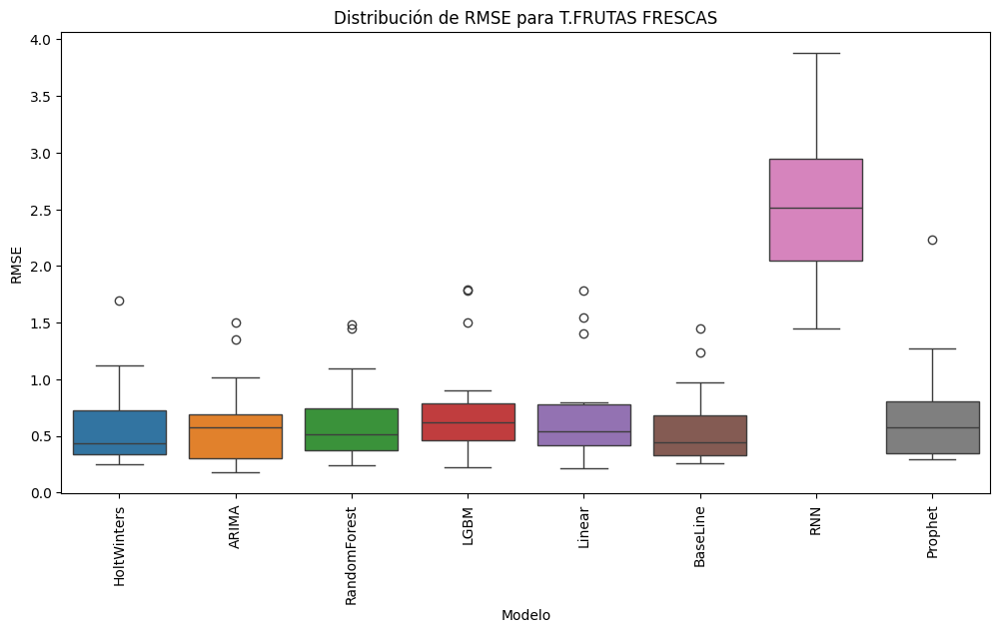

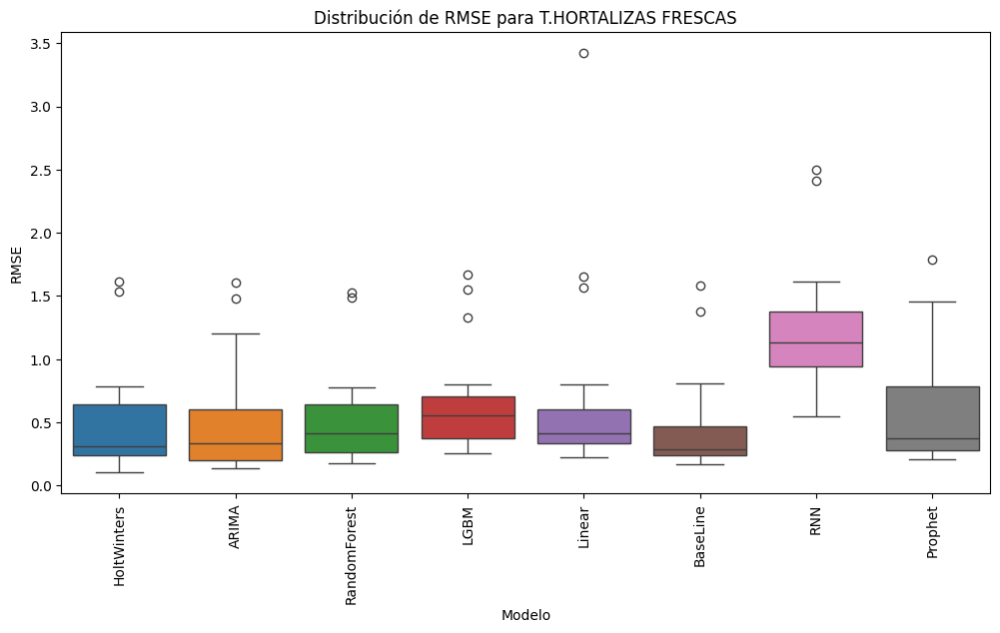

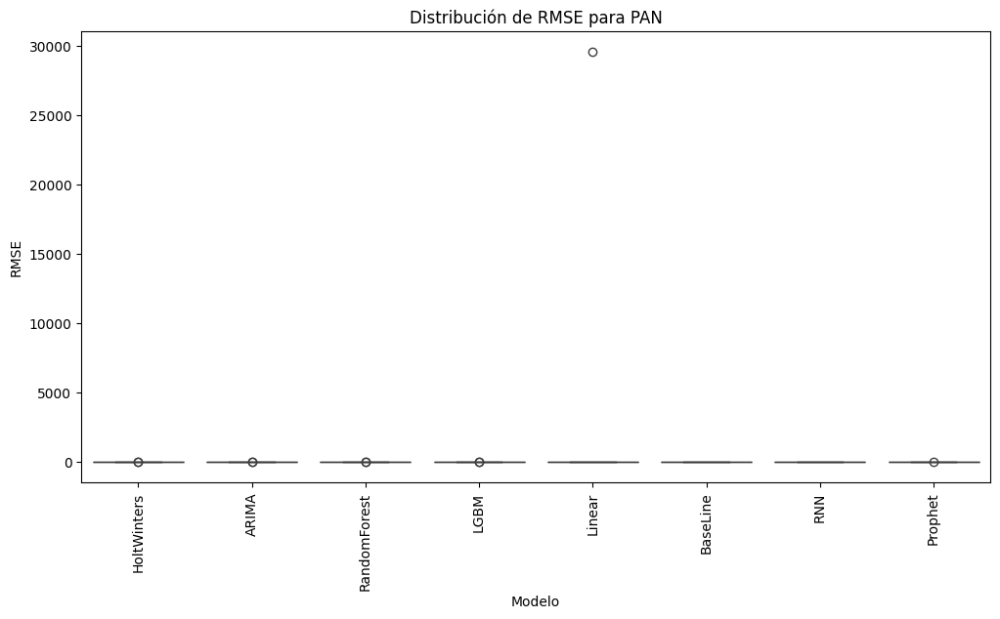

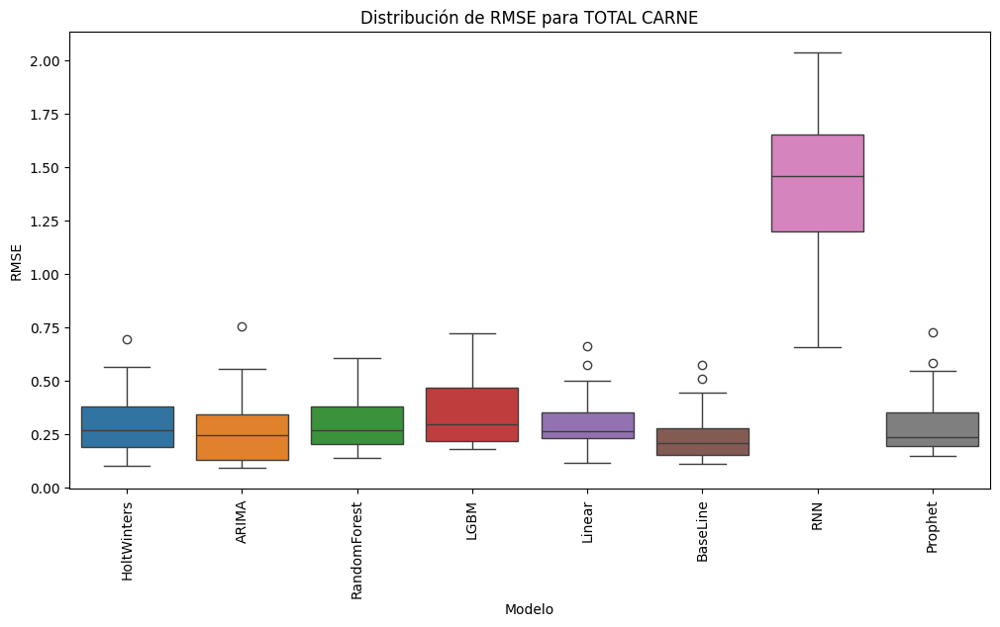

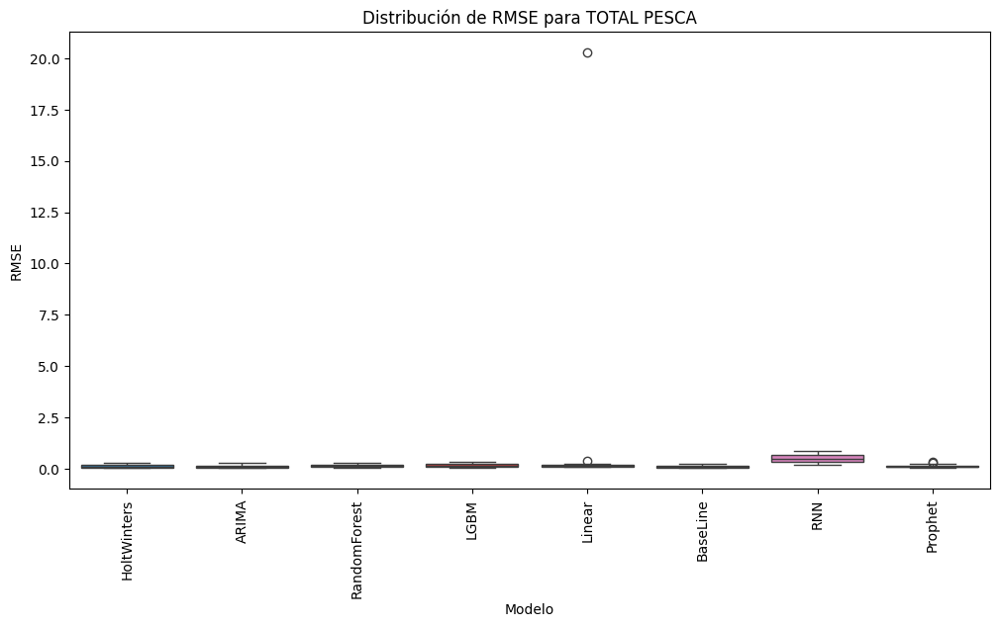

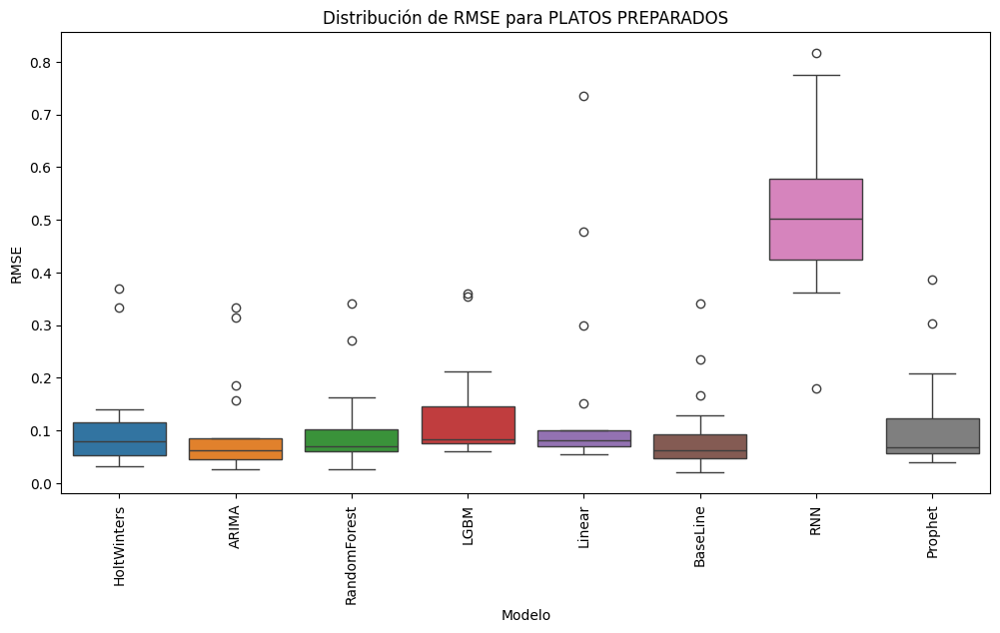

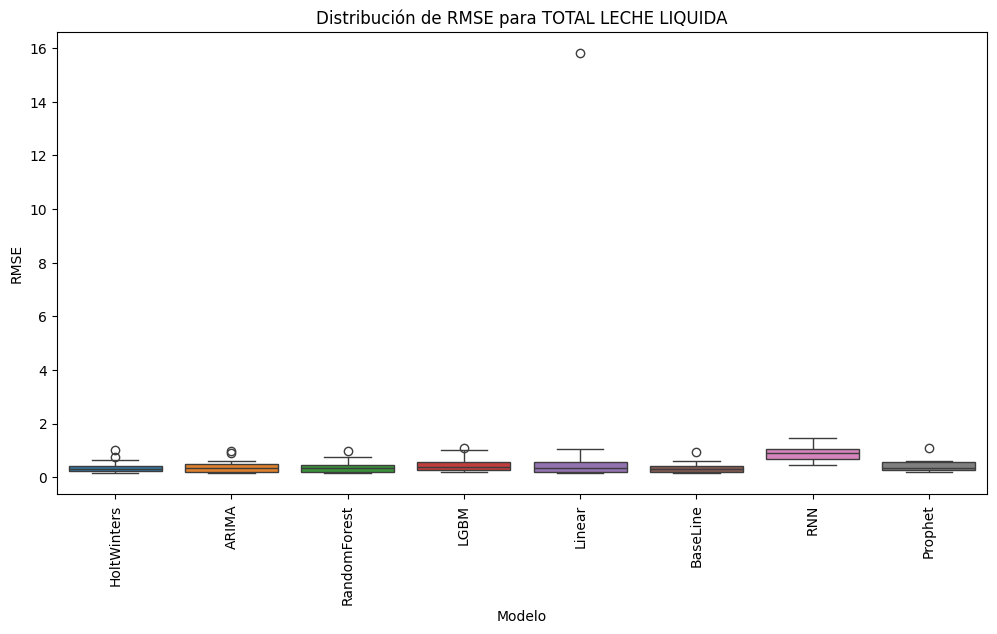

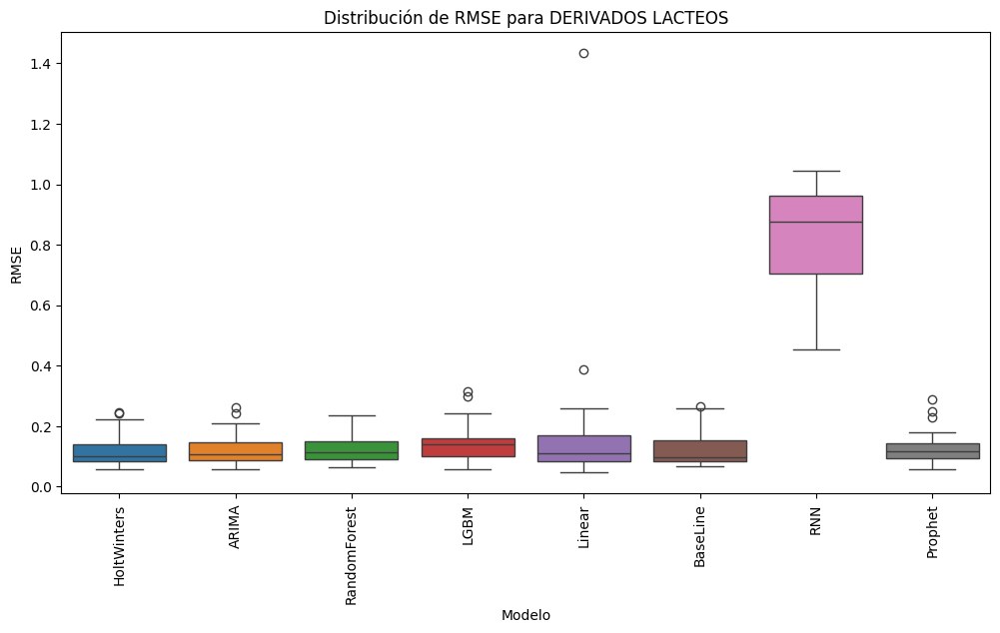

In [27]:
data_for_boxplot = []

for alimento, modelos in results.items():
    for modelo, rmse_list in modelos.items():
        for rmse in rmse_list:
            data_for_boxplot.append({
                'Alimento': alimento,
                'Modelo': modelo,
                'RMSE': rmse
            })

df_boxplot = pd.DataFrame(data_for_boxplot)

alimentos = df_boxplot['Alimento'].unique()

for alimento in alimentos:
    plt.figure(figsize=(12, 6))
    data_subset = df_boxplot[df_boxplot['Alimento'] == alimento]
    sns.boxplot(data=data_subset, x='Modelo', y='RMSE', hue='Modelo')
    plt.title(f'Distribución de RMSE para {alimento}')
    plt.xticks(rotation=90)
    plt.show()

Se representa nuevamente en este caso eliminando el primer valor del modelo autoregresivo con un regresor lineal, dado que al observar que en los alimentos PAN, TOTAL LECHE LIQUIDA y TOTAL PESCA aumentaba mucho la escala no pudiendo visualizar correctamente el comportamiento, se ha revisado los valores de este modelo en todos los alimentos y se observa que el primer valor predicho no tiene un buen comportamiento, por este motivo, se elimina el primer valor que corresponde a la primera ventana para observar mejor el comportamiento, pero este mejora al acumular más datos en el modelo.

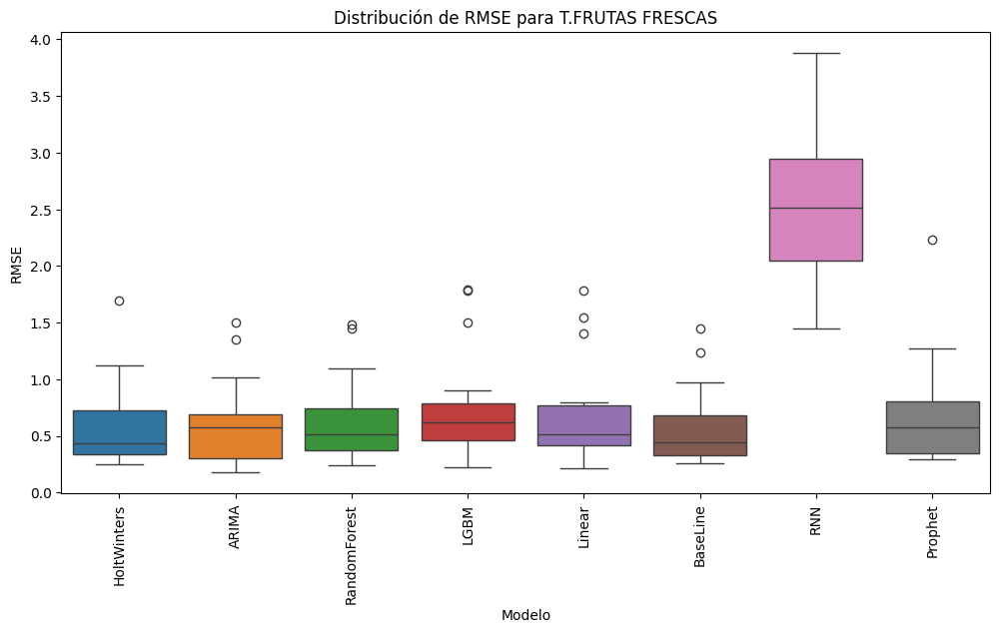

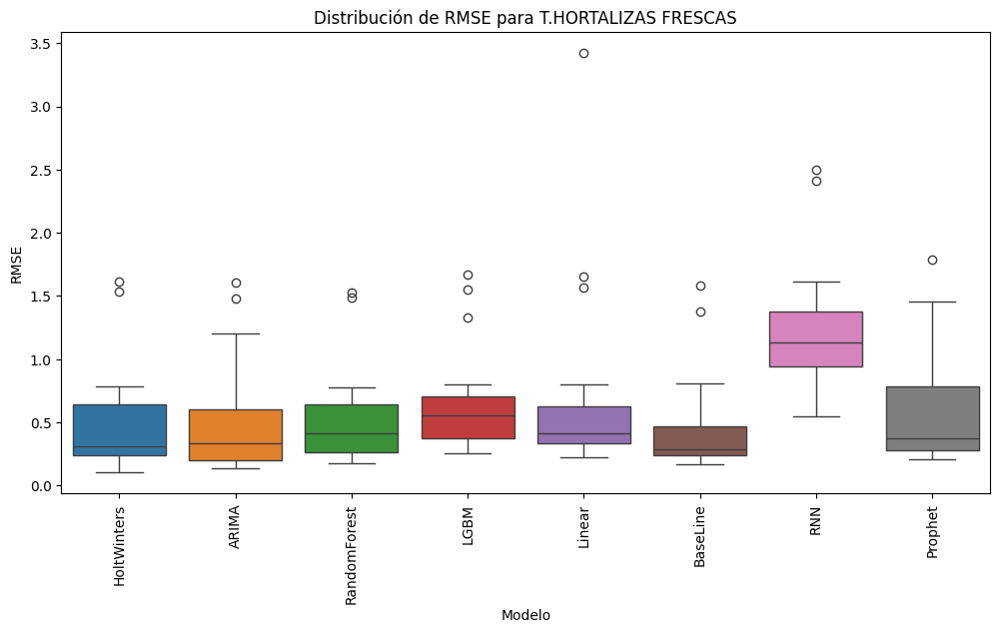

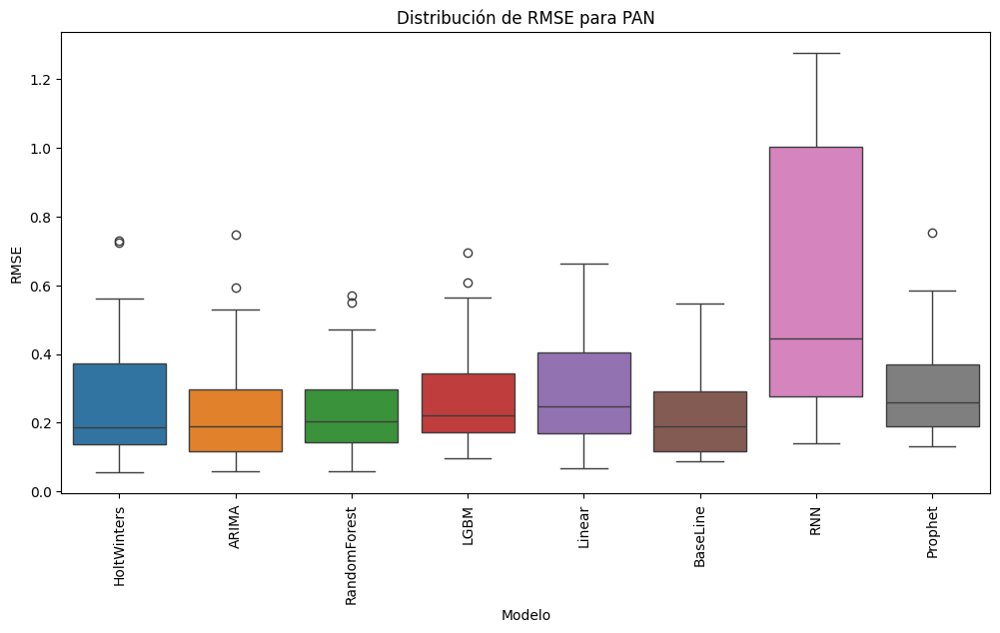

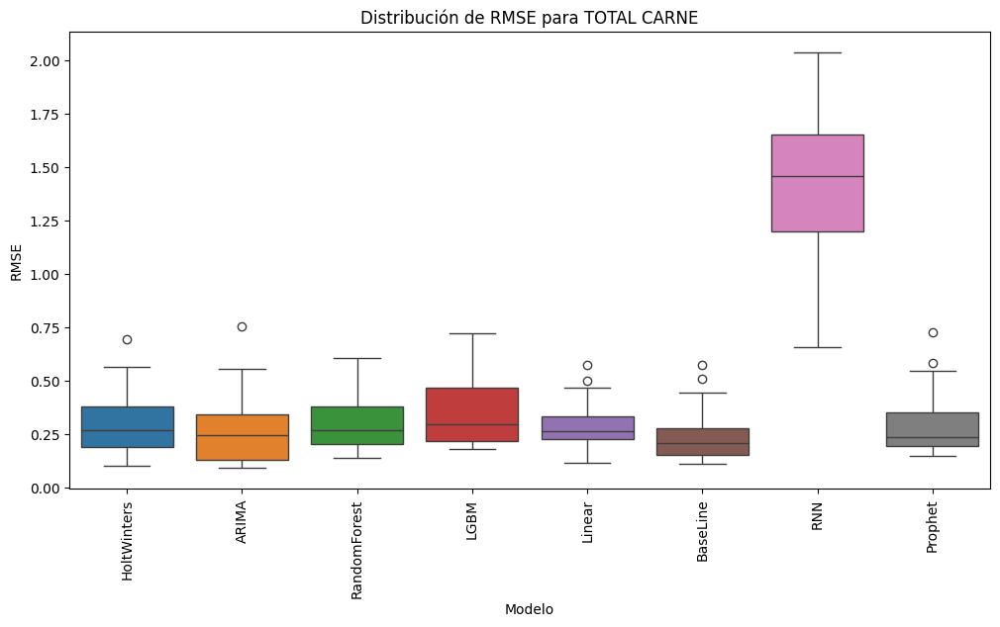

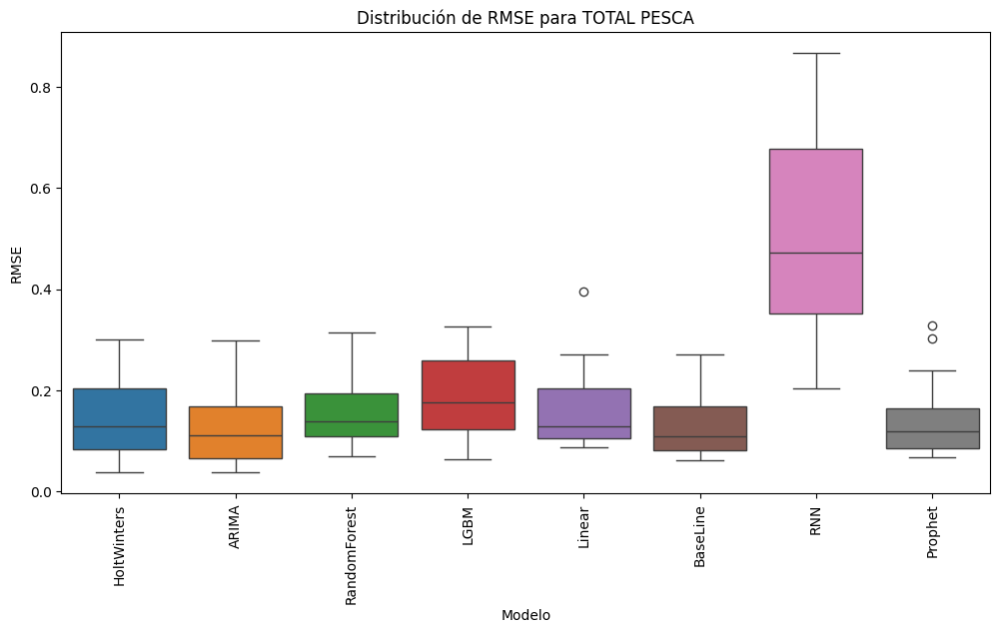

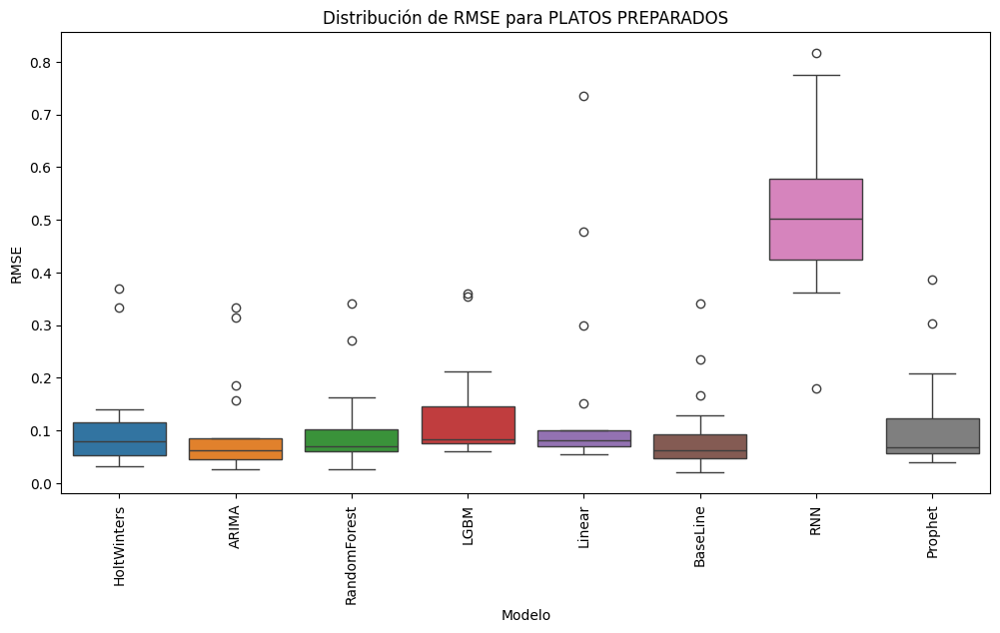

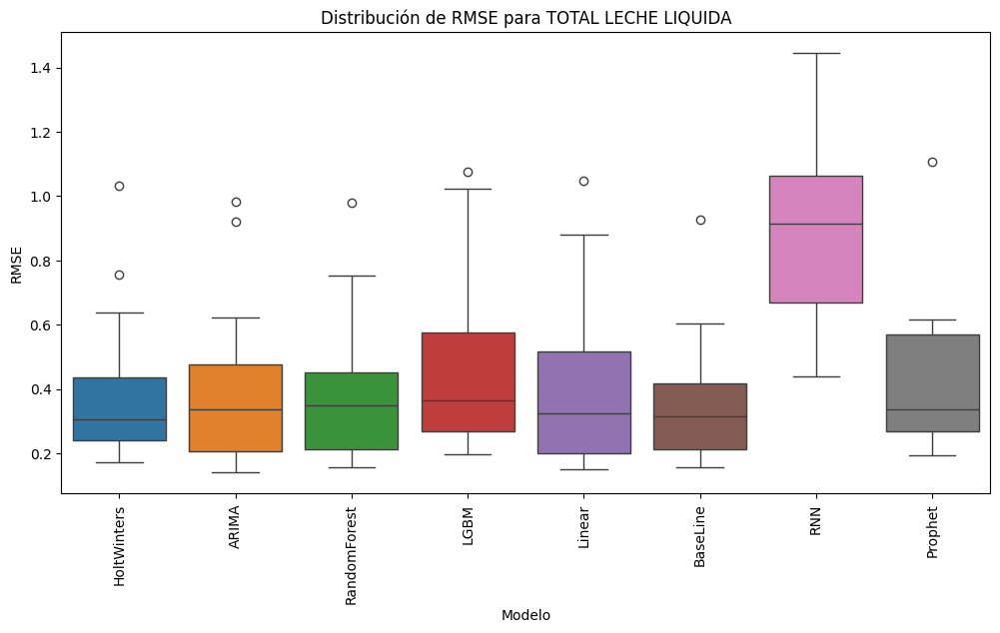

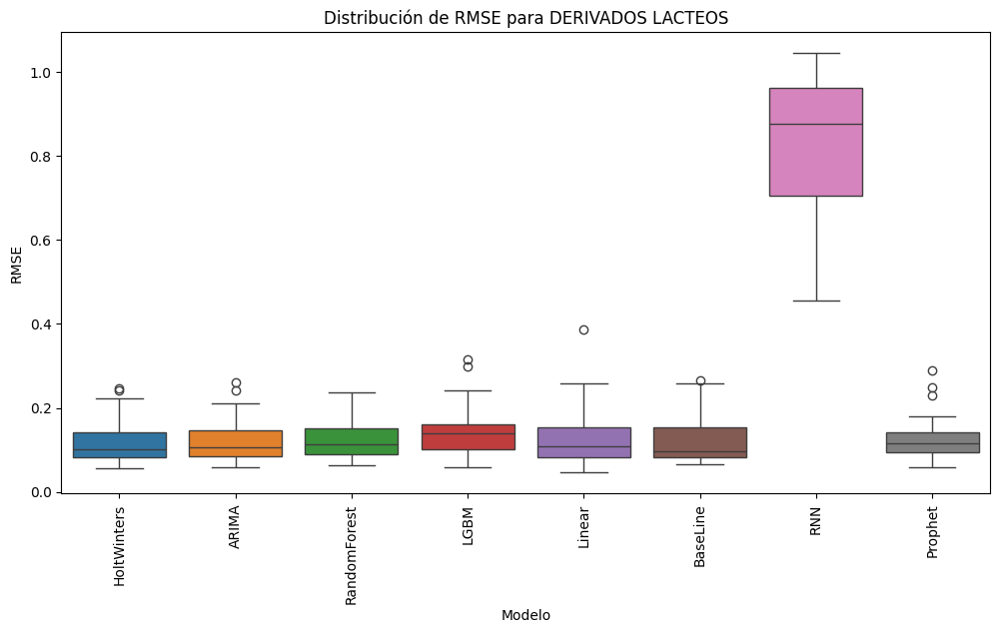

In [28]:
data_for_boxplot = []

for alimento, modelos in results.items():
    for modelo, rmse_list in modelos.items():
        if modelo == 'Linear':
            # Eliminar el primer valor de la lista de RMSE
            if len(rmse_list) > 0:
                rmse_list = rmse_list[1:]
        for rmse in rmse_list:
            data_for_boxplot.append({
                'Alimento': alimento,
                'Modelo': modelo,
                'RMSE': rmse
            })

df_boxplot = pd.DataFrame(data_for_boxplot)
alimentos = df_boxplot['Alimento'].unique()

for alimento in alimentos:
    plt.figure(figsize=(12, 6))
    data_subset = df_boxplot[df_boxplot['Alimento'] == alimento]
    sns.boxplot(data=data_subset, x='Modelo', y='RMSE', hue='Modelo')
    plt.title(f'Distribución de RMSE para {alimento}')
    plt.xticks(rotation=90)
    plt.show()

In [29]:
import pandas as pd

# Crear un diccionario para almacenar el promedio de RMSE para cada modelo y cada alimento
promedios_rmse = {}

# Iterar sobre cada tipo de alimento en el diccionario de resultados
for alimento, modelos in results.items():
    # Crear un diccionario para almacenar los promedios de RMSE para cada modelo del alimento actual
    promedios_rmse[alimento] = {}
    
    # Obtener los primeros 8 modelos (si hay al menos 8)
    primeros_modelos = list(modelos.keys())[:8]
    
    # Iterar sobre los primeros 8 modelos y su lista de RMSEs
    for modelo in primeros_modelos:
        rmse_list = modelos[modelo]
        # Calcular el promedio del RMSE para la lista actual
        promedio_rmse = sum(rmse_list) / len(rmse_list) if rmse_list else float('nan')
        
        # Almacenar el promedio en el diccionario de promedios
        promedios_rmse[alimento][modelo] = promedio_rmse

# Convertir el diccionario de promedios a un DataFrame de pandas
df_promedios_rmse = pd.DataFrame(promedios_rmse).T

# Imprimir el DataFrame
df_promedios_rmse



,HoltWinters,ARIMA,RandomForest,LGBM,Linear,BaseLine,RNN,Prophet
T.FRUTAS FRESCAS,0.588908,0.590730,0.627794,0.736215,0.674706,0.563992,2.508504,0.705784
T.HORTALIZAS FRESCAS,0.481266,0.493515,0.507431,0.646878,0.672475,0.463998,1.234228,0.597283
PAN,0.278080,0.251949,0.247214,0.289342,1406.381540,0.224931,0.608248,0.300259
TOTAL CARNE,0.305303,0.274507,0.303674,0.347028,0.308914,0.247146,1.412107,0.305042
TOTAL PESCA,0.147522,0.135418,0.158993,0.189986,1.118577,0.131451,0.519015,0.142797
PLATOS PREPARADOS,0.103378,0.091995,0.099598,0.124712,0.141751,0.088599,0.512643,0.108859
TOTAL LECHE LIQUIDA,0.380308,0.380530,0.385310,0.448900,1.128176,0.352049,0.873234,0.406005
DERIVADOS LACTEOS,0.124799,0.121975,0.124658,0.149663,0.198390,0.126430,0.833360,0.131202


En el análisis de los resultados de RMSE mediante backtesting con reentrenamiento, hemos observado que la Red Neuronal Recurrente (RNN) presenta una mayor variabilidad en sus predicciones en comparación con modelos más simples. Esto se debe a que la RNN, al ser un modelo complejo, tiene dificultades para generalizar con una cantidad limitada de datos, resultando en un rendimiento menos consistente. En contraste, los modelos más simples que muestran una precisión más estable y confiable.

Para el resto de modelos, al examinar de manera general todas las series, se observa un comportamiento homogéneo. Esto indica que, a pesar de las diferencias entre los modelos, su rendimiento global es bastante consistente a través de las distintas series temporales analizadas. En resumen, no hay un modelo que sobresalga notablemente en comparación con los demás en términos de precisión, lo que sugiere que los modelos utilizados manejan las series temporales de manera similar.

Antes de elegir un modelo definitivo, exploraremos el modelado multivariante incluyendo variables exógenas. Esta etapa nos permitirá comparar el rendimiento de los modelos con la adición de estas nuevas variables y determinar si su inclusión mejora la precisión y la capacidad predictiva en comparación con los modelos univariantes previamente evaluados.

# MODELADO MULTIVARIANTE

Aqui vamos a incluir por un lado el conjunto de datos de 1999 al 2023 de las series exogenas que inculye nuestro dataset y por otro lado, el nuevo dataset con la variable exogena IPC en el periodo 2002 AL 2023. Inicalmente se va a lanzar el analisis con esto y en función del aporte de esta nueva variable exógena IPC, se valorará reducir el periodo de análisis. 

## MODELO SARIMAX

Para el modelo SARIMAX, se va utilizar el order y seasonal_orden definido anteriormente en el modelo univariante para simplificar este primer análisis de modelos. Si es necesario más adelante se ajustaran sus parámetros (p,d,q)(P,D,Q).

In [30]:
# SERIE INICIAL
for alimento, data in data_train_dict.items():
    train = data['train']
    test = data['test']
    exog_variables = ['GASTO X CAPITA', 'PRECIO MEDIO kg ó litros', 'PENETRACION (%)']

    resultados = {}
   
    for r in range(1, len(exog_variables) + 1):
        for combo in itertools.combinations(exog_variables, r):
            combo_list = list(combo)
            combo_name = "_".join(combo_list)

            modelo_SARIMAX = SARIMAX(train['CONSUMO X CAPITA'], 
                                     exog=train[combo_list], 
                                     order=(1, 0, 1),
                                     seasonal_order=(0, 1, 1, 12)) 
            modelo_SARIMAX_fit = modelo_SARIMAX.fit(disp=False)
            
            fcast_SARIMAX = modelo_SARIMAX_fit.predict(start=len(train), end=len(train) + len(test) - 1, exog=test[combo_list])
            rmse = mean_squared_error(y_true=test['CONSUMO X CAPITA'], y_pred=fcast_SARIMAX, squared=False)
        
            resultados[f'SARIMAX_{combo_name}'] = {
                'modelo': modelo_SARIMAX_fit,
                'fcast': fcast_SARIMAX,
                'RMSE': rmse
            }
            resultados_modelos_dict[alimento].update(resultados)


In [31]:
# SERIE MODIFICADA CON IPC
resultados_modelos_dict_reducido = defaultdict(lambda: defaultdict(dict))
for alimento, data in data_train_dict_reducido .items():
    train = data['train']
    test = data['test']
    exog_variables = ['GASTO X CAPITA', 'PRECIO MEDIO kg ó litros', 'PENETRACION (%)','IPC Alimentos y bebidas no alcholicas']

    resultados = {}
   
    for r in range(1, len(exog_variables) + 1):
        for combo in itertools.combinations(exog_variables, r):
            combo_list = list(combo)
            combo_name = "_".join(combo_list)

            modelo_SARIMAX = SARIMAX(train['CONSUMO X CAPITA'], 
                                     exog=train[combo_list], 
                                     order=(1, 0, 1),
                                     seasonal_order=(0, 1, 1, 12)) 
            modelo_SARIMAX_fit = modelo_SARIMAX.fit()
            
            fcast_SARIMAX = modelo_SARIMAX_fit.predict(start=len(train), end=len(train) + len(test) - 1, exog=test[combo_list])
            rmse = mean_squared_error(y_true=test['CONSUMO X CAPITA'], y_pred=fcast_SARIMAX, squared=False)
        
            resultados[f'SARIMAX_{combo_name}'] = {
                'modelo': modelo_SARIMAX_fit,
                'fcast': fcast_SARIMAX,
                'RMSE': rmse
            }
            resultados_modelos_dict_reducido[alimento].update(resultados)

## MODELO AUTOREGRESIVO: FORECASTER AUTOREG O AUTOREGCUSTOM

El modelo base line definido anteriormente con ForecasterEquivalentDate, no permite incluir variables exógenas por eso nuevamente se define un nuevo regressor_2 eliminando el mismo. Además, ForecasterAutoregCustom permite introducir también transformaciones en nuestra serie principal. En este caso, no lo incluiremos en el análisis pero para que se tenga en cuenta su posibilidad. 

In [32]:
# SERIE INICIAL
regressors_2 = [
    ('RandomForest', RandomForestRegressor(random_state=123)),
    ('LGBM', LGBMRegressor(random_state=123, verbose=-1)),
    ('Linear', LinearRegression())]


for alimento, data in data_train_dict.items():
    train = data['train']
    test = data['test']
    exog_variables = ['GASTO X CAPITA', 'PRECIO MEDIO kg ó litros', 'PENETRACION (%)']

    for name, regressor in regressors_2:
        for r in range(1, len(exog_variables) + 1):
            for combo in itertools.combinations(exog_variables, r):
                combo_list = list(combo)
                combo_name = "_".join(combo_list)
                forecaster = ForecasterAutoreg(
                    regressor = regressor,
                    lags      = 12
                )
                forecaster_fit=forecaster.fit(y=train['CONSUMO X CAPITA'], exog=train[combo_list])

                fcast = forecaster.predict(steps=12, exog=test[combo_list])
                rmse = np.sqrt(mean_squared_error(test['CONSUMO X CAPITA'], fcast))
                resultados = {}
                resultados[f'{name}_EXOG_{combo_name}'] = {
                    'modelo': forecaster_fit,
                    'fcast': fcast,
                    'RMSE': rmse
                }
                resultados_modelos_dict[alimento].update(resultados)

In [33]:
# SERIE MODIFICADA CON IPC
regressors_2 = [
    ('RandomForest', RandomForestRegressor(random_state=123)),
    ('LGBM', LGBMRegressor(random_state=123, verbose=-1)),
    ('Linear', LinearRegression())]



for alimento, data in data_train_dict_reducido.items():
    train = data['train']
    test = data['test']
    exog_variables = ['GASTO X CAPITA', 'PRECIO MEDIO kg ó litros', 'PENETRACION (%)','IPC Alimentos y bebidas no alcholicas']

    for name, regressor in regressors_2:
        for r in range(1, len(exog_variables) + 1):
            for combo in itertools.combinations(exog_variables, r):
                combo_list = list(combo)
                combo_name = "_".join(combo_list)
                forecaster = ForecasterAutoreg(
                    regressor = regressor,
                    lags      = 12
                )
                forecaster_fit=forecaster.fit(y=train['CONSUMO X CAPITA'], exog=train[combo_list])

                fcast = forecaster.predict(steps=12, exog=test[combo_list])
                rmse = np.sqrt(mean_squared_error(test['CONSUMO X CAPITA'], fcast))
                resultados = {}
                resultados[f'{name}_EXOG_{combo_name}'] = {
                    'modelo': forecaster_fit,
                    'fcast': fcast,
                    'RMSE': rmse
                }
                resultados_modelos_dict_reducido[alimento].update(resultados)

## MODELO CON RNN

In [34]:
# SERIE INICIAL
for alimento, data in data_train_dict.items():
    train = data['train']
    test = data['test']

    series = ["CONSUMO X CAPITA",'GASTO X CAPITA','PRECIO MEDIO kg ó litros','PENETRACION (%)']
    levels = ["CONSUMO X CAPITA"] 
    lags = 36 
    steps = 12

    model = create_and_compile_model(
        series=train[series],
        levels=levels, 
        lags=lags,
        steps=steps,
        recurrent_layer="LSTM",
        recurrent_units=4,
        dense_units=16,
        optimizer=Adam(learning_rate=0.01), 
        loss=MeanSquaredError()
    )
    
    forecaster = ForecasterRnn(
        regressor=model,
        levels=levels,
        steps=steps,
        lags=lags,
        transformer_series=MinMaxScaler(),
    )   
    
    forecaster.fit(train[series])
    fcast = forecaster.predict()
    rmse = np.sqrt(mean_squared_error(test['CONSUMO X CAPITA'], fcast))
    resultados={}
    resultados['RNN_EXOG']= {'modelo': forecaster,'fcast': fcast,'RMSE':rmse}
    resultados_modelos_dict[alimento].update(resultados)

keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.2119
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.1743
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.7509
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.2044
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.1779
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.2562
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.1279
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss:

In [35]:
# SERIE MODIFICADA CON IPC
for alimento, data in data_train_dict_reducido.items():
    train = data['train']
    test = data['test']

    series = ["CONSUMO X CAPITA",'GASTO X CAPITA','PRECIO MEDIO kg ó litros','PENETRACION (%)','IPC Alimentos y bebidas no alcholicas']
    levels = ["CONSUMO X CAPITA"] 
    lags = 36 
    steps = 12

    model = create_and_compile_model(
        series=train[series],
        levels=levels, 
        lags=lags,
        steps=steps,
        recurrent_layer="LSTM",
        recurrent_units=4,
        dense_units=16,
        optimizer=Adam(learning_rate=0.01), 
        loss=MeanSquaredError()
    )
    
    forecaster = ForecasterRnn(
        regressor=model,
        levels=levels,
        steps=steps,
        lags=lags,
        transformer_series=MinMaxScaler(),
    )   
    
    forecaster.fit(train[series])
    fcast = forecaster.predict()
    rmse = np.sqrt(mean_squared_error(test['CONSUMO X CAPITA'], fcast))
    resultados={}
    resultados['RNN_EXOG']= {'modelo': forecaster,'fcast': fcast,'RMSE':rmse}
    resultados_modelos_dict_reducido[alimento].update(resultados)

keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.2800
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.1165
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.1507
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - loss: 0.2149
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.0939
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.1760
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.1317
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss:

## BACKTESTING MULTIVARIANTE

Después de aplicar el cálculo del RMSE para cada modelo multivariante con las variables exógenas seleccionadas y registrar los resultados en nuestro diccionario de modelos, es esencial realizar un análisis de backtesting para determinar la consistencia de cada modelo. Dado que estamos trabajando con múltiples combinaciones de variables exógenas y distintos modelos, es importante primero verificar la cantidad de modelos que se entrenarán para evitar una carga computacional excesiva.

La combinación de las variables exógenas nos da 7 posibles configuraciones para cada modelo. Para los modelos SARIMAX y RNN, cada una de estas combinaciones se probará en 22 diferentes ventanas de entrenamiento durante el backtesting, lo que resulta en un total de 154 entrenamientos por modelo. En el caso, del modelo AR, dado que utilizamos tres regresores diferentes, el número total de entrenamientos se eleva a 462.

Dado que no trabajamos con un dataset muy extenso procederemos a ejectuar todo con este backtesting de reentrenamiento pero es fundamental vigilar la carga computacional. Es posible que, dependiendo de este analisis en otros contextos, se desee ajustar la estrategia de backtesting para optimizar los recursos. Una alternativa podría ser implementar un enfoque de ventana de entrenamiento desplazable, que podría ayudar a reducir la carga computacional sin comprometer la validez del análisis.

Para el conjunto con IPC tenemos 285 entrenamiento por modelo para SARIMAX y RNN, y 855 para el modelo autoregresivo. En este caso, el coste comuputacional es mucho mayor.

In [36]:
exog_variables = ['GASTO X CAPITA', 'PRECIO MEDIO kg ó litros', 'PENETRACION (%)',]

# Generar todas las combinaciones posibles de las variables exógenas
combinaciones = []
for r in range(1, len(exog_variables) + 1):
    for combo in itertools.combinations(exog_variables, r):
        combo_list = list(combo)
        combo_name = "_".join(combo_list) 
        combinaciones.append(combo_name)

print("Todas las combinaciones posibles de variables exógenas:")
for combo in combinaciones:
    print(combo)

print(f"\nNúmero total de combinaciones: {len(combinaciones)}")

Todas las combinaciones posibles de variables exógenas:
GASTO X CAPITA
PRECIO MEDIO kg ó litros
PENETRACION (%)
GASTO X CAPITA_PRECIO MEDIO kg ó litros
GASTO X CAPITA_PENETRACION (%)
PRECIO MEDIO kg ó litros_PENETRACION (%)
GASTO X CAPITA_PRECIO MEDIO kg ó litros_PENETRACION (%)

Número total de combinaciones: 7


In [37]:
window_size_train = 24  # Tamaño de la ventana de entrenamiento en meses
window_size_test = 12   # Tamaño de la ventana de prueba en meses
start_date = '1999-01-01'
end_date = '2022-12-01' # Se mantienen los datos de 2023 como test final

fecha_inicio = pd.to_datetime(start_date)
fecha_fin = pd.to_datetime(end_date)

total_periods = (fecha_fin.year - fecha_inicio.year) * 12 + (fecha_fin.month - fecha_inicio.month) + 1

num_windows = (total_periods - window_size_train - window_size_test) // 12 + 1

print(f"Número total de ventanas: {num_windows}")


Número total de ventanas: 22


In [38]:
exog_variables = ['GASTO X CAPITA', 'PRECIO MEDIO kg ó litros', 'PENETRACION (%)','IPC Alimentos y bebidas no alcholicas']

# Generar todas las combinaciones posibles de las variables exógenas
combinaciones = []
for r in range(1, len(exog_variables) + 1):
    for combo in itertools.combinations(exog_variables, r):
        combo_list = list(combo)
        combo_name = "_".join(combo_list) 
        combinaciones.append(combo_name)

print("Todas las combinaciones posibles de variables exógenas:")
for combo in combinaciones:
    print(combo)

print(f"\nNúmero total de combinaciones: {len(combinaciones)}")

Todas las combinaciones posibles de variables exógenas:
GASTO X CAPITA
PRECIO MEDIO kg ó litros
PENETRACION (%)
IPC Alimentos y bebidas no alcholicas
GASTO X CAPITA_PRECIO MEDIO kg ó litros
GASTO X CAPITA_PENETRACION (%)
GASTO X CAPITA_IPC Alimentos y bebidas no alcholicas
PRECIO MEDIO kg ó litros_PENETRACION (%)
PRECIO MEDIO kg ó litros_IPC Alimentos y bebidas no alcholicas
PENETRACION (%)_IPC Alimentos y bebidas no alcholicas
GASTO X CAPITA_PRECIO MEDIO kg ó litros_PENETRACION (%)
GASTO X CAPITA_PRECIO MEDIO kg ó litros_IPC Alimentos y bebidas no alcholicas
GASTO X CAPITA_PENETRACION (%)_IPC Alimentos y bebidas no alcholicas
PRECIO MEDIO kg ó litros_PENETRACION (%)_IPC Alimentos y bebidas no alcholicas
GASTO X CAPITA_PRECIO MEDIO kg ó litros_PENETRACION (%)_IPC Alimentos y bebidas no alcholicas

Número total de combinaciones: 15


In [39]:
window_size_train = 24  # Tamaño de la ventana de entrenamiento en meses
window_size_test = 12   # Tamaño de la ventana de prueba en meses
start_date = '2002-01-01'
end_date = '2022-12-01' # Se mantienen los datos de 2023 como test final

fecha_inicio = pd.to_datetime(start_date)
fecha_fin = pd.to_datetime(end_date)

total_periods = (fecha_fin.year - fecha_inicio.year) * 12 + (fecha_fin.month - fecha_inicio.month) + 1

num_windows = (total_periods - window_size_train - window_size_test) // 12 + 1

print(f"Número total de ventanas: {num_windows}")


Número total de ventanas: 19


### Backtesting SARIMAX multivariante

In [40]:
# SERIE INICIAL
start_time = time.time()

for alimento, serie in dict_series_mensuales_nacional.items():
    window_size_train = 24  
    window_size_test = 12   
    start_date = '1999-01-01'
    end_date = '2022-12-01'
    fecha_inicio = pd.to_datetime(start_date)
    fecha_fin = pd.to_datetime(end_date)
    
    exog_variables = ['GASTO X CAPITA', 'PRECIO MEDIO kg ó litros', 'PENETRACION (%)']
    print(alimento)
    fecha_inicio_actual = fecha_inicio
    while fecha_inicio_actual + pd.DateOffset(months=window_size_train + window_size_test) <= fecha_fin:
        # Definir la ventana de entrenamiento
        train_fecha_fin = fecha_inicio_actual + pd.DateOffset(months=window_size_train - 1)
        test_fecha_inicio = train_fecha_fin + pd.DateOffset(months=1)  # Justo después del entrenamiento
        test_fecha_fin = test_fecha_inicio + pd.DateOffset(months=window_size_test - 1)

        # Mostrar las fechas para verificar
        #print(f"Train desde {fecha_inicio_actual} hasta {train_fecha_fin}")
        #print(f"Test desde {test_fecha_inicio} hasta {test_fecha_fin}")

        # Extraer los datos de entrenamiento y prueba
        train_data = serie[fecha_inicio_actual:train_fecha_fin]
        test_data = serie[test_fecha_inicio:test_fecha_fin]

        # Evaluar cada combinación de variables exógenas
        for r in range(1, len(exog_variables) + 1):
            for combo in combinations(exog_variables, r):
                combo_list = list(combo)
                key = f'SARIMAX_{"_".join(combo_list)}'  

                # Crear y ajustar el modelo SARIMAX
                modelo_SARIMAX = SARIMAX(
                    train_data['CONSUMO X CAPITA'], 
                    exog=train_data[combo_list], 
                    order=(1, 0, 1),
                    seasonal_order=(0, 1, 1, 12)
                )
                modelo_SARIMAX_fit = modelo_SARIMAX.fit(disp=False)
                fcast_SARIMAX = modelo_SARIMAX_fit.predict(
                    start=len(train_data), 
                    end=len(train_data) + len(test_data) - 1, 
                    exog=test_data[combo_list]
                )

                # Ajustar longitud si es necesario
                if len(fcast_SARIMAX) != len(test_data):
                    print(f"Tamaño de predicciones ({len(fcast_SARIMAX)}) no coincide con el tamaño de datos de prueba ({len(test_data)}). Ajustando longitud.")
                    fcast_SARIMAX = fcast_SARIMAX[:len(test_data)]

                # Calcular el RMSE
                rmse = mean_squared_error(y_true=test_data['CONSUMO X CAPITA'], y_pred=fcast_SARIMAX, squared=False)
                
                # Almacenar los resultados para la ventana actual en results
                results[alimento][key].append(rmse)

        # Expande la ventana de entrenamiento sumando 12 meses
        window_size_train += 12
        
# Detener el temporizador
end_time = time.time()
elapsed_time = end_time - start_time

print(f"Tiempo total de ejecución: {elapsed_time:.2f} segundos")

T.FRUTAS FRESCAS
T.HORTALIZAS FRESCAS
PAN
TOTAL CARNE
TOTAL PESCA
PLATOS PREPARADOS
TOTAL LECHE LIQUIDA
DERIVADOS LACTEOS
Tiempo total de ejecución: 625.95 segundos


In [41]:
# SERIE REDUCIDA INCLUYENDO IPC

start_time = time.time()

for alimento, serie in dict_series_reducida.items():
    window_size_train = 24  
    window_size_test = 12   
    start_date = '2002-01-01'
    end_date = '2022-12-01'
    fecha_inicio = pd.to_datetime(start_date)
    fecha_fin = pd.to_datetime(end_date)
    
    exog_variables = ['GASTO X CAPITA', 'PRECIO MEDIO kg ó litros', 'PENETRACION (%)','IPC Alimentos y bebidas no alcholicas']
    print(alimento)
    fecha_inicio_actual = fecha_inicio
    while fecha_inicio_actual + pd.DateOffset(months=window_size_train + window_size_test) <= fecha_fin:
        # Definir la ventana de entrenamiento
        train_fecha_fin = fecha_inicio_actual + pd.DateOffset(months=window_size_train - 1)
        test_fecha_inicio = train_fecha_fin + pd.DateOffset(months=1)  # Justo después del entrenamiento
        test_fecha_fin = test_fecha_inicio + pd.DateOffset(months=window_size_test - 1)

        # Mostrar las fechas para verificar
        print(f"Train desde {fecha_inicio_actual} hasta {train_fecha_fin}")
        print(f"Test desde {test_fecha_inicio} hasta {test_fecha_fin}")

        # Extraer los datos de entrenamiento y prueba
        train_data = serie[fecha_inicio_actual:train_fecha_fin]
        test_data = serie[test_fecha_inicio:test_fecha_fin]

        # Evaluar cada combinación de variables exógenas
        for r in range(1, len(exog_variables) + 1):
            for combo in combinations(exog_variables, r):
                combo_list = list(combo)
                key = f'SARIMAX_reducida{"_".join(combo_list)}'  

                # Crear y ajustar el modelo SARIMAX
                modelo_SARIMAX = SARIMAX(
                    train_data['CONSUMO X CAPITA'], 
                    exog=train_data[combo_list], 
                    order=(1, 0, 1),
                    seasonal_order=(0, 1, 1, 12)
                )
                modelo_SARIMAX_fit = modelo_SARIMAX.fit(disp=False)
                fcast_SARIMAX = modelo_SARIMAX_fit.predict(
                    start=len(train_data), 
                    end=len(train_data) + len(test_data) - 1, 
                    exog=test_data[combo_list]
                )

                # Ajustar longitud si es necesario
                if len(fcast_SARIMAX) != len(test_data):
                    print(f"Tamaño de predicciones ({len(fcast_SARIMAX)}) no coincide con el tamaño de datos de prueba ({len(test_data)}). Ajustando longitud.")
                    fcast_SARIMAX = fcast_SARIMAX[:len(test_data)]

                # Calcular el RMSE
                rmse = mean_squared_error(y_true=test_data['CONSUMO X CAPITA'], y_pred=fcast_SARIMAX, squared=False)
                
                # Almacenar los resultados para la ventana actual en results
                results[alimento][key].append(rmse)

        # Expande la ventana de entrenamiento sumando 12 meses
        window_size_train += 12
        
# Detener el temporizador
end_time = time.time()
elapsed_time = end_time - start_time

print(f"Tiempo total de ejecución: {elapsed_time:.2f} segundos")

T.FRUTAS FRESCAS
Train desde 2002-01-01 00:00:00 hasta 2003-12-01 00:00:00
Test desde 2004-01-01 00:00:00 hasta 2004-12-01 00:00:00
Train desde 2002-01-01 00:00:00 hasta 2004-12-01 00:00:00
Test desde 2005-01-01 00:00:00 hasta 2005-12-01 00:00:00
Train desde 2002-01-01 00:00:00 hasta 2005-12-01 00:00:00
Test desde 2006-01-01 00:00:00 hasta 2006-12-01 00:00:00
Train desde 2002-01-01 00:00:00 hasta 2006-12-01 00:00:00
Test desde 2007-01-01 00:00:00 hasta 2007-12-01 00:00:00
Train desde 2002-01-01 00:00:00 hasta 2007-12-01 00:00:00
Test desde 2008-01-01 00:00:00 hasta 2008-12-01 00:00:00
Train desde 2002-01-01 00:00:00 hasta 2008-12-01 00:00:00
Test desde 2009-01-01 00:00:00 hasta 2009-12-01 00:00:00
Train desde 2002-01-01 00:00:00 hasta 2009-12-01 00:00:00
Test desde 2010-01-01 00:00:00 hasta 2010-12-01 00:00:00
Train desde 2002-01-01 00:00:00 hasta 2010-12-01 00:00:00
Test desde 2011-01-01 00:00:00 hasta 2011-12-01 00:00:00
Train desde 2002-01-01 00:00:00 hasta 2011-12-01 00:00:00
Test 

Train desde 2002-01-01 00:00:00 hasta 2020-12-01 00:00:00
Test desde 2021-01-01 00:00:00 hasta 2021-12-01 00:00:00
TOTAL PESCA
Train desde 2002-01-01 00:00:00 hasta 2003-12-01 00:00:00
Test desde 2004-01-01 00:00:00 hasta 2004-12-01 00:00:00
Train desde 2002-01-01 00:00:00 hasta 2004-12-01 00:00:00
Test desde 2005-01-01 00:00:00 hasta 2005-12-01 00:00:00
Train desde 2002-01-01 00:00:00 hasta 2005-12-01 00:00:00
Test desde 2006-01-01 00:00:00 hasta 2006-12-01 00:00:00
Train desde 2002-01-01 00:00:00 hasta 2006-12-01 00:00:00
Test desde 2007-01-01 00:00:00 hasta 2007-12-01 00:00:00
Train desde 2002-01-01 00:00:00 hasta 2007-12-01 00:00:00
Test desde 2008-01-01 00:00:00 hasta 2008-12-01 00:00:00
Train desde 2002-01-01 00:00:00 hasta 2008-12-01 00:00:00
Test desde 2009-01-01 00:00:00 hasta 2009-12-01 00:00:00
Train desde 2002-01-01 00:00:00 hasta 2009-12-01 00:00:00
Test desde 2010-01-01 00:00:00 hasta 2010-12-01 00:00:00
Train desde 2002-01-01 00:00:00 hasta 2010-12-01 00:00:00
Test desde

Train desde 2002-01-01 00:00:00 hasta 2019-12-01 00:00:00
Test desde 2020-01-01 00:00:00 hasta 2020-12-01 00:00:00
Train desde 2002-01-01 00:00:00 hasta 2020-12-01 00:00:00
Test desde 2021-01-01 00:00:00 hasta 2021-12-01 00:00:00
Tiempo total de ejecución: 1057.61 segundos


### Backtesting AUTOREG multivariante

In [42]:
# SERIE INICIAL
regressors = [
    ('RandomForest', RandomForestRegressor(random_state=123)),
    ('LGBM', LGBMRegressor(random_state=123, verbose=-1)),
    ('Linear', LinearRegression())
]

start_time = time.time()

for alimento, serie in dict_series_mensuales_nacional.items():
    window_size_train = 24 
    window_size_test = 12   
    start_date = '1999-01-01'
    end_date = '2022-12-01'
    fecha_inicio = pd.to_datetime(start_date)
    fecha_fin = pd.to_datetime(end_date)
    
    fecha_inicio_actual = fecha_inicio

    # Almacenar los RMSEs para cada combinación de regresor y exógenas para cada alimento
    alimento_results = {}
    print(alimento)
    while fecha_inicio_actual + pd.DateOffset(months=window_size_train + window_size_test) <= fecha_fin:
        # Definir la ventana de entrenamiento
        #print(f"Tamaño ventana de entrenamiento: {window_size_train}")
        train_fecha_fin = fecha_inicio_actual + pd.DateOffset(months=window_size_train - 1)
        test_fecha_inicio = train_fecha_fin + pd.DateOffset(months=1)  
        test_fecha_fin = test_fecha_inicio + pd.DateOffset(months=window_size_test - 1)

        # Mostrar las fechas para verificar
        #print(f"Train desde {fecha_inicio_actual} hasta {train_fecha_fin}")
        #print(f"Test desde {test_fecha_inicio} hasta {test_fecha_fin}")

        
        train_data = serie[fecha_inicio_actual:train_fecha_fin]
        test_data = serie[test_fecha_inicio:test_fecha_fin]

        exog_variables = ['GASTO X CAPITA', 'PRECIO MEDIO kg ó litros', 'PENETRACION (%)']

        for name, regressor in regressors:
            for r in range(1, len(exog_variables) + 1):
                for combo in itertools.combinations(exog_variables, r):
                    combo_list = list(combo)
                    combo_name = "_".join(combo_list)

                    
                    if len(test_data[combo_list]) < window_size_test:
                        print(f"Advertencia: La combinación de exógenas {combo_list} no tiene suficientes valores en el período de prueba.")
                        continue

                    forecaster = ForecasterAutoreg(
                        regressor=regressor,
                        lags=12
                    )
                    forecaster_fit = forecaster.fit(y=train_data['CONSUMO X CAPITA'], exog=train_data[combo_list])

                    fcast = forecaster.predict(steps=12, exog=test_data[combo_list])

                    if len(fcast) != len(test_data):
                        print(f"Tamaño de predicciones ({len(fcast)}) no coincide con el tamaño de datos de prueba ({len(test_data)}). Ajustando longitud.")
                        fcast = fcast[:len(test_data)]

                    rmse = np.sqrt(mean_squared_error(test_data['CONSUMO X CAPITA'], fcast))  
                    key = f'{name}_TRANSF_EXOG_reducida_{combo_name}'
                    if key not in alimento_results:
                        alimento_results[key] = []
                    alimento_results[key].append(rmse)

        # Expande la ventana de entrenamiento sumando 12 meses
        window_size_train += 12
        
    results[alimento].update(alimento_results)

end_time = time.time()
elapsed_time = end_time - start_time

print(f"Tiempo total de ejecución: {elapsed_time:.2f} segundos")

T.FRUTAS FRESCAS
T.HORTALIZAS FRESCAS
PAN
TOTAL CARNE
TOTAL PESCA
PLATOS PREPARADOS
TOTAL LECHE LIQUIDA
DERIVADOS LACTEOS
Tiempo total de ejecución: 326.38 segundos


In [43]:
# SERIE REDUCIDA INCLUYENDO IPC 
regressors = [
    ('RandomForest', RandomForestRegressor(random_state=123)),
    ('LGBM', LGBMRegressor(random_state=123, verbose=-1)),
    ('Linear', LinearRegression())
]

start_time = time.time()

for alimento, serie in dict_series_reducida.items():
    window_size_train = 24 
    window_size_test = 12   
    start_date = '2002-01-01'
    end_date = '2022-12-01'
    fecha_inicio = pd.to_datetime(start_date)
    fecha_fin = pd.to_datetime(end_date)
    
    fecha_inicio_actual = fecha_inicio

    # Almacenar los RMSEs para cada combinación de regresor y exógenas para cada alimento
    alimento_results = {}
    print(alimento)
    while fecha_inicio_actual + pd.DateOffset(months=window_size_train + window_size_test) <= fecha_fin:
        # Definir la ventana de entrenamiento
        #print(f"Tamaño ventana de entrenamiento: {window_size_train}")
        train_fecha_fin = fecha_inicio_actual + pd.DateOffset(months=window_size_train - 1)
        test_fecha_inicio = train_fecha_fin + pd.DateOffset(months=1)  
        test_fecha_fin = test_fecha_inicio + pd.DateOffset(months=window_size_test - 1)

        # Mostrar las fechas para verificar
        print(f"Train desde {fecha_inicio_actual} hasta {train_fecha_fin}")
        print(f"Test desde {test_fecha_inicio} hasta {test_fecha_fin}")

        
        train_data = serie[fecha_inicio_actual:train_fecha_fin]
        test_data = serie[test_fecha_inicio:test_fecha_fin]

        exog_variables = ['GASTO X CAPITA', 'PRECIO MEDIO kg ó litros', 'PENETRACION (%)','IPC Alimentos y bebidas no alcholicas']

        for name, regressor in regressors:
            for r in range(1, len(exog_variables) + 1):
                for combo in itertools.combinations(exog_variables, r):
                    combo_list = list(combo)
                    combo_name = "_".join(combo_list)

                    
                    if len(test_data[combo_list]) < window_size_test:
                        print(f"Advertencia: La combinación de exógenas {combo_list} no tiene suficientes valores en el período de prueba.")
                        continue

                    forecaster = ForecasterAutoreg(
                        regressor=regressor,
                        lags=12
                    )
                    forecaster_fit = forecaster.fit(y=train_data['CONSUMO X CAPITA'], exog=train_data[combo_list])

                    fcast = forecaster.predict(steps=12, exog=test_data[combo_list])

                    if len(fcast) != len(test_data):
                        print(f"Tamaño de predicciones ({len(fcast)}) no coincide con el tamaño de datos de prueba ({len(test_data)}). Ajustando longitud.")
                        fcast = fcast[:len(test_data)]

                    rmse = np.sqrt(mean_squared_error(test_data['CONSUMO X CAPITA'], fcast))  
                    key = f'{name}_TRANSF_EXOG_{combo_name}'
                    if key not in alimento_results:
                        alimento_results[key] = []
                    alimento_results[key].append(rmse)

        # Expande la ventana de entrenamiento sumando 12 meses
        window_size_train += 12
        
    results[alimento].update(alimento_results)

end_time = time.time()
elapsed_time = end_time - start_time

print(f"Tiempo total de ejecución: {elapsed_time:.2f} segundos")

T.FRUTAS FRESCAS
Train desde 2002-01-01 00:00:00 hasta 2003-12-01 00:00:00
Test desde 2004-01-01 00:00:00 hasta 2004-12-01 00:00:00
Train desde 2002-01-01 00:00:00 hasta 2004-12-01 00:00:00
Test desde 2005-01-01 00:00:00 hasta 2005-12-01 00:00:00
Train desde 2002-01-01 00:00:00 hasta 2005-12-01 00:00:00
Test desde 2006-01-01 00:00:00 hasta 2006-12-01 00:00:00
Train desde 2002-01-01 00:00:00 hasta 2006-12-01 00:00:00
Test desde 2007-01-01 00:00:00 hasta 2007-12-01 00:00:00
Train desde 2002-01-01 00:00:00 hasta 2007-12-01 00:00:00
Test desde 2008-01-01 00:00:00 hasta 2008-12-01 00:00:00
Train desde 2002-01-01 00:00:00 hasta 2008-12-01 00:00:00
Test desde 2009-01-01 00:00:00 hasta 2009-12-01 00:00:00
Train desde 2002-01-01 00:00:00 hasta 2009-12-01 00:00:00
Test desde 2010-01-01 00:00:00 hasta 2010-12-01 00:00:00
Train desde 2002-01-01 00:00:00 hasta 2010-12-01 00:00:00
Test desde 2011-01-01 00:00:00 hasta 2011-12-01 00:00:00
Train desde 2002-01-01 00:00:00 hasta 2011-12-01 00:00:00
Test 

Train desde 2002-01-01 00:00:00 hasta 2020-12-01 00:00:00
Test desde 2021-01-01 00:00:00 hasta 2021-12-01 00:00:00
TOTAL PESCA
Train desde 2002-01-01 00:00:00 hasta 2003-12-01 00:00:00
Test desde 2004-01-01 00:00:00 hasta 2004-12-01 00:00:00
Train desde 2002-01-01 00:00:00 hasta 2004-12-01 00:00:00
Test desde 2005-01-01 00:00:00 hasta 2005-12-01 00:00:00
Train desde 2002-01-01 00:00:00 hasta 2005-12-01 00:00:00
Test desde 2006-01-01 00:00:00 hasta 2006-12-01 00:00:00
Train desde 2002-01-01 00:00:00 hasta 2006-12-01 00:00:00
Test desde 2007-01-01 00:00:00 hasta 2007-12-01 00:00:00
Train desde 2002-01-01 00:00:00 hasta 2007-12-01 00:00:00
Test desde 2008-01-01 00:00:00 hasta 2008-12-01 00:00:00
Train desde 2002-01-01 00:00:00 hasta 2008-12-01 00:00:00
Test desde 2009-01-01 00:00:00 hasta 2009-12-01 00:00:00
Train desde 2002-01-01 00:00:00 hasta 2009-12-01 00:00:00
Test desde 2010-01-01 00:00:00 hasta 2010-12-01 00:00:00
Train desde 2002-01-01 00:00:00 hasta 2010-12-01 00:00:00
Test desde

Train desde 2002-01-01 00:00:00 hasta 2019-12-01 00:00:00
Test desde 2020-01-01 00:00:00 hasta 2020-12-01 00:00:00
Train desde 2002-01-01 00:00:00 hasta 2020-12-01 00:00:00
Test desde 2021-01-01 00:00:00 hasta 2021-12-01 00:00:00
Tiempo total de ejecución: 563.05 segundos


### Backtesting RNN multivariante

In [44]:
# SERIE INICIAL
start_time = time.time()

for alimento, serie in dict_series_mensuales_nacional.items():
    window_size_train = 24  
    window_size_test = 12   
    start_date = '1999-01-01'
    end_date = '2022-12-01'
    fecha_inicio = pd.to_datetime(start_date)
    fecha_fin = pd.to_datetime(end_date)
    
    fecha_inicio_actual = fecha_inicio

    while fecha_inicio_actual + pd.DateOffset(months=window_size_train + window_size_test) <= fecha_fin:
        # Definir la ventana de entrenamiento
        #print(f"Tamaño ventana de entrenamiento: {window_size_train}")
        train_fecha_fin = fecha_inicio_actual + pd.DateOffset(months=window_size_train - 1)
        test_fecha_inicio = train_fecha_fin + pd.DateOffset(months=1) 
        test_fecha_fin = test_fecha_inicio + pd.DateOffset(months=window_size_test - 1)

        # Mostrar las fechas para verificar
        #print(f"Train desde {fecha_inicio_actual} hasta {train_fecha_fin}")
        #print(f"Test desde {test_fecha_inicio} hasta {test_fecha_fin}")

        # Extraer los datos de entrenamiento y prueba
        train_data = serie[fecha_inicio_actual:train_fecha_fin]
        test_data = serie[test_fecha_inicio:test_fecha_fin]

        series = ["CONSUMO X CAPITA",'GASTO X CAPITA','PRECIO MEDIO kg ó litros','PENETRACION (%)']
        levels = ["CONSUMO X CAPITA"]
        lags = min(12, len(train_data) - 1)  # Ajustar `lags` según los datos disponibles
        steps = min(len(test_data), 12)

        # Crear y ajustar el modelo RNN
        model = create_and_compile_model(
            series=train_data[series],
            levels=levels, 
            lags=lags,
            steps=steps,
            recurrent_layer="LSTM",
            recurrent_units=4,
            dense_units=16,
            optimizer=Adam(learning_rate=0.01), 
            loss=MeanSquaredError()
        )

        forecaster = ForecasterRnn(
            regressor=model,
            levels=levels,
            steps=steps,
            lags=lags,
            transformer_series=MinMaxScaler(),
        )

        forecaster.fit(train_data[series])
        fcast = forecaster.predict(steps=steps)
        
        if len(fcast) != len(test_data):
            print(f"Tamaño de predicciones ({len(fcast)}) no coincide con el tamaño de datos de prueba ({len(test_data)}). Ajustando longitud.")
            fcast = fcast[:len(test_data)]

        rmse = np.sqrt(mean_squared_error(test_data['CONSUMO X CAPITA'], fcast))
        results[alimento]["RNN_EXOG"].append(rmse) 

        window_size_train += 12

end_time = time.time()
elapsed_time = end_time - start_time

print(f"Tiempo total de ejecución: {elapsed_time:.2f} segundos")

keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step - loss: 0.4913
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step - loss: 0.3769
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step - loss: 0.2736
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - loss: 0.2291
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - loss: 0.2728
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - loss: 0.2047
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.2136
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - loss: 0.

4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.3646
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.3485
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.2594
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.2576
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.2996
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.2289
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.2230
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.2023
keras version: 3.5.0
Using backend: tensorflow
tensorflow version:

7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.1313
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.1182
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.1147
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step - loss: 0.3409
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step - loss: 0.2348
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step - loss: 0.1913
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.1654
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - loss: 0.1913
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.

3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.5830
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.4066
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.3589
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.4040
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.3962
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.3663
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.4035
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.3589
keras version: 3.5.0
Using backend: tensorflow
tensorflow version:

In [45]:
# SERIE REDUCIDA INCLUYENDO IPC
start_time = time.time()

for alimento, serie in dict_series_reducida.items():
    window_size_train = 24  
    window_size_test = 12   
    start_date = '2002-01-01'
    end_date = '2022-12-01'
    fecha_inicio = pd.to_datetime(start_date)
    fecha_fin = pd.to_datetime(end_date)
    
    fecha_inicio_actual = fecha_inicio

    while fecha_inicio_actual + pd.DateOffset(months=window_size_train + window_size_test) <= fecha_fin:
        # Definir la ventana de entrenamiento
        #print(f"Tamaño ventana de entrenamiento: {window_size_train}")
        train_fecha_fin = fecha_inicio_actual + pd.DateOffset(months=window_size_train - 1)
        test_fecha_inicio = train_fecha_fin + pd.DateOffset(months=1) 
        test_fecha_fin = test_fecha_inicio + pd.DateOffset(months=window_size_test - 1)

        # Mostrar las fechas para verificar
        #print(f"Train desde {fecha_inicio_actual} hasta {train_fecha_fin}")
        #print(f"Test desde {test_fecha_inicio} hasta {test_fecha_fin}")

        # Extraer los datos de entrenamiento y prueba
        train_data = serie[fecha_inicio_actual:train_fecha_fin]
        test_data = serie[test_fecha_inicio:test_fecha_fin]

        series = ["CONSUMO X CAPITA",'GASTO X CAPITA','PRECIO MEDIO kg ó litros','PENETRACION (%)','IPC Alimentos y bebidas no alcholicas']
        levels = ["CONSUMO X CAPITA"]
        lags = min(12, len(train_data) - 1)  # Ajustar `lags` según los datos disponibles
        steps = min(len(test_data), 12)

        # Crear y ajustar el modelo RNN
        model = create_and_compile_model(
            series=train_data[series],
            levels=levels, 
            lags=lags,
            steps=steps,
            recurrent_layer="LSTM",
            recurrent_units=4,
            dense_units=16,
            optimizer=Adam(learning_rate=0.01), 
            loss=MeanSquaredError()
        )

        forecaster = ForecasterRnn(
            regressor=model,
            levels=levels,
            steps=steps,
            lags=lags,
            transformer_series=MinMaxScaler(),
        )

        forecaster.fit(train_data[series])
        fcast = forecaster.predict(steps=steps)
        
        if len(fcast) != len(test_data):
            print(f"Tamaño de predicciones ({len(fcast)}) no coincide con el tamaño de datos de prueba ({len(test_data)}). Ajustando longitud.")
            fcast = fcast[:len(test_data)]

        rmse = np.sqrt(mean_squared_error(test_data['CONSUMO X CAPITA'], fcast))
        results[alimento]["RNN_EXOG_reducida"].append(rmse) 

        window_size_train += 12

end_time = time.time()
elapsed_time = end_time - start_time

print(f"Tiempo total de ejecución: {elapsed_time:.2f} segundos")

keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step - loss: 0.3165
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step - loss: 0.2709
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step - loss: 0.2373
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - loss: 0.1937
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - loss: 0.1747
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.1920
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.2014
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.

6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.2304
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.2209
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.2074
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step - loss: 0.3648
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step - loss: 0.3372
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step - loss: 0.3507
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.2720
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
2/2 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - loss: 0.3003
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.

5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.1321
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.1535
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - loss: 0.2062
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.1720
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.1907
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - loss: 0.1908
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step - loss: 0.2973
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2.17.0
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step - loss: 0.2959
keras version: 3.5.0
Using backend: tensorflow
tensorflow version: 2

## RESUMEN MODELOS MULTIVARIANTE

Dado el elevado número de modelos generados a partir de las diversas combinaciones de variables exógenas, un dataframe en formato tabla para visualizar todos los resultados sería poco práctico y difícil de interpretar. Por esta razón, se ha optado por una presentación más efectiva: se destacará el TOP 10 de modelos basados en el RMSE para identificar los que muestran el mejor rendimiento. Además, se incluirá un diagrama de caja y bigotes, con el fin de evaluar la consistencia y la variabilidad del rendimiento de cada modelo. Esta representación permitirá una comprensión más clara y visual de los modelos más prometedores y su estabilidad en distintas condiciones de prueba.

In [46]:
def dict_to_dataframe(data_dict):
    alimentos = []
    modelos_rmse = {}

    # Recopilamos los datos
    for alimento, modelos in data_dict.items():
        alimentos.append(alimento)
        for modelo, resultados in modelos.items():
            rmse = resultados.get('RMSE', 'RMSE no disponible')
            if modelo not in modelos_rmse:
                modelos_rmse[modelo] = []
            modelos_rmse[modelo].append(rmse)
                
    
    df = pd.DataFrame(index=alimentos)
    for modelo, rmse_list in modelos_rmse.items():
        df[modelo] = rmse_list + [None] * (len(df) - len(rmse_list))
    return df


df_rmse = dict_to_dataframe(resultados_modelos_dict)
df_selected_columns = df_rmse.iloc[:, 8:]

In [47]:
def print_top_5_models(df):
    """
    Imprime los 5 modelos con los menores valores de RMSE para cada alimento en un DataFrame.

    Parámetros:
    - df (pd.DataFrame): Un DataFrame de pandas donde las filas están indexadas por nombres de alimentos y las columnas corresponden 
      a diferentes modelos. Los valores en el DataFrame son los RMSE de cada modelo para cada alimento.

    Retorna:
    - None: La función imprime los resultados directamente y no devuelve ningún valor.
    """
    for alimento in df.index:
        print(f"Alimento: {alimento}")
        df_alimento = df.loc[alimento]
        df_sorted = df_alimento.sort_values().head(5)  
        print(df_sorted)
        print("\n")

print_top_5_models(df_selected_columns)

Alimento: T.FRUTAS FRESCAS
SARIMAX_GASTO X CAPITA_PRECIO MEDIO kg ó litros_PENETRACION (%)    0.272177
SARIMAX_GASTO X CAPITA_PRECIO MEDIO kg ó litros                    0.276589
Linear_EXOG_PRECIO MEDIO kg ó litros                               0.338960
Linear_EXOG_PRECIO MEDIO kg ó litros_PENETRACION (%)               0.348051
LGBM_EXOG_GASTO X CAPITA_PRECIO MEDIO kg ó litros                  0.404495
Name: T.FRUTAS FRESCAS, dtype: float64


Alimento: T.HORTALIZAS FRESCAS
SARIMAX_GASTO X CAPITA_PRECIO MEDIO kg ó litros_PENETRACION (%)              0.185153
SARIMAX_GASTO X CAPITA_PRECIO MEDIO kg ó litros                              0.186485
RandomForest_EXOG_GASTO X CAPITA                                             0.196583
Linear_EXOG_PRECIO MEDIO kg ó litros                                         0.200438
RandomForest_EXOG_GASTO X CAPITA_PRECIO MEDIO kg ó litros_PENETRACION (%)    0.202347
Name: T.HORTALIZAS FRESCAS, dtype: float64


Alimento: PAN
SARIMAX_GASTO X CAPITA_PRECIO ME

In [48]:
df_rmse_reduc = dict_to_dataframe(resultados_modelos_dict_reducido)
print_top_5_models(df_rmse_reduc)

Alimento: T.FRUTAS FRESCAS
SARIMAX_GASTO X CAPITA_PRECIO MEDIO kg ó litros_PENETRACION (%)                                          0.254194
SARIMAX_GASTO X CAPITA_PRECIO MEDIO kg ó litros                                                          0.254845
SARIMAX_GASTO X CAPITA_PRECIO MEDIO kg ó litros_PENETRACION (%)_IPC Alimentos y bebidas no alcholicas    0.265282
SARIMAX_GASTO X CAPITA_PRECIO MEDIO kg ó litros_IPC Alimentos y bebidas no alcholicas                    0.265633
Linear_EXOG_PENETRACION (%)                                                                              0.345542
Name: T.FRUTAS FRESCAS, dtype: float64


Alimento: T.HORTALIZAS FRESCAS
Linear_EXOG_GASTO X CAPITA_IPC Alimentos y bebidas no alcholicas                0.119407
SARIMAX_PRECIO MEDIO kg ó litros_PENETRACION (%)                                0.119658
SARIMAX_PRECIO MEDIO kg ó litros                                                0.120982
SARIMAX_GASTO X CAPITA_IPC Alimentos y bebidas no alcholicas    

Para la representación en diagrama de caja y bigotes de los modelos multivariante, se eliminand del diccionario principal los modelos univariante. 

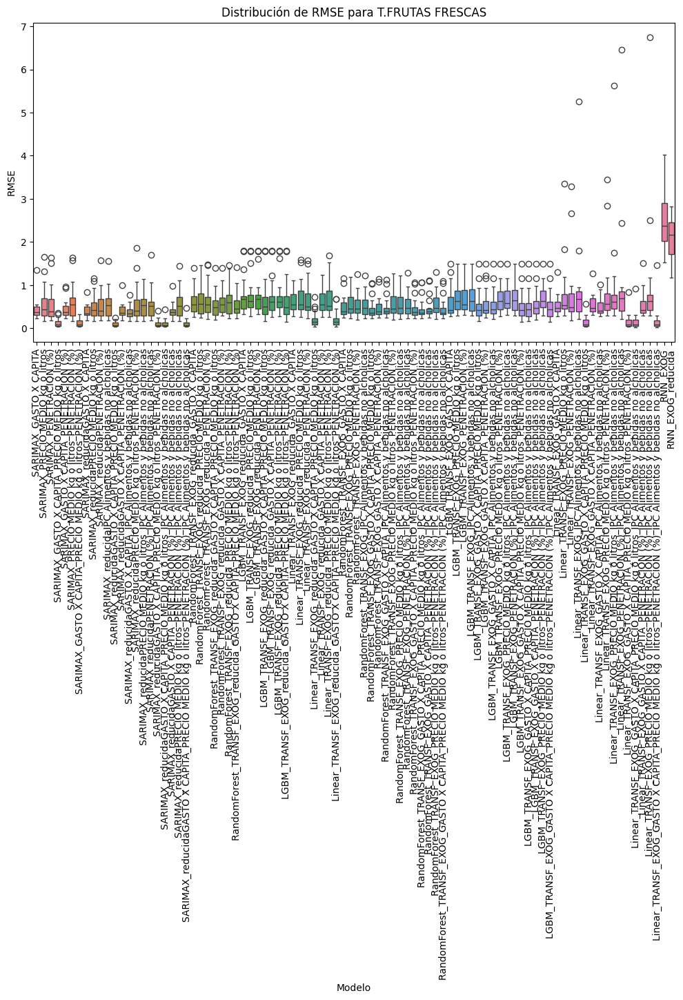

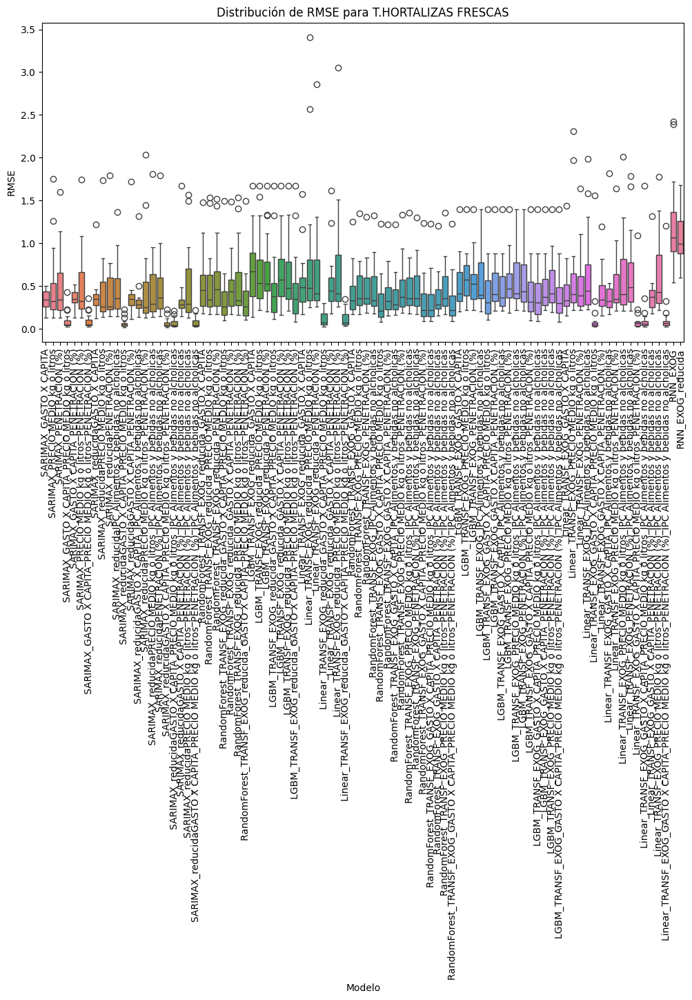

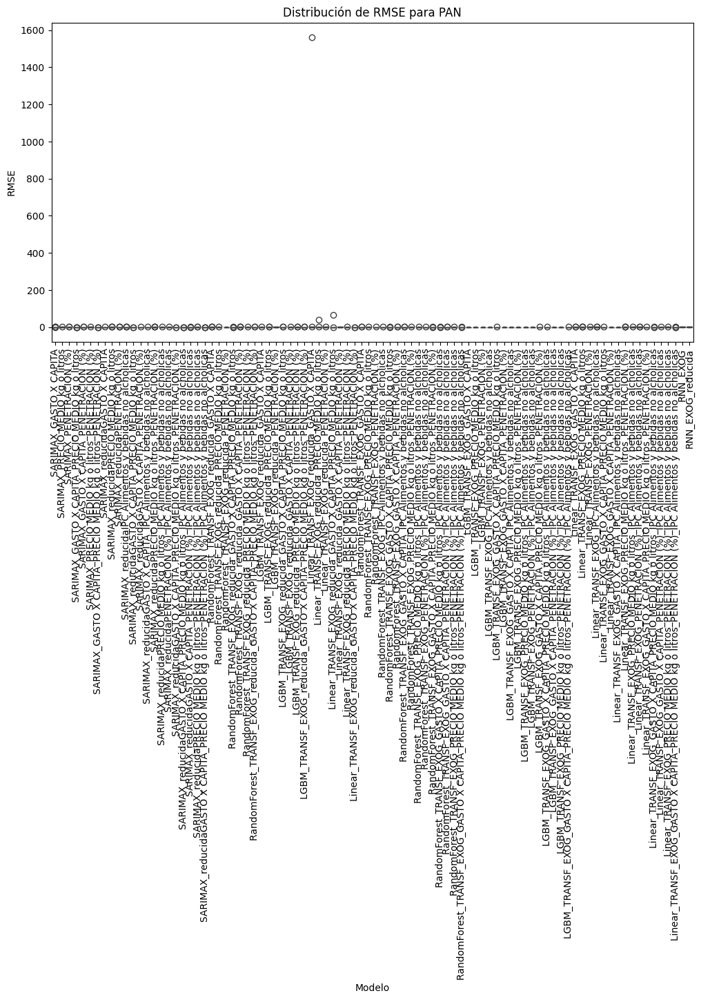

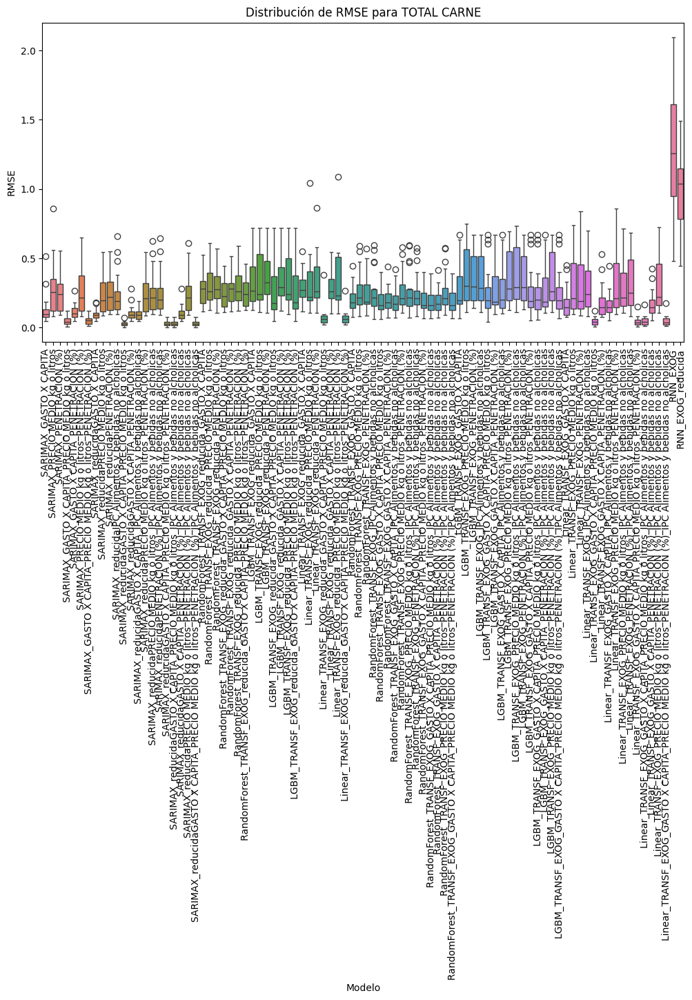

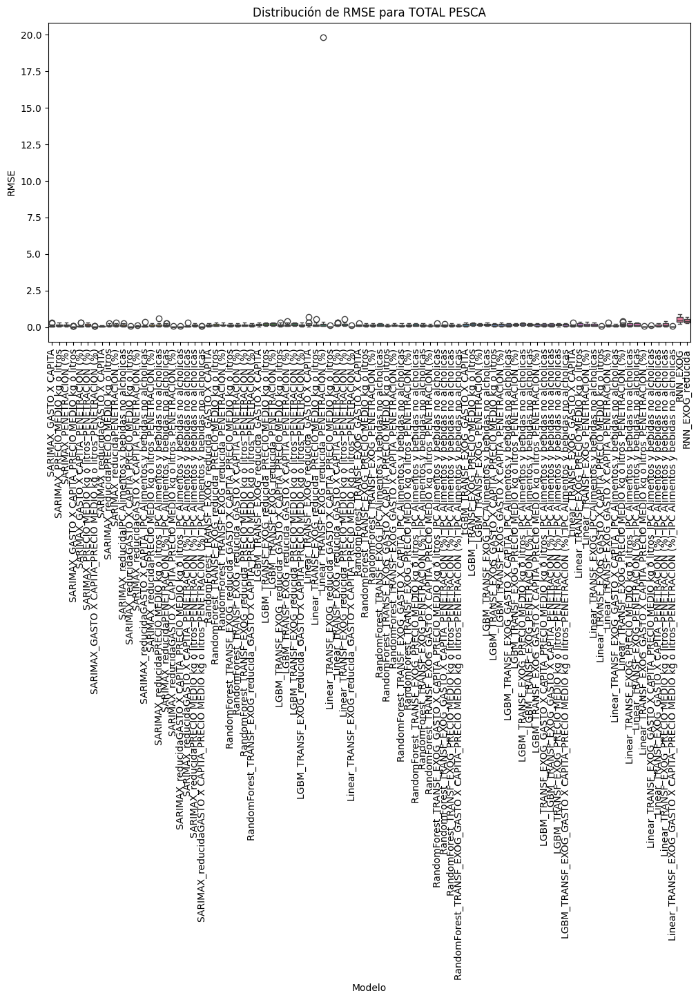

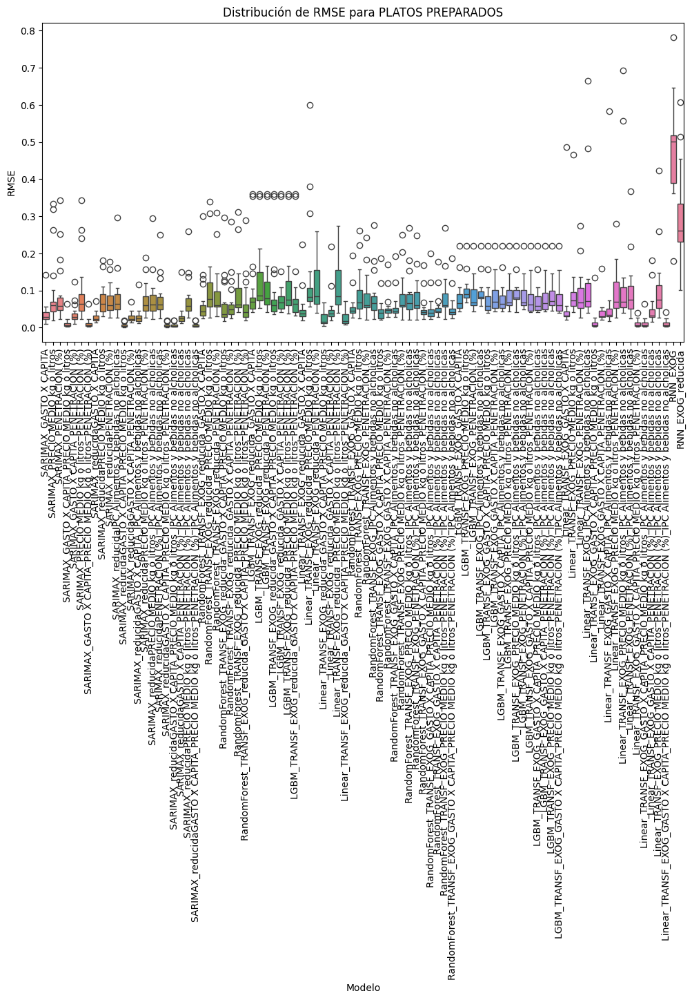

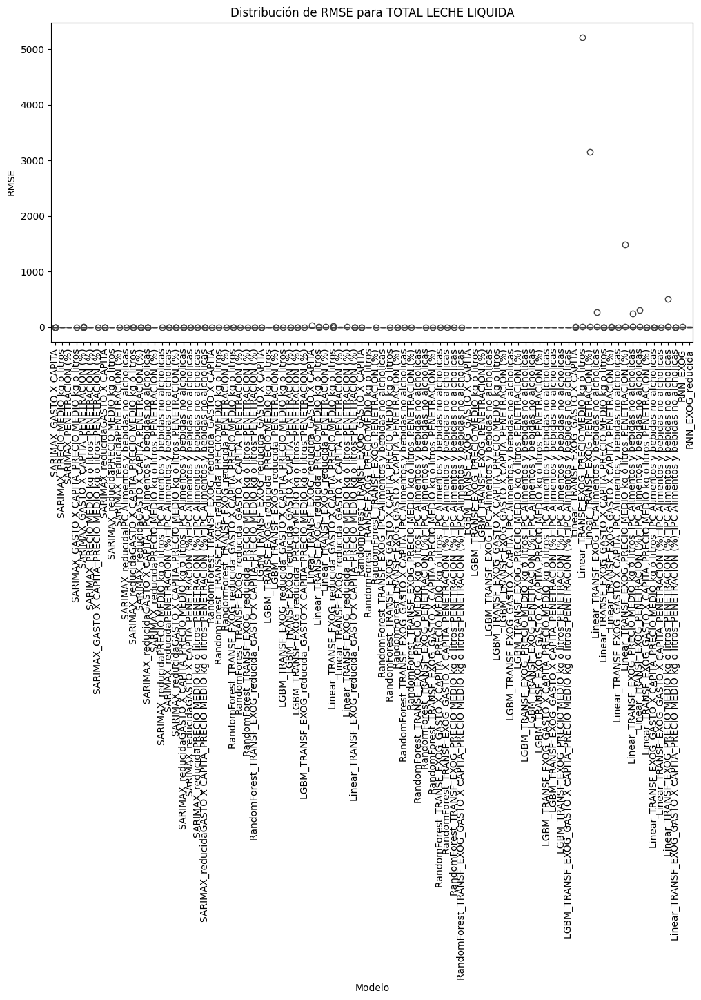

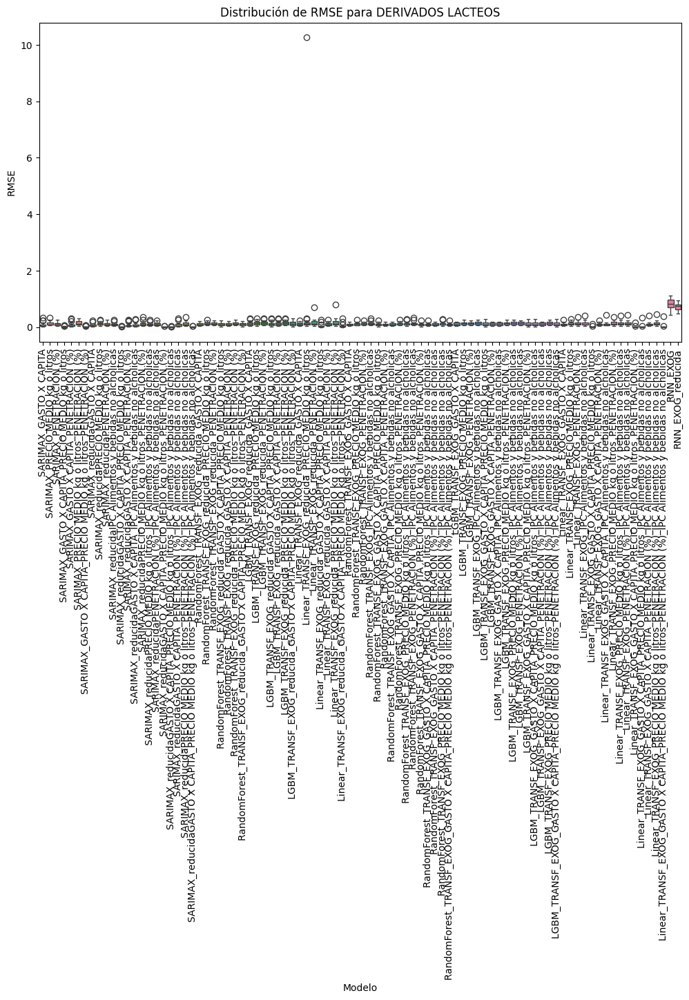

In [49]:
modelos_a_eliminar = ['HoltWinters', 'ARIMA', 'RandomForest', 'LGBM', 'Linear', 'BaseLine', 'RNN', 'Prophet']


filtered_results = {
    alimento: {modelo: rmse_list for modelo, rmse_list in modelos.items() if modelo not in modelos_a_eliminar}
    for alimento, modelos in results.items()
}

data_for_boxplot = []

for alimento, modelos in filtered_results.items():
    for modelo, rmse_list in modelos.items():
        for rmse in rmse_list:
            data_for_boxplot.append({
                'Alimento': alimento,
                'Modelo': modelo,
                'RMSE': rmse
            })


df_boxplot = pd.DataFrame(data_for_boxplot)
#alimentos = df_boxplot['Alimento'].unique()

for alimento in seleccion_alimentos:
    plt.figure(figsize=(12, 6))
    data_subset = df_boxplot[df_boxplot['Alimento'] == alimento]
    sns.boxplot(data=data_subset, x='Modelo', y='RMSE', hue='Modelo')
    plt.title(f'Distribución de RMSE para {alimento}')
    plt.xticks(rotation=90)
    plt.show()

Observamos que el regresor lineal en el modelo autoregresivo muestra el mismo patrón anterior. En el primer entrenamiento, con la ventana inicial, los resultados tienden a presentar una desviación significativa, lo que provoca un aumento considerable en la escala del eje y. Para obtener una visualización más clara y precisa del comportamiento general del modelo, se procederá a eliminar el primer valor del conjunto de datos. Esto permitirá observar con mayor detalle la consistencia y el desempeño del modelo en los entrenamientos subsiguientes, sin la influencia desproporcionada de las anomalías iniciales.

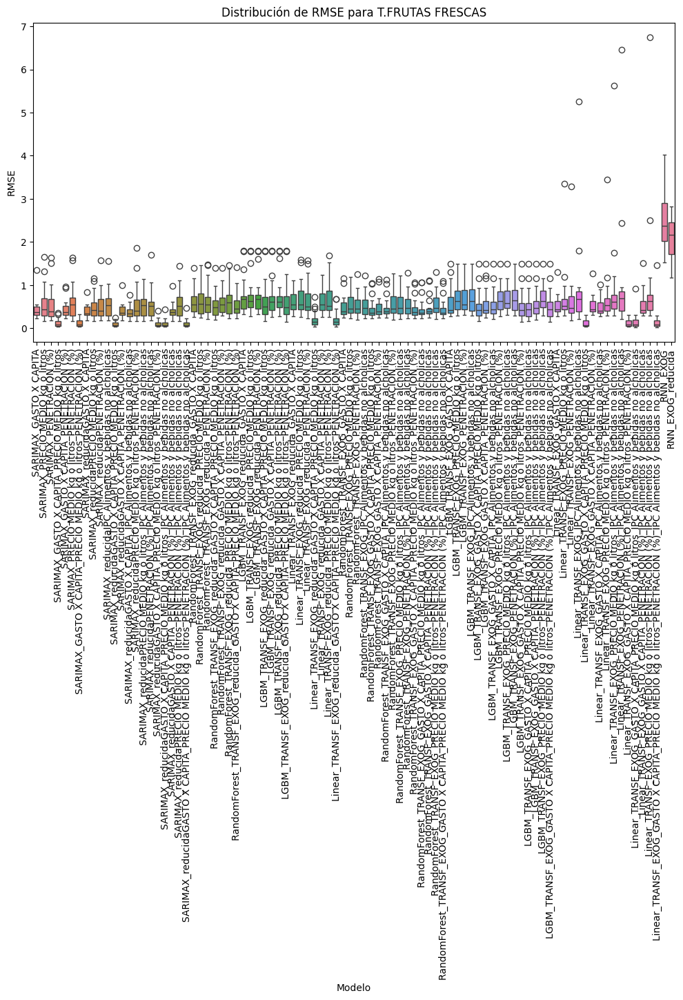

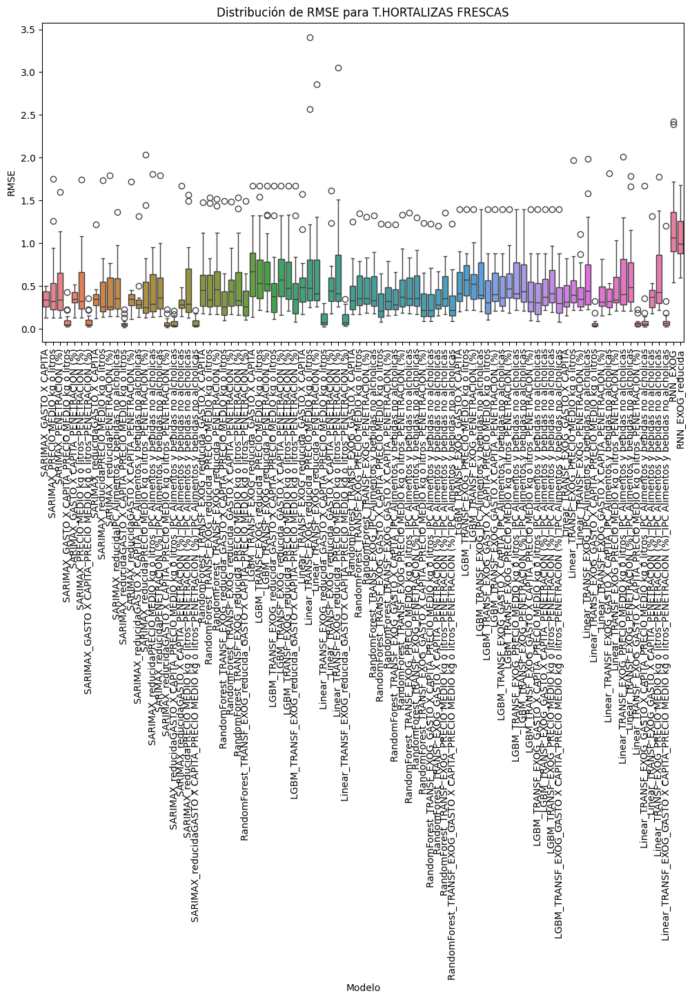

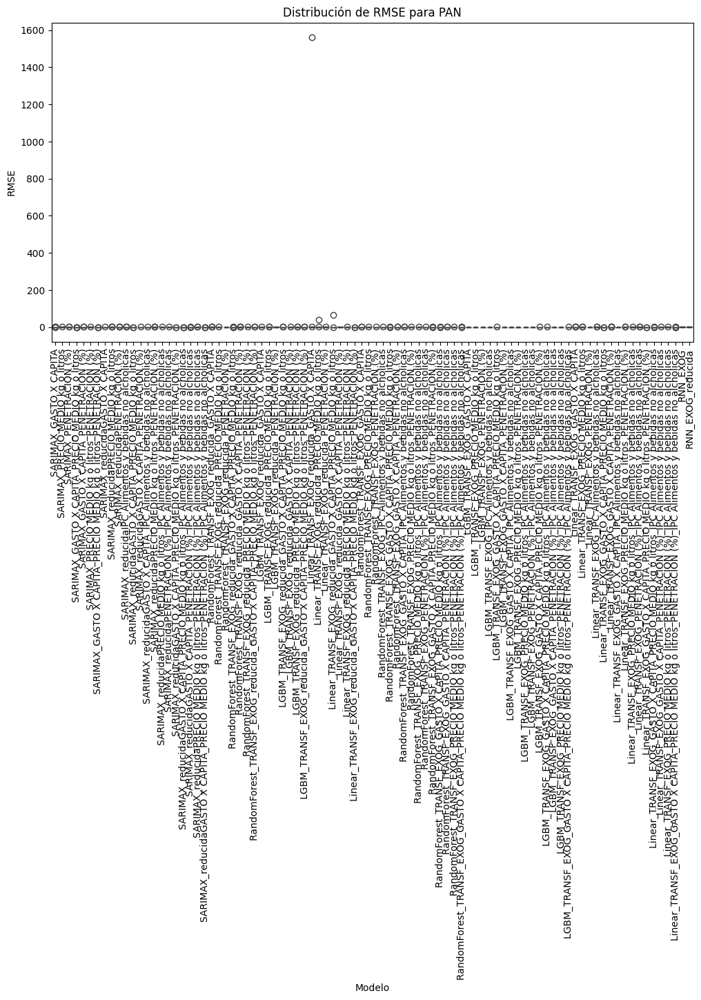

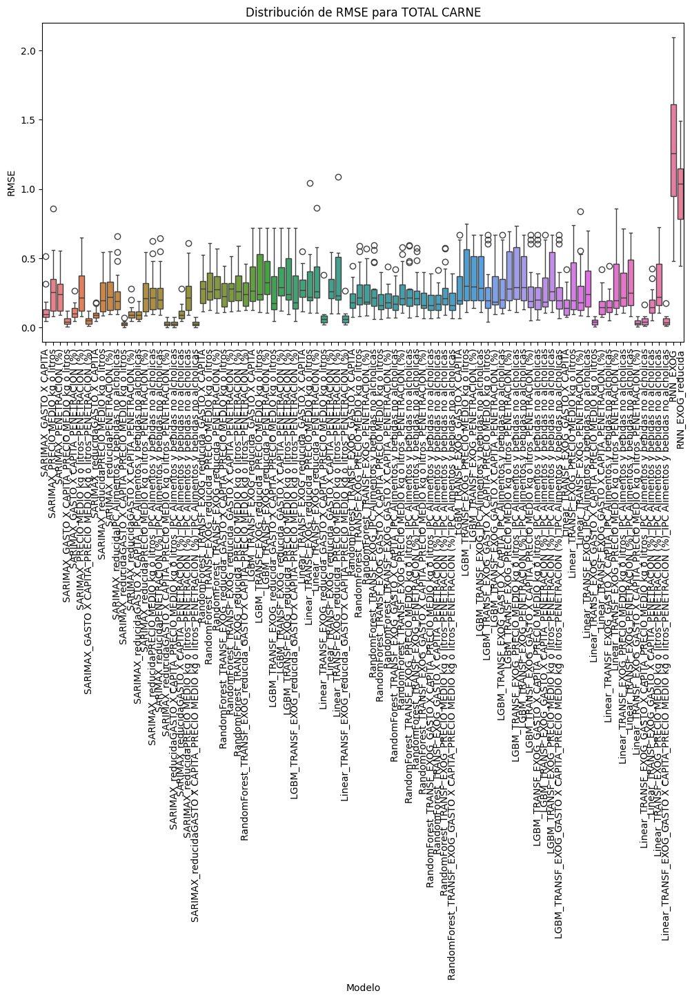

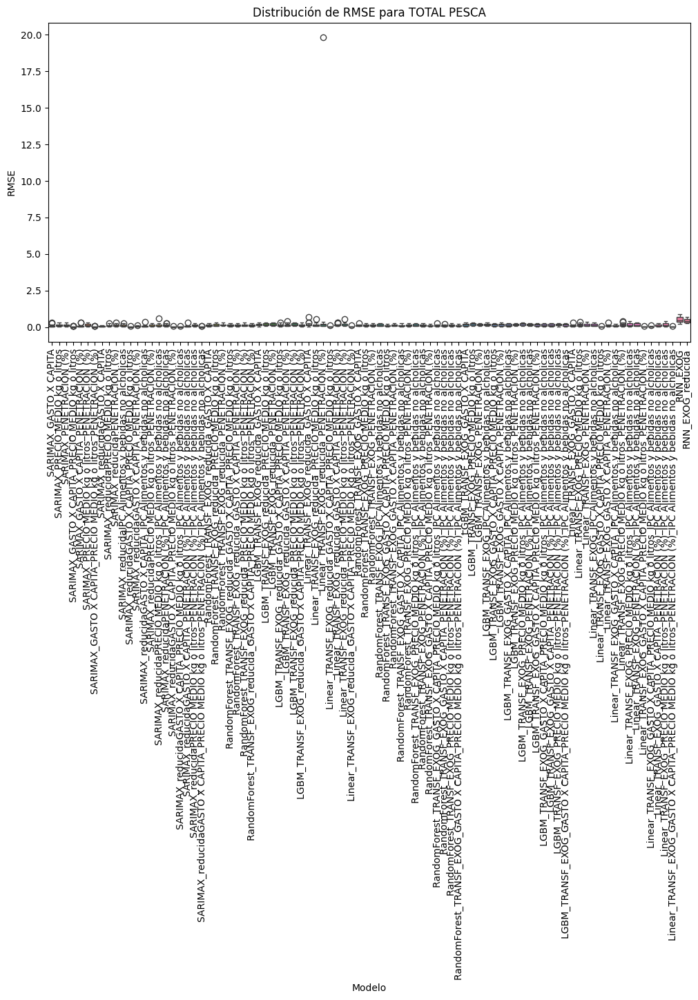

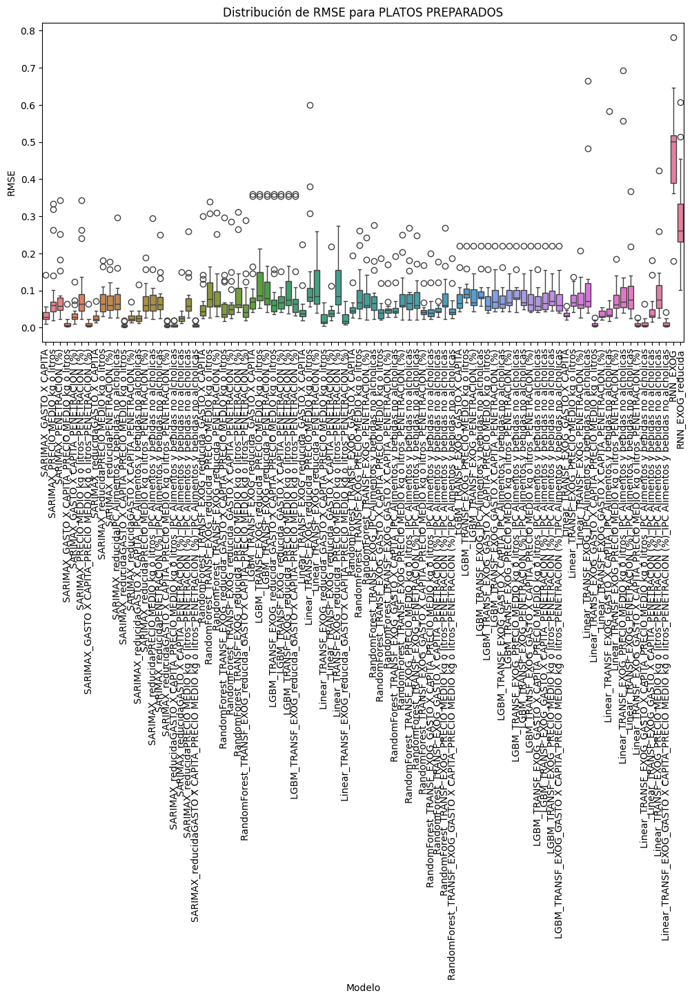

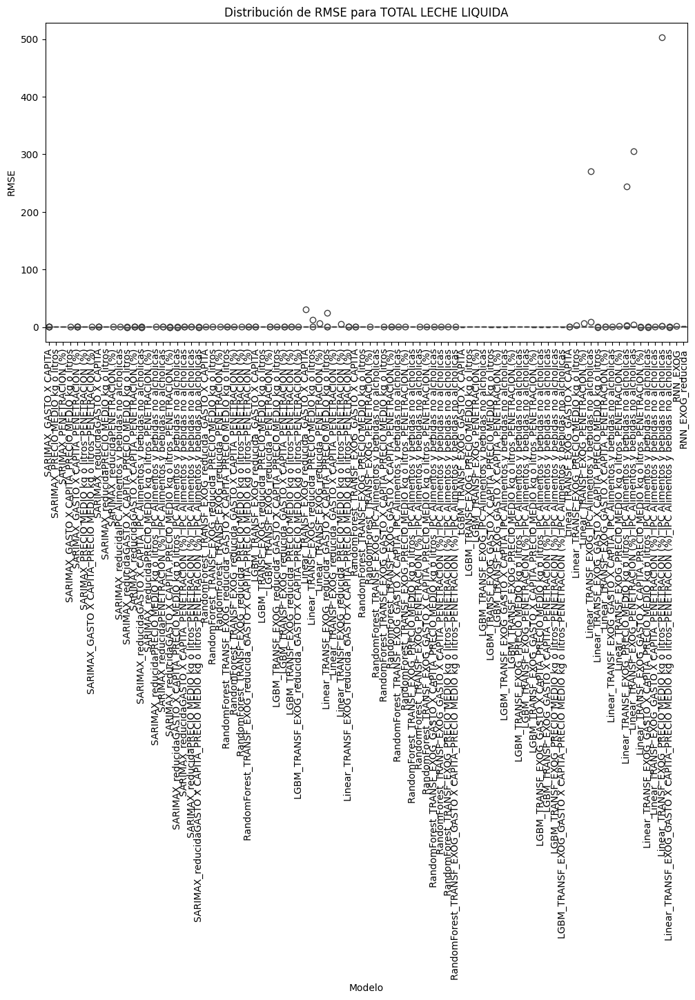

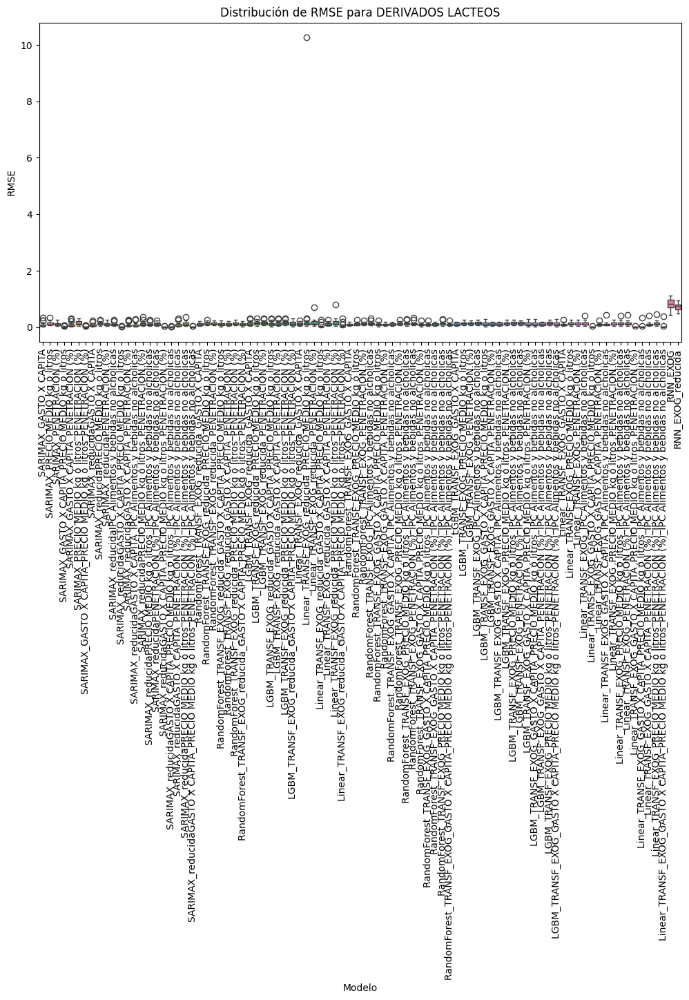

In [50]:
modelos_a_eliminar = ['HoltWinters', 'ARIMA', 'RandomForest', 'LGBM', 'BaseLine', 'Linear','RNN', 'Prophet']

filtered_results = {
    alimento: {modelo: rmse_list for modelo, rmse_list in modelos.items() if modelo not in modelos_a_eliminar}
    for alimento, modelos in results.items()
}

data_for_boxplot = []

linear_models_to_adjust = [
    'Linear_TRANSF_EXOG_GASTO X CAPITA',
    'Linear_TRANSF_EXOG_PRECIO MEDIO kg ó litros',
    'Linear_TRANSF_EXOG_PENETRACION (%)',
    'Linear_TRANSF_EXOG_GASTO X CAPITA_PRECIO MEDIO kg ó litros',
    'Linear_TRANSF_EXOG_GASTO X CAPITA_PENETRACION (%)',
    'Linear_TRANSF_EXOG_PRECIO MEDIO kg ó litros_PENETRACION (%)',
    'Linear_TRANSF_EXOG_GASTO X CAPITA_PRECIO MEDIO kg ó litros_PENETRACION (%)'
]

for alimento, modelos in filtered_results.items():
    for modelo, rmse_list in modelos.items():
        if modelo in linear_models_to_adjust and len(rmse_list) > 0:
            rmse_list = rmse_list[1:]
        for rmse in rmse_list:
            data_for_boxplot.append({
                'Alimento': alimento,
                'Modelo': modelo,
                'RMSE': rmse
            })

df_boxplot = pd.DataFrame(data_for_boxplot)
alimentos = df_boxplot['Alimento'].unique()

for alimento in alimentos:
    plt.figure(figsize=(12, 6))
    data_subset = df_boxplot[df_boxplot['Alimento'] == alimento]
    sns.boxplot(data=data_subset, x='Modelo', y='RMSE', hue='Modelo')
    plt.title(f'Distribución de RMSE para {alimento}')
    plt.xticks(rotation=90)
    plt.show()

Nuevamente se observa una mayor variabilidad en el modelo RNN con exogenas, en un principio habiendo observado en el modelo univariante mayor variabilidad podriamos a verlo descartado, pero ahora definitivamente podemos descartarllo. Incluyendo las variables exogenas podemos destacar el modelo autoregresivo con regresor lineal y SARIMAX, con las variables exogeneas gasto per capita y precio medio, y por otro lado, la combinación de las 3 en ambos modelos. En este caso, dado que mayor numero de variables exogenas implica mayor aletoriedad en los pronosticos porque también se deben predecir dichas variables, optaremos por escogewr el modelo más simple, el autoregresivo lineal y el sarimax con la combinación de dos exogenas gasto per capita y precio medio para comparar con los modelos univariantes. 


# SELECCIÓN FINAL MODELOS 

In [51]:
print_top_5_models(df_rmse)

Alimento: T.FRUTAS FRESCAS
SARIMAX_GASTO X CAPITA_PRECIO MEDIO kg ó litros_PENETRACION (%)    0.272177
SARIMAX_GASTO X CAPITA_PRECIO MEDIO kg ó litros                    0.276589
Linear_EXOG_PRECIO MEDIO kg ó litros                               0.338960
Linear_EXOG_PRECIO MEDIO kg ó litros_PENETRACION (%)               0.348051
HOLT-WINTERS                                                       0.385968
Name: T.FRUTAS FRESCAS, dtype: float64


Alimento: T.HORTALIZAS FRESCAS
HOLT-WINTERS                                                       0.172285
SARIMAX_GASTO X CAPITA_PRECIO MEDIO kg ó litros_PENETRACION (%)    0.185153
SARIMAX_GASTO X CAPITA_PRECIO MEDIO kg ó litros                    0.186485
RandomForest_EXOG_GASTO X CAPITA                                   0.196583
Linear_EXOG_PRECIO MEDIO kg ó litros                               0.200438
Name: T.HORTALIZAS FRESCAS, dtype: float64


Alimento: PAN
SARIMAX_GASTO X CAPITA_PRECIO MEDIO kg ó litros                    0.034089
SARIMA

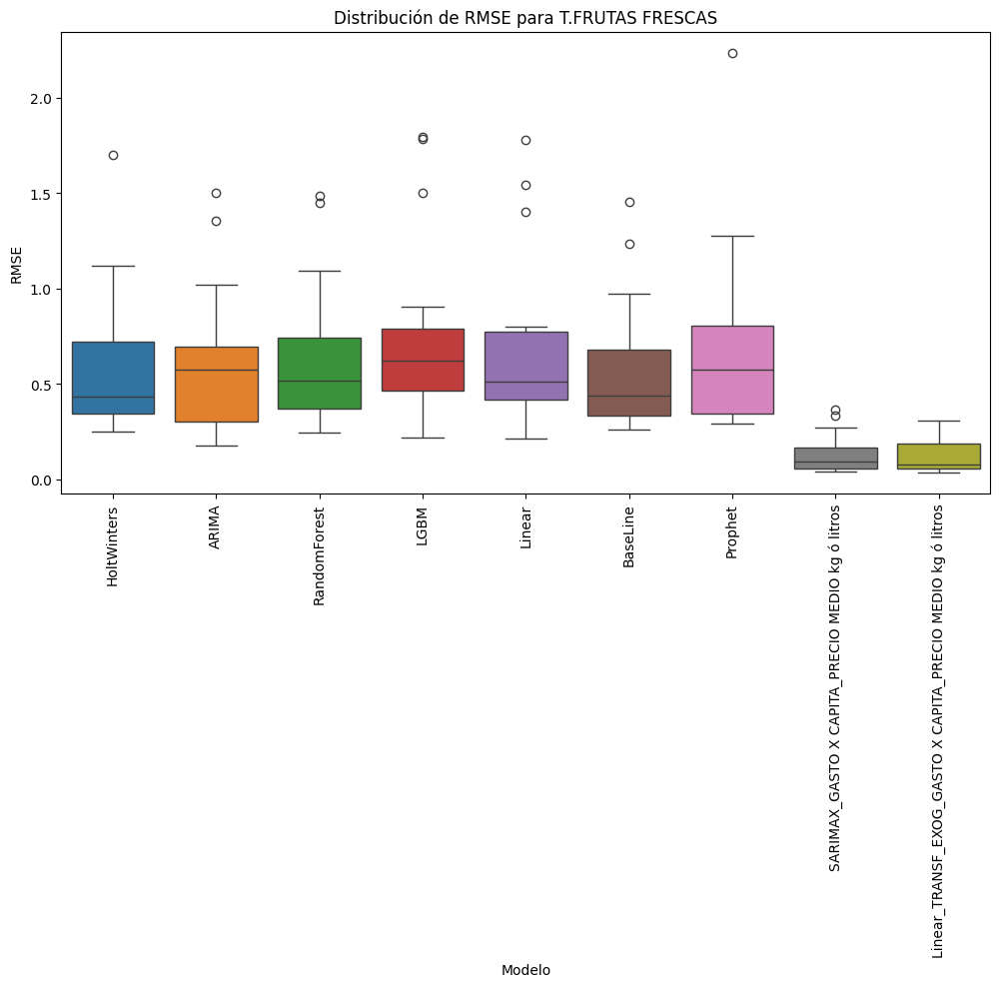

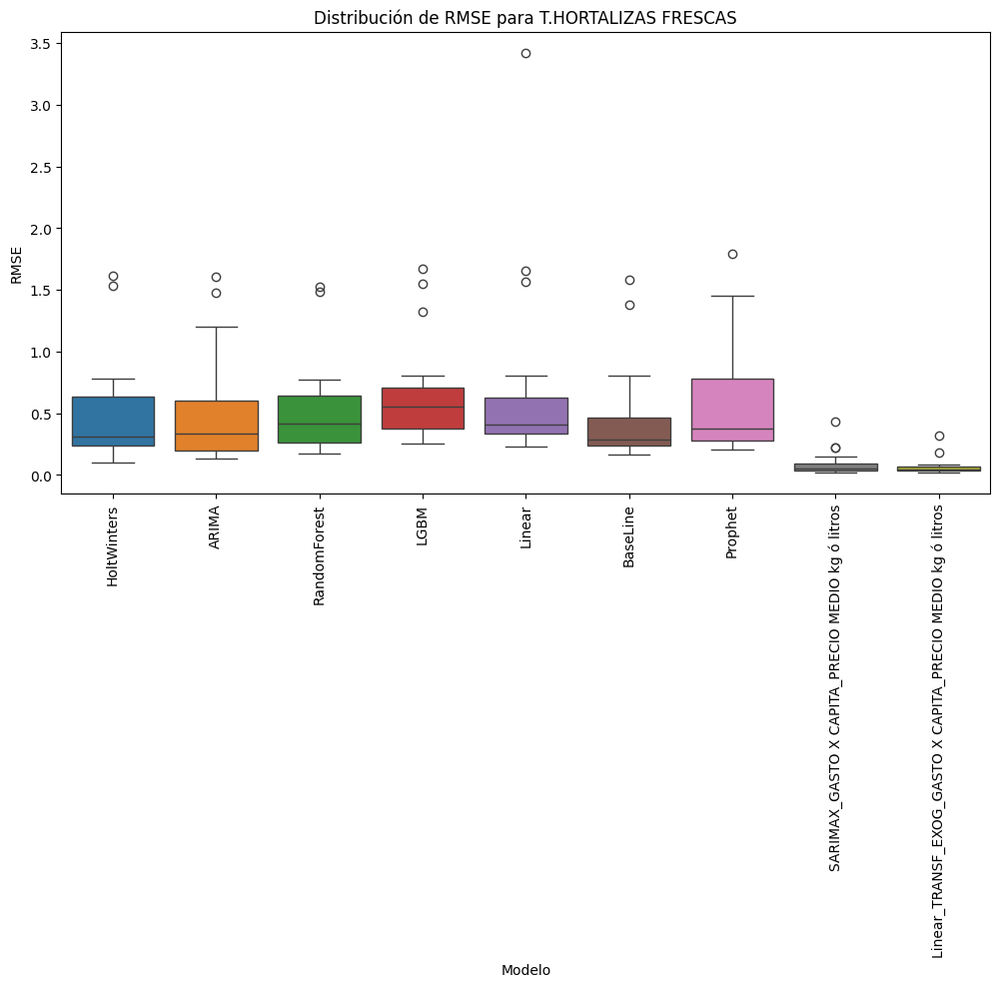

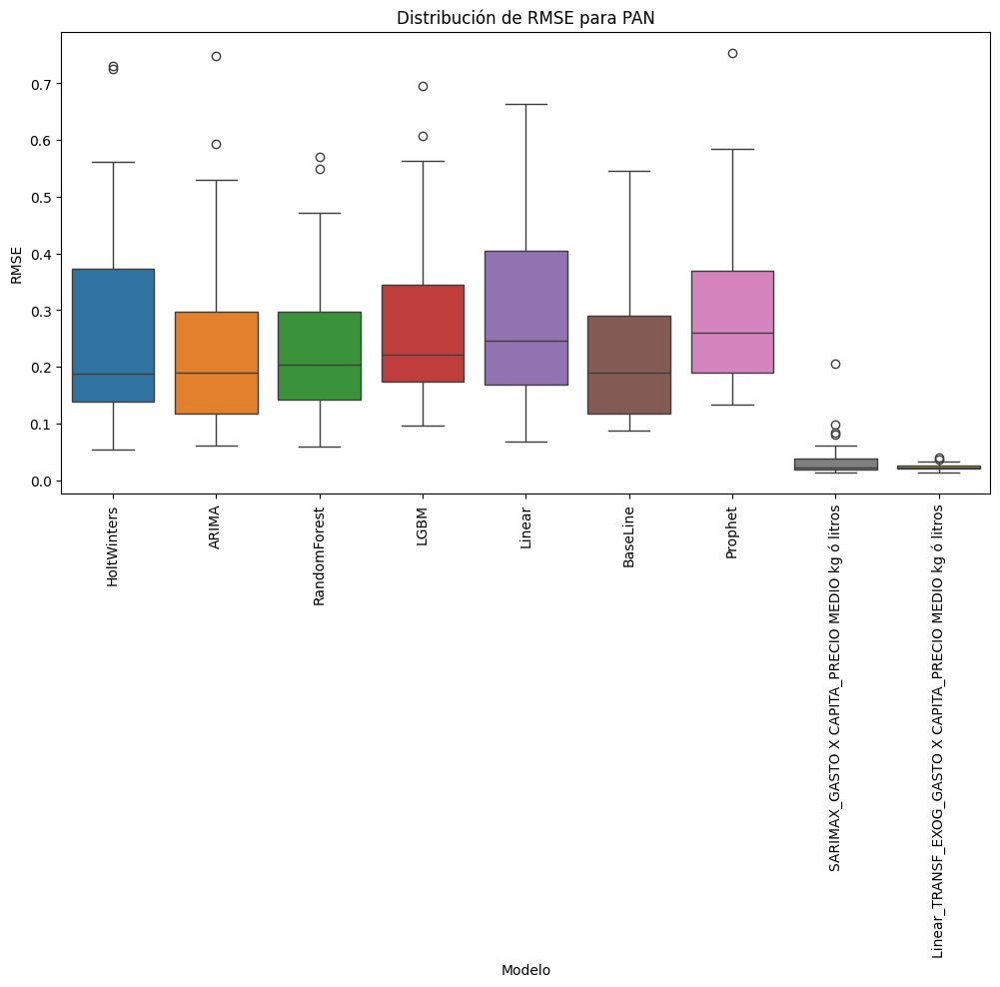

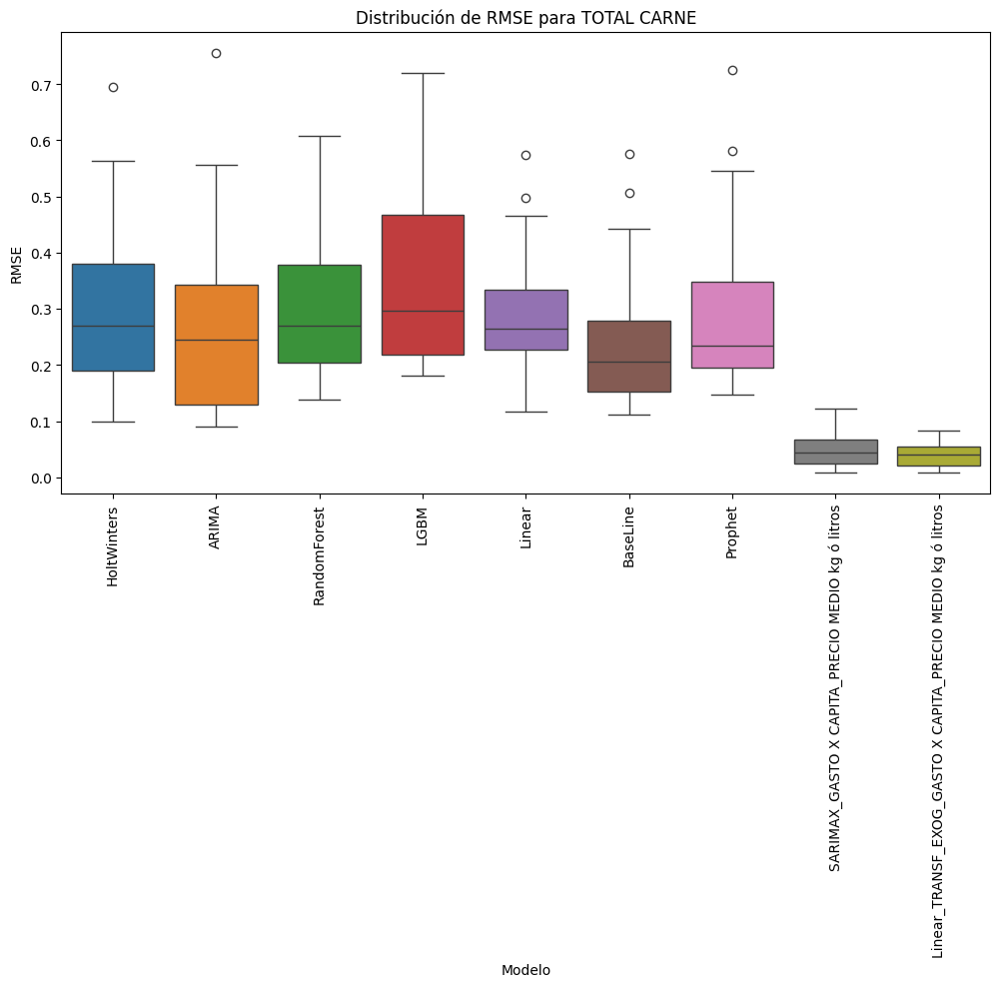

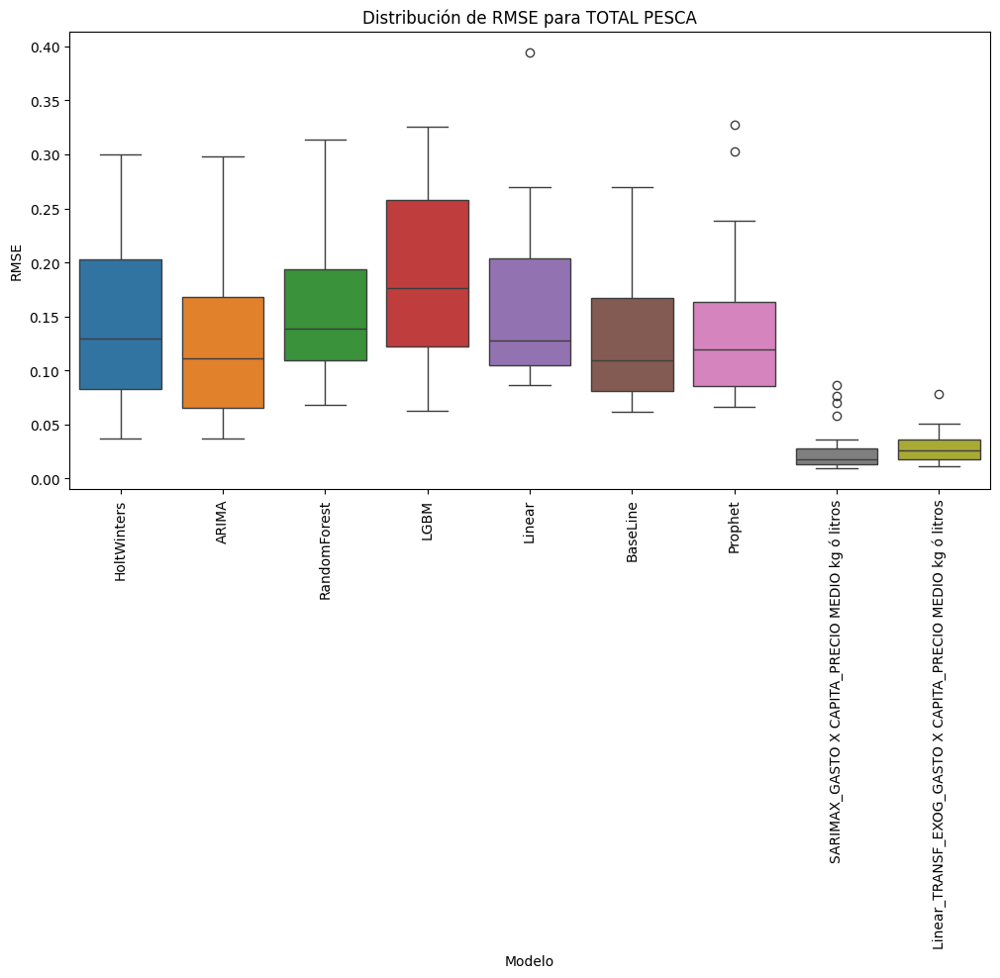

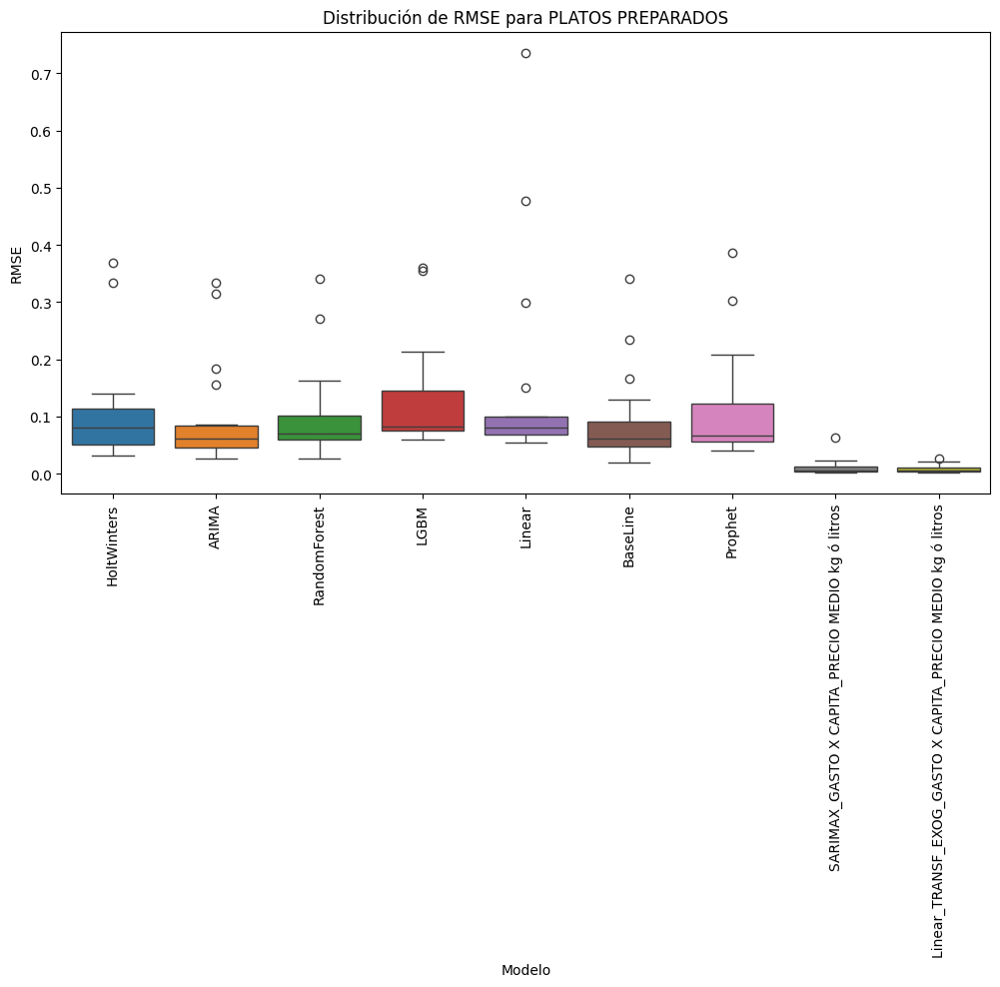

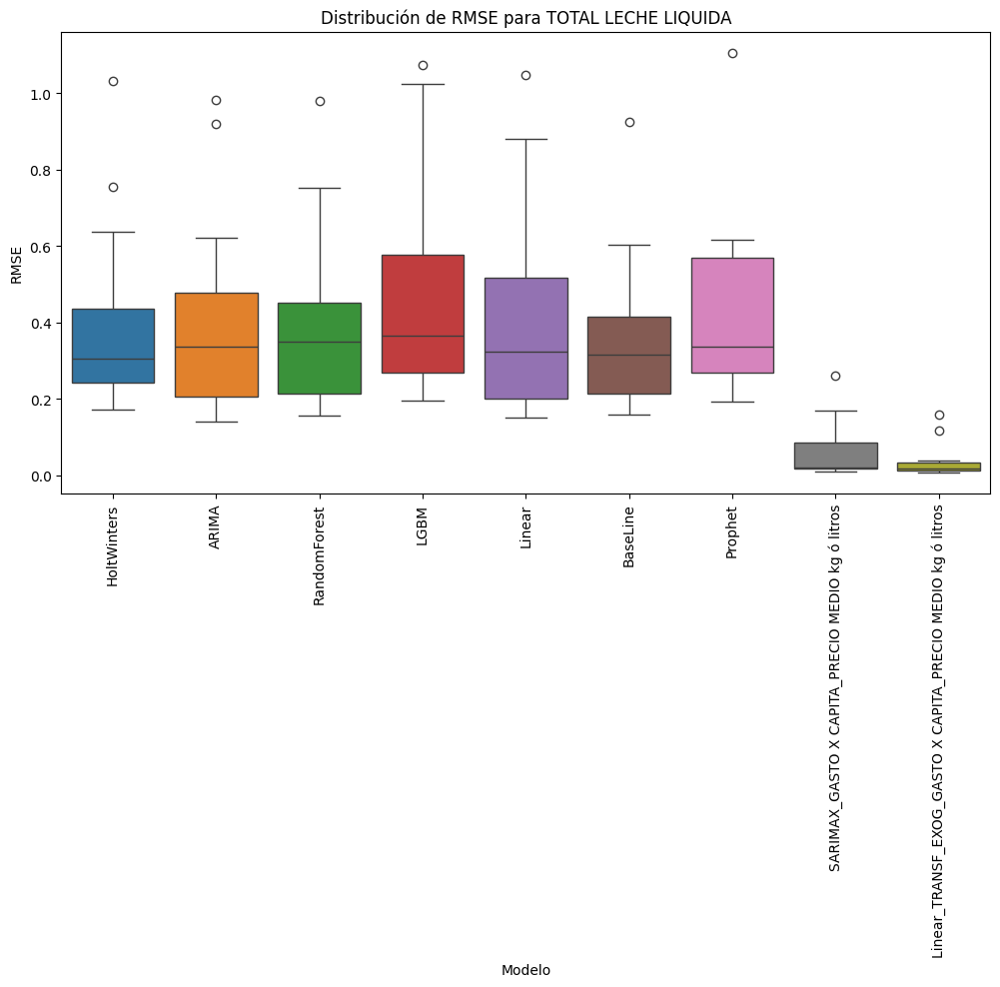

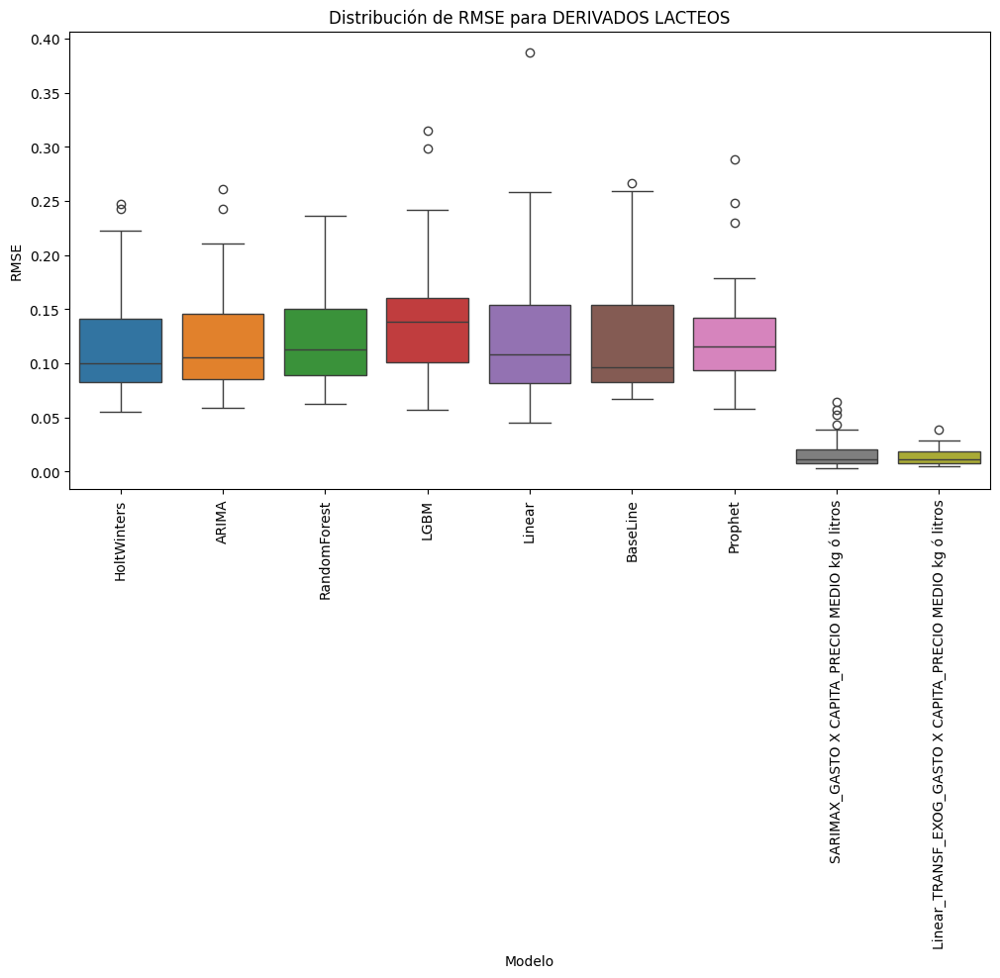

In [52]:
# Definir los modelos a incluir: la parte de univariante y multivariante escogidos. 
modelos_a_incluir = [
    'HoltWinters', 'ARIMA', 'RandomForest', 'LGBM', 'BaseLine', 'Linear', 'Prophet',
    'Linear_TRANSF_EXOG_GASTO X CAPITA_PRECIO MEDIO kg ó litros', 'SARIMAX_GASTO X CAPITA_PRECIO MEDIO kg ó litros'
]

# Filtrar los resultados para incluir solo los modelos especificados
filtered_results = {
    alimento: {modelo: rmse_list for modelo, rmse_list in modelos.items() if modelo in modelos_a_incluir}
    for alimento, modelos in results.items()
}

"""Dado que los modelos autoregresivos con regresor lineal presentan un desvío en la primera predicción. 
se listan para ajustarlos y eliminar el primer valor"""

linear_models_to_adjust = [
    'Linear', 
    'Linear_TRANSF_EXOG_GASTO X CAPITA_PRECIO MEDIO kg ó litros',
]

# Preparar los datos para el box plot
data_for_boxplot = []

for alimento, modelos in filtered_results.items():
    for modelo, rmse_list in modelos.items():
        # Modificar los resultados para eliminar el primer valor de los modelos lineales específicos
        if modelo in linear_models_to_adjust and len(rmse_list) > 0:
            rmse_list = rmse_list[1:]
        for rmse in rmse_list:
            data_for_boxplot.append({
                'Alimento': alimento,
                'Modelo': modelo,
                'RMSE': rmse
            })

df_boxplot = pd.DataFrame(data_for_boxplot)
alimentos = df_boxplot['Alimento'].unique()

for alimento in alimentos:
    plt.figure(figsize=(12, 6))
    data_subset = df_boxplot[df_boxplot['Alimento'] == alimento]
    sns.boxplot(data=data_subset, x='Modelo', y='RMSE', hue='Modelo')
    plt.title(f'Distribución de RMSE para {alimento}')
    plt.xticks(rotation=90)
    plt.show()

Observamos claramente como el modelo autoregresivo lineal y SARIMAX con dos variables exogenas presentan el mejor comportamiento frente a todas las series. Antes de continuar aplicaremos un fine tuning de ambos modelos y procederemos a evaluarlos con intervalos. 

# FINETUNING MODELOS SELECCIONADOS

## MODELO AUTOREGRESIVO REGRESOR LINEAL

In [53]:
resultados_dict_grid={}

for alimento, serie in dict_series_mensuales_nacional.items():
    serie_filtrada = serie[serie.index.year != 2024]
    train = serie_filtrada[:-steps]
    exog_variables = ['GASTO X CAPITA', 'PRECIO MEDIO kg ó litros']
    
    forecaster = ForecasterAutoreg(
        regressor=LinearRegression(),
        lags=12
    )
    
    # Valores candidatos de lags
    lags_grid = [3,6,12,18]

    """En linear regression tenemos pocos parámetros para definir ya que la mayoria son de gestión computacional: 
    copy_X o n_jobs. Solo tenemos el fit_intercept que nos define si el modelo debe calcular el intercepto. 
    """
    param_grid = {
    'fit_intercept': [True, False],
}

    
    steps = 12

    resultados_grid = grid_search_forecaster(
        forecaster=forecaster,
        y=train['CONSUMO X CAPITA'],
        exog=train[exog_variables],
        param_grid=param_grid,  
        lags_grid=lags_grid,
        steps=steps,
        refit= True,
        metric='mean_squared_error',
        initial_train_size=24,
        fixed_train_size=False,
        return_best=False,
        n_jobs='auto',
        verbose=False
    )
    
    resultados_dict_grid[alimento] = resultados_grid


Number of models compared: 8.


lags grid: 100%|█████████████████████████████████████████████████████████████████████████| 4/4 [00:00<00:00,  4.16it/s]


Number of models compared: 8.


lags grid: 100%|█████████████████████████████████████████████████████████████████████████| 4/4 [00:00<00:00,  4.20it/s]


Number of models compared: 8.


lags grid: 100%|█████████████████████████████████████████████████████████████████████████| 4/4 [00:00<00:00,  4.19it/s]


Number of models compared: 8.


lags grid: 100%|█████████████████████████████████████████████████████████████████████████| 4/4 [00:00<00:00,  4.24it/s]


Number of models compared: 8.


lags grid: 100%|█████████████████████████████████████████████████████████████████████████| 4/4 [00:00<00:00,  4.21it/s]


Number of models compared: 8.


lags grid: 100%|█████████████████████████████████████████████████████████████████████████| 4/4 [00:00<00:00,  4.16it/s]


Number of models compared: 8.


lags grid: 100%|█████████████████████████████████████████████████████████████████████████| 4/4 [00:00<00:00,  4.25it/s]


Number of models compared: 8.


lags grid: 100%|█████████████████████████████████████████████████████████████████████████| 4/4 [00:00<00:00,  4.21it/s]


In [54]:
pd.set_option('display.float_format', '{:.6f}'.format)

for alimento, resultados in resultados_dict_grid.items():
    print(f"Resultados para el alimento {alimento}:\n")
    display(resultados.head(10))

Resultados para el alimento T.FRUTAS FRESCAS:



,lags,lags_label,params,mean_squared_error,fit_intercept
0,"[1, 2, 3]","[1, 2, 3]",{'fit_intercept': True},0.057287,True
2,"[1, 2, 3, 4, 5, 6]","[1, 2, 3, 4, 5, 6]",{'fit_intercept': True},0.060805,True
4,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]",{'fit_intercept': True},0.084418,True
6,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...",{'fit_intercept': True},0.121046,True
7,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...",{'fit_intercept': False},0.658644,False
5,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]",{'fit_intercept': False},0.795488,False
3,"[1, 2, 3, 4, 5, 6]","[1, 2, 3, 4, 5, 6]",{'fit_intercept': False},1.244180,False
1,"[1, 2, 3]","[1, 2, 3]",{'fit_intercept': False},1.503524,False


Resultados para el alimento T.HORTALIZAS FRESCAS:



,lags,lags_label,params,mean_squared_error,fit_intercept
2,"[1, 2, 3, 4, 5, 6]","[1, 2, 3, 4, 5, 6]",{'fit_intercept': True},0.019703,True
0,"[1, 2, 3]","[1, 2, 3]",{'fit_intercept': True},0.021436,True
4,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]",{'fit_intercept': True},0.022602,True
6,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...",{'fit_intercept': True},0.134555,True
5,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]",{'fit_intercept': False},0.305381,False
7,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...",{'fit_intercept': False},0.425218,False
1,"[1, 2, 3]","[1, 2, 3]",{'fit_intercept': False},0.634012,False
3,"[1, 2, 3, 4, 5, 6]","[1, 2, 3, 4, 5, 6]",{'fit_intercept': False},0.774508,False


Resultados para el alimento PAN:



,lags,lags_label,params,mean_squared_error,fit_intercept
2,"[1, 2, 3, 4, 5, 6]","[1, 2, 3, 4, 5, 6]",{'fit_intercept': True},0.004385,True
0,"[1, 2, 3]","[1, 2, 3]",{'fit_intercept': True},0.005055,True
6,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...",{'fit_intercept': True},0.033751,True
7,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...",{'fit_intercept': False},0.110243,False
5,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]",{'fit_intercept': False},0.140328,False
3,"[1, 2, 3, 4, 5, 6]","[1, 2, 3, 4, 5, 6]",{'fit_intercept': False},0.184211,False
1,"[1, 2, 3]","[1, 2, 3]",{'fit_intercept': False},0.188598,False
4,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]",{'fit_intercept': True},201.325754,True


Resultados para el alimento TOTAL CARNE:



,lags,lags_label,params,mean_squared_error,fit_intercept
2,"[1, 2, 3, 4, 5, 6]","[1, 2, 3, 4, 5, 6]",{'fit_intercept': True},0.008813,True
0,"[1, 2, 3]","[1, 2, 3]",{'fit_intercept': True},0.009739,True
4,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]",{'fit_intercept': True},0.012524,True
6,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...",{'fit_intercept': True},0.014960,True
7,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...",{'fit_intercept': False},0.121715,False
3,"[1, 2, 3, 4, 5, 6]","[1, 2, 3, 4, 5, 6]",{'fit_intercept': False},0.166887,False
5,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]",{'fit_intercept': False},0.185568,False
1,"[1, 2, 3]","[1, 2, 3]",{'fit_intercept': False},0.219921,False


Resultados para el alimento TOTAL PESCA:



,lags,lags_label,params,mean_squared_error,fit_intercept
2,"[1, 2, 3, 4, 5, 6]","[1, 2, 3, 4, 5, 6]",{'fit_intercept': True},0.002858,True
0,"[1, 2, 3]","[1, 2, 3]",{'fit_intercept': True},0.002955,True
4,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]",{'fit_intercept': True},0.002962,True
6,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...",{'fit_intercept': True},0.003720,True
5,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]",{'fit_intercept': False},0.022700,False
7,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...",{'fit_intercept': False},0.033939,False
3,"[1, 2, 3, 4, 5, 6]","[1, 2, 3, 4, 5, 6]",{'fit_intercept': False},0.053285,False
1,"[1, 2, 3]","[1, 2, 3]",{'fit_intercept': False},0.136090,False


Resultados para el alimento PLATOS PREPARADOS:



,lags,lags_label,params,mean_squared_error,fit_intercept
4,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]",{'fit_intercept': True},0.001321,True
2,"[1, 2, 3, 4, 5, 6]","[1, 2, 3, 4, 5, 6]",{'fit_intercept': True},0.001422,True
0,"[1, 2, 3]","[1, 2, 3]",{'fit_intercept': True},0.001587,True
6,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...",{'fit_intercept': True},0.001606,True
5,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]",{'fit_intercept': False},0.012405,False
1,"[1, 2, 3]","[1, 2, 3]",{'fit_intercept': False},0.016466,False
3,"[1, 2, 3, 4, 5, 6]","[1, 2, 3, 4, 5, 6]",{'fit_intercept': False},0.032370,False
7,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...",{'fit_intercept': False},0.056316,False


Resultados para el alimento TOTAL LECHE LIQUIDA:



,lags,lags_label,params,mean_squared_error,fit_intercept
2,"[1, 2, 3, 4, 5, 6]","[1, 2, 3, 4, 5, 6]",{'fit_intercept': True},0.023566,True
0,"[1, 2, 3]","[1, 2, 3]",{'fit_intercept': True},0.025362,True
6,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...",{'fit_intercept': True},0.162333,True
3,"[1, 2, 3, 4, 5, 6]","[1, 2, 3, 4, 5, 6]",{'fit_intercept': False},0.335730,False
1,"[1, 2, 3]","[1, 2, 3]",{'fit_intercept': False},0.531221,False
5,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]",{'fit_intercept': False},1.054799,False
7,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...",{'fit_intercept': False},15.423995,False
4,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]",{'fit_intercept': True},26.889356,True


Resultados para el alimento DERIVADOS LACTEOS:



,lags,lags_label,params,mean_squared_error,fit_intercept
0,"[1, 2, 3]","[1, 2, 3]",{'fit_intercept': True},0.001441,True
2,"[1, 2, 3, 4, 5, 6]","[1, 2, 3, 4, 5, 6]",{'fit_intercept': True},0.001449,True
6,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...",{'fit_intercept': True},0.004298,True
4,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]",{'fit_intercept': True},0.005255,True
7,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...",{'fit_intercept': False},0.025557,False
5,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]",{'fit_intercept': False},0.047199,False
1,"[1, 2, 3]","[1, 2, 3]",{'fit_intercept': False},0.139109,False
3,"[1, 2, 3, 4, 5, 6]","[1, 2, 3, 4, 5, 6]",{'fit_intercept': False},0.145737,False


Observamos en este caso como las series tienen un comportamiento distinto dependiendo del número de lags que apliquemos, respecto al parámetro fit_intercept como podiamos esperar lo dejaremos como predeterminado en True. Por tanto, solo nos fijamos en los lags y concluimos con los siguientes modelos autoregresivos con regresor lineal para cada serie de alimento:

- T.FRUTAS FRESCAS: 3 lags.
- T.HORTALIZAS FRESCAS: 6 lags.
- PAN: 6 lags.
- TOTAL CARNE: 6 lags.
- TOTAL PESCA: 3 lags.
- PLATOS PREPARADOS: 12 lags.
- TOTAL LECHE LIQUIDA: 6 lags.
- DERIVADOS LACTEOS: 3 lags. 


## MODELO SARIMAX

En la búsqueda de los mejores parámetros de SARIMAX podemos aplicar backtesting o selección basada en AIC como aplicamos anteriormente con pdarima, pm.auto_arima. En este caso, optamos por aplicar lo mismo que en el modelo autoregresivo aprovechando la funcionalidad de skforecast pero solo incluyendo en el grid las combinaciones de los best models del autorima realizado inicialmente con pm.auto_arima para reducir la carga computacional.Después en el análisis final de intervalos se acabará de ajustar los modelos si se observa un buen comportamiento

In [55]:
resultados_dict_grid2={}
for alimento, serie in dict_series_mensuales_nacional.items():
    serie_filtrada = serie[serie.index.year != 2024]
    train = serie_filtrada[:-steps]
    exog_variables = ['GASTO X CAPITA', 'PRECIO MEDIO kg ó litros']
    
    forecaster = ForecasterSarimax(
                     regressor=Sarimax(
                                    order=(1, 0, 1),
                                    seasonal_order=(0, 1, 1, 12))
                                )

    param_grid = {
    'order': [
        (1, 0, 1),  
        (2, 0, 0),  
        (2, 0, 1),  
        (1, 0, 2),  
    ],
    'seasonal_order': [
        (0, 1, 2, 12),  
        (2, 1, 1, 12),  
        (1, 1, 1, 12),  
        (0, 1, 1, 12),  
    ],
        'trend': [None, 'n', 'c']
    }


    resultados_grid = grid_search_sarimax(
                            forecaster            = forecaster,
                            y                     = train['CONSUMO X CAPITA'],
                            exog                  = train[exog_variables],
                            param_grid            = param_grid,
                            steps                 = 12,
                            refit                 = True,
                            metric                = 'mean_absolute_error',
                            initial_train_size    = 24,
                            fixed_train_size      = False,
                            return_best           = False,
                            n_jobs                = 'auto',
                            suppress_warnings_fit = True,
                            verbose               = False,
                            show_progress         = True
                       )
    resultados_dict_grid2[alimento] = resultados_grid

Number of models compared: 48.


params grid: 100%|█████████████████████████████████████████████████████████████████████| 48/48 [17:48<00:00, 22.26s/it]


Number of models compared: 48.


params grid: 100%|█████████████████████████████████████████████████████████████████████| 48/48 [18:08<00:00, 22.67s/it]


Number of models compared: 48.


params grid: 100%|█████████████████████████████████████████████████████████████████████| 48/48 [20:24<00:00, 25.51s/it]


Number of models compared: 48.


params grid: 100%|█████████████████████████████████████████████████████████████████████| 48/48 [18:47<00:00, 23.49s/it]


Number of models compared: 48.


params grid: 100%|█████████████████████████████████████████████████████████████████████| 48/48 [19:56<00:00, 24.93s/it]


Number of models compared: 48.


params grid: 100%|█████████████████████████████████████████████████████████████████████| 48/48 [25:19<00:00, 31.65s/it]


Number of models compared: 48.


params grid: 100%|█████████████████████████████████████████████████████████████████████| 48/48 [20:01<00:00, 25.03s/it]


Number of models compared: 48.


params grid: 100%|█████████████████████████████████████████████████████████████████████| 48/48 [21:27<00:00, 26.83s/it]


In [56]:
pd.set_option('display.float_format', '{:.6f}'.format)

for alimento, resultados in resultados_dict_grid2.items():
    print(f"Resultados para el alimento {alimento}:\n")
    display(resultados.head(10))

Resultados para el alimento T.FRUTAS FRESCAS:



,params,mean_absolute_error,order,seasonal_order,trend
6,"{'order': (1, 0, 1), 'seasonal_order': (1, 1, ...",0.116699,"(1, 0, 1)","(1, 1, 1, 12)",None
7,"{'order': (1, 0, 1), 'seasonal_order': (1, 1, ...",0.116699,"(1, 0, 1)","(1, 1, 1, 12)",n
9,"{'order': (1, 0, 1), 'seasonal_order': (0, 1, ...",0.116752,"(1, 0, 1)","(0, 1, 1, 12)",None
10,"{'order': (1, 0, 1), 'seasonal_order': (0, 1, ...",0.116752,"(1, 0, 1)","(0, 1, 1, 12)",n
3,"{'order': (1, 0, 1), 'seasonal_order': (2, 1, ...",0.117873,"(1, 0, 1)","(2, 1, 1, 12)",None
4,"{'order': (1, 0, 1), 'seasonal_order': (2, 1, ...",0.117873,"(1, 0, 1)","(2, 1, 1, 12)",n
16,"{'order': (2, 0, 0), 'seasonal_order': (2, 1, ...",0.118618,"(2, 0, 0)","(2, 1, 1, 12)",n
15,"{'order': (2, 0, 0), 'seasonal_order': (2, 1, ...",0.118618,"(2, 0, 0)","(2, 1, 1, 12)",None
22,"{'order': (2, 0, 0), 'seasonal_order': (0, 1, ...",0.119107,"(2, 0, 0)","(0, 1, 1, 12)",n
21,"{'order': (2, 0, 0), 'seasonal_order': (0, 1, ...",0.119107,"(2, 0, 0)","(0, 1, 1, 12)",None


Resultados para el alimento T.HORTALIZAS FRESCAS:



,params,mean_absolute_error,order,seasonal_order,trend
36,"{'order': (1, 0, 2), 'seasonal_order': (0, 1, ...",0.076236,"(1, 0, 2)","(0, 1, 2, 12)",None
37,"{'order': (1, 0, 2), 'seasonal_order': (0, 1, ...",0.076236,"(1, 0, 2)","(0, 1, 2, 12)",n
45,"{'order': (1, 0, 2), 'seasonal_order': (0, 1, ...",0.076628,"(1, 0, 2)","(0, 1, 1, 12)",None
46,"{'order': (1, 0, 2), 'seasonal_order': (0, 1, ...",0.076628,"(1, 0, 2)","(0, 1, 1, 12)",n
25,"{'order': (2, 0, 1), 'seasonal_order': (0, 1, ...",0.076830,"(2, 0, 1)","(0, 1, 2, 12)",n
24,"{'order': (2, 0, 1), 'seasonal_order': (0, 1, ...",0.076830,"(2, 0, 1)","(0, 1, 2, 12)",None
31,"{'order': (2, 0, 1), 'seasonal_order': (1, 1, ...",0.077261,"(2, 0, 1)","(1, 1, 1, 12)",n
30,"{'order': (2, 0, 1), 'seasonal_order': (1, 1, ...",0.077261,"(2, 0, 1)","(1, 1, 1, 12)",None
22,"{'order': (2, 0, 0), 'seasonal_order': (0, 1, ...",0.077700,"(2, 0, 0)","(0, 1, 1, 12)",n
21,"{'order': (2, 0, 0), 'seasonal_order': (0, 1, ...",0.077700,"(2, 0, 0)","(0, 1, 1, 12)",None


Resultados para el alimento PAN:



,params,mean_absolute_error,order,seasonal_order,trend
34,"{'order': (2, 0, 1), 'seasonal_order': (0, 1, ...",0.033269,"(2, 0, 1)","(0, 1, 1, 12)",n
33,"{'order': (2, 0, 1), 'seasonal_order': (0, 1, ...",0.033269,"(2, 0, 1)","(0, 1, 1, 12)",None
31,"{'order': (2, 0, 1), 'seasonal_order': (1, 1, ...",0.034959,"(2, 0, 1)","(1, 1, 1, 12)",n
30,"{'order': (2, 0, 1), 'seasonal_order': (1, 1, ...",0.034959,"(2, 0, 1)","(1, 1, 1, 12)",None
35,"{'order': (2, 0, 1), 'seasonal_order': (0, 1, ...",0.035350,"(2, 0, 1)","(0, 1, 1, 12)",c
28,"{'order': (2, 0, 1), 'seasonal_order': (2, 1, ...",0.035514,"(2, 0, 1)","(2, 1, 1, 12)",n
27,"{'order': (2, 0, 1), 'seasonal_order': (2, 1, ...",0.035514,"(2, 0, 1)","(2, 1, 1, 12)",None
45,"{'order': (1, 0, 2), 'seasonal_order': (0, 1, ...",0.035754,"(1, 0, 2)","(0, 1, 1, 12)",None
46,"{'order': (1, 0, 2), 'seasonal_order': (0, 1, ...",0.035754,"(1, 0, 2)","(0, 1, 1, 12)",n
21,"{'order': (2, 0, 0), 'seasonal_order': (0, 1, ...",0.035768,"(2, 0, 0)","(0, 1, 1, 12)",None


Resultados para el alimento TOTAL CARNE:



,params,mean_absolute_error,order,seasonal_order,trend
22,"{'order': (2, 0, 0), 'seasonal_order': (0, 1, ...",0.042597,"(2, 0, 0)","(0, 1, 1, 12)",n
21,"{'order': (2, 0, 0), 'seasonal_order': (0, 1, ...",0.042597,"(2, 0, 0)","(0, 1, 1, 12)",None
34,"{'order': (2, 0, 1), 'seasonal_order': (0, 1, ...",0.042932,"(2, 0, 1)","(0, 1, 1, 12)",n
33,"{'order': (2, 0, 1), 'seasonal_order': (0, 1, ...",0.042932,"(2, 0, 1)","(0, 1, 1, 12)",None
31,"{'order': (2, 0, 1), 'seasonal_order': (1, 1, ...",0.043018,"(2, 0, 1)","(1, 1, 1, 12)",n
30,"{'order': (2, 0, 1), 'seasonal_order': (1, 1, ...",0.043018,"(2, 0, 1)","(1, 1, 1, 12)",None
12,"{'order': (2, 0, 0), 'seasonal_order': (0, 1, ...",0.043361,"(2, 0, 0)","(0, 1, 2, 12)",None
13,"{'order': (2, 0, 0), 'seasonal_order': (0, 1, ...",0.043361,"(2, 0, 0)","(0, 1, 2, 12)",n
18,"{'order': (2, 0, 0), 'seasonal_order': (1, 1, ...",0.043390,"(2, 0, 0)","(1, 1, 1, 12)",None
19,"{'order': (2, 0, 0), 'seasonal_order': (1, 1, ...",0.043390,"(2, 0, 0)","(1, 1, 1, 12)",n


Resultados para el alimento TOTAL PESCA:



,params,mean_absolute_error,order,seasonal_order,trend
9,"{'order': (1, 0, 1), 'seasonal_order': (0, 1, ...",0.026039,"(1, 0, 1)","(0, 1, 1, 12)",None
10,"{'order': (1, 0, 1), 'seasonal_order': (0, 1, ...",0.026039,"(1, 0, 1)","(0, 1, 1, 12)",n
11,"{'order': (1, 0, 1), 'seasonal_order': (0, 1, ...",0.026672,"(1, 0, 1)","(0, 1, 1, 12)",c
8,"{'order': (1, 0, 1), 'seasonal_order': (1, 1, ...",0.026972,"(1, 0, 1)","(1, 1, 1, 12)",c
35,"{'order': (2, 0, 1), 'seasonal_order': (0, 1, ...",0.027072,"(2, 0, 1)","(0, 1, 1, 12)",c
23,"{'order': (2, 0, 0), 'seasonal_order': (0, 1, ...",0.027382,"(2, 0, 0)","(0, 1, 1, 12)",c
34,"{'order': (2, 0, 1), 'seasonal_order': (0, 1, ...",0.027483,"(2, 0, 1)","(0, 1, 1, 12)",n
33,"{'order': (2, 0, 1), 'seasonal_order': (0, 1, ...",0.027483,"(2, 0, 1)","(0, 1, 1, 12)",None
45,"{'order': (1, 0, 2), 'seasonal_order': (0, 1, ...",0.027544,"(1, 0, 2)","(0, 1, 1, 12)",None
46,"{'order': (1, 0, 2), 'seasonal_order': (0, 1, ...",0.027544,"(1, 0, 2)","(0, 1, 1, 12)",n


Resultados para el alimento PLATOS PREPARADOS:



,params,mean_absolute_error,order,seasonal_order,trend
3,"{'order': (1, 0, 1), 'seasonal_order': (2, 1, ...",0.010186,"(1, 0, 1)","(2, 1, 1, 12)",None
4,"{'order': (1, 0, 1), 'seasonal_order': (2, 1, ...",0.010186,"(1, 0, 1)","(2, 1, 1, 12)",n
33,"{'order': (2, 0, 1), 'seasonal_order': (0, 1, ...",0.010198,"(2, 0, 1)","(0, 1, 1, 12)",None
34,"{'order': (2, 0, 1), 'seasonal_order': (0, 1, ...",0.010198,"(2, 0, 1)","(0, 1, 1, 12)",n
10,"{'order': (1, 0, 1), 'seasonal_order': (0, 1, ...",0.010214,"(1, 0, 1)","(0, 1, 1, 12)",n
9,"{'order': (1, 0, 1), 'seasonal_order': (0, 1, ...",0.010214,"(1, 0, 1)","(0, 1, 1, 12)",None
6,"{'order': (1, 0, 1), 'seasonal_order': (1, 1, ...",0.010264,"(1, 0, 1)","(1, 1, 1, 12)",None
7,"{'order': (1, 0, 1), 'seasonal_order': (1, 1, ...",0.010264,"(1, 0, 1)","(1, 1, 1, 12)",n
39,"{'order': (1, 0, 2), 'seasonal_order': (2, 1, ...",0.010317,"(1, 0, 2)","(2, 1, 1, 12)",None
40,"{'order': (1, 0, 2), 'seasonal_order': (2, 1, ...",0.010317,"(1, 0, 2)","(2, 1, 1, 12)",n


Resultados para el alimento TOTAL LECHE LIQUIDA:



,params,mean_absolute_error,order,seasonal_order,trend
0,"{'order': (1, 0, 1), 'seasonal_order': (0, 1, ...",0.057893,"(1, 0, 1)","(0, 1, 2, 12)",None
1,"{'order': (1, 0, 1), 'seasonal_order': (0, 1, ...",0.057893,"(1, 0, 1)","(0, 1, 2, 12)",n
7,"{'order': (1, 0, 1), 'seasonal_order': (1, 1, ...",0.058181,"(1, 0, 1)","(1, 1, 1, 12)",n
6,"{'order': (1, 0, 1), 'seasonal_order': (1, 1, ...",0.058181,"(1, 0, 1)","(1, 1, 1, 12)",None
36,"{'order': (1, 0, 2), 'seasonal_order': (0, 1, ...",0.058284,"(1, 0, 2)","(0, 1, 2, 12)",None
37,"{'order': (1, 0, 2), 'seasonal_order': (0, 1, ...",0.058284,"(1, 0, 2)","(0, 1, 2, 12)",n
4,"{'order': (1, 0, 1), 'seasonal_order': (2, 1, ...",0.058828,"(1, 0, 1)","(2, 1, 1, 12)",n
3,"{'order': (1, 0, 1), 'seasonal_order': (2, 1, ...",0.058828,"(1, 0, 1)","(2, 1, 1, 12)",None
9,"{'order': (1, 0, 1), 'seasonal_order': (0, 1, ...",0.059001,"(1, 0, 1)","(0, 1, 1, 12)",None
10,"{'order': (1, 0, 1), 'seasonal_order': (0, 1, ...",0.059001,"(1, 0, 1)","(0, 1, 1, 12)",n


Resultados para el alimento DERIVADOS LACTEOS:



,params,mean_absolute_error,order,seasonal_order,trend
9,"{'order': (1, 0, 1), 'seasonal_order': (0, 1, ...",0.016952,"(1, 0, 1)","(0, 1, 1, 12)",None
10,"{'order': (1, 0, 1), 'seasonal_order': (0, 1, ...",0.016952,"(1, 0, 1)","(0, 1, 1, 12)",n
46,"{'order': (1, 0, 2), 'seasonal_order': (0, 1, ...",0.016971,"(1, 0, 2)","(0, 1, 1, 12)",n
45,"{'order': (1, 0, 2), 'seasonal_order': (0, 1, ...",0.016971,"(1, 0, 2)","(0, 1, 1, 12)",None
6,"{'order': (1, 0, 1), 'seasonal_order': (1, 1, ...",0.017074,"(1, 0, 1)","(1, 1, 1, 12)",None
7,"{'order': (1, 0, 1), 'seasonal_order': (1, 1, ...",0.017074,"(1, 0, 1)","(1, 1, 1, 12)",n
43,"{'order': (1, 0, 2), 'seasonal_order': (1, 1, ...",0.017117,"(1, 0, 2)","(1, 1, 1, 12)",n
42,"{'order': (1, 0, 2), 'seasonal_order': (1, 1, ...",0.017117,"(1, 0, 2)","(1, 1, 1, 12)",None
31,"{'order': (2, 0, 1), 'seasonal_order': (1, 1, ...",0.017676,"(2, 0, 1)","(1, 1, 1, 12)",n
30,"{'order': (2, 0, 1), 'seasonal_order': (1, 1, ...",0.017676,"(2, 0, 1)","(1, 1, 1, 12)",None


En este caso, obtenenemos lo siguiente. Estos modelos se aplicarán para la evaluación de intervalos y en caso, de obtener buenos resultados se reajustarán con el objetivo de simplificar los modelos.
- FRUTAS: (1, 0, 1)	(1, 1, 1, 12)	
- HORTALIZAS: (1, 0, 2)	(0, 1, 2, 12)	
- PAN: (2, 0, 1)	(0, 1, 1, 12)	
- TOTAL CARNE: (2, 0, 1)	(0, 1, 1, 12)	
- TOTAL PESCA: (1, 0, 1)	(0, 1, 1, 12)	
- PLATO PREPARADOS: (2, 0, 1)	(0, 1, 1, 12)	
- TOTAL LECHE LIQUIDA: (1, 0, 1)	(0, 1, 2, 12)	
- DERIVADOS LACTEOS:	(1, 0, 1)	(0, 1, 1, 12)	

In [57]:
# Definimos los parámetros para cada alimento
parametros_alimentos = {
    'T.FRUTAS FRESCAS': ((1, 0, 1), (1, 1, 1, 12)),
    'T.HORTALIZAS FRESCAS': ((1, 0, 2), (0, 1, 2, 12)),
    'PAN': ((2, 0, 1), (0, 1, 1, 12)),
    'TOTAL CARNE': ((2, 0, 1), (0, 1, 1, 12)),
    'TOTAL PESCA': ((1, 0, 1), (0, 1, 1, 12)),
    'PLATOS PREPARADOS': ((2, 0, 1), (0, 1, 1, 12)),
    'TOTAL LECHE LIQUIDA': ((1, 0, 1), (0, 1, 2, 12)),
    'DERIVADOS LACTEOS': ((1, 0, 1), (0, 1, 1, 12))
}

# Iteramos sobre cada alimento y aplicamos los parámetros respectivos
for alimento, data in data_train_dict.items():
    train = data['train']
    test = data['test']
    exog_var=['GASTO X CAPITA', 'PRECIO MEDIO kg ó litros']
    # Obtener los parámetros específicos para el alimento
    order, seasonal_order = parametros_alimentos[alimento]
    
    # Crear y ajustar el modelo ARIMA con los parámetros correspondientes
    modelo_SARIMAX = SARIMAX(train['CONSUMO X CAPITA'], 
                                     exog=train[exog_var], 
                                     order=order,
                                     seasonal_order=seasonal_order) 
    modelo_SARIMAX= modelo_SARIMAX.fit()
    
    # Pronóstico de los próximos 12 pasos
    fcast = modelo_SARIMAX.predict(start=len(train), end=len(train) + len(test) - 1, exog=test[exog_var])
    
    # Calcular el RMSE
    rmse = np.sqrt(mean_squared_error(test['CONSUMO X CAPITA'], fcast))
    
    # Guardar los resultados
    resultados = {'ARIMA': {'modelo': modelo_SARIMAX, 'fcast': fcast, 'RMSE': rmse}}
    resultados_modelos_dict[alimento].update(resultados)
    
    # Imprimir los resultados
    print(f'{alimento}-----------------------------')
    print(f'RMSE: {rmse}')
    print(f'{modelo_SARIMAX.summary()}\n')

T.FRUTAS FRESCAS-----------------------------
RMSE: 0.277074488814529
                                     SARIMAX Results                                      
Dep. Variable:                   CONSUMO X CAPITA   No. Observations:                  288
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 12)   Log Likelihood                 214.750
Date:                            Sat, 14 Sep 2024   AIC                           -415.500
Time:                                    22:41:54   BIC                           -390.157
Sample:                                01-01-1999   HQIC                          -405.330
                                     - 12-01-2022                                         
Covariance Type:                              opg                                         
                               coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------
GASTO X CAPITA  

C:\Users\OT\anaconda3\envs\tfm_modelos\lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


T.HORTALIZAS FRESCAS-----------------------------
RMSE: 0.16281437629057163
                                     SARIMAX Results                                      
Dep. Variable:                   CONSUMO X CAPITA   No. Observations:                  288
Model:             SARIMAX(1, 0, 2)x(0, 1, 2, 12)   Log Likelihood                 366.887
Date:                            Sat, 14 Sep 2024   AIC                           -717.773
Time:                                    22:41:56   BIC                           -688.810
Sample:                                01-01-1999   HQIC                          -706.151
                                     - 12-01-2022                                         
Covariance Type:                              opg                                         
                               coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------
GASTO X CA

C:\Users\OT\anaconda3\envs\tfm_modelos\lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


PAN-----------------------------
RMSE: 0.019449902093652136
                                     SARIMAX Results                                      
Dep. Variable:                   CONSUMO X CAPITA   No. Observations:                  288
Model:             SARIMAX(2, 0, 1)x(0, 1, 1, 12)   Log Likelihood                 526.833
Date:                            Sat, 14 Sep 2024   AIC                          -1039.665
Time:                                    22:41:57   BIC                          -1014.322
Sample:                                01-01-1999   HQIC                         -1029.495
                                     - 12-01-2022                                         
Covariance Type:                              opg                                         
                               coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------
GASTO X CAPITA            

C:\Users\OT\anaconda3\envs\tfm_modelos\lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\OT\anaconda3\envs\tfm_modelos\lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'


TOTAL PESCA-----------------------------
RMSE: 0.02134826047922084
                                     SARIMAX Results                                      
Dep. Variable:                   CONSUMO X CAPITA   No. Observations:                  288
Model:             SARIMAX(1, 0, 1)x(0, 1, 1, 12)   Log Likelihood                 632.630
Date:                            Sat, 14 Sep 2024   AIC                          -1253.260
Time:                                    22:41:59   BIC                          -1231.538
Sample:                                01-01-1999   HQIC                         -1244.543
                                     - 12-01-2022                                         
Covariance Type:                              opg                                         
                               coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------
GASTO X CAPITA     

C:\Users\OT\anaconda3\envs\tfm_modelos\lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


PLATOS PREPARADOS-----------------------------
RMSE: 0.021360186349112586
                                     SARIMAX Results                                      
Dep. Variable:                   CONSUMO X CAPITA   No. Observations:                  288
Model:             SARIMAX(2, 0, 1)x(0, 1, 1, 12)   Log Likelihood                 900.218
Date:                            Sat, 14 Sep 2024   AIC                          -1786.437
Time:                                    22:42:01   BIC                          -1761.094
Sample:                                01-01-1999   HQIC                         -1776.267
                                     - 12-01-2022                                         
Covariance Type:                              opg                                         
                               coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------
GASTO X CAPI

C:\Users\OT\anaconda3\envs\tfm_modelos\lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


TOTAL LECHE LIQUIDA-----------------------------
RMSE: 0.1027162166792263
                                        SARIMAX Results                                        
Dep. Variable:                        CONSUMO X CAPITA   No. Observations:                  288
Model:             SARIMAX(1, 0, 1)x(0, 1, [1, 2], 12)   Log Likelihood                 403.864
Date:                                 Sat, 14 Sep 2024   AIC                           -793.727
Time:                                         22:42:03   BIC                           -768.385
Sample:                                     01-01-1999   HQIC                          -783.558
                                          - 12-01-2022                                         
Covariance Type:                                   opg                                         
                               coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------

T.FRUTAS FRESCAS


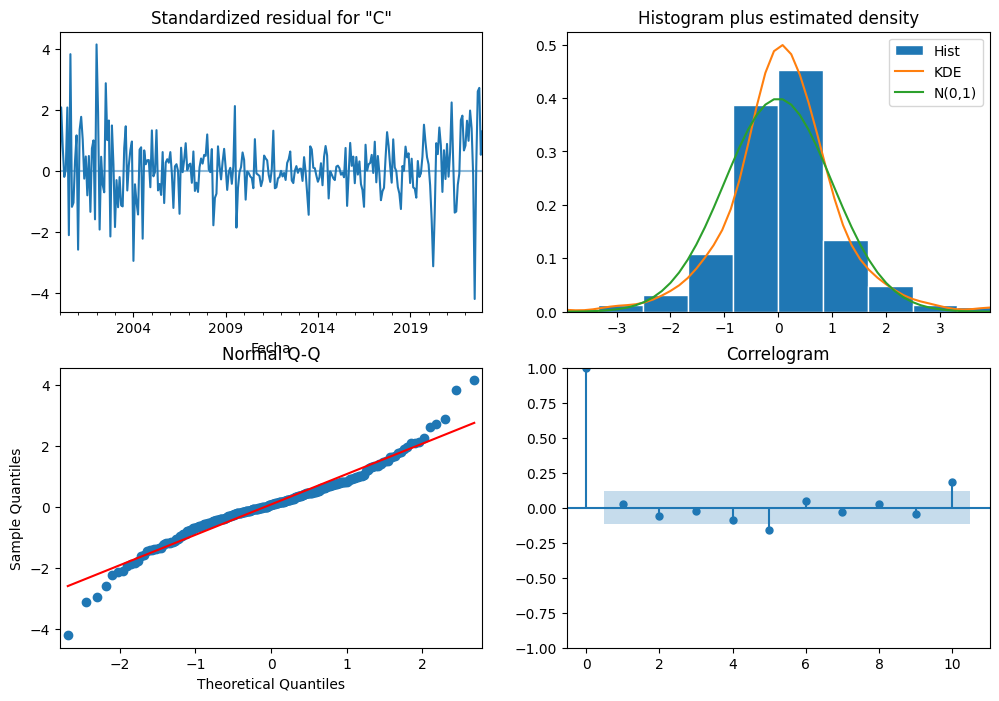

T.HORTALIZAS FRESCAS


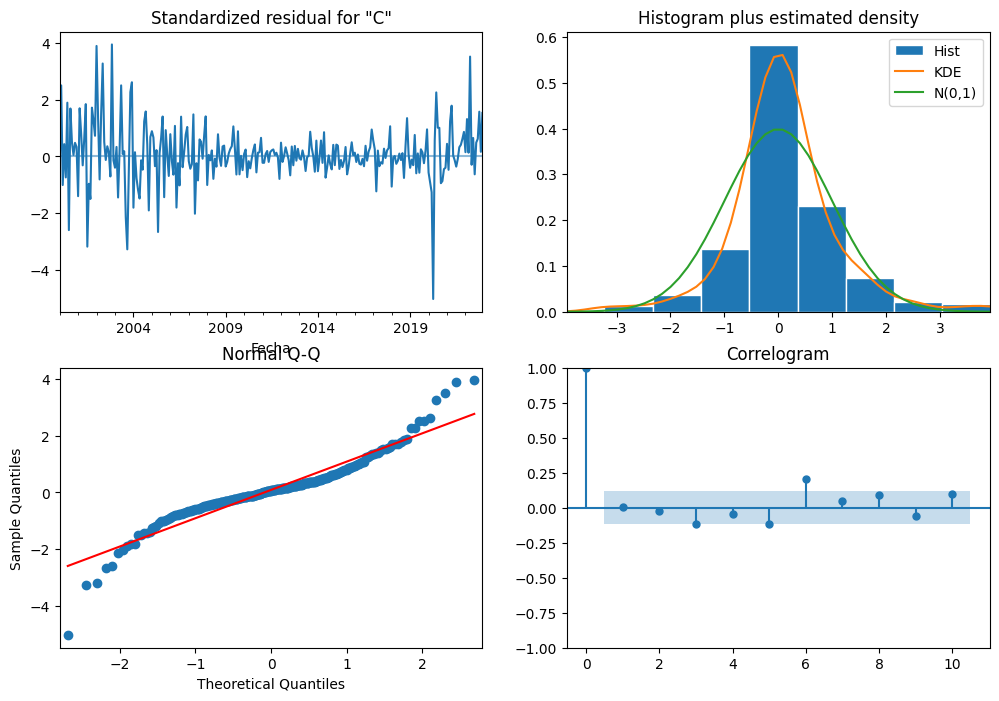

PAN


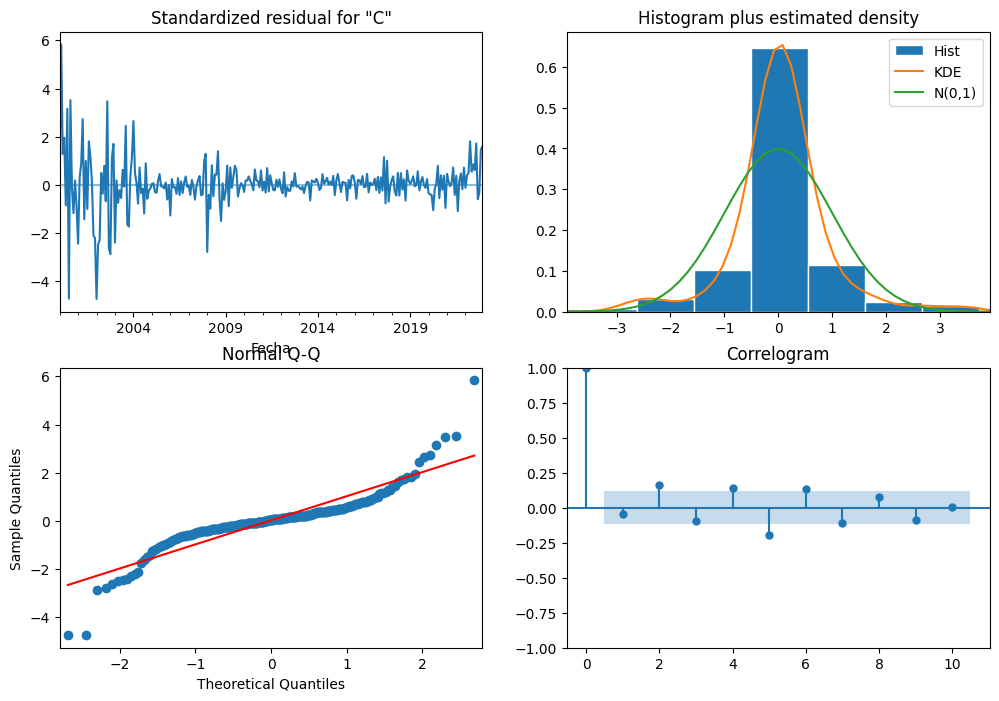

TOTAL CARNE


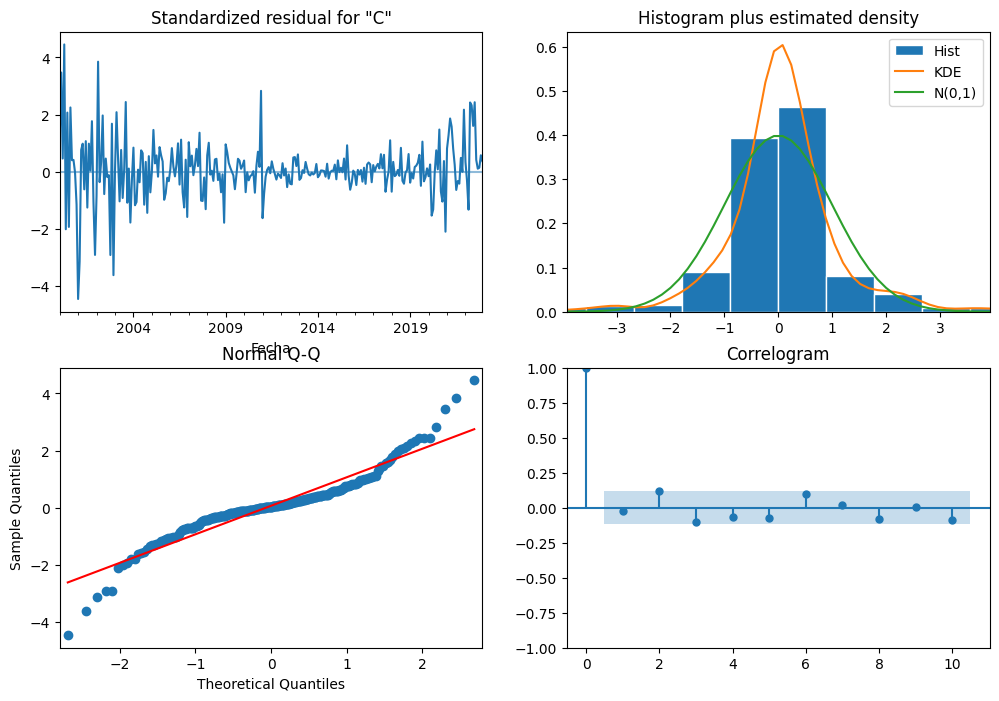

TOTAL PESCA


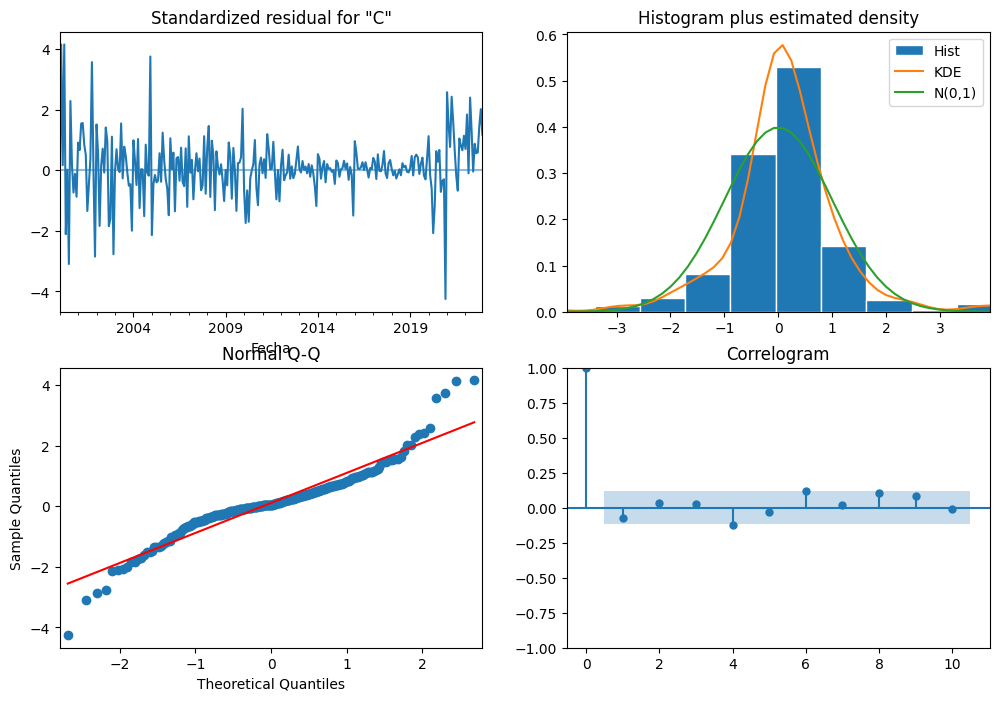

PLATOS PREPARADOS


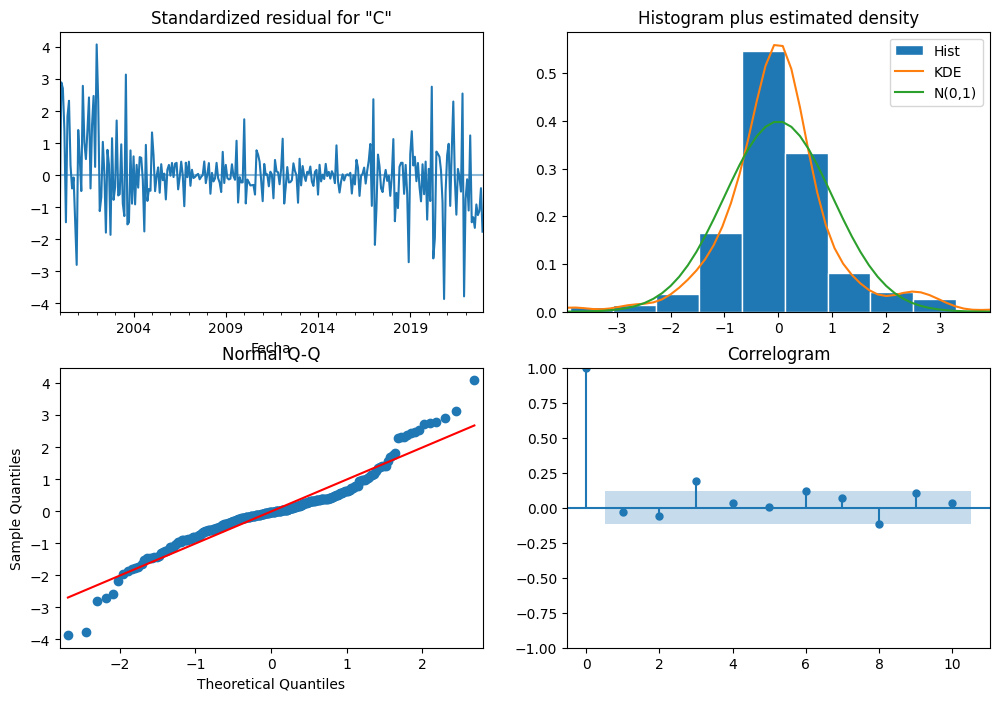

TOTAL LECHE LIQUIDA


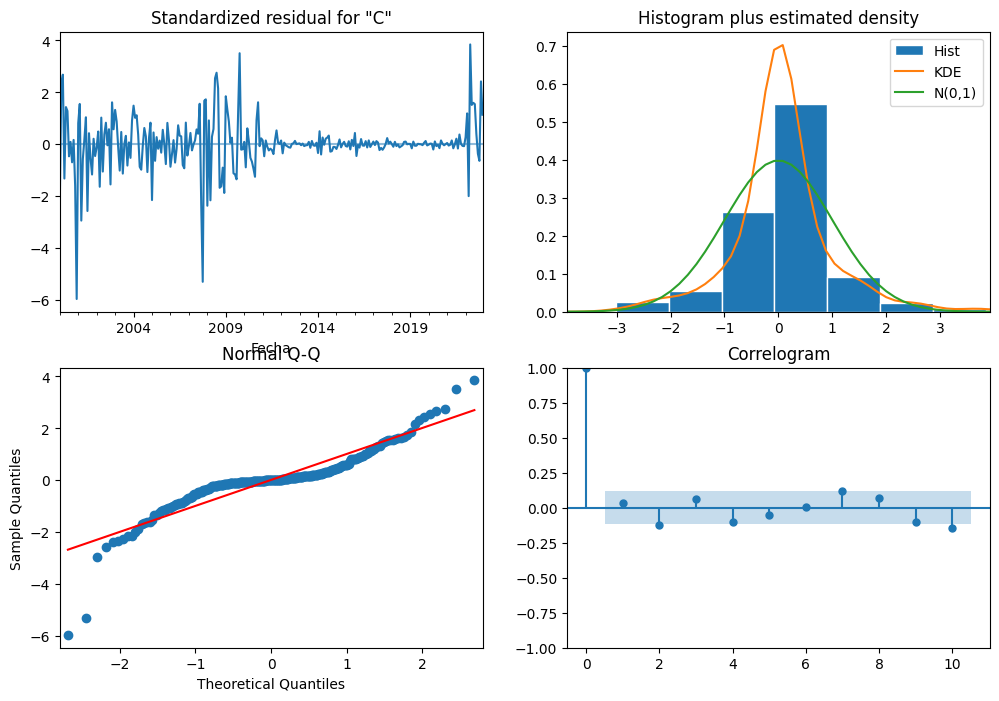

DERIVADOS LACTEOS


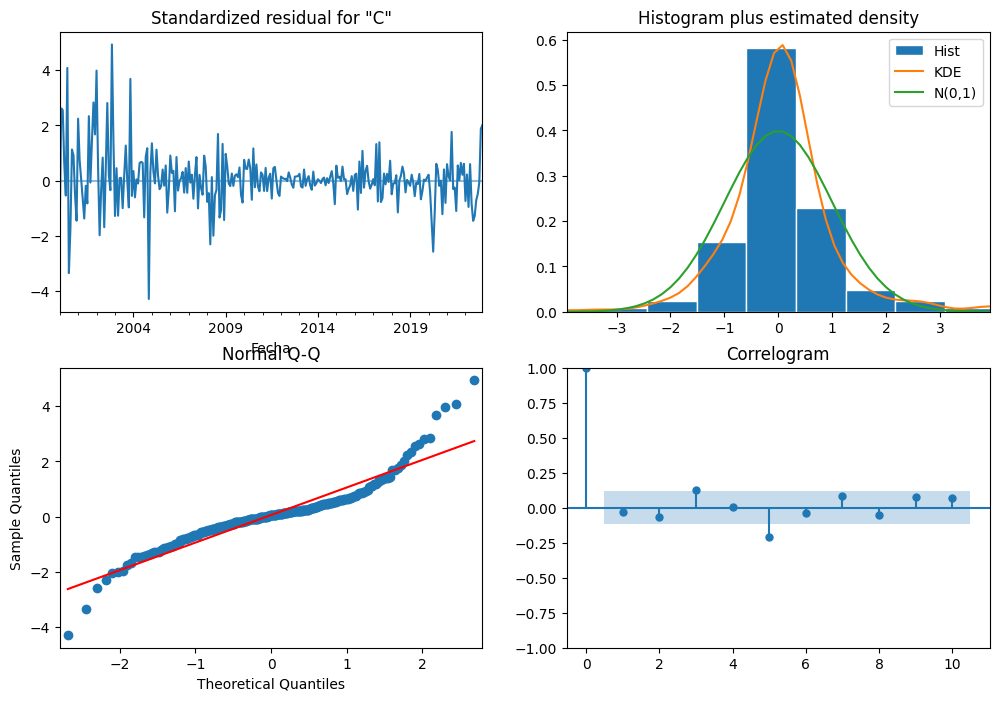

In [58]:
for alimento, modelo in resultados_modelos_dict.items():
    print(alimento)
    modelo['SARIMAX_GASTO X CAPITA_PRECIO MEDIO kg ó litros']['modelo'].plot_diagnostics(figsize=(12,8))
    plt.show()

Revisando y evaluando los modelos según el ajuste, observamos como los resultados del RMSE no mejoran significativamente sobre los modelos iniciales, incluso los empeoran. Además algunos modelos presentan parámetros no significativos e incluso hay evidencia estadísticamente significativas para rechazar la hipótesis nula que no hay autocorrelación en los residuos de la prueba de Ljung-Box. Esto sugiere que los residuos de algunos modelos presentan autocorrelación, lo que podría significar que el modelo no ha capturado completamente la estructura temporal de la serie y que podrían existir patrones no modelados.
Por éste motivo, se fijaran los parámetros iniciales (1, 0, 1), (1, 1, 1, 12) para todas las series. 

# EVALUACIÓN MODELOS CON INTERVALOS

En esta sección, se evaluará el desempeño de dos modelos de pronóstico aplicados a series temporales del consumo per capita de alimentos: un modelo autoregresivo con regresor lineal y un modelo SARIMAX, ambos ajustados con variables exógenas. Tras realizar un backtesting y un fine tuning de los modelos, se procederá a evaluar su desempeño mediante la comparación de intervalos de confianza en los conjuntos de datos de entrenamiento y prueba. Este análisis tiene como objetivo determinar la precisión y estabilidad de las predicciones de cada modelo.

## MODELO AUTOREGRESIVO REGRESOR LINEAL

In [59]:
# Diccionario para almacenar los modelos y la serie asociada a cada modelo. 
modelos_series_pred_AR = {}

# Los lags seleccionados en el fine tuning para cada serie de alimento
mejores_lags = {
    'T.FRUTAS FRESCAS': 3,
    'T.HORTALIZAS FRESCAS': 6,
    'PAN': 6,
    'TOTAL CARNE': 6,
    'TOTAL PESCA': 3,
    'PLATOS PREPARADOS': 12,
    'TOTAL LECHE LIQUIDA': 6,
    'DERIVADOS LACTEOS': 3
}

steps=12

for alimento, serie in dict_series_mensuales_nacional.items():
    serie_filtrada = serie[serie.index.year != 2024]
    train = serie_filtrada[:-steps]
    test = serie_filtrada[-steps:]
    
    lags_optimos = mejores_lags.get(alimento) 
    forecaster = ForecasterAutoreg(
                    regressor=LinearRegression(),
                    lags=lags_optimos
                )
    exog_variables = ['PRECIO MEDIO kg ó litros', 'GASTO X CAPITA']
    
    forecaster.fit(y=train['CONSUMO X CAPITA'], exog=train[exog_variables])
    
    metric, predictions = backtesting_forecaster(
                          forecaster         = forecaster,
                          y                  = train ['CONSUMO X CAPITA'],
                          exog               = train [['PRECIO MEDIO kg ó litros', 'GASTO X CAPITA']],
                          initial_train_size = 24,
                          fixed_train_size   = False,
                          steps              = steps,
                          refit              = True,
                          interval           = [5, 95],
                          n_boot             = 1000,
                          metric             = 'mean_squared_error',
                          verbose            = False,
                          show_progress      = True
                      )
    
    modelos_series_pred_AR[alimento] = {'modelo': forecaster,'serie': serie, 'predicciones':predictions}

100%|██████████████████████████████████████████████████████████████████████████████████| 22/22 [00:24<00:00,  1.11s/it]


Cobertura del intervalo predicho con los datos de entrenamiento T.FRUTAS FRESCAS: 77.27272727272727
Resultados train: 0.23934710189787922
Cobertura del intervalo predicho con los datos de test T.FRUTAS FRESCAS: 41.66666666666667
Resultados test: 0.5679101206747873


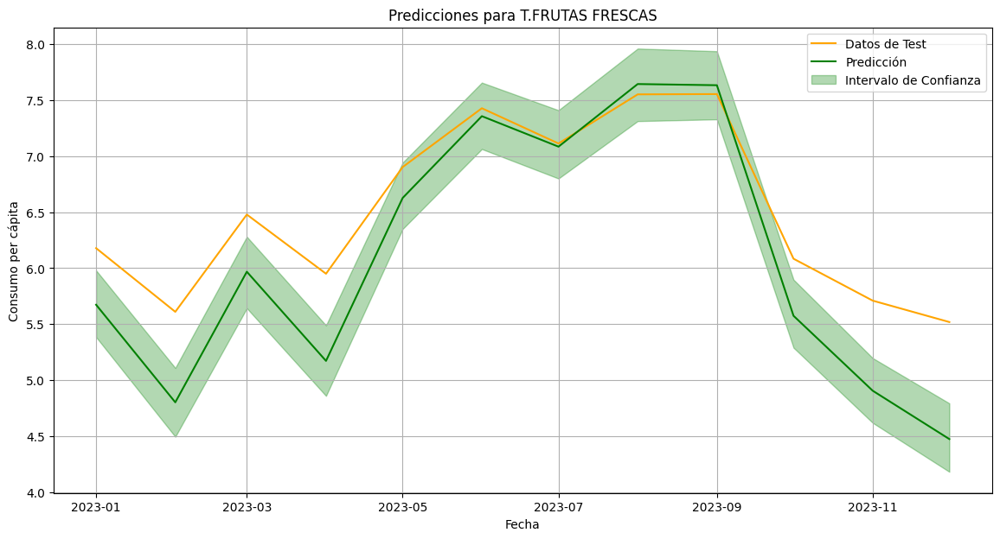

Cobertura del intervalo predicho con los datos de entrenamiento T.HORTALIZAS FRESCAS: 75.75757575757575
Resultados train: 0.14036656646694765
Cobertura del intervalo predicho con los datos de test T.HORTALIZAS FRESCAS: 16.666666666666664
Resultados test: 0.3136746817891343


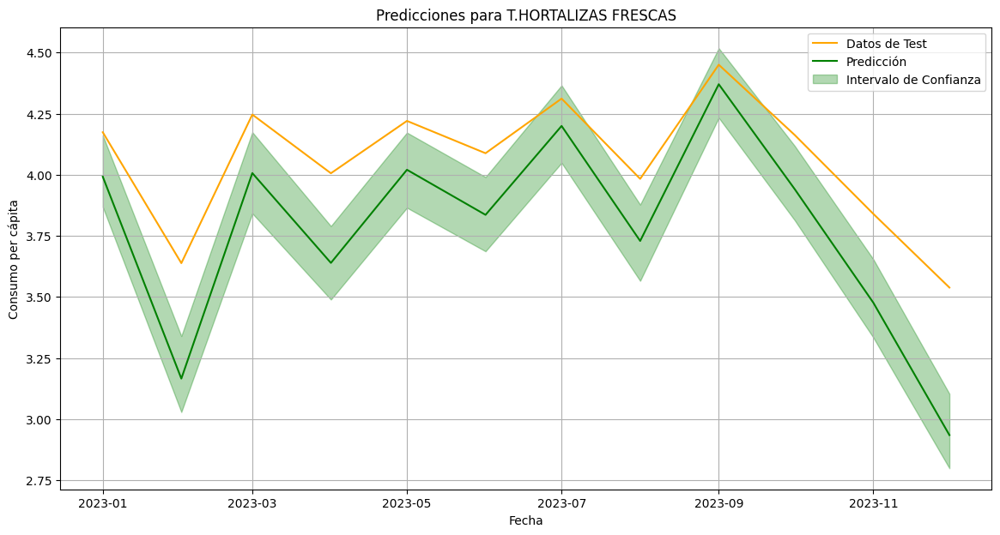

Cobertura del intervalo predicho con los datos de entrenamiento PAN: 82.1969696969697
Resultados train: 0.06621680001755152
Cobertura del intervalo predicho con los datos de test PAN: 0.0
Resultados test: 0.16735468307933804


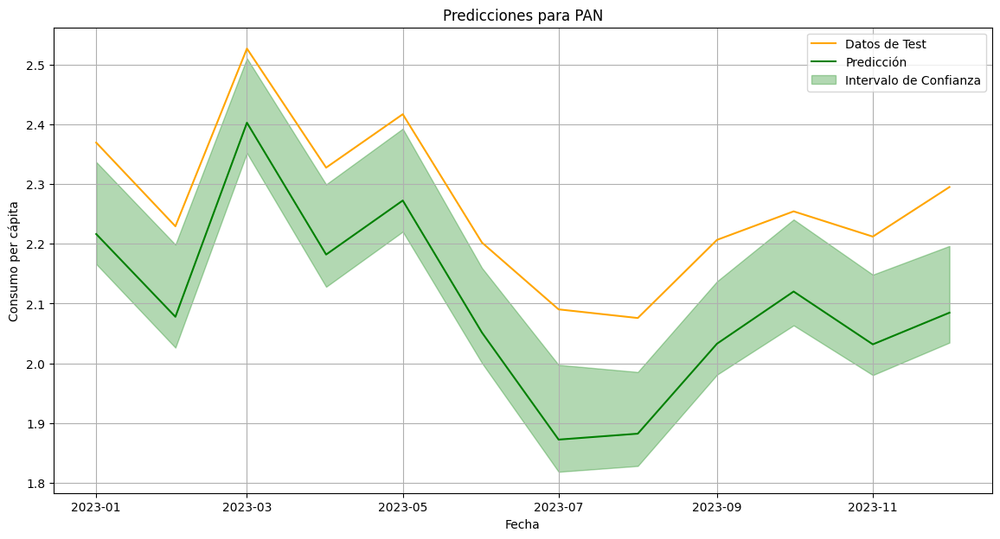

Cobertura del intervalo predicho con los datos de entrenamiento TOTAL CARNE: 78.03030303030303
Resultados train: 0.09387756930626047
Cobertura del intervalo predicho con los datos de test TOTAL CARNE: 41.66666666666667
Resultados test: 0.19506900636348026


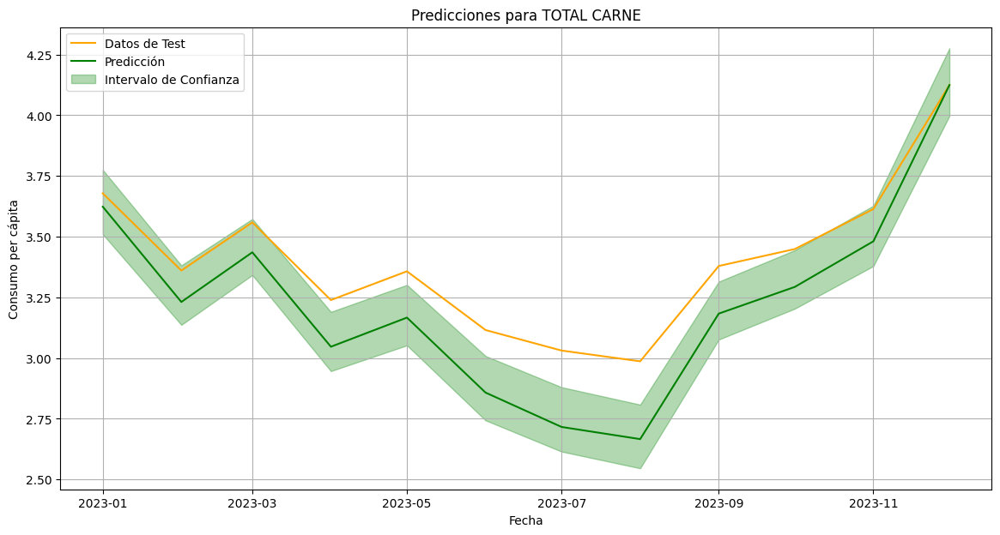

Cobertura del intervalo predicho con los datos de entrenamiento TOTAL PESCA: 81.43939393939394
Resultados train: 0.05435880134683209
Cobertura del intervalo predicho con los datos de test TOTAL PESCA: 8.333333333333332
Resultados test: 0.15668380836603724


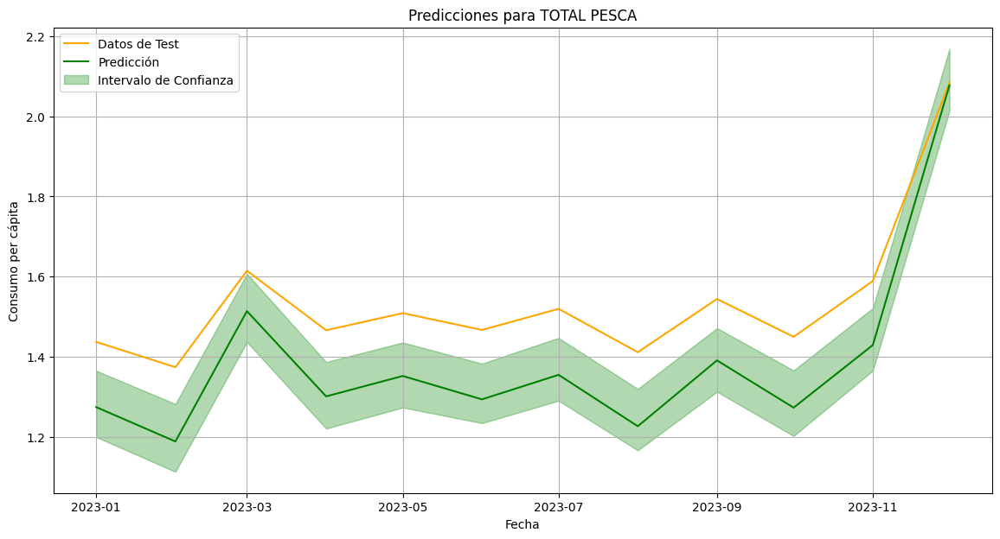

Cobertura del intervalo predicho con los datos de entrenamiento PLATOS PREPARADOS: 59.46969696969697
Resultados train: 0.036444935584392865
Cobertura del intervalo predicho con los datos de test PLATOS PREPARADOS: 0.0
Resultados test: 0.1326622731993828


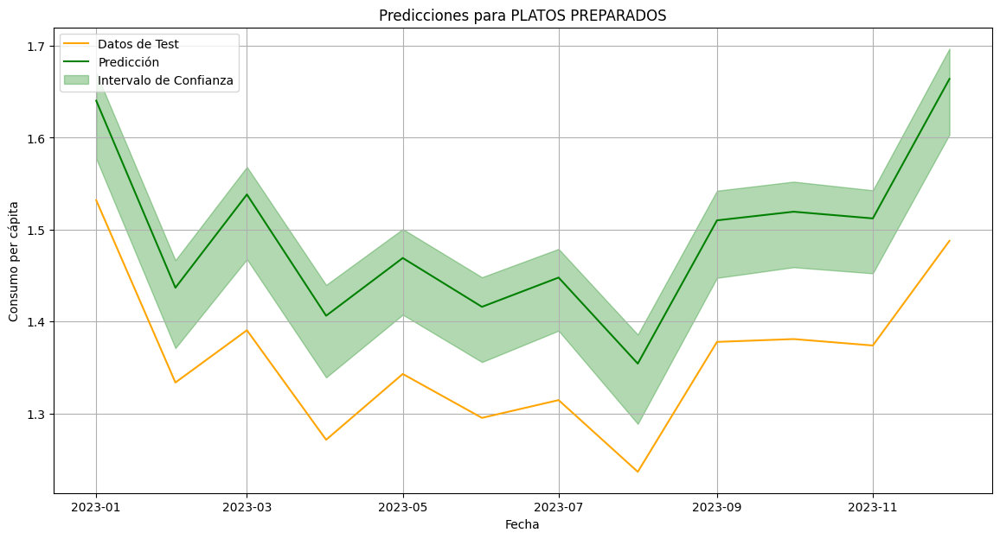

Cobertura del intervalo predicho con los datos de entrenamiento TOTAL LECHE LIQUIDA: 79.92424242424242
Resultados train: 0.15351148605408252
Cobertura del intervalo predicho con los datos de test TOTAL LECHE LIQUIDA: 0.0
Resultados test: 0.7313141995463204


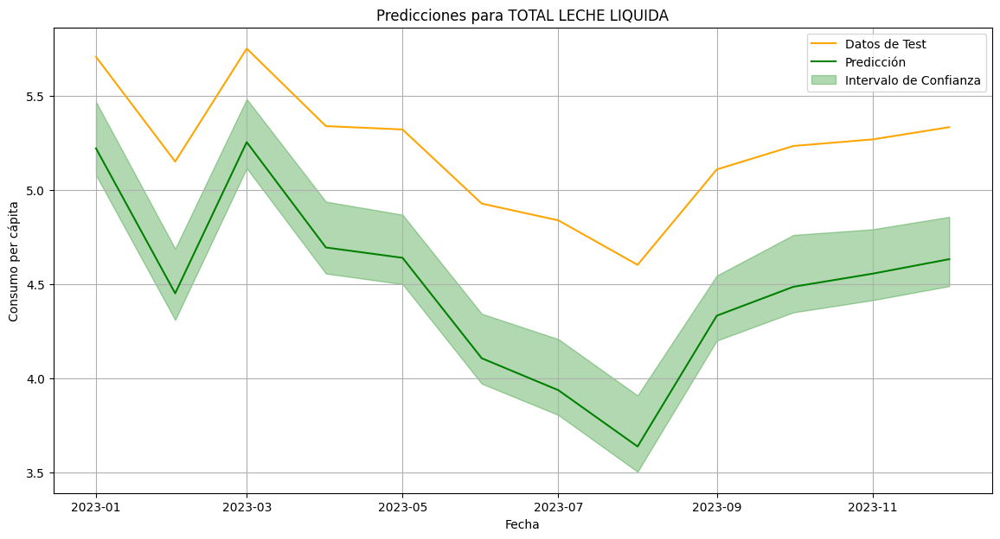

Cobertura del intervalo predicho con los datos de entrenamiento DERIVADOS LACTEOS: 83.71212121212122
Resultados train: 0.03796162242000419
Cobertura del intervalo predicho con los datos de test DERIVADOS LACTEOS: 41.66666666666667
Resultados test: 0.07041428697601007


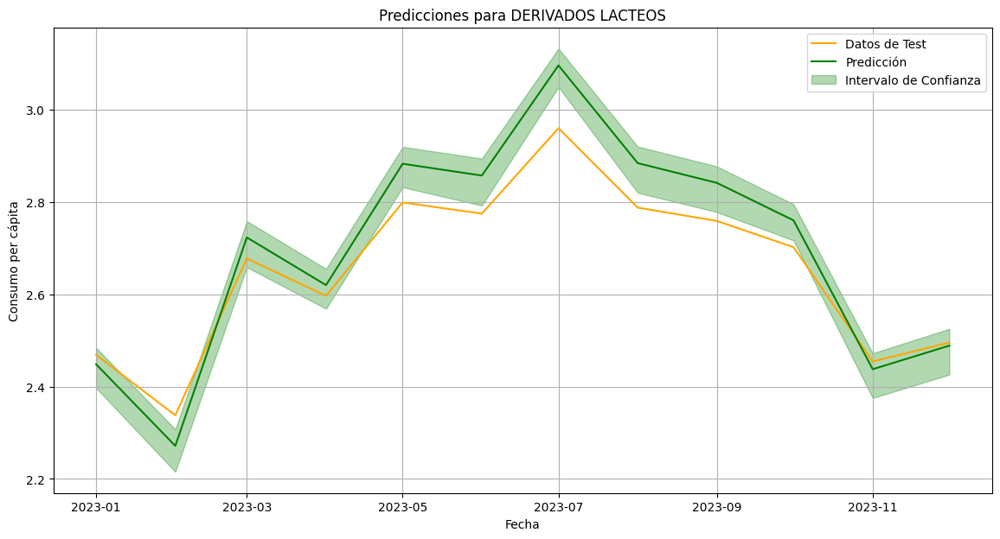

In [60]:
for alimento, serie in dict_series_mensuales_nacional.items():
    serie_filtrada = serie[serie.index.year != 2024]
    train = serie_filtrada[:-steps]
    test = serie_filtrada[-steps:]
    exog_test = test[['PRECIO MEDIO kg ó litros', 'GASTO X CAPITA']]
    
    modelo=modelos_series_pred_AR[alimento]['modelo']
    
    #TRAIN----------------->
    prediccion_train=modelos_series_pred_AR[alimento]['predicciones']
    
    # Cobertura del intervalo en los datos de entrenamiento
    intervalo_train = np.where(
                          (train.loc[prediccion_train.index, 'CONSUMO X CAPITA'] >= prediccion_train['lower_bound']) & \
                          (train.loc[prediccion_train.index, 'CONSUMO X CAPITA'] <= prediccion_train['upper_bound']),
                          True,
                          False
                      )

    cobertura_train = intervalo_train.mean()
    train_filter=train[24:]
    rmse = mean_squared_error(y_true=train_filter['CONSUMO X CAPITA'], y_pred=prediccion_train['pred'], squared=False)
    print(f"Cobertura del intervalo predicho con los datos de entrenamiento {alimento}: {100 * cobertura_train}")
    print(f"Resultados train: {rmse}")
    
    #TEST----------------->
    fcast = modelo.predict(steps=steps, exog=exog_test)
    prediccion_test = modelo.predict_interval(steps=steps, exog=exog_test, interval=[5, 95], n_boot=1000)
    conf_int_low = prediccion_test['lower_bound']
    conf_int_high = prediccion_test['upper_bound']
    
    intervalo_test = np.where(
                          (test.loc[prediccion_test.index, 'CONSUMO X CAPITA'] >= prediccion_test['lower_bound']) & \
                          (test.loc[prediccion_test.index, 'CONSUMO X CAPITA'] <= prediccion_test['upper_bound']),
                          True,
                          False
                      )

    cobertura_test = intervalo_test.mean()
    rmse = mean_squared_error(y_true=test['CONSUMO X CAPITA'], y_pred=prediccion_test['pred'], squared=False) 
    print(f"Cobertura del intervalo predicho con los datos de test {alimento}: {100 * cobertura_test}")
    print(f"Resultados test: {rmse}")
    
    plt.figure(figsize=(14, 7))
    plt.title(f"Predicciones para {alimento}")
    
    plt.plot(test.index, test['CONSUMO X CAPITA'], label='Datos de Test', color='orange')
    plt.plot(fcast.index, fcast, label='Predicción', color='green')
    
    # Graficar intervalos de predicción
    plt.fill_between(fcast.index, conf_int_low, conf_int_high, color='green', alpha=0.3, label='Intervalo de Confianza')
    
    
    plt.xlabel('Fecha')
    plt.ylabel('Consumo per cápita')
    plt.legend()
    plt.grid(True)
    plt.show()

Al evaluar el modelo con los datos de prueba, se observa una reducción significativa en la cobertura del intervalo de predicción y un aumento en el RMSE en comparación con el conjunto de entrenamiento. Esto indica que, aunque el modelo se ajusta bien a los datos de entrenamiento, no generaliza adecuadamente a nuevos datos.

Dado que nuestras series presentan una estacionalidad muy marcada y una ligera tendencia, el patrón observado sugiere que el modelo autoregresivo utilizado puede estar subajustado. Esto se debe a que los modelos autoregresivos estándar tienen limitaciones para capturar estos patrones específicos, lo que limita su capacidad de generalización y afecta el rendimiento en datos nuevos.

## MODELO SARIMAX

In [61]:
# Diccionario para almacenar los modelos y la serie asociada a cada modelo. 
modelos_series_pred_SARIMAX = {}

steps=12

for alimento, serie in dict_series_mensuales_nacional.items():
    serie_filtrada = serie[serie.index.year != 2024]
    train = serie_filtrada[:-steps]
    test = serie_filtrada[-steps:]
    
    forecaster = ForecasterSarimax(
                 regressor=Sarimax(order=(1, 0, 1), seasonal_order=(0, 1, 1, 12),maxiter=1000)
             )
    exog_variables = ['PRECIO MEDIO kg ó litros', 'GASTO X CAPITA']
    
    forecaster.fit(y=train['CONSUMO X CAPITA'], exog=train[exog_variables])
    
    metric, predictions = backtesting_sarimax(
                          forecaster         = forecaster,
                          y                  = train ['CONSUMO X CAPITA'],
                          exog               = train [['PRECIO MEDIO kg ó litros', 'GASTO X CAPITA']],
                          initial_train_size = 24,
                          fixed_train_size   = False,
                          steps              = steps,
                          refit              = True,
                          interval           = [5, 95],
                          metric             = 'mean_squared_error',
                          verbose            = False,
                          show_progress      = True
                      )
    
    modelos_series_pred_SARIMAX[alimento] = {'modelo': forecaster,'serie': serie, 'predicciones':predictions}

C:\Users\OT\anaconda3\envs\tfm_modelos\lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
  0%|                                                                                           | 0/22 [00:00<?, ?it/s]C:\Users\OT\anaconda3\envs\tfm_modelos\lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
  9%|███████▌                                                                           | 2/22 [00:00<00:01, 11.30it/s]C:\Users\OT\anaconda3\envs\tfm_modelos\lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning: Too few observations to estimate 

  9%|███████▌                                                                           | 2/22 [00:00<00:03,  5.77it/s]C:\Users\OT\anaconda3\envs\tfm_modelos\lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'
 14%|███████████▎                                                                       | 3/22 [00:00<00:04,  4.74it/s]C:\Users\OT\anaconda3\envs\tfm_modelos\lib\site-packages\statsmodels\tsa\statespace\sarimax.py:1009: UserWarning: Non-invertible starting seasonal moving average Using zeros as starting parameters.
  warn('Non-invertible starting seasonal moving average'
 27%|██████████████████████▋                                                            | 6/22 [00:02<00:07,  2.27it/s]C:\Users\OT\anaconda3\envs\tfm_modelos\lib\site-packages\statsmodels\base\model.

 18%|███████████████                                                                    | 4/22 [00:01<00:06,  2.82it/s]C:\Users\OT\anaconda3\envs\tfm_modelos\lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
C:\Users\OT\anaconda3\envs\tfm_modelos\lib\site-packages\statsmodels\tsa\statespace\sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
100%|██████████████████████████████████████████████████████████████████████████████████| 22/22 [00:14<00:00,  1.49it/s]
C:\Users\OT\anaconda3\envs\tfm_modelos\lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  war

Cobertura del intervalo predicho con los datos de entrenamiento T.FRUTAS FRESCAS: 83.33333333333334
Resultados train: 0.19034322370961457
Cobertura del intervalo predicho con los datos de test T.FRUTAS FRESCAS: 66.66666666666666
Resultados test: 0.2764808589740966


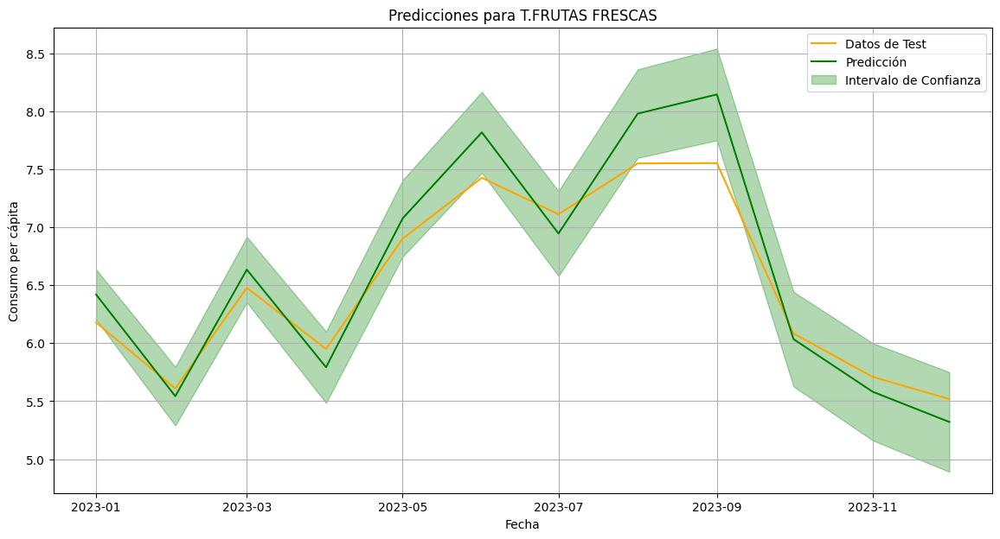

Cobertura del intervalo predicho con los datos de entrenamiento T.HORTALIZAS FRESCAS: 80.68181818181817
Resultados train: 0.13530068996947445
Cobertura del intervalo predicho con los datos de test T.HORTALIZAS FRESCAS: 66.66666666666666
Resultados test: 0.1858619242946108


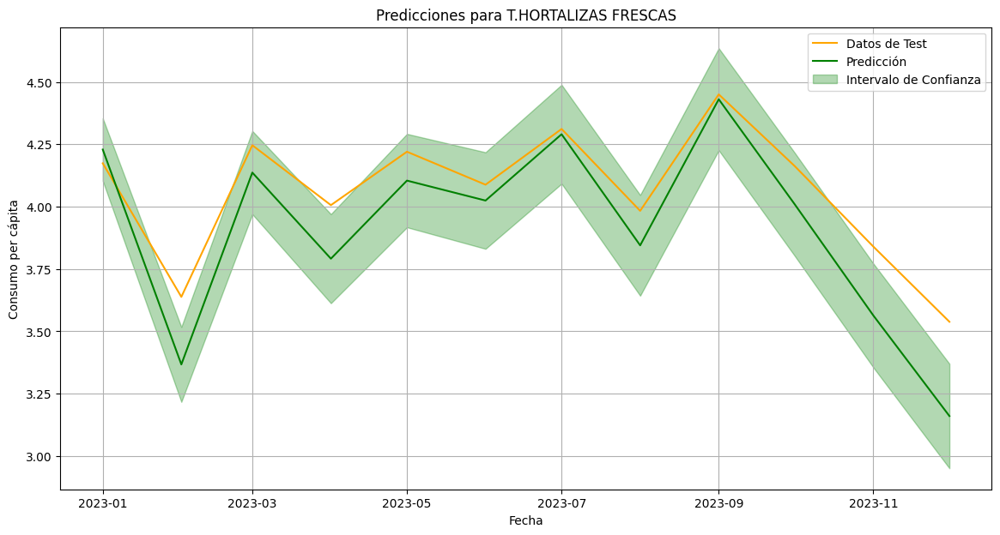

Cobertura del intervalo predicho con los datos de entrenamiento PAN: 89.77272727272727
Resultados train: 0.06343621238539524
Cobertura del intervalo predicho con los datos de test PAN: 100.0
Resultados test: 0.03403189984204982


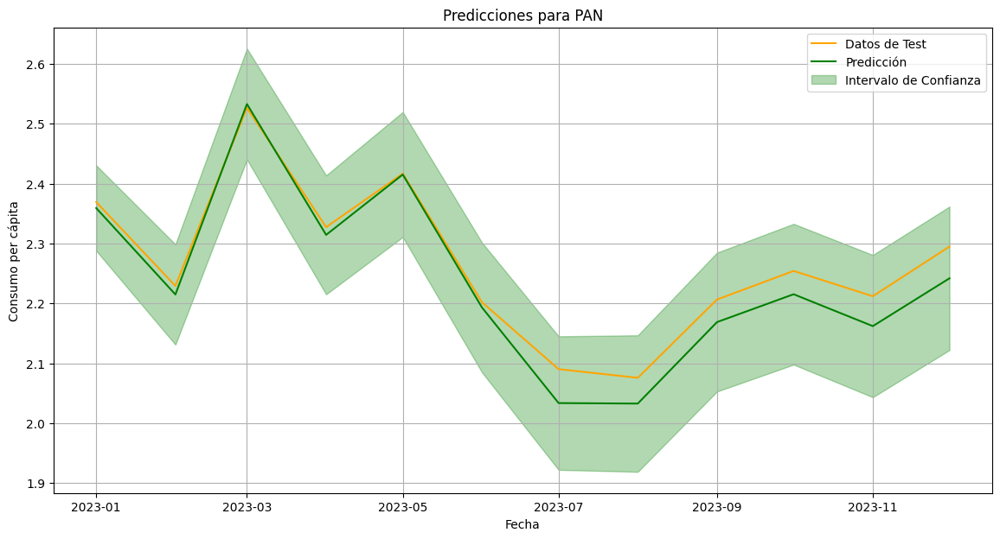

Cobertura del intervalo predicho con los datos de entrenamiento TOTAL CARNE: 87.5
Resultados train: 0.06382124181506926
Cobertura del intervalo predicho con los datos de test TOTAL CARNE: 50.0
Resultados test: 0.12180407198966728


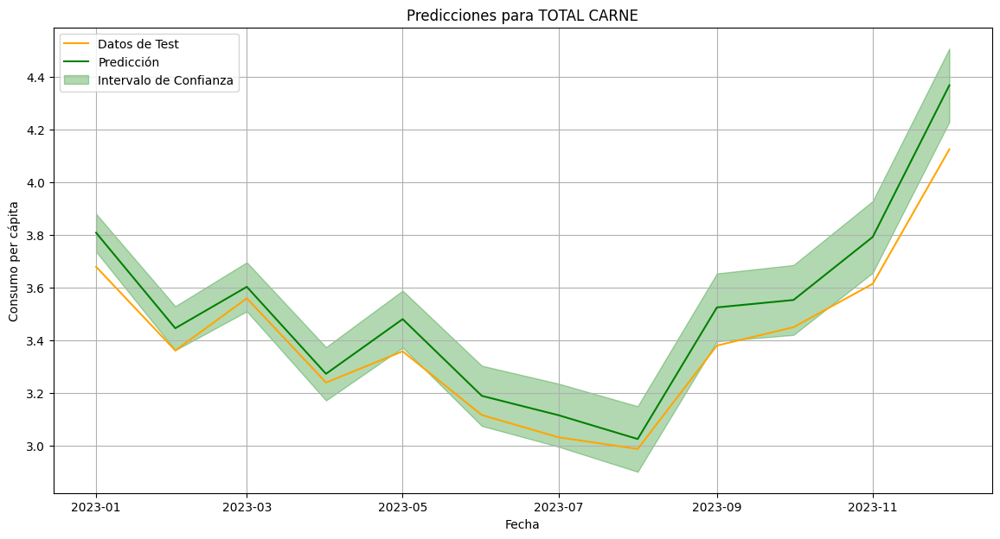

Cobertura del intervalo predicho con los datos de entrenamiento TOTAL PESCA: 77.65151515151516
Resultados train: 0.0426247706100266
Cobertura del intervalo predicho con los datos de test TOTAL PESCA: 100.0
Resultados test: 0.02743983299564862


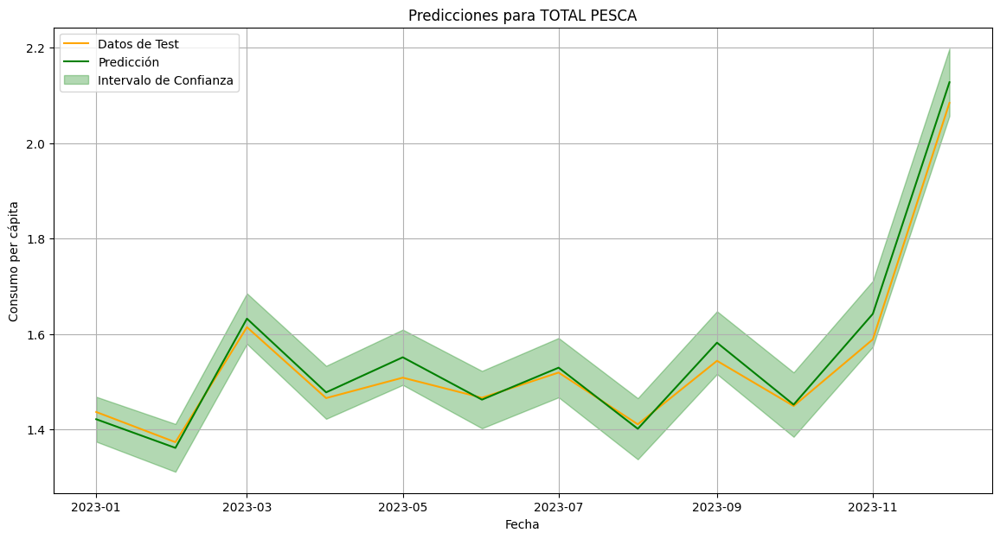

Cobertura del intervalo predicho con los datos de entrenamiento PLATOS PREPARADOS: 87.87878787878788
Resultados train: 0.01851769883141717
Cobertura del intervalo predicho con los datos de test PLATOS PREPARADOS: 75.0
Resultados test: 0.02385786682499123


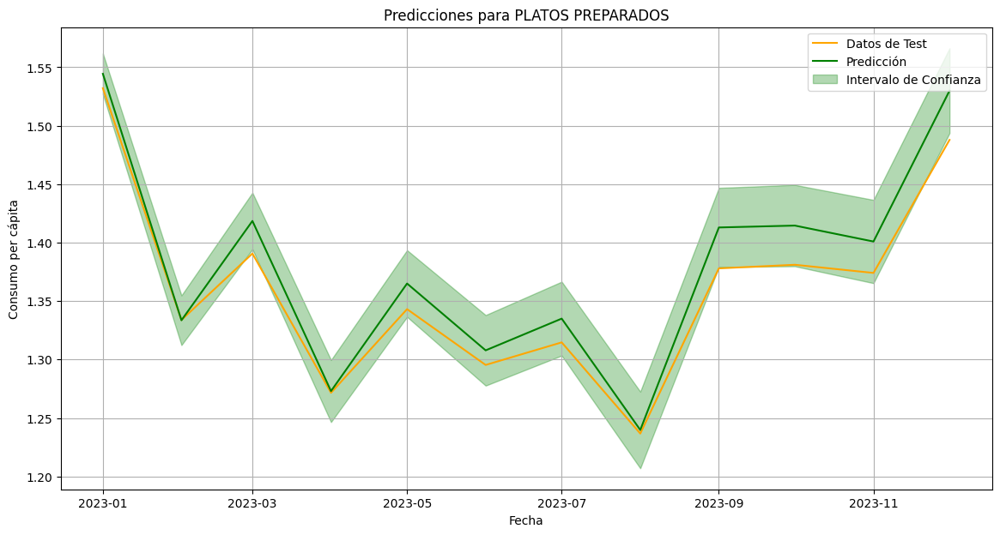

Cobertura del intervalo predicho con los datos de entrenamiento TOTAL LECHE LIQUIDA: 80.68181818181817
Resultados train: 0.11472248779079641
Cobertura del intervalo predicho con los datos de test TOTAL LECHE LIQUIDA: 83.33333333333334
Resultados test: 0.12119912395587984


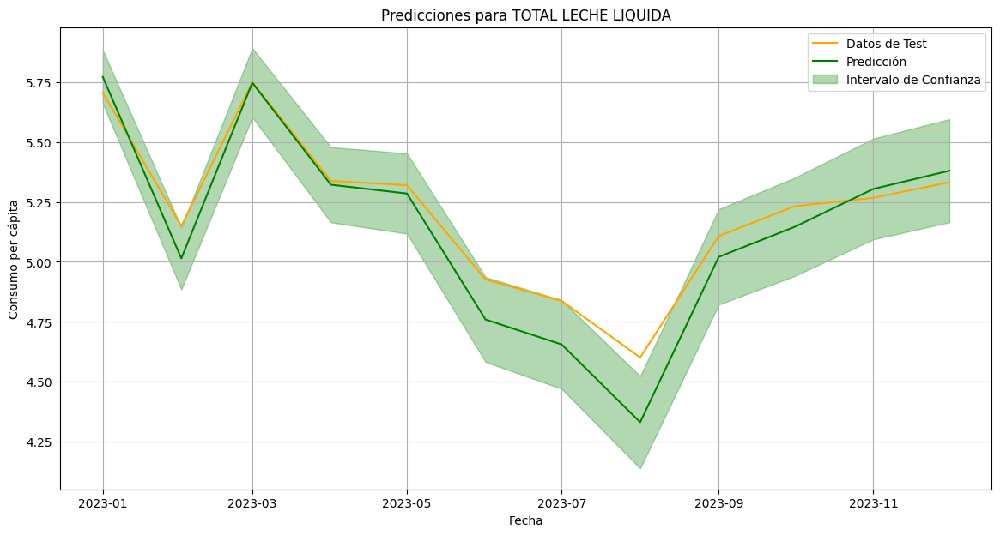

Cobertura del intervalo predicho con los datos de entrenamiento DERIVADOS LACTEOS: 91.66666666666666
Resultados train: 0.027594440744559443
Cobertura del intervalo predicho con los datos de test DERIVADOS LACTEOS: 50.0
Resultados test: 0.04997963981408177


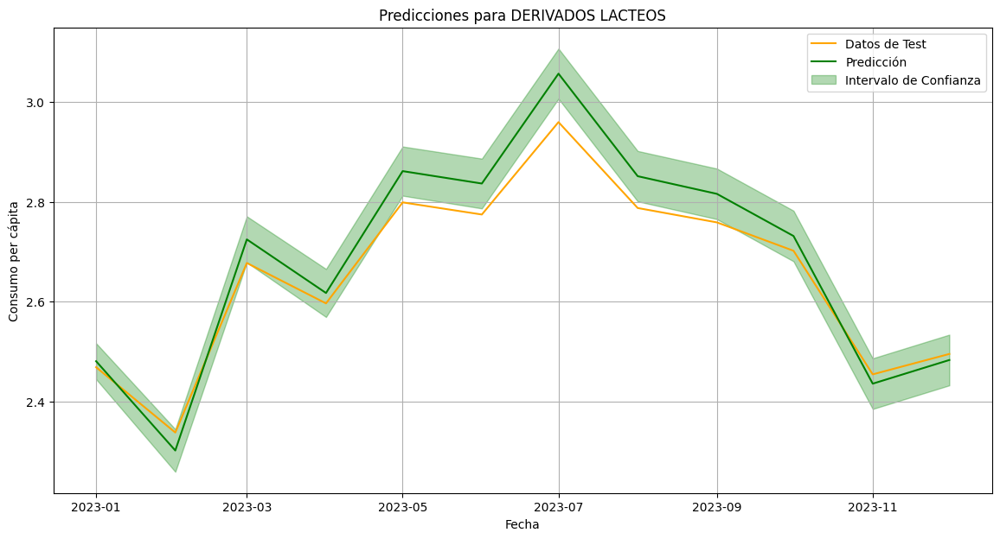

In [62]:
for alimento, serie in dict_series_mensuales_nacional.items():
    serie_filtrada = serie[serie.index.year != 2024]
    train = serie_filtrada[:-steps]
    test = serie_filtrada[-steps:]
    exog_test = test[['PRECIO MEDIO kg ó litros', 'GASTO X CAPITA']]
    
    modelo=modelos_series_pred_SARIMAX[alimento]['modelo']
    
    #TRAIN----------------->
    prediccion_train=modelos_series_pred_SARIMAX[alimento]['predicciones']
    
    # Cobertura del intervalo en los datos de entrenamiento
    intervalo_train = np.where(
                          (train.loc[prediccion_train.index, 'CONSUMO X CAPITA'] >= prediccion_train['lower_bound']) & \
                          (train.loc[prediccion_train.index, 'CONSUMO X CAPITA'] <= prediccion_train['upper_bound']),
                          True,
                          False
                      )

    cobertura_train = intervalo_train.mean()
    train_filter=train[24:]
    rmse = mean_squared_error(y_true=train_filter['CONSUMO X CAPITA'], y_pred=prediccion_train['pred'], squared=False)
    print(f"Cobertura del intervalo predicho con los datos de entrenamiento {alimento}: {100 * cobertura_train}")
    print(f"Resultados train: {rmse}")
    #TEST----------------->
    
    # Predicción puntual
    fcast = modelo.predict(steps=steps, exog=exog_test)
    # Predicción con intervalos de confianza
    prediccion_test = modelo.predict_interval(steps=steps, exog=exog_test, interval=[5, 95])

    conf_int_low = prediccion_test['lower_bound']
    conf_int_high = prediccion_test['upper_bound']
    
    intervalo_test = np.where(
                          (test.loc[prediccion_test.index, 'CONSUMO X CAPITA'] >= prediccion_test['lower_bound']) & \
                          (test.loc[prediccion_test.index, 'CONSUMO X CAPITA'] <= prediccion_test['upper_bound']),
                          True,
                          False
                      )
    

    cobertura_test = intervalo_test.mean()
    rmse = mean_squared_error(y_true=test['CONSUMO X CAPITA'], y_pred=prediccion_test['pred'], squared=False) 
    print(f"Cobertura del intervalo predicho con los datos de test {alimento}: {100 * cobertura_test}")
    print(f"Resultados test: {rmse}")
    
    plt.figure(figsize=(14, 7))
    plt.title(f"Predicciones para {alimento}")
    
    plt.plot(test.index, test['CONSUMO X CAPITA'], label='Datos de Test', color='orange')
    plt.plot(fcast.index, fcast, label='Predicción', color='green')
    
    # Graficar intervalos de predicción
    plt.fill_between(fcast.index, conf_int_low, conf_int_high, color='green', alpha=0.3, label='Intervalo de Confianza')
    
    
    plt.xlabel('Fecha')
    plt.ylabel('Consumo per cápita')
    plt.legend()
    plt.grid(True)
    plt.show()

Observamos comparando los resultados entre train y test de RMSE que el modelo SARIMAX esta generalizando correctamente y con RMSE muy bajos. 
Además, al analizar los intervalos de confianza generados por el modelo SARIMAX para las series temporales, se observa que la cobertura del intervalo, definida entre el 5% y el 95%, es consistentemente alta. En particular, los intervalos de confianza para la mayoría de las series, aunque para la carne y derivados lacteos la cobertura es del 50%. 

Este alto nivel de cobertura del intervalo indica que el modelo es muy efectivo para capturar la variabilidad de los datos. En otras palabras, el modelo tiene una gran capacidad para proporcionar intervalos de predicción que incluyen el valor real de la variable objetivo en una proporción significativa de las ocasiones. Este resultado sugiere que el modelo no solo es robusto, sino que también es confiable para hacer predicciones precisas en función de los datos históricos.

# GUARDAR MODELOS

El guardado de las series se realiza a año completo, por tanto, eliminaremos los datos de 2024, para poder tener una correcta productivización del modelo. Además también borraremos las predicciones del diccionario manteniendo solo serie-modelo. 

In [63]:
# Directorios de las series y modelos
series_dir = './series/'
modelos_dir = './modelos/'

# Crear los directorios si no existen
os.makedirs(series_dir, exist_ok=True)
os.makedirs(modelos_dir, exist_ok=True)

# Columnas a eliminar
columnas_a_eliminar = ['PENETRACION (%)', 'VALOR (Miles Euros)', 'VOLUMEN (Miles kg ó litros)', 'Año', 'Mes','Alimentos']

for alimento, datos in modelos_series_pred_SARIMAX.items():
    # Eliminar el año 2024 de la serie
    serie_sin_2024 = datos['serie'][datos['serie'].index.year != 2024]

    # Eliminar las columnas específicas: solo mantenemos la relevantes: consumo, gasto y precio. 
    serie_sin_2024 = serie_sin_2024.drop(columns=[col for col in columnas_a_eliminar if col in serie_sin_2024.columns])
    ultimo_anio = serie_sin_2024.index.year.max()

    # Guardar la serie en un archivo .csv en el directorio 'series/' el archivo se dobla para tener la backup y 
    # poder sobrescribir en la API
    nombre_csv_1 = f"{series_dir}serie_{alimento}_{ultimo_anio}.csv"
    nombre_csv_2 = f"{series_dir}serie_{alimento}.csv"
    serie_sin_2024.to_csv(nombre_csv_1)
    serie_sin_2024.to_csv(nombre_csv_2)
    print(f"Series de {alimento} guardadas en {nombre_csv_1} y {nombre_csv_2}")

    # Guardar el modelo en un archivo pickle en el directorio 'modelos/'
    nombre_modelo_pickle = f"{modelos_dir}modelo_{alimento}_origen.pkl"
    nombre_modelo_pickle2 = f"{modelos_dir}modelo_{alimento}.pkl"
    with open(nombre_modelo_pickle, 'wb') as archivo_pickle:
        pickle.dump(datos['modelo'], archivo_pickle)
    print(f"Modelo de {alimento} guardado en {nombre_modelo_pickle}")
    with open(nombre_modelo_pickle2, 'wb') as archivo_pickle:
        pickle.dump(datos['modelo'], archivo_pickle)
    print(f"Modelo de {alimento} guardado en {nombre_modelo_pickle2}")


Series de T.FRUTAS FRESCAS guardadas en ./series/serie_T.FRUTAS FRESCAS_2023.csv y ./series/serie_T.FRUTAS FRESCAS.csv
Modelo de T.FRUTAS FRESCAS guardado en ./modelos/modelo_T.FRUTAS FRESCAS_origen.pkl
Modelo de T.FRUTAS FRESCAS guardado en ./modelos/modelo_T.FRUTAS FRESCAS.pkl
Series de T.HORTALIZAS FRESCAS guardadas en ./series/serie_T.HORTALIZAS FRESCAS_2023.csv y ./series/serie_T.HORTALIZAS FRESCAS.csv
Modelo de T.HORTALIZAS FRESCAS guardado en ./modelos/modelo_T.HORTALIZAS FRESCAS_origen.pkl
Modelo de T.HORTALIZAS FRESCAS guardado en ./modelos/modelo_T.HORTALIZAS FRESCAS.pkl
Series de PAN guardadas en ./series/serie_PAN_2023.csv y ./series/serie_PAN.csv
Modelo de PAN guardado en ./modelos/modelo_PAN_origen.pkl
Modelo de PAN guardado en ./modelos/modelo_PAN.pkl
Series de TOTAL CARNE guardadas en ./series/serie_TOTAL CARNE_2023.csv y ./series/serie_TOTAL CARNE.csv
Modelo de TOTAL CARNE guardado en ./modelos/modelo_TOTAL CARNE_origen.pkl
Modelo de TOTAL CARNE guardado en ./modelos/m